### COVID-19 Sentiment Analysis

Our goal is to mine the opinion of twitter users about the US government's handling of the Coronavirus situation

### Connecting Python Client Application to Twitter server

In [10]:
import settings
import tweepy
import re
import mysql.connector
import pandas as pd
from textblob import TextBlob
import time
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import plotly.express as px
import itertools
import math
from datetime import datetime as dt
import warnings
warnings.filterwarnings('ignore')


In [2]:
consumer_key = 'ULZ4zliiFlDyRYhNWw14LipDy'
consumer_secret = 'rhP5ewhZA9YtUAfRsUBmPOqwmZI1R1Zv068xHm0FA79rrXoroP'
access_token = '3294009729-9K7S4sGLmsxqQiKgvqmWZJXYTv9hScVtHKlbAf7'
access_token_secret = '4WEYA4D2dLzlJodUYlrIc08AdVsXDrBQMSI5mViNHP73S'

auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_token_secret)
api = tweepy.API(auth,wait_on_rate_limit=True)

### Streaming Twitter Data with Tweepy, MySQL and Python

We create a Tweepy’s StreamListener with on_status method for receiving tweets and on_error method for stopping grabbing data due to rate limits. Tweets are known as “status updates”. So the Status class in Tweepy has properties describing the tweet. We override tweepy.StreamListener to add logic to on_status.  We store all the information in a database created with mySQL.

Specify the details for receiving and preprocessing Twitter Data in **on_status** method. The attributes in status is the same in Tweet Object.

<ul>
    <li><b>id_str</b> is Tweets Id in String format</li>
    <li><b>created_at</b> is the time when the tweet was created</li>
    <li><b>text</b> is the content of the tweet</li>
    <li><b>polarity</b> and <b>subjectivity</b> is the sentiment value by using TextBlob NLP library to perform core sentiment analysis</li>
</ul>

Attributes like **user_created_at**, **user_location**, **user_description** and **user_followers_count** are in **User Object**, which is part of **Tweet Object**. <br />
In addition, coordinates including longitude and latitude is another object called **Geo Object** in JSON format.

In [3]:
class MyStreamListener(tweepy.StreamListener):
   
    
    def on_status(self, status):
        
        #Extract info from tweets
      
        
        if status.retweeted:
            # Avoid retweeted info, and only original tweets will be received
            return True
        # Extract attributes from each tweet
        id_str = status.id_str
        created_at = status.created_at
        text = deEmojify(status.text)    # Pre-processing the text  
        sentiment = TextBlob(text).sentiment
        polarity = sentiment.polarity
        subjectivity = sentiment.subjectivity
        
        user_created_at = status.user.created_at
        user_location = deEmojify(status.user.location)
        user_description = deEmojify(status.user.description)
        user_followers_count =status.user.followers_count
        longitude = None
        latitude = None
        if status.coordinates:
            longitude = status.coordinates['coordinates'][0]
            latitude = status.coordinates['coordinates'][1]
            
        retweet_count = status.retweet_count
        favorite_count = status.favorite_count
        
        print(status.text)
        print("Long: {}, Lati: {}".format(longitude, latitude))
        
        # Store all data in MySQL
        if mydb.is_connected():
            mycursor = mydb.cursor()
            sql = "INSERT INTO {} (id_str, created_at, text, polarity, subjectivity, user_created_at, user_location, user_description, user_followers_count, longitude, latitude, retweet_count, favorite_count) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)".format(settings.TABLE_NAME)
            val = (id_str, created_at, text, polarity, subjectivity, user_created_at, user_location, \
                user_description, user_followers_count, longitude, latitude, retweet_count, favorite_count)
            mycursor.execute(sql, val)
            mydb.commit()
            mycursor.close()
    
    
    def on_error(self, status_code):
        '''
        Since Twitter API has rate limits, stop scraping data as it exceeds the thresold.
        '''
        if status_code == 420:
            # return False to disconnect the stream
            return False


We create some functions to help preprocess / clean the data. We unfortunately have to remove the emoji characters even though they 'carry' a lot of sentiment.

In [4]:
def clean_tweet(self, tweet): 
    ''' 
    Use simple regex statements to clean tweet text by removing links and special characters
    '''
    return ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t]) \
                                |(\w+:\/\/\S+)", " ", tweet).split()) 
def deEmojify(text):
    '''
    Strip all non-ASCII characters to remove emoji characters
    '''
    if text:
        return text.encode('ascii', 'ignore').decode('ascii')
    else:
        return None

Then,we create and connect with MySQL local database for further analysis and storage.

In [6]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  passwd="password"
)

mycursor = mydb.cursor()

mycursor.execute("CREATE DATABASE LatestData")

In [7]:
mydb = mysql.connector.connect(
    host="localhost",
    user="root",
    passwd="password",
    database="LatestData"
)
if mydb.is_connected():
    '''
    Check if this table exits. If not, then create a new one.
    '''
    mycursor = mydb.cursor(buffered=True)
    mycursor.execute("CREATE TABLE {} ({})".format(settings.TABLE_NAME, settings.TABLE_ATTRIBUTES))
    mydb.commit()
    mycursor.execute("""
        SELECT COUNT(*)
        FROM information_schema.tables
        WHERE table_name = '{0}'
        """.format(settings.TABLE_NAME))
    mycursor.close()    

Now,we start StreamListener with Oauth. In filter method, set tweet language preference and tracking words which is a list of words 

In [8]:
myStreamListener = MyStreamListener()
myStream = tweepy.Stream(auth = api.auth, listener = myStreamListener)
myStream.filter(languages=["en"],track = settings.TRACK_WORDS)

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @rgoodlaw: &lt;thread&gt;

My piece with @DaniSchulkin in the New York Times:

“How Trump and His Team Covered Up the Coronavirus in Five Days…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
Screw the House Panel!   Bunch of freaking lying Communists!
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc https://t.co/FAWXxLX39v
Long: None, Lati: None
RT @TrumpWarRoom: Joe Bide

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @uhomeschool2: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/zQ…
Long: None, Lati: None
RT @JRubinBlogger: Third, there is a reason so many anti-Trump ads do nothing but quote him or run sound bites. He is a living, breathing a…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @funder: Yesterday was a

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
Via @Reuters: Trump, Fauci see hope with Gilead's drug in coronavirus fight https://t.co/HGUYgthPDc https://t.co/plQjkk7mvf
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @ThePlumLineGS: New NPR poll:

55% of Americans disapprove of Trump's handling of coronavirus, a 6 point *jump* in the last month. Only…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @goldengateblond: somewhere rig

@PressSec @realDonaldTrump Whatever, Miss  ZERO credibility. 
https://t.co/4jC5QLgf3o
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died. https://t.co/b9HZoNB7b2
Long: None, Lati: None
RT @SDonziger: My vote for the 3 worst leaders in the world on COVID: Bolsonaro in Brazil (mass graves), Trump in USA (mass graves), and @L…
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @donaldrusso994: Dear Utah;

I SAW your 2016 numbers

Were you aware you voted in a Trump hater in 2018 ?

Utah, do the right thing

Get…
Long: None, Lati: None
Push to reopen economy runs up against workers and consumers worried about risk https://t.co/4iFa52dWY1… https://t.c

Dang this was what I was just thinking
https://t.co/Z3gJSSwLgn
Long: None, Lati: None
Top Chinese official calls Donald Trump's demand for reparations over coronavirus 'blackmail' and says U.S. had ple… https://t.co/UeY7JGg5yU
Long: None, Lati: None
RT @MunmunSahani: Namaste Trump' takes place at a time when China was plagued with the deadly coronavirus, a disease that is spreading to o…
Long: None, Lati: None
RT @B52Malmet: Trump is asking Intel agencies (you know the ones who contribute to the PDB he willfully ignored a dozen times in  January a…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
OMG DISGRACE!!!
Long: None, Lati: None
@sakhtBJD @HemantSorenJMM @PiyushGoyal First coronavirus case detected on Jan 30th but modi closed his eyes when it… https://t.co/l2plIgtRxA
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant s

RT @Rosie: 52,320 dead - fuck trump #25thAmendment
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @WGME: President Donald Trump said his administration is considering requiring travelers on certain incoming international flights to un…
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died. https://t.co/b9HZoNB7b2
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
i like that he says “and”
Long: None, Lati: None
Is this why many news outlets aren't going to carry these briefings?
Long: None, Lati: None
RT @pfefer_r: Time to switch to a plant based diet!
It's not that difficult, I've done it since 1982.
Stay safe!
#vegetarian
#OneVoice1 
ht…
Long: None, Lati: None
Thank good

RT @CREWcrew: Why did Jared and Ivanka go to a Trump golf course earlier this month?

How much did it cost?

How many Secret Service agents…
Long: None, Lati: None
RT @wallisweaver: Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief Says That's Impossible
https://t.co/E…
Long: None, Lati: None
RT @Newsweek: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/oIBHd0hs…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @TheDemCoalition: It looks like when you lie constantly about issues of life and death, people start to think you are full of it.

#Coro…
Long: None, Lati: None
@OloriAdeEze @Shucrzy @FWarrenZevon @JoeBiden Who is spinning?
https://t.co/mvhN9wocVI
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator sur

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
@SenTedCruz "The Trump administration received its 1st formal notification...Jan 3. Within days, U.S. spy agencies… https://t.co/vY0KFIJRx4
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @JoeBiden: We're months into this crisis and workers still don't have enough protective equipment, there still aren't enough tests, and…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JonathanLanday: Americans losing faith in what Trump says about the coronavirus: Reuters/Ipsos poll https://t.co/ttFTsjBcz7
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden for

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @Independent: Trump asked: 'If a president loses more Americans to coronavirus than the Vietnam War, do they deserve to be reelected?' h…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir

RT @thomaskaine5: Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism https://t.c…
Long: None, Lati: None
RT @thomaskaine5: Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism https://t.c…
Long: None, Lati: None
Of course he doesn’t.  He’s an absolute imbecile. We’re all on our own.  Let’s just move on from discussing him at… https://t.co/GVjhmGBeqd
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronavirus😷

58,220 Americans died during the war in Vietnam🇺🇸

What do Vietn…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @EdwardTHardy: The numbers don't lie

The US has the highest number of confirmed coronavirus cases

The US has the highest official coro…
Long: None, Lati: None
RT @BreitbartNews

RT @CattHarmony: Watch video by Ted Cruz illustrating timeline of lackluster Democratic response to early coronavirus spread. Democrats nev…
Long: None, Lati: None
Trump says we'll have plenty. The expert says it's not feasible.  Hmmmm.  Whom to trust, whom to trust ...
Long: None, Lati: None
@realDonaldTrump "Jared is running everything. He’s the de facto president of the United States." 
Jared Kushner’s… https://t.co/HPdBLAYXNc
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @RobertMaguire_: This remains such a chilling moment. Trump was told of an unbiased but unflattering IG report, and his immediate reacti…
Long: None, Lati: None
RT @CBSNews: Trump: "There has been so much unneces

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
And this is why he has murdered over 56,000 Americans
Long: None, Lati: None
RT @skyco_g: ‘Morning Joe’ Hosts Accuse Trump of ‘Pathetic’ Lack of Empathy for Coronavirus Victims https://t.co/JmgFOD6yFI
Long: None, Lati: None
RT @SarcasticRofl: @amitmalviya Coronavirus were on the rise, but PM was busy in Namaste Trump Program....

Talk about Priority?
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died. https://t.co/b9HZoNB7b2
Long: None, Lati: None
@SenTedCr

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @josh_wingrove: Pompeo and Kushner took aim at China today, saying the Xi Jinping's government is continuing to obfuscate details of the…
Long: None, Lati: None
RT @CNN: It's still unclear whether President Trump grasps the gravity of the coronavirus crisis | Analysis by @stcollinson https://t.co/6Q…
Long: None, Lati: None
RT @friesen_rowena: WHAT IS WRONG WITH SCHIFF?   THE DEMOCRATS ARE JUST PLAIN OUT OF THEIR EVER LOVIN MINDS!!!!!
Long: None, Lati: None
As pandemic rages and we desperately need go

RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @HoarseWisperer: Gotta love the irony of the Trump Admin investigating whether China covered up the seriousness of the coronavirus after…
Long: None, Lati: None
Americans are in the dark on one of the Trump administration’s key coronavirus response tools https://t.co/nUW0yo0S64
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @TheInfoNG: Donald Trump says US will Bill China more than $160billion for Coronavirus Damage https://t.co/Forn1PBjmv
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Tru

Drs Fauci &amp; Birx - NEXT INVESTIGATION for their parts in Wuhan virus creation! FUNDING SOURCES!
HIV mixed w/Cold (v… https://t.co/ItDy9W9KbO
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
Fred Fleitz to Newsmax TV: 'Swamp' Intelligence Officials Leaked Trump Briefings https://t.co/7WnylciYyg
Long: None, Lati: None
I second that statement! https://t.co/92RmVVtSwp
Long: None, Lati: None
RT @RepBarbaraLee: Trump is finally using the Defense Production Act – but not for testing or any of the equipment frontline workers need.…
Long: None, Lati: None
RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
Delusional ?  Wow, how can anyone say this and why does anyone watch Fox "News"

If elected on day one, I would ban… https://t.co/1mL1TAMvkX


Scumbag.
Long: None, Lati: None
Sore loser Mittens!
Long: None, Lati: None
RT @kukuruyo: I've been seeing for days all the media, the usual suspects in RRS, and the woke ppl i follow, be outraged claiming Trump sai…
Long: None, Lati: None
RT @anuragojha71: Gujarat is one of the worst coronavirus affected states in India with the second-highest number of COVID-19 cases. 

The…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @cookiesinheaven: You really are one sick puppy @realDonaldTrump
Long: None, Lati: None
RT @SteveKrak: How’s the U.S. and Trump administration doing in COVID-19 response?

Johns Hopkins notes the “observed case fatality rate” f…
Long: None, Lati: None
RT @kylegriffin1

President Donald Trump took executive action to order meat processing plants to stay open amid concerns over growin… https://t.co/SlCyKyzfYE
Long: None, Lati: None
Will he campaign 4 Dems? In 2015-16 election he not only did that, he voted 4 Clinton. Then, after Trump won, he co… https://t.co/f5o0KPMFRb
Long: None, Lati: None
📌 @Facebook we don’t believe you. You are liars. I stopped using your platform a long time ago. I encourage everyon… https://t.co/LNuzOvFXrL
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
The #MainCOVIDIO

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @Vignesh_TNPYC: Ahmedabad , Agra and Delhi is witnes

RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @DavidWaddell5: Nasty Mitt Romney Slams President Trump’s Handling of Coronavirus —- Will He Campaign for Democrats? I BETCHA HE DOES!!!…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
Trump tests his 

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @Inevitable_ET: Of course he’s right 

We all want to see and hear from TRUMP
Long: None, Lati: None
Fauci is a serious dude and doesn’t get excited like trump..i think i can believe him..on dis note, will research t… https://t.co/iEyjf2r8LP
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TheDemCoalition: It looks like when you lie constantly about issues of life and dea

RT @CIG_KingJames: President Trump: US Will Bill China Over Financial #CCPVirus Damages

“There are a lot of ways you can hold them account…
Long: None, Lati: None
RT @atrupar: "The disinfectant, where it knocks it out in a minute, and is there a way we can do something like that by injection inside, o…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
RT @MichaelMAGAUSN: It seems Democrats care about EVERYTHING BUT Americ

I wasn’t invited to serve on task force!
Long: None, Lati: None
RT @SenRickScott: Glad that @RealDonaldTrump is taking action to hold Communist China and the @WHO accountable. 

We need more information…
Long: None, Lati: None
There MUST be a Class Action Lawsuit against this Incompetent Disgusting Puke 👉 @NYGovCuomo and I hope EVERY Lawyer… https://t.co/OIcgamNeoO
Long: None, Lati: None
RT @Independent: US GDP suffers biggest decline since Great Recession as coronavirus batters economy https://t.co/8uS5PK4WQT
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
Trump to sign order compelling meat plants to stay open during pandemic. #EndTheShutdown
https://t.co/TiCIV3ZdyA
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: No

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @SenRickScott: Glad that @RealDonaldTrump is taking action to hold Communist China and the @WHO accountable. 

We need more information…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
Psycho Joe Scarborough: Trump Supporters Are ‘Not Conservatives, They’re Idiots’ For Opposing State Lockdowns… https://t.co/899oMlYl87
Long: None, Lati: None
RT @EdwardTHardy: The Trump administration released guidelines that call for 14 days of declining coronavirus cases before states reopen

N…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Coronavirus testing chi

Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic:… https://t.co/rou8p9SraP
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronavirus😷

58,220 Americans died during the war in Vietnam🇺🇸

What do Vietn…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @PatrickAKarlson: Repeat this to yourself everyday until the election:

Donald Trump fired the U.S. pandemic response team, refused free…
Long: None, Lati: None
RT @AmbassadorRice:

RT @atrupar: REPORTER: Experts say the US needs to do 5 million tests per day to safely reopen. Why doesn't your testing plan go that far?…
Long: None, Lati: None
RT @neeco_tripp: @TrumpWarRoom @realDonaldTrump Here’s one thing Biden didn’t struggle with! He didn’t struggle with understanding the seve…
Long: None, Lati: None
RT @WahcaMia: Huge for sure, the number of deaths are stupendous, I’m mean really great, probably the largest crowd of pandemic deaths ever…
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @RepDavidRouze

RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
RT @NewsandGuts: Donald Trump loves to say "America First," but this may not be what he has in mind. https://t.co/DYeeAQlZPk
Long: None, Lati: None
RT @CaslerNoel: God, I want to tell you what Vanky’s nickname in college was so bad! @IvankaTrump https://t.co/t7D6EW57IB
Long: None, Lati: None
RT @barmore27: THE BAD NEWS: Dr. Fauci Says "It's Inevitable" the Coronavirus Will Return - THE GOOD NEWS: He's Wrong About Most Everything…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office 

RT @aronberg: Is Florida undercounting? It “reports only the number of Floridians waiting to hear test results from state labs...&amp; private…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
Joe Scarborough: Trump Supporters Are ‘Not Conservatives, They’re Idiots’ For Opposing State Lockdowns… https://t.co/JDDY5CMaIc
Long: None, Lati: None
@POTUS @realDonaldTrump @IvankaTrump LIARS!! 15 million jobs? BULLSHIT! STOP LYING TO THE AMERICAN PEOPLE
Long: None, Lati: None
RT @xtrixcyclex: Unlike @JaredKushner and @POTUS, Admiral Giroir is an expert in this area. He’s calling out their murderous lies.
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronaviru

RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
So the more expensive drug wins. 
Looks like no one bankrolled a proper study for the cheap generic.
Long: None, Lati: None
RT @Olivianuzzi: Why we should air Donald Trump’s briefings live and in their entirety. My latest for @NYMag: https://t.co/olXjqvIh7g
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @JRubinBlogger: Biden and his fellow Democrats cannot repeat 

RT @UniteBlue: 'As we struggle through the Covid-19 crisis — the greatest challenge to global health, national security and our economy sin…
Long: None, Lati: None
RT @JoeBiden: We're months into this crisis and workers still don't have enough protective equipment, there still aren't enough tests, and…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
It totally does.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Jk67Joan: I can actually hear @realDonaldTrump &amp; @jaredkushner SAYING: "So some poor people are going to die...So What!?" https://t.co/…
Long: None, Lati: None
RT @hightower123155: Gov Abbott is right, America always comes back! And there’s nobody better to lead us back right now than Preside

RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
I am so tired of Democratic/local TV channels saying: POTUS told people to inject Lysol.   Please refer them to thi… https://t.co/oIXHtS3zPv
Long: None, Lati: None
RT @banks_harken: The Online Integrity Brigade has rated this story as complete bullshit.
Vanity Fair’s social media credit score, which wa…
Long: None, Lati: None
Use the DPA for PPE, testing and protection of our workforce in essential businesses and public services. Do no har… https://t.co/M9bEjbOupG
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @mirandayaver

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
Trump and the Republican Party oppose mail in ballots because their voters can't read or write!👇
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @funder: Someone tell me why Trump and Ivanka are holding an event where they’re smiling and receiving applause. Oh, because they don’t…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
The man who said he knew more about ISIS than the generals pr

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @davidenrich: House committee led by @RepMaloney writes to GSA for answers about Trump Org seeking rent/lease relief on the Old Post Off…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @rebeccaballhaus: Trump 

@CuomoPrimeTime @ChrisCuomo Apparently his base didn’t think so

https://t.co/bTLyuHdvac
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @janattheocean: "Charmed" star Holly Marie Combs pointed the finger firmly at Donald Trump following the death of her grandfather from t…
Long: None, Lati: None
RT @CNN: It's still unclear whether President Trump grasps the gravity of the coronavirus crisis | Analysis by @stcollinson https://t.co/6Q…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump kille

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @EdwardTHardy: The Trump administration released guidelines that call for 14 days of declining coronavirus cases before states reopen

N…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
Senior Chinese official challenges Trump over coronavirus response: https://t.co/KH3SNtGShE via @AOL
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @johnlundin: When the doctor speaks, we - and Trump - should be listening

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @wonhunglow23: The EO would involve invocation of the Defense Production Act and classify meat-processing facilities as critical infrast…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
@realDonaldTrump Thanks from California! Much appreciated!

From a Californian!
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
Mitt - just change parties and get it over with.
Long: None, Lati: None
RT @SafetyPinDaily: 'My Fellow American': Donald Trump letter to stimulus check recipients raises objections | Via USA Today https://t.co/4…
Long: None, Lati: None
As fa

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
Pence says he gets tested on a regular basis....I’m sure he 

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @RiegerReport: "US intelligence agencies were issuing ominous, classified warnings in January and February about the global danger posed…
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @RawStory: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus https://t.co/GoiSzqUi6A
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrum

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️ https://t.co/mlzVh…
Long: None, Lati: None
RT @MarkDice: Scientists at Cedars-Sinai are developing an ultraviolet light that is inserted into the lungs of coronavirus patients to kil…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @TheDemCoalition: A new report says he was repeatedly warned in his daily intelligence briefing in January and February that the virus p…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washingto

RT @DavidWaddell5: Nasty Mitt Romney Slams President Trump’s Handling of Coronavirus —- Will He Campaign for Democrats? I BETCHA HE DOES!!!…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @Amy_Siskind: There's "no way on Earth" the U.S. can run 5 million coronavirus tests per day, the top testing official.

Trump said Tues…
Long: None, Lati: None
Americans losing faith in what Trump says about the coronavirus: Reuters/Ipsos poll: Americans appear to be losing… https://t.co/tfWejrZqRa
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
Humans Are Too Optimistic to Comprehend the Coronavirus https://t.co/NHfRcs8eP5 via @GovExe disagree! We depend on… https://t.co/gNJRDW2zCM
Long: None, Lati: None
Are you looking for #GraphicD

Trump Suggests No Coronavirus Relief Funds For Sanctuary Cities https://t.co/2DCfLv2Npk
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @mayawiley: Public health exoerts at Harvard say we need 5M tests a day by June &amp; 20M by July. #Trump testing chief says their goal is 8…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
Tom Borelli Discusses Coronavirus and Trump America First Agenda o

#trumpwantsyoutodie 

Ex-Bush Aide Has Chilling Theory About Trump's Coronavirus Strategy https://t.co/hmdc5FaUwh
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @tribelaw: Five Deadly Days in February 
https://t.co/YOYUmr4IpJ
Long: None, Lati: None
RT @thomaskaine5: Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism https://t.c…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
Shows a lot of smart women out there.
Long: None, Lati: None
It's incredible to me that we still haven't seen a broader push fr

Outstanding
Long: None, Lati: None
RT @Thisisidiom: FINALLY! After days of waiting it's finally arrived. My official bottle of Trump Medical Injectable Bleach! And works in u…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
You can't make this stuff up #factsmatter #covid19 #coronavirus https://t.co/a4jpP69Sv5
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @markos: Trump and family t

RT @Charitable_Fury: OF COURSE, [they] HAVE! — Like YOU, [they’re] TERRIFIED of the PUBLIC DISCLOSURES!...Enemies of the People!!😡🇺🇸#Q #KAG…
Long: None, Lati: None
What is wrong with the 44%? They would give Titanic’s Captain an approval rating after they were in the water.
Long: None, Lati: None
Senior Chinese official challenges trump over coronavirus response, says U.S. wasted weeks https://t.co/UA2jtCo9JH via @nbcnews
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run

RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @MessageFromLen: Re: Iran: You must’ve missed the memo, but A) humanitarian goods aren’t sanctioned; B) the U.S. and Switzerland establi…
Long: None, Lati: None
A new Reuters/Ipsos poll shows Joe beating Trump 44% to 40% in a national head-to-head matchup. Check it out.… https://t.co/c6G2pluKs3
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Trump’s Response to Vi

Check out this cartoon https://t.co/6lmnUBzT1W
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Stephen Colbert: Trump's testing plan is to 'make someone else come up with it' https://t.co/QPQTRsmq02
Long: None, Lati: None
RT @BoSnerdley: Americans Are Largely Unimpressed With Trump’s Handling Of The Coronavirus Pandemic https://t.co/7TJr91DLUH &gt;&gt;&lt;&gt; I am unimp…
Long: None, Lati: None
RT @barmore27: THE BAD NEWS: Dr. Fauci Says "It's Inevitable" the Coronavirus Will Return - THE GOOD NEWS: He's Wrong About Most Everything…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @f

Is this bait for Trump?
Long: None, Lati: None
RT @Literatrix: " ... the President’s Daily Brief, or PDB, an intelligence report on national-security threats, mentioned the coronavirus “…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @soloyochapin: @CaraDe1013 @TrumpWarRoom Why is @realDonaldTrump making fun of @JoeBiden speech when @POTUS can barely pronounce words c…
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
RT @TeaPainUSA: “Nobody’s done more for Native Americans than I have”, said General Custer.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @funder: Ye

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
President Donald Trump said his administration is considering requiring travelers on certain incoming international… https://t.co/44vPqFodFx
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @LisaMei62: P

RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
Corona Carrier Trump
Long: None, Lati: None
RT @SenWarren: Trump fired the US’s top vaccine scientist for calling baloney on the President's unproven miracle cure for COVID-19. We sho…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
At a time when the world should be looking to the White House for wisdom and leadership, it finds neither… https://t.co/NlPFxYhbut
Long: None, Lati: None
RT @wonhunglow23: The EO would involve invocation of the Defense Production Act and classify meat-processing facilities as critical infrast…
Long:

RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @GeigerNews: So explain something, Kayleigh (@PressSec)...

Why was Maryland, in desperation, forced to buy 500,000 COVID-19 test kits f…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @thomaskaine5: Trump’s own testing chief says his promise of 5 million daily coronavirus tests is ‘impossible’ https://t.co/A1ezIlXXIO
Long: None, Lati: None
RT @GeigerNews: So explain something, Kayleigh (@PressSec)...

Why was Maryland, in desperation, forced to buy 500,000 COVID-19 test kits f…
Long: None, Lati: None
RT @kimguilfoyle: “

RT @johnlundin: When the doctor speaks, we - and Trump - should be listening... 'Dr. Fauci Warns a Second Coronavirus Wave Is "Inevitable"…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JonathanLanday: Americans losing faith in what Trump says about the coronavirus: Reuters/Ipsos poll https://t.co/ttFTsjBcz7
Long: None, Lati: None
Five ways that Trump is undermining environmental protections under the cover of coronavirus https://t.co/Lnkm4GhWPe
Long: None, Lati: None
RT @B52Malmet: Trump is asking Intel agencies (you know the ones who contribute to the PDB he willfully ignored a dozen times in  January a…
Long: None, Lati: None
Trump, Fauci see hope with Gilead's drug in coronavirus fight #coronavirusdeutschland #CoronaVirusChallenge… https://t.co/ZrbVDTuy6u
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump

RT @davidfrum: This @axios report is ominous. It confirms that Trump white house is indeed pivoting from its never-very-enthusiastic effort…
Long: None, Lati: None
RT @Undershafted: @TheRickWilson Rick--now that you know he reads your tweets, I think this would be a good time to confirm that Trump is a…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @Helenhs: Treason.
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @RepAdamSchiff: There’s a disturbing echo in Trump’s coronavirus response.

From eschewing pandemic preparedness and oversight to de

RT @axios: A watchdog group has filed more than 200 FOIA requests across 50 states, seeking communications between the Trump administration…
Long: None, Lati: None
RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
@nowthisnews His base didn’t get the “joke.”

https://t.co/bTLyuHdvac
Long: None, Lati: None
DeSantis and Trump tout Florida a coronavirus success as state announces 83 new deaths https://t.co/QjjHhc88oJ
Long: None, Lati: None
RT @KathyAnTw: Adam Schiff Begs Trump to Stop Blaming China and the WHO for the Wuhan Coronavirus Pandemic https://t.co/inr5wMYZ3J
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become in

RT @Proven_Right: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

Mitt Romney ha…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
#CNN web headline ‘Trump still seems to not understand how bad the coronavirus crisis is’ is typical hate filled op… https://t.co/2qUYSYs6YI
Long: None, Lati: None
Trump threat

RT @osullivanauthor: The coronavirus has now killed more Americans than Vietnam.  

Trump was noticeably absent for both
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?… https://t.co/33aWGj6IIy
Long: None, Lati: None
RT @InspiringU2: Trump is the reason why.

---

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus https://t.co/kARZYFt1d5
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @JenniferJJacobs: Gilead Sciences Inc. says early results show its experimental drug to treat coronavirus helped patients recover more q…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @support_dem: Trump Signs Order To Beef Up Meat Production After Coronavirus Hits Plants https://t.co/9BnpJ6edk8
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President

"Mission Accomplished" statements don't usually work out well ... particularly when it's a big fat lie.… https://t.co/lPycudy1Ks
Long: None, Lati: None
RT @mayawiley: #Trump who tried to extort #Ukraine to investigate Bidens, now wasting precious $ to deflect attention from his his gross in…
Long: None, Lati: None
@poormansurvivor @GOPChairwoman @realDonaldTrump Trump lied!  Americans are dying because of Trump’s failures!  https://t.co/5ZJdtKxIC1
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
WTH? Mitch McConnell's NRSC Sends 

RT @chinmoyee5: As situation gets serious in Ahmedabad more fingers point at the NamasteTrump event. As of now,Gujarat with 2,656 cases is…
Long: None, Lati: None
RT @johnlundin: When the doctor speaks, we - and Trump - should be listening... 'Dr. Fauci Warns a Second Coronavirus Wave Is "Inevitable"…
Long: None, Lati: None
RT @Fly_Sistah: @atrupar We can't even ramp up sufficient testing. Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Te…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @JeffSharlet: When asked about the death toll, Jair Bolsonaro, who proudly called himself the Trump of Brazil, says "So what? What do yo…
Long: None, Lati: None
RT @CaptainLives: 

RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
APRIL 29, 2020 | 9:42 AM PDT | 48 seconds ago 
ABC News is live now· 
WATCH LIVE: President Donald J. Trump meets w… https://t.co/p67sXWZyp0
Long: None, Lati: None
RT @LibsInAmerica: Inside Trump and Kushner’s Two Months of Magical Thinking

Obsessed with impeachment, their enemies and worried about th…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @GordonGChang: #China is trying to divide the American public by making specious arguments about Prez #Trump and #coronavirus. See this:…
Long: None, Lati: None
RT @Helenhs: Tre

RT @ChrisLu44: Trump said U.S. would reach 5 million tests a day “very soon”

Top U.S. official in charge of testing: "There is absolutely…
Long: None, Lati: None
RT @LardFDorkness2: @atrupar @crampell Imagine if Obama had said he wanted red states to give him "losers of the Civil War adjustments" in…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @funder: Yester

RT @InspiringU2: Trump is the reason why.

-------------&gt;   Trump.

All. Day. Long.

#8645ASAP2SAVEUSANOW https://t.co/NfrHEZJIO0
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
Gujarat rejoiced immensely with the arrival of Trump. They took proud to conduct the event. Now Coronavirus cases i… https://t.co/QVXhechQN6
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @thedailybeast: Trump’s son-in-law Jared Kushner, who has been largely absent amid the coronavirus crisis in recent weeks, said that “th…
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @RepDavidRouzer: This

RT @FiveThirtyEight: Could the coronavirus and economic crash make Republicans abandon Trump?

If the 2008 election is any indication, prob…
Long: None, Lati: None
RT @NandaMhatre: Gujarat rejoiced immensely with the arrival of Trump. They took proud to conduct the event. Now Coronavirus cases in Ahmed…
Long: None, Lati: None
Nope but he does understand how Bad CNN is!!
Long: None, Lati: None
I am sure there a people watching Fox News that Believe That.
Long: None, Lati: None
RT @pbump: Last Monday, Trump said the death toll from the virus would be 50-60,000. Yesterday, he said it would be 60-70,000. In between,…
Long: None, Lati: None
RT @DailyCaller: President Trump suggests that ending sanctuary city policies could be a requirement in order for states to receive coronav…
Long: None, Lati: None
RT @wdunlap: @joeygilbertinc @IngrahamAngle @GovSisolak @WHO How many Americans will lose their lives to anti-Trump war on hydroxychloroqui…
Long: None, Lati: None
RT @TIME: Watch: President T

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Stephen Colbert: Trump's testing plan is to 'make someone else come up with it'

https://t.co/dpnBpIIMJB
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @thomaskaine5: Trump’s own testing chief says his promise of 5 million daily coronavirus tests is ‘impossible’ https://t.co/A1ezIlXXIO
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “ve

Exclusive: Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/3CpKZhKqfm
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
Thank you.
https://t.co/Whz4yN65tt
Long: None, Lati: None
RT @yturner: Exactly! Fuck em!
Long: None, Lati: None
RT @danpfeiffer: During hastily rescheduled news conference, President Trump takes a moment to address the mirror  https://t.co/4aEC6I2QjO
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
Don’t Forget to Blame Mitch McConnell for the Coronavirus Crisis | Vanity Fair https:

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @dcherring: We don't know what ADDITIONAL threats he's failed to pay attention to.
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @sarafischer: NEW: Watchdog group filed 200+ FOIAs in 50 states, seeking comms btw Trump Admin &amp; state policymakers.

"Where are my vent…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @JenniferJJacobs: Trump’s rural base fared better than Dem-leaning coastal cities in 1st round of emergency coronavirus PPP loans. The s…
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
Trump again says coronavirus is "going to go away" https://t.co/5NFRbWlvAN
Long: None, Lati: None
RT @PoliticusSarah: State officials report that a man in Kansas drank cleaning products after Donald Trump suggested injecting disinfectant…
Long: None, Lati: None
Check out this article: Out to regain footing, Trump shifts virus focus to economy - https://t.co/3y4jasrBXn… https://t.co/AFTCWTznn6
Long: None, Lati: None
RT @Rosenchild: @thehill 🇺🇸@POTUS44 / U.S. President @BarackObama on one of the many FAIL

Trump’s next coronavirus pivot: Celebrate America’s grand reopening The president is shifting his messaging from th… https://t.co/EB2Dq0cmYA
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @nytpolitics: The New York Times analyzed every word President Trump has spoken at his White House briefings and other presidential rema…
Long: None, Lati: None
Donald Trump's "desperate gamble" is all about the 2020 election, argued David Frum. https://t.co/njyRcKqf8T via @HuffPostPol
Long: None, Lati: None
RT @RichardGrenell: Vanity Fair is now repeating the false Washington Post narrative. As we have said multiple times, this story is not tru…
Long: None, Lati: None
33.3% Trump's World Tour: The U.S. Hits 1 

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @JoeBiden: UV light? Injecting disinfectant?

Here’s an idea, Mr. President: more tests. Now. And protective equipment for actual medica…
Long: None, Lati: None
RT @HoarseWisperer: Gotta love the irony of the Trump Admin investigating whether China covered up the seriousness of the coronavirus after…
Long: None, Lati: None
Democrats blast Trump team's handling of federal workers in coronavirus crisis - POLITICO https://t.co/CJtsNZ1BJq
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island publ

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @rmayemsinger: I've often said Donald Trump is our Viet Nam... but without 58 thousand bodies to spur appropriate outrage. 

Today we kn…
Long: None, Lati: None
RT @JackPolakoff: @GOPChairwoman @realDonaldTrump President Trump's failure to heed WHO plea for large-scale #testing to isolate #coronavir…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @sarafischer: NEW: Watchdog group filed 200+ FOIAs in 50 states, seeking comms btw Trump Admin &amp; state policymakers.

"Where are my vent…
Long: None, Lati: None
RT @thomaska

RT @K8brannen: The US has this many cases of #coronavirus not because it's testing more but because there is an enormous outbreak here. 

T…
Long: None, Lati: None
RT @dcdufour: This is ... poorly phrased.
Long: None, Lati: None
RT @drdave1999: CNN reported that Trump still doesn’t grasp the gravity of the pandemic.

That’s because he’s grossly impaired, and has the…
Long: None, Lati: None
Trump eager to end his two-month coronavirus confinement https://t.co/SPf5vUFfnG https://t.co/e6eQX1kGqY
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @SJha1618: The Americans might just know more about the 'origin story' than they are letting on even now. 
'Trump adviser Dr. Fauci back…
Long: None, Lati: Non

This clip will not age well.
Long: None, Lati: None
RT @Jim_Peoples_: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough on…
Long: None, Lati: None
I hope trump reads this
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @B52Malmet: Trump is asking Intel agencies (you know the ones who contribute to the PDB he willfully ignored a dozen times in  January a…
Long: None, Lati: None
RT @EdwardTHardy: The numbers don't lie

The US has the highest number of confirmed coronavirus cases

The US has the highest official coro…
Long: None, Lati: None
RT @ewarren: Donald Trump has had an arsenal of tools at his disposal to prevent medical workers from having to make these gut-wrenching de…
Long: None, Lati: None
Did it? Did it really?

It took a pandemic to show just how truly impotent Presid

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @Independent: US GDP suffers biggest decline since Great Recession as coronavirus batters economy https://t.co/8uS5PK4WQT
Long: None, Lati: None
RT @amjoyshow: 72% of #Florida voters don’t want social-distancing rules eased before May, new poll shows https://t.co/akLxY0u9MC via @SunS…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @axios: A watchdog group has filed more than 200 FOIA requests across 50 states, seeking communications between the Trump administration…
Long: None, Lati: None
RT @jakecoco: Woman claims h

Long: None, Lati: None
RT @Holly1ForTrump: “More than 10,000 Americans have joined a class-action lawsuit against China on claims it lied about the severity of th…
Long: None, Lati: None
RT @NYDailyNews: “I would love it if Donald would get on TV and take an injection of Clorox and let’s see if his theory works,” Howard Ster…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
Definitely worth a read. #VoteBlue2020
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers

Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism https://t.co/873XApERQS
Long: None, Lati: None
RT @KotheMathaus: WWIII INFOABRIL @GordonGChang 
#China is trying to divide the American public by making specious arguments about Prez #Tr…
Long: None, Lati: None
RT @Olivianuzzi: Why we should air Donald Trump’s briefings live and in their entirety. My latest for @NYMag: https://t.co/olXjqvIh7g
Long: None, Lati: None
RT @Destiny3650: Woonsocket, Rhode Island public school teacher who tweeted an offer to pay anyone infected with the coronavirus to cough o…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @funder: Yesterday was a bi

RT @ChrisLu44: Trump said U.S. would reach 5 million tests a day “very soon”

Top U.S. official in charge of testing: "There is absolutely…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
@Mike_Pence @SteveFDA @GovTimWalz @RepHagedorn @mayocliniclabs President Donald Trump said he thinks the U.S. will… https://t.co/fuGqagFutj
Long: None, Lati: None
RT @RepDavidRouzer

RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
RT @Will_Bunch: 1. Reality Winner is a political prisoner in Trump's America, and her continued confinement in the time of coronavirus is a…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
Trump's Best Words: Coronavirus Briefing Edition | The Daily Show https://t.co/qHlM7Zz65X via @YouTube
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action b

RT @CREWcrew: For weeks, Trump's daily briefing traced coronavirus’s spread around the globe, made clear that China was suppressing informa…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @maggieNYT: DeWine, at 72, wasn’t put in office by Trump and isn’t looking at a future national career, unlike DeSantis, for instance  h…
Long: None, Lati: None
New from @MileahKromer: “If Trump fails to win reelection this year, Hogan’s response to the coronavirus pandemic w… https://t.co/cagZSofgnu
Long: None, Lati: None
RT @mikepillsbury: Trump Admin. Orders Intelligence Agencies to Compile Evidence of China Coronavirus Cover Up https://t.co/9t4OJDVVq0
Long: None, Lati: None
RT @sarafischer: NEW: Watchdog gr

@TrumpWarRoom @realDonaldTrump United States Coronavirus Cases: 1,045,608 - Deaths: 60,082
Trump has the worst coro… https://t.co/wkw8bXkTHP
Long: None, Lati: None
bts blackpink got7 ariana exo superm ifb comment reply #followtrick x1 f4f gain lesbian nsfw dom sub fancams corona… https://t.co/nJnz2Y5Npz
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @atrupar: Trump seems to be blindsided by a question about whether he's talked to the families of any coronavirus victims besides those…
Long: None, Lati: None
LMAO!!! THATS 35 MILLION A WEEK.  Please just go back and watch Hannaty.
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrum

RT @dcbat: Donald Trump says the Chinese should compensate the world for the coronavirus.

Thoughts?
Long: None, Lati: None
RT @RichardGrenell: Vanity Fair is now repeating the false Washington Post narrative. As we have said multiple times, this story is not tru…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
@anniekarni When he and the main buffoon found out last November about the coronavirus, they informed Netanyahu in… https://t.co/5WmryGkME6
Long: None, Lati: None
RT @wonhunglow23: The EO would involve invocation of the 

LIVE NOW: President Trump meets with the Governor of Louisiana John Bel Edwards regarding the coronavirus pandemic.… https://t.co/g6A6vD1qjq
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @HelenKennedy: With nearly 60,000 dead in two months, Jared Kushner proclaims the Trump administration’s coronavirus response “a great s…
Long: None, Lati: None
Scarborough: Trump China Travel Ban Was ‘Toothless‘ -- He ‘Remained Oblivious‘ to the Coronavirus Threat… https://t.co/8HM52Pbi0w
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @kennuck: Trump the commander-in-bleach has been stripped of all feeling https://t.co/c6K7P5IXTe
Long: None, Lati: None
RT @MadMolly10: You mean white men? https://t.co/AnBr1dUHLE
Long: No

RT @JRubinBlogger: Second, the perception that government is being used for the benefit of big business, for the well-connected and for Tru…
Long: None, Lati: None
RT @TheRealNews: Donald Trump and Mitch McConnell aren't waging war on coronavirus, they're waging war on Americans who aren't Trump suppor…
Long: None, Lati: None
RT @CAPAction: The coronavirus relief loans that were supposed to go to small businesses? 

Trump's administration keeps awarding them to T…
Long: None, Lati: None
RT @MSNBC: Speaking to @ NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus outbrea…
Long: None, Lati: None
RT @okkie48: #IncompetenceKills

Donald Trump's "desperate gamble" is all about the 2020 election, argued David Frum. https://t.co/YC6P2Ml5…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @kylegriffin1

Trump Called the Posta…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is
https://t.co/MmQPW1sFBA
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
@william58749358 @BigBoiMoisty @_Izeuh @The_Moist_Star @gonorrheagoblin @WellAged_ You can read the full transcript… https://t.co/QCM5r2XFds
Long: None, Lati: None
RT @jbendery: In a new letter, every Dem on the Senate Judiciary Cmte today urged Lindsey Graham to focus hearings on COVID-19 as soon as t…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @funder: Yest

RT @JoeBiden: We're months into this crisis and workers still don't have enough protective equipment, there still aren't enough tests, and…
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @PJWalsh1982: Had a bit of fun at the shop this afternoon!

Lets hope we see some further improvements in the very near future. #coronav…
Long: None, Lati: None
RT @TPM: Trump Orders Intel Community To Investigate Whether WHO Covered Up COVID-19 Early On https://t.co/UEtgxhuRE2 https://t.co/HmvGMOX8…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is

https://t.co/QNIruIiM3d
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @CyrusMMcQueen: Trump says the only reason the US has one million #

RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Nope, no surprise there. They get up to $30k per positive CV19 patient..Don't forget they asked Trump for 40k Respi… https://t.co/G74dm90HnC
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @PressSec: President @re

RT @CREWcrew: We don't know why Jared and Ivanka ignored guidelines this month and traveled to a Trump golf course. But we're going to find…
Long: None, Lati: None
All lip service and no action.  All you have is Trump D Syndrome,,,anything that (in your bug eyes) will bash the p… https://t.co/1RClPei0qw
Long: None, Lati: None
RT @TBeansprout: .⁦@realDonaldTrump⁩ on Monday questioned (❓) why the federal government should “bail out” states facing a FUNDING SHORTFAL…
Long: None, Lati: None
RT @SethAbramson: He's a monster; his words killed people; he'll never take responsibility.
Long: None, Lati: None
RT @GeigerNews: So explain something, Kayleigh (@PressSec)...

Why was Maryland, in desperation, forced to buy 500,000 COVID-19 test kits f…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @CassyWearsHeels: Thank you Mr. President. 

https://t.co/h7790

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @InspiringU2: Trump is the reason why.

-------------&gt;   Trump.

All. Day. Long.

#8645ASAP2SAVEUSANOW
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @JRubinBlogger: Biden and his fellow Democrats cannot repeat often enough: In the middle of a pandemic, Trump is in court to repeal the…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant wor

RT @JackPolakoff: @GOPChairwoman @realDonaldTrump President Trump's failure to heed WHO plea for large-scale #testing to isolate #coronavir…
Long: None, Lati: None
RT @CAPAction: The United States has 4% of the world’s population and 32% of the world’s confirmed coronavirus cases.

Trump’s chaos has a…
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
“Somebody decided not to do it that way” https://t.co/q8Sk8jsZk7
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
Coronavirus testing chief says 'no way on Earth' US can test 5 million a day, despite what Trump says - CNBC… https://t.co/nIwTjj0mRc
Long: None, Lati: None
RT @CREWcrew: Brad Parscale started working with the Trump Organization back in 2011, designing websites for real estate projects, Melania…
Long: None,

RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
Workers demand coronavirus protection as Trump orders meatpacking plants to stay open https://t.co/C2FLGZih1B via @YahooNews
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is

https://t.co/TugtseK7op
Long: None, Lati: None
RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/cvV3ap2C6D http…
Long: None, Lati: None
RT @harrylitman: 👇👇👇it’s all crazy but 52% of men approve of Trump’s handling of corona is almost too much to get your head around. It’s li…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Tr

RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @chrislongview: WHAT THE FUCK?! https://t.co/jIbJ6kR1Ll
Long: None, Lati: None
RT @RobertMaguire_: This remains such a chilling moment. Trump was told of an unbiased but unflattering IG report, and his immediate reacti…
Long: None, Lati: None
I didn't hear the Yahoo reporter apologize, instead, he doubled-down on his inaccurate information after it was dem… https://t.co/MmjTOykfuj
Long: None, Lati: None
President Trump’s decision to put most of the responsibility for testing, equipment and social distancing orders on… https://t.co/Z3d1dwBRrL
Long: None, Lati: None
Tried this with Twitter API and a bit of Python.
Contains the top 50 words from recent 412,968 tweets (in English)… https://t.co/1JHakevTsh
Long: None, Lati: None
@realDonaldTrump
And everyone KNOWS IT!!
@PressSec @GOPChairwoman @FoxNews @GOP @VP
Long: None, Lat

I bet if you actually polled all Americans you’d find that percentage is higher. Trump’s got a lot of morons in his… https://t.co/r5BgFMnw6t
Long: None, Lati: None
RT @atrupar: Trump just repeated his obscene lie that Ivanka Trump "has created many jobs."

"I think you got up to almost 15 million peopl…
Long: None, Lati: None
RT @GeoffRBennett: Here's the article:

Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief Says That's Imp…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
Trump tests his most promising coronavirus antidote: Lies https://t.co/YoxD4YbYmu
Long: None, Lati: None
RT @OscartheQ1: UTAH must have a bunch of Commie Traitors. You gave us the ultimate scumbag commie of all!
Long: None, Lati: None
Loser Romney, what more can you say? https://t.co/JtoGHmRFmX
Long: None, Lati: None
Time for @senatemajldr to 

RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Hey @realDonaldTrump... just let #Fauci speak... #Trump #COV

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @ElephantWatcher: This can not be said enough times. This vile man aided by his vile @SenateGOP   @HouseGOP
Have decided to sacrifece mo…
Long: None, Lati: None
RT @TeaPainUSA: Trump lies in his sleep.

https://t.co/e5ECNM0b7j
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of hi

@TrumpWarRoom @realDonaldTrump Donald Trump rambles and struggles for words during interview on coronavirus respons… https://t.co/ZYc3uUZkBG
Long: None, Lati: None
Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks #SmartNews  https://t.co/xR3RzZP0hr
Long: None, Lati: None
RT @JillWineBanks: This is who 45is. And don't forget time he spent on injecting disinfectant and light! https://t.co/mp2904izfs
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
@BrendanNyhan @smartdissent Another Trump Quid Pro Quo: Trump indicated he wouldn’t allow federal aid for states fa… https://t.co/pubM5X3Yyz
Long: None, Lati: None
RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
RT @BreitbartNews: A group of top conserva

RT @AmandaMarcotte: I’ve gotten a lot of surprisingly personal responses (in a good way) to this piece. A lot of folks out there are frustr…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @ImDavidLamar: Trump said we should put disinfectant into our bodies to kill Coronavirus. I feel better already! Thanks trump! 🙏🏾 https:…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @costareports: “Because all 1,000 o

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @towntro: Romney is now attacking Trump over his handling of coronavirus. 

Mitt Romney is a human hemorrhoid.  #romneyisahemorroid
Long: None, Lati: None
We should erect a Coronavirus memorial wall with all the names of the people who were murdered by President trump a… https://t.co/ngSgoGMFK1
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @angie_keathly: Somehow, I smell a Trump or Barr in this....anyone think differently?
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans ha

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @osullivanauthor: The coronavirus has now killed more Americans than Vietnam.  

Trump was noticeably absent for both
Long: None, Lati: None
RT @JackDetsch: NEW in @ForeignPolicy: Navy move to delay restoring USS Roosevelt Capt. Crozier faces uproar in Congress. “There was no rea…
Long: None, Lati: None
RT @WillFOIA: President Donald Trump said he thinks the U.S. will “very soon” be able to test 5 million people for coronavirus a day – but…
Long: None, Lati: None
Why people believe more in Dr. Fauci rather than our President Trump? Because Fauci has nothing to hide but Trump h… https://t.co/i2xbavKN9w
Long: None, Lati: None
@jaredkushner &amp; his daddy in law 

RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @BarryWaldo: Will be disagreements on nuances of re-opening but clear who is trying to do right thing, who is not. Applaud rational thin…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @DreaDrea_G: 2017:  I alone can fix it - 2020:  I take no responsibility.  

Why believe in him anyway?  5 bankruptcies?  3 wives?  16,0…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Umm yeah?
Long: 

RT @EarlOfEnough: *BREAKING: NPR/PBS NewsHour/Marist Poll:

Who would you rather have handling the coronavirus pandemic?

America says: 

📌…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @NevadaElJefe: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough on…
Long: None, Lati: None
RT @cnni: Three months in -- after a million infections, nearly 60,000 US deaths and a potential economic depression -- it's still unclear…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administra

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @ChrisLu44: Trump said U.S. would reach 5 million tests a day “very soon”

Top U.S. official in charge of

Long: None, Lati: None
Dr Doom's reluctance to "allow" spectator sports sounds ridiculous. Outdoor sports offer sunshine &amp; fresh air. Fans… https://t.co/5ScQfXr1lr
Long: None, Lati: None
@realDonaldTrump 
@RonDeSantisFL 
You both are despicable, disgusting humans
Long: None, Lati: None
Someone please get rid of trump
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DanRather: Apparently President Trump announced, “Today, I will be doing voiceover work for Joe Biden’s campaign commercials.” https://…
Long: None, Lati: None
RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @AudaciousQuest: "India cannot afford PPE – so how can it afford billion-dollar arms deals"?

International media corners Modi govt.
htt…
Long: None, Lati: None
RT

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @SharonShepshan: Trump Suggests No Coronavirus Relief Funds For Sanctuary Cities https://t.co/2DCfLv2Npk
Long: None, Lati: None
RT @eugenegu: @realDonaldTrump The problem here is that Trump cares far more about what the media thinks about him than he cares about the…
Long: None, Lati: None
RT @mi_priorities: While Trump doesn't seem to care what happens to Michigan children, at least their parents do

https://t.co/6SEXHxVj8L
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to b

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @thomaskaine5: Trump’s own testing chief says his promise of 5 million daily coronavirus tests is ‘impossible’ https://t.co/A1ezIlXXIO
Long: None, Lati: None
RT @5b20be6386164f8: China Spread This Disease
President Trump Spread The Cure https://t.co/NAorYlepqT
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
We’re about 3 weeks away from a woman killing her husband with lava and telling folks he drank it because Trump sai… https://t.co/zGZMXnzrTo
Long: None, Lati: None
Worlds 1st #vampire #script on #Homeless #diaries 📝🔥
#Ext

Exactly

Also note that USG shifted to not reporting hospitalizations.

Have and dead, as if nothing in between.
Long: None, Lati: None
RT @CAPAction: The United States has 4% of the world’s population and 32% of the world’s confirmed coronavirus cases.

Trump’s chaos has a…
Long: None, Lati: None
RT @RickSmithShow: Trump and the #GOPDeathCult are using the Corona virus as an excuse to ram through all of their horrible wet dream fanta…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @UROCKlive1: Why doesn't he get called on this? Why doesn't someone ask, "Inherited from who?" or point out the virus didn't exist until…
Long: None, Lati: None
@jwgop @BlueOklahoma @realDonaldTrump Trump completely FAILED the coronavirus response.  It has been an utter disas… https://t.co/HFmlxcwaek
Long: None, Lati: None
RT @funder: Someone tell me why Trump and Iva

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @funder: Yesterday was a

RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has repor… https://t.co/NnVcgWdYoo
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @AndyOstroy: This is the lamest fucking explanation in the history of lame fucking explanations...https://t.co/IAgKDlSDmD @VP #Pence #Ma…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
@GeorgeTakei @breezie_b

US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue… https://t.co/lBCRjTQ73Q
Long: None, Lati: None
RT @DavidWaddell5: Nasty Mitt Romney Slams President Trump’s Handling of Coronavirus —- Will He Campaign for Democrats? I BETCHA HE DOES!!!…
Long: None, Lati: None
RT @ewarren: Donald Trump has had an arsenal of tools at his disposal to prevent medical workers from having to make these gut-wrenching de…
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
Trump still seems to not understand 

RT @wonhunglow23: The EO would involve invocation of the Defense Production Act and classify meat-processing facilities as critical infrast…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @Helenhs: Treason. https://t.co/Pw8WRKqymL
Long: None, Lati: None
Meatpacking Plants Are a Front in the Covid-19 Class War
Eager to reopen the economy, Donald Trump and Republican g… https://t.co/QdED0d1VvO
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @DavidWaddell5: Nasty Mitt Romney Slams President Trump’s Handling of Coronavirus —- Will He Campaign for Democrats? I BETCHA HE DOES!!!…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... W

RT @brianeha: This is farcical. The administrative state is larger and more powerful than ever, and has been growing steadily for decades.…
Long: None, Lati: None
RT @TheNewEuropean: Former US ambassador says Boris Johnson’s response to coronavirus as bad as Donald Trump’s https://t.co/xpLZds15Wf
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @TeaPainUSA: “Nobody’s done more for Native Americans than I have”, said General Custer.
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
Trump/Fox/right-wing conspiracy mongering and blame-shifting has resulte

It’s like it was meant to be, trump cut all the healthcare, research funding and we get the virus, gotta blame trum… https://t.co/wo50d20tLT
Long: None, Lati: None
RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/YJqRZSgclJ http…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @Jackhammer72: New York Attorney General condemns Trump's threat to withhold coronavirus aid from sanctuary states https://t.co/y4SkXMnc…
Long: None, Lati: None
RT @Jeff66923777

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @SadquaManzoor: Dr Aggarwal said, “I wrote a letter to Prime Minister Narendra Modi linking ‘Namaste Trump’ to coronavirus. I have reque…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️ https://t.co/mlzVh…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @seanhann

RT @JoyceCarolOates: ‘He believed every lie’: Actress blames president for coronavirus death of Trump-loving grandfather https://t.co/mwiES…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @kylegriffin1: Every Senate Judiciary Democrat is urging Chairman Graham to focus hearings on the coronavirus as soon as the Senate retu…
Long: None, Lati: None
RT @EugeneGlukh: Quick delete this before Trump sees this
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
@realDonaldTrump crazy
Long: None, Lati: None
RT @IvankaTrump: Spoke w/ NJ’s frontline response tea

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo rep

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Stephen Colbert points out Trump took swifter action to protect U.S. meat supply than human lives https://t.co/ummXUSNl8r #SmartNews
Long: None, Lati: None
RT @RichardAngwin: A reminder for Trump supporters protesting stay-at-home orders

#StayAtHome #EarthDay #Resist #COVID19 #coronavirus #Tru…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
RT @goldengatebl

RT @towntro: Romney is now attacking Trump over his handling of coronavirus. 

Mitt Romney is a human hemorrhoid.  #romneyisahemorroid
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @seanmdav: The Wuhan coronavirus started in Wuhan, China. We know this, China knows this, and you know this. https://t.co/zMHUHUWELS
Long: None, Lati: None
RT @CABRAXAS10: Trump was blamed for killing Gary Lenius, 68, by saying a fish tank cleaner cured Covid-19. Gary drank the cleaner and died…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @RichardAngwin: A remind

RT @40_head: Will Pence be with Trump at the Coronavirus briefings for the next few days?
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
@angela_crisci trump literally said “why not just get those things inside our body and kill off the coronavirus that way?”
Long: None, Lati: None
RT @Fly_Sistah: @atrupar We can't even ramp up sufficient testing. Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Te…
Long: None, Lati: None
RT @JenniferJJacobs: Gilead Sciences Inc. says early results show its experimental drug to treat coronavirus helped patients recover more q…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis i

RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @effiedog: Coronavirus testing chief says 'no way on Earth' US can test 5 million a day, despite what Trump says. https://t.co/ozFYo7Ui1…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @barbarindian: So the more expensive drug wins. 
Looks like no one bankrolled a proper study for the cheap generic.
Long: None, Lati: None
RT @NBCNews: Lawsuit against Trump admi

RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @BusyDrT: Why is #Trump keeping this #criminal #DrugLord around?  #Fauci Backed Controversial #WuhanLab with Millions of U.S. Dollars fo…
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
Trump news – liv

RT @EdwardTHardy: The numbers don't lie

The US has the highest number of confirmed coronavirus cases

The US has the highest official coro…
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died. https://t.co/b9HZoNB7b2
Long: None, Lati: None
RT @Only4RM: But his lying, hollow-souled sociopath son-in-law / de facto "president" called their failed #coronavirus response a "great su…
Long: None, Lati: None
And also because of the bleach treatment, right?  It is SOOO humble of #Trump not to mention it.
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @CNN: It's still unclear whether President Trump grasps the gravity of the coronavirus crisis | Analysis by @stcollinson https://t.co/6Q…
Long: None, Lati: None
RT @peterwsinger: Exactly

Also note that USG shifted to not reporting hospitalizations.

Have and de

RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @realTuckFrumper: Trump Suggests States with Sanctuary City Policies Would Be Denied Coronavirus Relief https://t.co/woCfEWE9YZ
Long: None, Lati: None
RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @sarafischer: NEW: Watchdog group filed 200+ FOIAs in 50 states, seeking comms btw Trump Admin &amp; state policymakers.

"Where are my vent…
Long: None, Lati: None
RT @ElpopGolf: @NatashaBertrand @Yamiche @NBCNews Congress should be investigating when Trump was briefed by the IC given that we know that…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @SenKamala

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @AlexisMcAdamsTV: President Trump orders meat processing plants to stay open during coronavirus pandemic. The order comes after hundreds…
Long: None, Lati: None
This is why GOV. Not trump most get it right. I don't trust Gov to get tests right
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @Newsweek: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/oIBHd0hs…
Long: None, Lati: None
RT @barmore27: THE BAD NEWS: Dr. Fauci Says "It's Inevitable" the Coronavirus Will Return - THE GOOD NEWS: He

RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @catturd2:

RT @EmeraldRobinson: Old story: Husband listens to Trump &amp; dies from drinking fish tank cleaner!

New story: Clinton supporter might have s…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @NBCNews: Lawsuit against Trump admin. alleges that a provision in the $2.2T coronavirus relief package unconstitutionally denies stimul…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @SXMProgress: "He [Trump] doesn’t have compassion . . . but, he watches the Stock Market, and the deeper the dive of the economy the mor…
Long: None, Lati: None
RT @prioritiesUSA: Donald Trump has finally put "America first."
America has the most coronavirus cases.
America has the most coronavirus d…
Long: None, Lati: None
RT @SenKamal

RT @CAPAction: The United States has 4% of the world’s population and 32% of the world’s confirmed coronavirus cases.

Trump’s chaos has a…
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Jim_Peoples_: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VI…
Long: None, Lati: None
RT @RonaldKlain: We have more than 50,000 dead because this man has spent months wishing the virus away, instead of fighting it.  As long a…
Long: None, Lati: None
RT @TPPatriots: B

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @hazydav: Trump Decides Now Would Be a Great Time to Cut Coronavirus Research Funding https://t.co/7aAfAxfPxY via @VanityFair
Long: None, Lati: None
RT @ChrisitnaG: I think that fearless @realDonaldTrump &amp; Vice President @Mike_Pence should take their turns working at the Meat Production…
Long: None, Lati: None
RT @B52Malmet: Trump to order meat processing plants to stay open amid coronavirus pandemic-it seems as if he is willing to sacrifice more…
Long: None, Lati: None
RT @NBCNews: Lawsuit against Trump admin. alleges that a provision in the $2.2T coronavirus relief package unconstitutionally denies stimul…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @thomaskaine5: Rura

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @Rosenchild: 🚨 Because of Donald J. #Trump, the #Trump Administration and #Republicans in Congress, the U.S. is NOT "Remotely Prepared"…
Long: None, Lati: None
RT @mjeannd: My question is why did they falsify the China Virus count? Was it to keep us locked down in order to hurt President Trump? I s…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @AndyOstroy: Hey @realDonaldTrump... just let #Fauci speak... #Trump #COVID19 #coronavirus #Remdesivir https://t.co/xLpbZrj9sc
Long: None, Lati: None
Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?… https://t.co/c8xg0KtYKU
Long: None, Lati: None
Trump spent 27 times longer attacking 

Gee, I wonder who that somebody is? If only we knew.... 🤔
Long: None, Lati: None
'I love Diamond  https://t.co/mzrs7mtuAh
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
THIS FUCKING CRIMINAL TRUMP JUST CANNOT STOP LYING. THIS CLOWN KEEP REPEATING THAT HE JUMPED ON THE CORONAVIRUS AS… https://t.co/Q3NrlAJBnm
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @SenTinaSmith: Congress created $8B Emergency Tribal Relief Fund to help Tribal governments respond to COVID-19. Today, the Trump Admin…
Long: None, Lati: None
RT @xtrixcyclex: Unlike @JaredKushner and @POTUS, Admiral Giroir is an expert in this area. He’s calling out their murderous lies.
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he did

RT @emptywheel: Then, by May 1, we'll have surpassed the number Trump was boasting of as "success." https://t.co/ay9hnIoSCM
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @Robillard: This is a notable shift: Last month, voters trusted Trump to handle coronavirus more than they trusted Congressional Democra…
Long: None, Lati: None
RT @RawStory: ‘He believed every lie’: Actress blames president for coronavirus death of Trump-loving grandfather https://t.co/LOY4JsRUZ2
Long: None, Lati: None
Kushner doesn't even have security clearance still!
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus,

RT @magikallak: @ArtovThadeel @anaIyseboxing @ElProblemo94 @CrimeLdn @usykisthegoat Calls Donald Trump the greatest leader of all time when…
Long: None, Lati: None
Why does he say everyone is treated unfairly ? Especially him . What a joke #Trump #TrumpGenocide… https://t.co/ns7jZsfIYn
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
Trump admin orders intelligence agencies to find out whether China, WHO hid info on coronavirus
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Sure, the number of dead is huge. That's good?Healthcare facilities are still s

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @davidfrum: This @axios report is ominous. It confirms that Trump white house is indeed pivoting from its never-very-enthusiastic effort…
Long: None, Lati: None
RT @SafetyPinDaily: A Judge Sided With Native American Tribes Challenging How The Trump Administration Is Handling Coronavirus Relief Money…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @thomaskaine5

RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @PattyAngel64: No bailing out States with illegals! Stop adding to our National debt! Coronavirus aid may depend on sanctuary city polic…
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
Why is this even a thing?
Maybe because we have a wanna be dictator?
We need to get this shit stain out of our Hous… https://t.co/FR258CIz2o
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom

RT @icnangr: @realDonaldTrump crazy https://t.co/DQmzVdLQjP
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
Trump slams China for allowing outbound flights amid coronavirus
https://t.co/Bg4eqUEbvO
#Teletrader
#Roboinfo0.120
#Robotex group
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @NYDailyNews: “I would love it if Donald would get on TV and take an injection of Clorox and let’s see if his theory works,” Howard Ster…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece 

RT @MaggieM46240943: I hope someone compiles all the times @realDonaldTrump said: "Let's go!" https://t.co/y1fvey3mTK
Long: None, Lati: None
RT @IowaPeg: 44% of all Tyson Foods employees at the Waterloo, IA plant tested positive for CoVid and Trump is using the defense act to reo…
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of his playbook from January and February, when he wa…
Long: None, Lati: None
RT @atrupar: Asked how he explains that the number of coronavirus cases didn't go down to zero on its own like he said it would in late Feb…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @francklyspoken: Media is working overtime to spear our president w/ the Wuhan Virus.

No coverage on his historical undertakings

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @cooperchip1: The deeper liabilities of Trump’s political approach are being exposed. A hostility to details, a resistance to accepting…
Long: None, Lati: None
RT @RobertMaguire_: This remains such a chilling moment. Trump was told of an unbiased but unflattering IG report, and his immediate reacti…
Long: None, Lati: None
Trump is a liar who lies - nothing new here!
Long: None, Lati: None
RT @BostonBoomer: The American People Should See Trump’s Coronavirus Briefings in Their Entirety https://t.co/Jz3Ivf4O1U via @intelligencer
Long: None, Lati: None
RT @PrioritiesWI: Trump says states should “seriously consider” reopening schools. At a time when Green Bay is #3 in the country for growth…
Long: None, Lati: None
RT @JRubinBlogger: Third, there is a reason so many anti-Trump ads do nothing but quote him or run sound bites. He

RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
The backlash over fumbled coronavirus stimulus is starting, and it's all on Trump #SmartNews  https://t.co/QP4R4C9Pl6
Long: None, Lati: None
The two worst performing countries in the world are led by simpletons .
Trump and mini trump both liars, very poor… https://t.co/2VaQFfSwFw
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Trump’s election strategy is now to get the US back up and running ASAP. Any deaths along the way is just collatera… https://t.co/FQfr8Ah88o
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh.

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @MollyJongFast: How has he not talked any families of victims?!?!??? How is that possible?!?!?
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
Let’s see what all those who accuse Trump of colluding with

RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @RepBarbaraLee: Trump is finally using the Defense Production Act – but not for testing or any of the equipment frontline workers need.…
Long: None, Lati: None
McCour

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @CassyWearsHeels: Thank you Mr. President. 

https://t.co/h7790ZBGnm
Long: None, Lati: None
RT @atrupar: Trump just repeated his obscene lie that Ivanka Trump "has created many jobs."

"I think you got up to almost 15 million peopl…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @RobertFauss: I reserve my use of strong language for those who are most deserving. This major piece of shit needs to shut the f**k up a…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the g

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
bts blackpink got7 ariana exo superm ifb comment reply #followtrick x1 f4f gain lesbian nsfw dom sub fancams corona… https://t.co/eX3I8V8ZLy
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @SMBWhitney: 

TY @AmbassadorRice for seeing @AmeriCorps &amp; @NationalService as a solution to "strengthen our democracy &amp; national… https://t.co/PNzbbkSTS6
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @BdkHealth: Trump admin orders intelligence agencies to find out whether China, WHO hid info on coronavirus
Long: None, Lati: None
The Trump Administration is classless. Anyway to make a buck matters more than anything or anyone else. Did they ha… https://t.co/o1FLFe1eV0
Long: None, Lati: None
RT @jeffjarvis: The U.S. government 

RT @EWarthen: @JoeBiden I hope HClinton endorses Biden today. Today, it should be President Hillary Clinton, and yes, ALL 58,000 coronaviru…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @CassyWearsHeels: If Trump has done so badly, why is the US doing so well on coronavirus?

Deaths per 100,000 people:

Belgium 65
Spain…
Long: None, Lati: None
RT @voxdotcom: “It’s going to go away”: Trump’s blind faith won’t solve America’s coronavirus testing problem https://t.co/h8ai3O7X2t
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @thehill: Poll: Appro

RT @Wardamn5: Trump’s Recommended Treatment For Coronavirus Sourced in Book of Isaiah: Proven in Israel- “Then shall your light burst throu…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @ddiamond: EXCLUSIVE: White House national security officials prepared a “pandemic playbook” — a step-by-step guide to ensure testing, c…
Long: None, Lati: None
RT @redsteeze: This piece t

RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @HoarseWisperer: Well, Trump did promise that GDP change would hit 5%. He just got the direction wrong. https://t.co/ZpQNF413T1
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
Trump Floats Sanctuary City Reform as Possible Condition For Relief Funds to States
https://t.co/RxUDjCxD0i
 
Downl… https://t.co/fIlpCPF6Eb
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM:

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @BixJacks: We are going to hit 60K dead from #COVID19 today. Trump said that was our upper limit. It won't be held against him, just lik…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
MIXED MESSAGES COMING FROM WH IS CAUSING ANXIETY &amp; PANIC.
TRUMP SAYS ANYONE WHO WANTS TO BE TESTED CAN BE.
PENCE SA… https://t.co/TfaqOl2PUF
Long: None, Lati: None
RT @WashTimesOpEd: Inside the Beltway: “The press is still obsessing over Mr. Trump’s recent stray remarks about the use of disinfectants d…
Long: None, Lati: None
RT @margreis9

RT @GottaLaff: While you were isolating.... https://t.co/xPk6iYhwUG
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Gma2Iowa: She offered to pay anyone infected with the novel coronavirus if they would cough on President Trump. The tweet has since bee…
Long: None, Lati: None
RT @georgegalloway: COVID19 PERSPECTIVE | Lets not lose grip on reality. The Coronavirus Death toll in the U.S. is enormous, but compare it…
Long: None, Lati: None
RT @ZemanLynnZ: Approval for Trump's Handling of Coronavirus Outbreak Sinks to Record Low with net approval of his leadership on combating…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It

Trump just didn't want to listen.… https://t.co/tcM3OBHxAr
Long: None, Lati: None
RT @towntro: Romney is now attacking Trump over his handling of coronavirus. 

Mitt Romney is a human hemorrhoid.  #romneyisahemorroid
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @atrupar: Trump seems to be blindsided by a question about whether he's talked to the families of any coronavirus victims besides those…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full t

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @Lowcountry1Girl: Nasty Mitt Romney Slams President Trump's Handling of Coronavirus.

So will Mitt campaign with Dems this year?
Or will…
Long: None, Lati: None
RT @pithywidow: The first p

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @SDonziger: My vote for the 3 worst leaders in the world on COVID: Bolsonaro in Brazil (mass graves), Trump in USA (mass graves), and @L…
Long: None, Lati: None
RT @DirteeTrump: Of course ...
Long: None, Lati: None
@el_shoeberto @MSNBC Biden critized just targeting China, while flights from Europe came in to NY with the virus. A… https://t.co/BVqaJR2QdK
Long: None, Lati: None
RT @GeigerNews: Donald J. Trump on the danger he faced with STDs while sleeping around: 

“It is a dangerous world out there. 

RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
This guy is very 

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
These are lies, of course, 

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Independent: US GDP suffers biggest decline since Great Recession as coronavirus batters economy https://t.co/8uS5PK4WQT
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @towntro: Romney is now attacking Trump over his handling of coronavirus. 

Mitt Romney is a human hemorrhoid.  #romneyisahemorroid
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @NBCNews: Lawsuit against Trump adm

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @TomJChicago: Not only does Trump not care to contact coronavirus victims, he says kids should go back to school w/ “they do very well w…
Long: None, Lati: None
By ignoring health professionals &amp; data during the #COVID19 pandemic, Trump is confirming what we have seen for yea… https://t.co/0hA6xOpTye
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @parametersall: @TeamTrump @KevinArdery @JoeBiden Trump even fired the Pandemic Response Team that was in place when Obama was President…
Long: None, Lati: None
RT @JaxAleman

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
#TysonDoesntCare #Trump #COVID19 #coronavirus Really, are you trying to kill your #EssentialWorkers
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @trumpanhator2: Matt Gaetz and Gym Jordan are pushing a new miracle cure for the #coronavirus based on Trump’s scientific theory of putt…
Long: None, Lati: None
RT @Rosie: 52,320 dead - fuck trump #25thAmendment https://t.co/cXsrZFpp7h
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @davidfrum: This @axios report is ominous. It confirms that Trump white house is indeed pivoting from its never-very-ent

WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Respon… https://t.co/1cccoJ5kFB
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @RonHall46: He's the Dumbest MutherFucker
I've EVER Heard Of, And It Crushes
My Soul That a Sizable Portion Of 

Our Population Thinks H…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @1DancingCrane: What Jared meant is that he has grifted so much money from the pandemic that is his success
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Today, the death toll from #CoronaVirus in 202

RT @johnlundin: When the doctor speaks, we - and Trump - should be listening... 'Dr. Fauci Warns a Second Coronavirus Wave Is "Inevitable"…
Long: None, Lati: None
RT @IndivisibleTeam: The cruelty is the point (again).
https://t.co/fX7BfAIhZh
Long: None, Lati: None
RT @DemocracyDC: @essenviews #COVID19 Only Trump can take a pandemic and make it sound like a birthday party! Over 1 million infected, over…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @greenhousenyt: In ordering meat plants to stay open, Trump is marching many

Maybe some hope.
Long: None, Lati: None
RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't receive federal virus bailout money.

Working Americans and busineses affected…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @CraigRozniecki: "Stephen Colbert points out Trump took swifter action to protect U.S. meat supply than human lives" - https://t.co/xWDc…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
We are rudderless.
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4p

RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
It starts from the top (Trump) but really have a difficult time understanding Reps rejecting science.  THEY/scienti… https://t.co/EZEKRkuLeh
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @tonyposnanski: With Mike Pence, the head of the Coronavirus task force, not wearing a mask in a hospital and the person who appointed h…
Long: None, Lati: None
RT @kylegriffin1: It's official: Trump has signed an executive order to compel meat processing plants to stay open amid the coronavirus pan…
Long: None, Lati: None
RT @glennkir

Trump Job Approval
VILLAFUERTE DAILY POLL 4/29/20
Approve 58 Disapprove 42
Don’t believe the fake polls in the libe… https://t.co/YRvn4ZZKtA
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Teri_Kanefield: I suspect that if a woman did what Trump did, those men would see it differently.
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @ZemanLynnZ: Approval for Trump's Handling of Coronavirus Outbreak Sinks to Record Low with net approval of his leadership on combating…
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, innova

Lava or bleach? Almost as bad as choosing between Trump and Biden. https://t.co/i6fuYnTCg6
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
📣 New Podcast! "2020-04-29 On Data and Evidence over Speculation" on @Spreaker #aca #coronavirus #covid #covid_19… https://t.co/47WokSk3er
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @RonHall46: He's the Dumbest MutherFucker
I've EVER Heard Of, And It Crushes
My Soul That a Sizable Portion Of 

Our Population Thinks H…
Long: None, Lati: None
RT @kallman_tom: Every day more and more evidence is uncovered proving the coronavirus scare campaign is an attack on the American people,…
Long: None, Lati: None
When your feelz are hurt because Trump got the job and you failed
Long: None, Lati: None
RT @paulsperry

RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
RT @BoSnerdley: Could The Coronavirus And Economic Crash Make Republicans Abandon Trump? https://t.co/ZcR0RBv644&gt;&gt;&lt;&gt; I know  you liberals h…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @IndivisibleTeam: The cruelty is the point (again).
https://t.co/fX7BfAIhZh
Long: None, Lati: None
Trump always ends up right
Long: None, Lati: None
Trump’s next coronavirus pivot: Celebrate America’s grand reopening - POLITICO https://t.co/43DlkMjTRk https://t.co/WZgZJny4XX
Long: None, Lati: None
RT @funder: Yesterday was a bi

RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
After we became aware of the Coronavirus, it was clear Mr. Pres. &amp; admins. Knew for many months &amp; did not care to s… https://t.co/2gO87ZMrrt
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Edward

RT @AnnArborForPete: .@PeteButtigieg: "What we have now isn't working, but 'normal' wasn't working either. That's part of how we got here."
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
How does creating knockoffs and getting sued by several companies create jobs??
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @JRehling: On April 21, Trump announced that the total U.S. Coronavirus death toll would end somewhere between 50 thousand and 60 thousa…
Long: None, Lati: None
Testosterone can make them stupid.
Long: None, Lati: None
RT @JillWineBanks: Can no one protect the cadets and everyone else this egocentric move endangers by stopping him?
Long: None, Lati: None
RT @bryanbehar: The fact that 52% of American m

Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @KenDilanianNBC: Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/7WT5NHqGYF via…
Long: None, Lati: None
Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/ugfqoeQ2cU via @nbcnews
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @JRu

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is - CNN https://t.co/TTRMoLScso via @GoogleNews
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism: Back… https://t.co/8tYK5vlCx5
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. 

RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @CREWcrew: During a coronavirus press briefing, Trump attacked a routine Department of Health and Human Services Inspector General repor…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
“I would

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Fly_Sistah: @atrupar We can't even ramp up sufficient testing. Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Te…
Long: None, Lati: None
RT @cooperchip1: ‘If Trump Won’t Lead the World, Others Must. The White House leaves a leadership vacuum in the midst of a pandemic’ by Mic…
Long: None, Lati: None
Until Ivanka gets it.
Long: None, Lati: None
Trump Orders Meat Plants to Stay Open During Pandemic https://t.co/lRees8xHj4
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office 

RT @freddyatton: #DrugTestTrumpNOW | #DrugTestTrumpNOW | #DrugTestTrumpNOW 

📢 Trump's is intoxicated. 🤪

Therefore, we must DEMAND...

📢 |…
Long: None, Lati: None
RT @jackholmes0: We elected a guy who doesn't read. Now we're seeing the consequences—again. https://t.co/yxHcBnjBCE
Long: None, Lati: None
Video: Trump Vows To Secure HUNDREDS OF BILLIONS In Coronavirus ‘Reparations’ From China https://t.co/kPaaBjYrds
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @EarlOfEnough: *BREAKING: NPR/PBS NewsHour/Marist Poll:

Who would you rather have handling the coronavirus pandemic?

America says: 

📌…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; 

RT @fedbooks: We need more than fucking blasts.
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @KatiePhang: Who’s going to tell him?...
Long: None, Lati: None
RT @kenvogel: RISING DISAPPROVAL OF TRUMP'S RESPONSE:

MARCH: 49% said Trump was not doing a good job handling coronavirus.

APRIL: 55% say…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @KathyAnTw: Adam Schiff Begs Trump to Stop Blaming China and the WHO for the Wuhan Coronavirus Pandemic https://t.co/inr5wMYZ3J
Long: None, Lati: None
RT @NaMurali4: Gujarat is one of the worst coron

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @SenKamal

RT @RicciGeri: Hillary said that this pandemic hitting USA while Trump is President should not be wasted.  The Democrats are conspiring sed…
Long: None, Lati: None
You are a complete shitstain, @realdonaldtrump!
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @JackDetsch: NEW in @ForeignPolicy: Navy move to delay restoring USS Roosevelt Capt. Crozier faces uproar in Congress. “There was no rea…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject.

RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
Yes,And without forcing Darwinism for Obamacare!

Suddenly, a targeted virus that’s Pro Dem &amp; Pro Insurance Co.!

T… https://t.co/qClK40z5tI
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @CaslerNoel: The reason Trump keeps complaining about the Covid19 test he took, is that his nostrils are shot. He’s had septolasty on bo…
Long: None, Lati: None
RT @RawStory: Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism https://t.co/8C…
Long: None, Lati: None
RT @TrumpWarRoom: Joe B

RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Fact check: True
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Fingers crossed!
Long: None, Lati: None
RT @nypost: Ivanka Trump leads coronavirus call with New Jersey officials https://t.co/rGWneVJvwB https://t.co/8pX2yDziPj
Long: None, Lati: None
RT @GeoffRBennett: Here's the article:

Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief Says That's Imp…
Long: None, Lati: None
RT @JillWineBanks: Can no one protect the cadets and everyone else this egocentric move endangers by stopping him?
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long

RT @anuragojha71: Gujarat is one of the worst coronavirus affected states in India with the second-highest number of COVID-19 cases. 

The…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
Are we surprised? 🤬 cc: @EnvPolicyCenter
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @realTuckFrumper: Trump Suggests States with Sanctuary City Policies Would Be Denied Coronavirus Relief https://t.co/woCfEWE9YZ
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuar

RT @Politics_PR: Trump using coronavirus stimulus to ‘enrich corporate executives’ while showing ‘complete disregard’ for workers: top unio…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @GeoffRBe

Here’s my opinion on Elon Musk, President Donald Trump, the Coronavirus quarantine and such. https://t.co/vxJAP2leDH
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @GuardianUS: Stephen Colbert: Trump's testing plan is to 'make someone else come up with it' https://t.co/DPk5wNxL3P
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @DailyCaller: Trump Suggests He May Withhold Bailout Funds From States With Sanctuary Cities https://t.co/FGB4Cnr9lv
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
@MittRomney Let me ask you a serious 

@Slade i cannot stress this enough, fuck @NYGovCuomo if not for a Trump really raising the bar, he would be the lea… https://t.co/vnW7XKBnvX
Long: None, Lati: None
RT @JimmyKnutson: Quick question about the ads A Better MN (MN Dem Super PAC) is running that claim Trump caused Coronavirus &amp; will take yo…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
@SpeakerPelosi Did Trump's businesses (towers, golf courses, vineyards, etc.) receive any (bailout money) federally… https://t.co/MSdJFxSnZn
Long: None, Lati: None
of course it does...
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
#Coronavirus testing chief says 'no way on Earth' US can test 5 million a day, despite what Trump says.… https://t.co/oSjnKgLu9s
Lon

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @RobbieGramer: Trump's former top envoy for Europe and Eurasia (who resigned in Feb. 2019, well before impeachment scandal ever arose) e…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Disgusting example of an American, our president!
MAGA IS THE ZOMBIE APOCALYPSE ELECTORATE 
WHY?
SADLY BECAUSE FOX… https://t.co/Z826JN8FEj
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Acosta: Fauci

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @GeoffRBennett: Here's the article:

Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief Says That's Imp…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @LorraineDWilke: Dear @GOP: Isn't this extortion? -- Trump threatened to withhold coronavirus aid from states unless they change their s…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @drdave1999: 

RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
#DailyShow #TrevorNoah #Coronavirus
Coronavirus Updates: Immunity in Sweden &amp; Trump Ignored Warnings | The Daily So… https://t.co/I8GKFHG0yk
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @EJDion

RT @chrisjohnson82: Human Rights Campaign lays off 22 employees due to the coronavirus

That's quite a loss for the nation's leading LGBTQ…
Long: None, Lati: None
RT @NewsHour: When asked whether they believe Trump or their state’s governor was doing a better job of managing the coronavirus response,…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc https://t.co/FAWXxLX39v
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @INCRizwanKHAN: Gujarat is one of the worst coronavirus affected states in India with the second-highest number of COVID-19 cases. 

The…
Long: None, Lati: None
RT @PressSec: The Trump Administration

Background remove and clipping path service #Fiverr

service link : https://t.co/hNDMuZEwRi

#clipping_path… https://t.co/dsSDs4xy8B
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @stucam7771: If Mike 

RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @GottaLaff: “I would love someone to give us free cash,” said Adam Brandon, the president of FreedomWorks, expressing frustration over t…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Got to have those 'hambergers'!!
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we go

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
'About 60 percent' of West Point cadets forced to return for Trump's commencement speech could have coronavirus, ca… https://t.co/DUozqLC8ZW
Long: None, Lati: None
RT @STOPGlobalies: With this drug, the last bogus excuses from the destructive Democrats is failed. 

There simply is NO risk of hospitals…
Long: None, Lati: None
RT @prpltnkr: “One day, it’s like a miracle, it’ll disappear.” Where have we heard this magical thinking before? https://t.co/RhsWuGVx2n
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
I am not giving up on the Clorox!  #TrumpDisinfectant #TrumpIsAnIdiot #TrumpIsKillingAmericans
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delive

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @GottaLaff: “I would love someone to give us free cash,” said Adam Brandon, the president of FreedomWorks, expressing frustration over t…
Long: None, Lati: None
RT @NBCPolitics: Lawsuit against Trump admin. alleges that a provision in the $2.2T coronavirus relief package unconstitutionally denies st…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
@DailyCa

RT @MoveOn: .@ChelseaHandler, thanks for standing with health care workers and urging that they be protected. #GetUsPPE
Long: None, Lati: None
RT @OpenSecretsDC: A set of ads from the progressive group For Our Future Florida is running a series of digital ads that blame @realDonald…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @shalini: Among the findings in this @WSJ investigation: The Trump admin "further weakened the safety net as it rejiggered the Health an…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outra

RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
I hope this is the one. The one that allows us to EVENTUALLY reopen, to EVENTUALLY relax social distancing, to EVEN… https://t.co/as1VLZF2wv
Long: None, Lati: None
RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't receive federal virus bailout money.

Working Americans and busineses affected…
Long: None, Lati: None
RT @MelindaD

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @MelindaDeslatte: President Trump says @LouisianaGov got a coronavirus test today. #lalege #lagov
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, so

RT @PatrioticDan: Trump’s Botched Handling of the COVID19 crisis made the economic impact worse than necessary, as his reckless mismanageme…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
Trump considers testing arriving international travelers for coronavirus https://t.co/r8wvbcCoyO via @BIZPACReview
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @andbeemn: Trump: king of the loophole
Long: None, Lati: None
@DavidCornDC Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ i… https://t.co/WXP

RT @scontorno: Why did Gov. DeSantis leave Florida during a pandemic for a White House meeting? His office said he went to share his succes…
Long: None, Lati: None
If anyone is responsible it is trump!  Back in December he was given intelligence briefings about coronavirus but c… https://t.co/bsYxUwqMJv
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
Why doesn't this picture bother Biden Bashers concerned that he MAY be a creepy old man? Hell, we KNOW Trump is.
Long: None, Lati: None
RT @tonyposnanski: With Mike Pence, the head of the Coronavirus task force, not wearing a mask in a hospital and the person who appointed h…
Long: None, Lati: None
Trump should never have listened to those tw

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
Trump tests his most promising coronavirus antidote: Lies - The Washington Post https://t.co/g82Lw3sDyc
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
I'll 5x match: https://t.co/JgkRMdA5ID
Long: None, Lati: None
RT @donnasfineart: @ThePeterDragon @BonaRiverRat @DanleySheliah @dad_darius @NYGovCuomo Damn right!! I have KEMP &amp; the MAGA here in GA are…
Long: None, Lati: None
@support_dem @NBCNews Meanwhile China and WHO asks intelligence agencies to find out whether the trump administrati… https://t.co/DbsUZ7euGo
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: N

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
To use one of my dad's more colorful mid-Western phrases to describe people who were despicable: Kushner, like Trum… https://t.co/ZU9RFykYeQ
Long: None, Lati: None
https://t.co/lE0Lzmv770 first quarter cv19 wasn’t shutting down things till March we were headed into recession anyway thanks to trump
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
dailyKos
The Senate Republican campaign arm circulated a memo to GOP caucus members with strict instructions: Don't… https://t.co/tWDEpakjYa
Long: None, Lati: None
RT @shawbear76: This is

RT @realTuckFrumper: New York Attorney General Condemns Trump's Threat to Withhold Coronavirus Aid From Sanctuary States https://t.co/OdHwZ…
Long: None, Lati: None
RT @NateSilver538: By comparison, the Imperial College study projected a hospitalization rate of 4.4%. And that was on the low end of proje…
Long: None, Lati: None
RT @ddale8: Trump calls for the press to give more credit to people who've worked so hard on coronavirus testing.
Long: None, Lati: None
RT @StephenGlahn: President Obama, @JoeBiden, it's past time that you call @realDonaldTrump on this BS about "inheriting a very broken test…
Long: None, Lati: None
RT @SXMProgress: "He [Trump] doesn’t have compassion . . . but, he watches the Stock Market, and the deeper the dive of the economy the mor…
Long: None, Lati: None
The real meat problem? Corporate liability, which Trump is pushing to shield, blatantly disregarding worker safety.… https://t.co/1kDsS6fK7T
Long: None, Lati: None
This may be the real reason Trump is throwi

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
Yes he dares...
Coronavirus US live: Jared Kushner calls America's response 'a great success story' https://t.co/uiH61kYPqd
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @StephenGlahn: .....and the #redstates won't provide unemployment benefits to those that don't show up to work.

Didn't America fight a…
Long: None, Lati: None
#HereWeGo  the parody of #trump #2020election #COVID19 #TrumpIsAnIdiot #TrumpOwnsEveryDeath #TrumpDisinfectant… https://t.co/3iwdz6dtS2
Long: None, Lati: None
RT @CassyWearsHeels: A new Washingt

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @MessageFromLen: Re: Iran: You must’ve missed the memo, but A) humanitarian goods aren’t sanctioned; B) the U.S. and Switzerland establi…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is https://t.co/ia6ji9dttx
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @CNN: President Trump said he takes no responsibility for a spike in people using disinfectants improperly after dangerously suggesting…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimis

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Top Chinese official calls Donald Trump's demand for reparations over coronavirus 'blackmail'… https://t.co/GPlderbJEJ
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/4SrASmn0my https://t.co/guKx…
Long: None, Lati: None
Fauci, Trump And NIH Say Drug Remdesivir Shows Positive Signs In Treating Coronavirus https://t.co/QLSJ6UefAy https://t.co/mg7bmyxx8Y
Long: None, Lati: None
RT @AIIAmericanGirI: Ugh. Nasty Mitt Romney S

RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
Trump the commander-in-bleach has been stripped of all feeling | Richard Wolffe https://t.co/9JABcRg4op
Long: None, Lati: None
RT @UROCKlive1: Why would he talk to grieving families? Sounds yucky. What if they didn't say nice things about Trump? Why would he put him…
Long: None, Lati: None
RT @ddale8: Trump calls for the press to give more credit to people who've worked so hard on coronavirus testing.
Long: None, Lati: None
RT @NewsHour: When asked whether they believe Trump or their state’s governor was doing a better job of managing the coronavirus response,…
Long: None, Lati: None
Is this all you have to do is tear people down…… Are you that perfect?? and do you feel good now... you will find b… https://t.co/2VpjDCvwN0
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrum

RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
➿#plasticpollution➿Replying to @JoanieReb 
He and his grifters' credibility was almost shot long before the pandemi… https://t.co/m6y72inykD
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @MelindaDeslatte: President Trump says @LouisianaGov got a coronavirus test today. #lalege #lagov
Long: None, Lati: None
RT @Lowcountry1Girl: Nasty Mitt Romney Slams President Trump's Handling of Coronavirus.

So will Mitt campaign with Dems this year?
Or will…
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus t

RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JenniferJJacobs: Gilead Sciences Inc. says early results show its experimental drug to treat coronavirus helped patients recover more q…
Long: None, Lati: None
RT @LizEconomy: China should be held accountable--but somehow many other countries managed to look past Beijing's obfuscation and take acti…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @IowaPeg: 44% of all Tyson Foods employees at the Waterloo, IA plant tested positive for CoVid and Trump is using the defense act to reo…
Long: None, Lati: None
RT @tinklez108: US President, Donald Trump has suggested the US may seek damages from

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @svdate: 1) The president downplayed the virus threat for 7 weeks, AFTER he received info on how deadly it was in China
2) He claimed --…
Long: None, Lati: None
RT @tonyposnanski: With Mike Pence, the head of the Coronavirus task force, not wearing a mask in a hospital and the person who appointed h…
Long: None, Lati: None
RT @ddale8: Trump calls for the press to give more credit to people who've worked so hard on coronavirus testing.
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @Politics_PR: Trump and Kushner’s ‘unhinged’ obsession with score settling delayed their coronavirus response: report https://t.co/5MUvb…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the

RT @NYDailyNews: “I would love it if Donald would get on TV and take an injection of Clorox and let’s see if his theory works,” Howard Ster…
Long: None, Lati: None
#FascismInAmerica Trump wants people dead!  The more the better!  Those are his marching orders from the Russian Mo… https://t.co/EAF0VVkUAA
Long: None, Lati: None
RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of his playbook from January and February, when he wa…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Serious question: Why didn’t Trump just pay Dr. Fauci to diagnose his shin splints to dodge being drafted into this… https://t.co/xfDUZB0FBL
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @jsolomonRepo

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
President Trump think everyone is stupid like him.
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't receive federal virus bailout money.

Working Americans and busineses affected…
Long: None, Lati: None
RT @JenniferJJacobs: Gilead Sciences Inc. says early results show its experimental drug to treat coronavirus helped patients recover more q…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @Johnrashton47: 'I can't imagine why': Trump says he takes no responsibility for people ingesting disin

RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
I knew they did shit like this!!
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
Democrat Governors Cuomo (NY), Newsom (CA) Murphy (NJ), and Grisham (NM) know that @realDonaldTrump will move heave… https://t.co/yOZoxtO3UH
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @funder: BREAKING: Trump just essentially blamed himself for his massive coronavirus catastrophe without even realizing it. He blamed th…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data s

RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws.
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @FlaDems: While Floridians are mourning loved ones on one of the hardest days in our history DeSantis is on a “victory tour”.

You shoul…
Long: None, Lati: None
RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/cvV3ap2C6D http…
Long: None, Lati: None
RT @GRITS19511: Nicole Wallace is a first rate trut

Kobe, fires, riots, volcanos, earthquakes, floods, canceling sports, more Donald Trump, coronavirus, quarantine and… https://t.co/gTy52paMmO
Long: None, Lati: None
ICE has caused far more damage that good. Time for them to be disbanded. 
https://t.co/g4KU4s76D7
Long: None, Lati: None
RT @thenoahkinsey: So Trump defunded Coronavirus research this week... https://t.co/IV1PBCGE8Q
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
But talk about a captive audience!!!
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
@arealcambion #Coronavirus kills more #Americans under #Trump's watch than the #Vietnam war. Vietnam, on the other… https://t.co/fVO9hZULgN
Long: None, Lati: None
We all know he us an asshole he sho  uh kid ta

RT @stevesilberman: Who could possibly have predicted this pandemic, except everyone but Trump, who was too busy golfing and tweeting child…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @megynkelly: Another emb

This is NOT a sane society full stop.  But it is Trump's idea of how the world works.  Bay Area hospitals slash wor… https://t.co/W4O3W77xua
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronaviru

RT @MMCOWRD: Trump is the only president to stand up to outfits like WHO and finally say if you want our money, then we are going to have a…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @howeasyweforget: @TrumpWarRoom @realDonaldTrump Brutal Political Ad Calls Out Trump Coronavirus Testing Failures | NowThis https://t.co…
Long: None, Lati: None
RT @towntro: Romney is now attacking Trump over his handling of coronavirus. 

Mitt Romney is a human hemorrhoid.  #romneyisahemorroid
Long: None, Lati: None
RT @JRehling: On April 21, Trump announced that the total U.S. Coronavirus death toll would end somewhere between 50 thousand and 60 thousa…
Long: None, Lati: None
No he doesn’t, his little rain can’t understand it!
Long: None, Lati: None
Imagine that. More fake news
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially whe

RT @nytimes: China has adopted a “no-holds barred” diplomatic push to quash criticism of its handling of the coronavirus outbreak and to fe…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @ChrisLu44: Trump said U.S. would reach 5 million tests a day “very soon”

Top U.S. official in charge of testing: "There is absolutely…
Long: None, Lati: None
RT @SenKamala

RT @davegreenidge57: I live in Florida, in a high rise group and I still can’t find a COVID19 test.

“DeSantis told reporters at the White…
Long: None, Lati: None
Column: Why did Trump push disinfectant as a cure for the coronavirus? He listens to quacks https://t.co/o9mzAwRprP
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
@FoxNews @CNN @msnbc
@AP @nytimes @POTUS @washingtonpost #MAGA
@ABC @CBSNews @NBCNews #Trump @realDonaldTrump #KAG… https://t.co/j7iha51QP8
Long: None, Lati: None
RT @Rschooley: In a sane world we’d definitely be considering Trump’s past statements when evaluating his vacant Coronavirus response. http…
Long: None, Lati: None
RT @GregMolidor: BREAKING NOW

Jared Kushner calls Trump administration's coronavirus response "a great success story".

Do you agree with…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
he is sometimes right.....
Long: None, Lati: None
RT @mordauntwren: I liked the briefings. They allowed people across the country to see just how well the stable genius's brain isn't workin…
Long: None, Lati: None
RT @NBCPolitics: Lawsuit against Trump admin. alleges that a provision in the $2.2T coronavirus relief package unconstitutionally denies st…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @shossy2: Over 1 million cases &amp; closing in on 60,000 deaths
Yet tRump continues to brag about how well they are handling this pandemic.…
Long: None, Lati: None
What?  You’re getting on your knees instead?
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians 

RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @Acosta: Fauc

If the American Republic can yet be saved, it is women who will save it.
Long: None, Lati: None
We need Jamie Harrison!!! Lindsey Graham needs to be out!!!
Long: None, Lati: None
RT @KLGLASS2: .

And,...on the evening of Nov. 3, 2020 the "Worst Days" of the "Presidency" will also be behind us.

Trump says 'worst days…
Long: None, Lati: None
RT @drdave1999: CNN reported that Trump still doesn’t grasp the gravity of the pandemic.

That’s because he’s grossly impaired, and has the…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @wdunlap: @cjtruth @RedPiller3 How many Americans will lose their lives to anti-Trump war on hydroxychloroquine? Amazing success stories…
Long: None, Lati: None
RT

RT @GOPChairwoman: The RNC &amp; @TeamTrump may not be walking neighborhoods right now, but we are still being invited into voters’ homes.

Sin…
Long: None, Lati: None
RT @RepBarbaraLee: Trump is finally using the Defense Production Act – but not for testing or any of the equipment frontline workers need.…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TDucklo: 🚨🚨NEW POLL from @NPR / Marist: 

 -- 55% to 40% prefer Biden over Trump handling coronavirus  

-- 51% to 44% prefer Biden ove…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @anuragojh

RT @CAPAction: The United States has 4% of the world’s population and 32% of the world’s confirmed coronavirus cases.

Trump’s chaos has a…
Long: None, Lati: None
RT @TonyRenner: @sangerkatz @maggieNYT Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing respon…
Long: None, Lati: None
RT @GregMolidor: BREAKING NOW

Jared Kushner calls Trump administration's coronavirus response "a great success story".

Do you agree with…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
‘Barack Ebola’ — Fox News freaked out over Ebola under Obama in 2014 but is defending Trump and shrugging off the… https://t.co/zDNHKMH5HD
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @JRubinBlogger: WT

Before all of the hysteria surrounding Coronavirus, I was not aware of how many germaphobes existed, including Trum… https://t.co/ARCeW1zj3A
Long: None, Lati: None
RT @MdlMurray: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/1wDTr…
Long: None, Lati: None
Tim Graham: Trump's coronavirus briefings — liberal media’s unbelievable endgame https://t.co/OL9Dd6lA1f #FoxNews
Long: None, Lati: None
RT @DesignationSix: We cant retake our government just by getting rid of Trump. We need to take back the Senate and vote out all other Repu…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @joeltaiwo: My people this is what some people compare our PMB to. 😅🤣😂. They want bubu to do a press conference and be answering questio…
Long: None, Lati: None
More than 200,000 tech workers, doctors &am

ORLY?

https://t.co/6QWVcxhBgj
Long: None, Lati: None
RT @MarkDice: They're prank calls you clowns.  Nobody thinks drinking bleach cures coronavirus.  Not even Democrats.
Long: None, Lati: None
Still testing
Long: None, Lati: None
If this isn't enough to inspire a plant-based diet, I'm not sure what is!
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
The idea of Liberal Tolerance is an absolute Myth in most circumstances.  

Rhode Island School Teacher Resigns Aft… https://t.co/45x96iwrdV
Long: None, Lati: None
RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two states, New Jersey and New York.

So the rest of America should…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @catturd2: Yep

Shocker
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Steve Bell on Donald Trump's medicine backdown – cartoon https://t.co/hksC70yuo4
Long: None, Lati: None
RT @LarrySchweikart: Americans losing faith in what Trump says about the coronavirus: Reuters/Ipsos poll https://t.co/vBPv119ZPe

Doesn't m…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was rig

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @bryanbehar: The fact that 52% of American men approve of Trump’s handling of the coronavirus is further proof that Hillary should be pr…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't

RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @GeoffRBennett: Here's the article:

Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief Says That's Imp…
Long: None, Lati: None
With what appears

RT @DNCWarRoom: First we were going to go "down to 0" cases from 15.

Then a vaccine was coming soon.

Now, Trump is blatantly lying about…
Long: None, Lati: None
RT @MarkDice: They're prank calls you clowns.  Nobody thinks drinking bleach cures coronavirus.  Not even Democrats.
Long: None, Lati: None
RT @Annetteeas1: Trump’s Idea to Disinfect Lungs Leaves Medical Experts Aghast
https://t.co/i0CRQlixQd
Doctors say that people should absol…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @johnlundin: When the doctor speaks, we - and Trump - should be listening... 'Dr. Fauci Warns a Second Coronavirus Wave Is "Inevitable"…
Long: None, Lati: None
If only Trump University were still around,

Trump called questions about targets for #coronavirus testing a "media trap." He was asked about 5M yesterday (the… https://t.co/7TVifXwlK3
Long: None, Lati: None
RT @kallman_tom: Every day more and more evidence is uncovered proving the coronavirus scare campaign is an attack on the American people,…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @BruceBartlett: The Republican Party is anti-science. That attitude is killing thousands of people and will kill many, many more from cl…
Long: None, Lati: None
RT @Yamiche: NEW P

RT @CraigCo62: Only in Florida can people still die because of our stupid f****** president
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @donnasfineart: @ThePeterDragon @BonaRiverRat @DanleySheliah @dad_darius @NYGovCuomo Damn right!! I have KEMP &amp; the MAGA here in GA are…
Long: None, Lati: None
Has Anyone Found Trump’s Soul? Anyone? https://t.co/3sia0JQEI0
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @SafetyPinDaily: A Judge Sided With Native American Tribes Challenging How The Trump Administration Is Handling Coronavirus Relief Money…
Long: None, Lati: None
Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans #Topbuzz https://t.co/XwJG0IPxUU
Lon

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @millbot: The *secret is they want it to collapse &amp; become privatized (*it's not a secret). This is, need I remind us all, Very Bad. "Wh…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @THEHerman

Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering t…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @Strandjunker: @realDonaldTrump @nytimes @washingtonpost Donald Trump has finally put America first:

▪️ America has the most coronaviru…
Long: None, Lati: None
RT @lara_lazar: ‘You’re a moron, you’re an idiot, you’re a joke’: MSNBC’s Mika unloads on Trump’s coronavirus efforts – Raw Story https://t…
Long: None, Lati: None
RT @jerweber: Lady Suits Douchener calls Trump administration's coronavirus response "a great success story" https://t.co/QiQfh3WsVE
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's

RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @DailyCaller: Trump Suggests He May Withhold Bailout Funds From States With Sanctuary Cities https://t.co/FGB4Cnr9lv
Long: None, Lati: None
RT @CREWcrew: During a coronavirus press briefing, Trump attacked a routine Department of Health and Human Services Inspector General repor…
Long: None, Lati: None
Other Republicans Fold to Trump Every Time Because Most of Them Are Chickensh*t  https://t.co/RjKiYubeBV
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more c

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @Yamiche: NEW POLL: 

When asked about how Pres Trump has handled coronavirus pandemic, 55% of Americans said they do not think he is do…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @GottaLaff: “I would love someone to give us free cash,” said Adam Brandon, the president of FreedomWorks, expressing frustration over t…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @bpkbeachlady

#Trump Hey @realDonaldTrump  you are a Coronavirus Pandemic... Real Time Counter, World Map, News… https://t.co/j57NYC1Vws
Long: None, Lati: None
Legitimately good news.
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @CheektowagaM: Today Gov Cuomo will order that every NY resident seal themselves in giant individual plastic bubbles (IPB). He will late…
Long: None, Lati: None
Trump is pissed off that someone else is getting all the attention
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER 

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Online demand for hydroxychloroquine surged 1,000% after Trump and Right Wing Media backed it, study finds
Prominen… https://t.co/toOYKN6sg0
Long: None, Lati: None
RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
"Charmed" star Holly Marie Combs pointed the finger firmly at Donald Trump following the death of her grandfather f… https://t.co/N1mHZ2JNer
Long: None, Lati: None
RT @JaxAlemany: Over

Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic – N… https://t.co/v5Lt86EiiY
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @IndivisibleTeam: The cruelty is the point (again).
https://t.co/fX7BfAIhZh
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @GregMolidor: If only Trump University were still around, we would have the brainpower to combat this Coronavirus.....
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fac

RT @DougJaraczewski: https://t.co/mAexw1dfGQ Was PREDICT broken junk? He scrapped the program of scientists that track viruses and prevent…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of his playbook from January and February, when he wa…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @pbump: Feb 10: The virus

RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
@USAmbPoland see what CNN said,
https://t.co/WNctdbbbZ3
Long: None, Lati: None
There's "no way on Earth" U.S. can run 5 million coronavirus tests per day, the top testing official said. Trump sa… https://t.co/XQaEFgEXdA
Long: None, Lati: None
RT @stevesilberman: Who could possibly have predicted this pandemic, except everyone but Trump, who was too busy golfing and tweeting child…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronav

RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @RichardAngwin: A reminder for Trump supporters protesting stay-at-home orders

#StayAtHome #EarthDay #Resist #COVID19 #coronavirus #Tru…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @

@GOPoversight @ICEgov @CBP Oversight? https://t.co/1jX0hgi5TO  Mr. Trump must resign. Mr. Trump has 11 intelligence… https://t.co/KkrOVfqRrd
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
#Congress can go work at #meatpacking Meat Plants while on vacation.
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @peoplefor: Did you see @SpeakerPelosi talking about the president's daily briefing on @MSNBC yesterday?

When did Trump really know abo…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
@Rosie This is the same asshole who GOLFED 6 TIMES and HELD 9 RALLIES ***AFTER*** being 

RT @Joni_Looking: ATTENTION 

a Comedian
Posted Video below...

Normally I'd be Laughing....
but I fear some folks who Watched 
'CRAZY' Tru…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
Telling that Trump’s campaign is framing his opponents as ... Andrew Cuomo, Gavin Newsom, Phil Murphy and Michelle… https://t.co/rUkXzisgaT
Long: None, Lati: None
RT @CNN: It's still unclear whether President Trump grasps the gravity of the coronavirus crisis | Analysis by @stcollinson https://t.co/6Q…
Long: None, Lati: None
RT @RepDarrenSoto: By ignoring health professionals &amp; data during the #COVID19 pandemic, Trump is confirming what we have seen for years in…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
Praise be🙏🏻
L

A must read
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @nytimes: Dr. Anthony S. Fauci, the leading public health expert on President Trump’s coronavirus task force, said that it might be very…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @stillst92325062: I just can not believe how this president drags around activating pieces of the Defense Production Act, especially for…
Long: None, Lati: None
RT @Proven_Right: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

Mitt Romney ha…
Long: None, Lati: None
RT @DailyCaller: President Trump suggests that ending sanctuary city policies could be a requirement in order for states to receive coronav…
Long

RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @kbrunorunner: Thanks Myrna, guess Senator Romney will never get the chance to show if he could have done better. 😏😏😏
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @kenvogel: STEPHEN MOORE, who sits on TRUMP's re-opening task force, helped plan a protest in Wisconsin.

He was invited to attended, bu…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns

President Trump says experts believe the worst days of the coronavirus crisis are "behind us." - @JoeTalkShow https://t.co/IZVzJMdpgB
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
US Intel completed verbal briefings abt #coronavirus’ severity several times a week since 1st week in January but… https://t.co/By1HyjOnHI
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @ImpeachDTandMP: Why do republicans want working Americans to die? https://t.co/YZXLEnBOL9
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams Preside

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @FlaDems: While Floridians are mourning loved ones on one of the hardest days in our history DeSantis is on a “victory tour”.

You shoul…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
it's bc he hasn't gotten it yet bc he's ~protected~
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid sh

RT @JosephKFryman: The idea of Liberal Tolerance is an absolute Myth in most circumstances.  

Rhode Island School Teacher Resigns After Vi…
Long: None, Lati: None
Check out this cartoon https://t.co/h1VpjG3Rdu via @TheWeek
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @DorothyDogwood: Trump Tries To Wish Coronavirus Away As Death Toll Climbs
https://t.co/uL9Aa6xfTy
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @RobertFauss: I reserve my use of strong language for those who are most deserving. This major piece of shit needs to shut the f**k up a…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Lo

Daily #sosFlare #April29 https://t.co/v7ZQDu2Zka CHRIS' HEALTH HAS BEEN PUT IN DANGR FREE OF CHARGE. PSYCHIATRY DOE… https://t.co/cul5bul6QS
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @ThePlumLineGS: New NPR poll:

55% of Americans disapprove of Trump's handling of coronavirus, a 6 point *jump* in the last month. Only…
Long: None, Lati: None
Trump campaign launches digital ad featuring Democratic governors praising the President's coronavirus response… https://t.co/jNwiZQIENR
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
That's what he gets p

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Former President Jimmy Carter Made A Rare Statement That Destroyed Trump's Reckless Coronavirus Scapegoating https://t.co/uBwp9v4AGT
Long: None, Lati: None
RT @xtrixcyclex: Unlike @JaredKushner and @POTUS, Admiral Giroir is an expert in this area. He’s calling out their murderous lies.
Long: None, Lati: None
RT @AZKAYTE: Homicide Investigation on Woman Who Gave Husband #Chloroquine #FishTank Cleaner to Poison Him and Then Blamed Trump.

#DemocRA…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTru

RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @MollyJongFast: Desantis is a mini trump without the intellect or the “personality.” https://t.co/tYwX1iE95N
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58%

RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
REMEMBER THIS AS @realDonaldTrump IS DELIBERATLEY DRIVING THE US INTO A SECOND WAVE OF SARS COV-2/COVID

AND REMEMB… https://t.co/pE1Mh834Yq
Long: None, Lati: None
RT @Rschooley: In a sane world we’d definitely be considering Trump’s past statements when evaluating his vacant Coronavirus response. http…
Long: None, Lati: None
RT @Public_C

Trump, Fauci see hope with Gilead's drug in coronavirus fight
https://t.co/RJ9yTphml0
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @CNNPolitics: Trump campaign launches digital ad featuring Democratic governors praising the President's coronavirus response https://t.…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Stop Trump From Letting Millions Starve During Covid-19 While Food Rots in Fields https://t.co/LjgaPb8iK9
Long: None, Lati: None
RT @amandadonnell14: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough…
Long: None, Lati: None
RT @funder: BREAKING: Trump just essentially blamed himself for his massive coronavirus catastrophe withou

RT @gerryconway: This clip will not age well.
Long: None, Lati: None
RT @FZirm: GERMANY TO THE RESCUE?     
   Potential coronavirus vaccine being tested in Germany could 'supply millions' by end of year.…
Long: None, Lati: None
RT @davegreenidge57: I live in Florida, in a high rise group and I still can’t find a COVID19 test.

“DeSantis told reporters at the White…
Long: None, Lati: None
👽I'm ready for the ETs to take him away!👽👽👽
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @PoetAshes: Remember 2 weeks when I said the Mesa woman most likely murdered her husband and blamed trump?  Twitter remembers because th…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading

RT @BettyBowers: Whenever Donald starts a sentence with "I think" I immediately tune out because he's already lying. https://t.co/xpkBfr7SnT
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @sheila06942158: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (…
Long: None, Lati: None
RT @Public_Citizen: Trump said the U.S. coronavirus mortality rate is '"one of the lowest of any country in the world." That is not true. h…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
"Trump, Fauci se

RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @nationrises: Remember this in November

Entire @TheDemocrats @TheDemCoalition and @DNC have sold themselves to #ChineseCommunistParty…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @alexespind: Trump Suggests He’ll Use Federal Coronavirus Aid to Bend State Immigration Policies to His Will | ⁦@SpeakerPelosi⁩ ?? https…
Long: None, Lati: None
RT @GordonGChang: #China is t

RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
Were there any women in the dockets at Nuremberg? Will you or Kellyanne break that glass ceiling?
Long: None, Lati: None
RT @georgegalloway: COVID19 PERSPECTIVE | Lets not lose grip on reality. The Coronavirus Death toll in the U.S. is enormous, but compare it…
Long: None, Lati: None
RT @nytimes: China has adopted a “no-holds barred” diplomatic push to quash criticism of its handling of the coronavirus outbreak and to fe…
Long: None, Lati: None
RT @Nikkithegreen: The primary reason for the executive order is because you can

He’s just butt hurt!
Long: None, Lati: None
RT @Independent: Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' https://t.co/yJcn2S2GRY
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TribulationThe: Leftwing NUTCASE has to PAY THE PIPER!

Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering t…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @FOX5MedicalTeam: "Trump, Fauci see hope with Gilead's drug in coronavirus fight" - https://t.co/IBkxkA6dZb
Long: None, Lati: None
RT @GOP: Since transitioning to a virtual campaign on March 13, Trump Victory has:

💪Made 20+ million voter contacts
💪Added 300,000+ new vo…
Long: None, Lati: None
RT @GeoffRBennett: 

Trump still seems to not understand how bad the coronavirus crisis is

https://t.co/P3xpmlGPJe
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @Lowcountry1Girl: Nasty Mitt Romney Slams President Trump's Handling of Coronavirus.

So will Mitt campaign with Dems this year?
Or will…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Tru

RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @thehill:

@IanSams MISSION ACCOMPLISHED 

CORONAVIRUS IS ERADICATE IN AMERICA BY TRUMP AND JARED
Long: None, Lati: None
RT @EcoWatch: Trump orders meat-packing plants to stay open during #pandemic. @UFCW demands more worker protections. "He is not concerned a…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TobyBerry6325: Trump’s own testing chief says his promise of 5 million daily coronavirus tests is ‘impossible’ | Raw Story https://t.co…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
@realDonaldTrump 

TRUMP is the one who HID the virus - no one else.  HE FAILED THE AMERICAN PEOPLE BY NOT DOING HI… https://t.co/ELE8rsP6sC
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team i

RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
Fred Fleitz to Newsmax TV: 'Swamp' Intelligence Officials Leaked Trump Briefings | https://t.co/hra4lyIInQ… https://t.co/2a65CFKhnZ
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @DerekCressman: Sounds more promising than bleach...
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
What an ultra ugly unparalleled idiotic man.
Long: None, Lati: None
RT @Joni_Looking: ATTENTION 

I've Been Saying This Phrase for Month's 

"When Trump LIE's 
   -Thousands of Americans DIE"
.
.
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @USRealityCheck: Small Farms, Already Stressed and Underfunded, Struggle for Federal Coronavirus Relief Before coronavirus hit, farmers…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Gen

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
@prageru You are right. All of these coronavirus deaths are a hoax. Trump should resume his MAGA rallies ASAP!
Long: None, Lati: None
RT @Independent: Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' https://t.co/yJcn2S2GRY
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @SDonziger: My vote for the 3 worst leaders in the world on COVID: Bolsonaro in Brazil (mass graves), Trump in USA (mass graves), and @L…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci brie

RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/YJqRZSgclJ http…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Trump must be so happy to hear this, he’s having the government order even more doses of hydroxychloroquine.
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @AudaciousQuest: "India cannot afford PPE – so how can it afford billion-dollar arms deals"?

International media corners Modi govt.
htt…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assi

'My Fellow American': Donald Trump letter to stimulus check recipients raises objections https://t.co/mNcH2mNdSt vi… https://t.co/ajD82R37JS
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @americanshomer: Corrupt Schumer Ignores His Own Lack of Attention to the Pandemic in January, February &amp; March in order to ‘Get Trump’.…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @JoeNBC: J

Honestly haven't we always known that this man has NEVER HAD the good of the people at heart?

Donald Trump's "desp… https://t.co/3frv5ewYJy
Long: None, Lati: None
RT @willishl: @tariqnasheed Just last week @JeromeAdamsMD, Trump's @Surgeon_General, lectured to black people, as if we were children, abou…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Not to be a contrarian, but Trump &amp; co have prematurely spiked the football so many times on COVID, I’m not sure th… https://t.co/vJxmgG44Kk
Long: None, Lati: None
RT @uwidata: 🦠#COVID19 and global #security paradigms

Op-ed by #Turkish Admiral #CemGürdeniz

https://t.co/EGLyvTN3EI #Coronavirus #US #Tr…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @Acosta: F

Donald Trump's name should not be coronavirus stimulus checks, lawyers say - The Washington Post https://t.co/DeUadBWfWz
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
#tRump and the #GOP are prepared to destroy #America. And they’re doing it already. Mass #layoffs begin in #cities… https://t.co/dxXCOjlTGh
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelke

No this isn… https://t.co/LdpFniDfy9
Long: None, Lati: None
If you listen to howard you are a complete moron

Howard Stern: If You Don't Know Trump Blew It on Coronavirus 'You… https://t.co/xltnKCOe8N
Long: None, Lati: None
WATCH: Cardinal Dolan PRAISES Trump Administration For Their Coronavirus Response (VIDEO) https://t.co/NnWWtFQM8a via @gatewaypundit
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @BombshellDAILY: TRUMP CAMPAIGN FIRM NETS $2.85 MILLION BAILOUT
Granted almost fourteen times the average paycheck protection program st…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact h

RT @robinbritton11: 👽I'm ready for the ETs to take him away!👽👽👽
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
@ShelbyKStewart WE @CamdenWatch ... Social distancing is not practiced by DT &amp; his minion

Trump's vaunted digital operation launches a "five figure ad buy" across 17 states aka they spent $10K for a CNN st… https://t.co/urYqRbfLvv
Long: None, Lati: None
@realDonaldTrump told this to @kwelkernbc
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @mayawiley: Public health exoerts at Harvard say we need 5M tests a day by June &amp; 20M by July. #Trump testing chief says their goal is 8…
Long: None, Lati: None
RT @cjdtwit: 📢
BREAKING!

The STINKING, COWARDLY DEMOCRATS REFUSE TO DO THEIR JOB! 

Pelosi Keeps House Out of Session While GOP Led Senate…
Long: None, Lati: None
RT @ThePlumLineGS: New NPR poll:

55% of Americans disapprove of Trump's handling of coronavirus, a 6 point *jump* in the last month. Only…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing 

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @TeaPainUSA: “Nobody’s done more for Native Americans than I have”, said General Custer.
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Isellmpls: Trump is “American carnage”. He inspires it. 

We have division, an unequal economy, racial &amp; socio-economic disparities, a…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @RobertB13844710: Oh dear, this is not going to go down wel

RT @BombshellDAILY: TRUMP CAMPAIGN FIRM NETS $2.85 MILLION BAILOUT
Granted almost fourteen times the average paycheck protection program st…
Long: None, Lati: None
RT @MariaBonanno9: The White House Announced Changes To Trump’s Coronavirus Press Briefings, But Here’s Why The Media Really Imploded | The…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronavirus😷

58,220 Americans died during the war in Vietnam🇺🇸

What do Vietn…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @TheTNHoller:

#CommanderInBleach 
It's really difficult to take the #MiniDickTraitor seriously!
 https://t.co/EJMS1RFlvE
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence tha

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is - CNNPolitics

Because he doesn’t care! https://t.co/FhQN1RjH0b
Long: None, Lati: None
@mychalmassie @POTUS @realDonaldTrump @Reince It squarely lies at the President’s feet. He chooses hid advisors, no… https://t.co/yKvEul48GH
Long: None, Lati: None
RT @Public_Citizen: Trump said the U.S. coronavirus mortality rate is '"one of the lowest of any country in the world." That is not true. h…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @mayawiley: Public health exoerts at Harvard say we need 5M tests a day by June &amp; 20M by July. #Trump testing chief says their goal is 8…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE 

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @axios: Jared Kushner on Fox &amp; Friends: "I think that we've achieved all the different milestones that are needed. So the government, fe…
Long: None, Lati: None
RT @airbagmoments: Phew. When I saw "Gilead" trending I assumed Trump had declared the US under full Handmaid's Tale.
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @ericswalwell: We found something Trump is qualified to do! #TrumpForEasel
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can kee

RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Respon… https://t.co/WHf43u11ml
Long: None, Lati: None
WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Respon… https://t.co/wJouMfnrFV
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @mikepillsbury: Trump Admin. Orders Intelligence Agencies to Compile Evidence of China Coronavirus Cover Up https://t.co/9t4OJDVVq0
Long: None, Lati: None
The failure of this Coun

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @CharlesMBlow: Read my column, “Stop Airing Trump’s Briefings!,” and let me know what you think. https://t.co/3IgcBxX1pW
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @funder: Yesterday was a big w

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
Defund sanctuary Cities.  Laws are for everyone.
Long: None, Lati: None
RT @kylegriffin1: Every Senate Judiciary Democrat is urging Chairman Graham to focus hearings on the coronavirus as soon as the Senate retu…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this g

RT @Lord_Sugar: hello he is lining up the daughter for a position in government. I have a bet which says she will be the first Female presi…
Long: None, Lati: None
RT @TheTNHoller: At least the fifth time he has said this. 🤥🤥🤥🤥🤥 https://t.co/OnCS9sjiRK
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
And a limp one at that...
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
Repeating the same lie will never make it true.
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?… https://t.co/RRm5ZpRvkg
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
"...financial dealings with China, Trump and his family have a far more extensive record of not only dealing with C… https://t.co/E0AaLNLW2l
Long: None, Lati: None
RT @GeoffRBennett: Here's the article:

Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief Says That's Imp…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @atrupar: Here's Trump'

RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @Michell49685689: @realDonaldTrump LYING about this does not make it so, Donald.
You have tested LESS THAN 2% of our population.
Utter a…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
Who cares what this has-been says?
Long: None, Lati: None
RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face 

RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @TheTNHoller: At least the fifth time he has said this. 🤥🤥🤥🤥🤥
Long: None, Lati: None
RT @kenvogel: SCOOP: At least two conservative groups backing TRUMP's re-opening push — @FreedomWorks &amp; @LibertyCounsel — have applied for…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Republicans you will go down on November 3 along with your Furhrer the American people will make sure of that, your… https://t.co/znc2LHJDMA
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressi

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @ddale8: Trump calls for the press to give more credit to people who've worked so hard on coronavirus testing.
Long: None, Lati: None
RT @Vignesh_TNPYC: Ahmedabad , Agra and Delhi is witnessing an unusually high growth rate of the coronavirus. As such an increasing number…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes 

you are right.  he get's it better than anyone. https://t.co/Y1XmhRHU5z
Long: None, Lati: None
I'm sure Trump will claim he was misquoted...or that he was joking. "Coronavirus testing chief says ‘no way on Eart… https://t.co/nbstYFdp2s
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
GOP Group Highlights Donald Trump's Dystopian Coronavirus Response - https://t.co/mnR4KbPCoG -
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
Impeach Him Again  https://t.co/zDaAm7OTjC
Long: None, Lati: None
Trump Reportedly Received More Than a Dozen Classified Coronavirus Briefings in January and February #SmartNews  https://t.co/e92sikXUQE
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough over

RT @DannaB1: 🤦🏻‍♀️🤦🏻‍♀️@JustinTrudeau get it thru your “Potato Head” and do yourself and everyone else a favor...you’re not as Tall as Trum…
Long: None, Lati: None
Dr. Fauci is the hero America needs and has
Long: None, Lati: None
Ass wipe!
Long: None, Lati: None
RT @essenviews: Trump: 1 million virus cases in US shows what a great job I'm doing: "The only reason the U.S. has reported one million cas…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @GeoffRBennett: Here's the article:

Trump Says U.S. Will Run 5 Million D

RT @DailyKos Anti-GOP, pro-Trump coronavirus protester loses campaign for Ohio state senate https://t.co/0KMSQngnPV https://t.co/uczXVVvH6d
Long: None, Lati: None
RT @CNNPolitics: Trump campaign launches digital ad featuring Democratic governors praising the President's coronavirus response https://t.…
Long: None, Lati: None
RT @13thethe: Fox News Reportedly Cuts Ties With Diamond &amp; Silk

The siblings came under🔥 for saying on Mar 30 that the # of 🇺🇸s who have d…
Long: None, Lati: None
Shame on your way of thinking.   You are a real a.. hole Trump
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test cla

RT @cooperchip1: The deeper liabilities of Trump’s political approach are being exposed. A hostility to details, a resistance to accepting…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
@washingtonpost No it does not.  Trump &amp; GOP continue lying as before. Only before they lied about great economic p… https://t.co/kYfV3HjfGW
Long: None, Lati: None
Againagainagain: Biden or Trump. We can debate minutiae and discourage people from going out to vote, or we can vot… https://t.co/PDYeyOMJRV
Long: None, Lati: None
RT @lenaargiri: Some good news https://t.co/8jU0r0Rep5
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s

@clawson2020 @BubbleGirl1028 @jennfranconews @OANN It works so well they all but stopped testing it because people… https://t.co/aIUJlop85l
Long: None, Lati: None
RT @ddale8: Trump calls for the press to give more credit to people who've worked so hard on coronavirus testing.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @DerekCressman: Sounds more promising than bleach...
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @jerweber: He certainly wasn’t this excited about injecting bleach and sunlight or the French quack’s miracle elixir that Trump wasted m…
Long: None, Lati: None
RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previou

RT @MariaTCardona: Hey @realDonaldTrump are meat plant workers being given n95 masks and the lines slowed so workers can be far apart and w…
Long: None, Lati: None
RT @realTuckFrumper: Trump Decides Now Would Be a Great Time to Cut Coronavirus Research Funding https://t.co/2VVOJoPxbF
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @kylegriffin1: Romney hits Trump'

Obama administration asked for funding to prepare for future virus outbreaks. Republicans said…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @Cinderella5280: What hasn't the Trump Administration fucked up??????  Treasury Vows to Recoup Virus Relief Aid Claimed by Big Companies…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavir

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @NewsHour: When asked whether they believe Trump or their state’s governor was doing a better job of managing the coronavirus response,…
Long: None, Lati: None
I have 2:
1.) She hated her husband and wanted him dead
2.) She hates Trump more and was willing to sacrifice her h… https://t.co/vcGBjI0hD3
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @MariaTCar

RT @THEHermanCain: Now the president can't even write the public an encouraging letter without the media shrieking. #Coronavirus #DonaldTru…
Long: None, Lati: None
RT @MichaelDeLauzon: IF YOU MISSED IT: President Trump with the Governor of Louisiana, and the Coronavirus Task Force take questions in The…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @BoSnerdley: 'I love Diamond &amp; Silk': Trump stands by controversial supporters who promoted coronavirus conspiracies https://t.co/eFihVK…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
Trump suspends World Health 

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
WATCH: Cardinal Dolan PRAISES Trump Administration For Their Coronavirus Response (VIDEO) https://t.co/CZkWIGssTB via @gatewaypundit
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @CREWcrew: Why did Jared

One could only hope at this point,believe it when people see it,testing and what is needed to all 50 states,we are… https://t.co/Ph4FeszDvh
Long: None, Lati: None
RT @JamesFLoveIV: Donald Trump’s original prediction, based on the model used by the Coronavirus Team ran by VP Pence, was that the United…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
He BEST GIVE CREDIT WHERE CREDIT IS DO! 
With that being said I don't trust Newsome!
Long: None, Lati: None
It took a pandemic to show just how truly impotent President Trump is http

RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @kyledcheney: JUST IN: Several inspectors general briefed the Oversight Committee on their work to monitor the Trump administration's co…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TheTNHoller: 

Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a… https://t.co/7PvBWh3laq
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @RickSmithShow: So a Con man snake oil Salesman president gets a letter pimping a miracle cure from a religious zealot.
No this isn't a…
Long: None, Lati: None
RT @realTuckFrumper: Trump Suggests States with Sanctuary City Policies Would Be Denied Coronavirus Relief https://t.co/woCfEWE9YZ
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RACIST, NEPOTISTIC, CORRUPT AMERICAN LEADERSHIP OF DONALD J. TRUMP, VICE PRESIDENT, MICHAEL PENCE, AND:

REPUBLICAN… https://t.co/lDHMUxDAWl
Long: None, Lati: None
RT @gabrielsherman: Trump an

RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @DNCWarRoom: First we were going to go "down to 0" cases from 15.

Then a vaccine was coming soon.

Now, Trump is blatantly lying about…
Long: None, Lati: None
RT @CassyWearsHeels: If Trump has done so badly, why is the US doing so well on coronavirus?

Deaths per 100,000 people:

Belgium 65
Spain…
Long: None, Lati: None
RT @ewarren: Donald Trump has had an arsenal of tools at his disposal to prevent medical workers from having to make these gut-wrenching de…
Long: None, Lati: None
Donnie &amp; the entire GOP are complicit in the deaths of thousands of Americans! Think about that!
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
Trump tests his most promising coronavirus antidote: Lies,

Trump still seems to not understand how bad the coronavirus crisis is
https://t.co/wlQ9xlMQSA
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand 

RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @angelobucciarel: Racist and ignorant men what else..,
Long: None, Lati: None
RT @GordonGChang: #China is trying to divide the American public by making specious arguments about Prez #Trump and #coronavirus. See this:…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @osullivanauthor: The coronavirus has now killed more Americans than Vietnam.  

Trump was noticeably absent for both
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to co

RT @goldendebbie: The Trump Administration is classless. Anyway to make a buck matters more than anything or anyone else. Did they have the…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
Hey @Daewon1 - i know this might be a little over your head for comprehension but try!! And Trump never used the wo… https://t.co/eTjIXmrxge
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @CatsChocolates: This is the real news 👇👇
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually

RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️ https://t.co/mlzVh…
Long: None, Lati: None
RT @ericswalwell: We found something Trump is qualified to do! #TrumpForEasel
Long: None, Lati: None
RT @Riteshcongress: 'Namaste Trump' takes place at a time when  China is plagued with the deadly coronavirus, a disease that is spreading t…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight 

RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!!
Long: None, Lati: None
The @VP Failed to do his job properly, but he certainly Supported Trump!  Failures of the Worst kind!
Long: None, Lati: None
RT @NLong72: @xeni 2/

Musk also has tweeted, “The coronavirus panic is dumb.” And he tried to keep his Tesla factory in Fremont open despi…
Long: None, Lati: None
RT @EricLiptonNYT: JUST POSTED: Months before President Trump downplayed concerns that coronavirus would spread widely in the US, his own a…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @adriennerourke: @joshtpm Trump is a cruel and heartless piece of s*it. Pushing his agenda in the face of 56,000+ dead American citizens…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of

RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @shossy2: Over 1 million cases &amp; closing in on 60,000 deaths
Yet tRump continues to brag about how well they are handling this pandemic.…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Trump still s

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @JRubinBlogger: Trump tests his most promising coronavirus antidote: Lies, Dana @Milbank writes https://t.co/VbEcPcATLJ
Long: None, Lati: None
RT @jj_talking: More PROOF of 

RT @Jay_V_MOFO: Reason this beloved teacher died? Trump &amp; Pence keep lying about the tests. What they call a milestone for coronavirus, onl…
Long: None, Lati: None
RT @kyledcheney: JUST IN: Several inspectors general briefed the Oversight Committee on their work to monitor the Trump administration's co…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
THAT'S MORE THAN THE ENTIRE VIETNAM WAR. REMOVE TRUMP FROM OFFICE ASAP
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump say

RT @xtrixcyclex: Unlike @JaredKushner and @POTUS, Admiral Giroir is an expert in this area. He’s calling out their murderous lies.
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @peoplefor: Did you see @SpeakerPelosi talking about the president's daily briefing on @MSNBC yesterday?

When did Trump really know abo…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
The reason other countries succeeded while we failed in the coronavirus response is leadership/decisive smart actio… https://t.co/vlriKLJmpS
Long: None, Lati: None
RT @MichaelDeLauzon: IF YOU MISSED IT: President Trump with the Governor of Louisiana, and the Coronavirus Task Force take questions in The…
Long: None, Lati: None
RT @SenSchumer: When Senat

Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' https://t.co/U0ska3wKvW
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Actually it’s probably approaching 100,000 as the death rates in country has been much higher over last months in t… https://t.co/sJICL1tmXE
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @IvankaTrump: Spoke w/ NJ’s frontline response team today. They’re a shining example of perseverance,resilience &amp; love in the face of gr…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to

@ACarole @JAllarie I think DeSantis and his mob boss Trump are in trouble bc many central #Florida residents (R) in… https://t.co/s8sQNk6gRw
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @Newsweek: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/oIBHd0hs…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @1813Doncarlo: Your life has meaning, value &amp; purpose.  Reaching age of 90 is a milestone to be applauded &amp; celebrated.  My mother's 98…
Long: None, Lati: None
Sounds about right.
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…


RT @free_thinker256: Gujarat is one of the worst coronavirus affected states in India with the second-highest number of COVID-19 cases. 

T…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
WELL I WONDER WHY
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @ResisterForever: Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic

How f…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
Very sorry for her loss but the POTUS is not at fault here! She needs to direct it at the Chinese government that u… https://t.co/u3STF5OIUu
Long: None, Lati: None
Americans are in the dark on one of the Trump administration’s key coronavirus response tools https://t.co/e26m0TWQ2C
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leadin

RT @thehill: Poll: Approval of Trump's handling of coronavirus plunges 10 points https://t.co/a89DxH89iH https://t.co/hUvQWmk8he
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @HoarseWisperer: Well, Trump did promise that GDP change would hit 5%. He just got the direction wrong.
Long: None, Lati: None
RT @stephanyjones8: another one, who else predicted this?
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
@JoeBiden @DNC @SpeakerPelosi @SenSchumer 
SUCK IT UP!
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump

RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
RT @Isellmpls: Trump suggested that he was correct when he said in February that the US would go down from 15 coronavirus cases to 0. 

The…
Long: None, Lati: None
RT @JRubinBlogger: Trump tests his most promising coronavirus antidote: Lies, Dana @Milbank writes https://t.co/VbEcPcATLJ
Long: None, Lati: None
RT @weinbergersa: Exclusive: Documents reviewed by @YahooNews show the Trump administration is planning to use New York City for an antibod…
Long: None, Lati: None
@realDonaldTrump - no one wants your propaganda briefing w lies and misinformation. I hope you get sued for your di… https://t.co/oN2bWn6tLK
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more corona

@IvankaTrump Trump handling of Covid19 a SUCCESS story Did your father-in-law marry his own sister. Extended family… https://t.co/GScE2xeb49
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @Lowcountry1Girl: Nasty Mitt Romney Slams President Trump's Handling of Coronavirus.

So will Mitt ca

RT @MarkWarner: No more excuses. We need to be testing millions of Americans per day to safely scale back social distancing. 
 
Where are t…
Long: None, Lati: None
RT @thomaskaine5: It's great to see that @SenatorRomney has not signed on to trump's #TrumpVirus plan.  Do you think he will stand up  for…
Long: None, Lati: None
Honestly, I don't think calling the **needless** deaths of soon to over 60,000 peeple "dreadful" scratches the surf… https://t.co/M4C6ie8DeE
Long: None, Lati: None
RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @atrupar: Trump repeats his l

RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
@Debtwiz @LinzyVicki @oldudershead @faleyg2 @JasonVoelker1 @is_rufus @justinamash @LPNational Enjoy.  https://t.co/WpNcbP6WDE
Long: None, Lati: None
RT @SpartanJayJay: The reality is that we have 1,046,052 Americans infected with #Coronavirus and 60,111 dead from it. If you think that is…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
trump is mishandling coronavirus the way Reagan botched the AIDS epidemic - following the same repugnantican playbo… https://t.co/mLJ0L7u1wB
Long: None, Lati: None
RT @DavidWaddell5: Nasty Mitt R

RT @Independent: Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' https://t.co/yJcn2S2GRY
Long: None, Lati: None
1. Polls like this are inherently unreliable. A poll of 1000 willing participants is supposed to representative of… https://t.co/B89WLgVkbh
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Wow......just WOW 🤪🤪
Long: None, Lati: None
Well, of course Mike Pence didn't wear a face mask !! He wants all those hot doctors and male nurses to know that h… https://t.co/65CnQto7xD
Long: None, Lati: None
No Bailouts for Blue States!!!
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying t

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?… https://t.co/XYBw81C0Ie
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office wit

RT @TimothyAWise: “The food supply chain is breaking,” Mr. Tyson said. No, Mr. Tyson of #Tyson Foods, the food supply chain is broken, and…
Long: None, Lati: None
RT @TruthsOverTrump: Pence lied about #CoronaVirus #TestKits being available to all who need one. He failed to wear a #mask at Mayo Clinic…
Long: None, Lati: None
Why because they haven't reached the 2.2 million dead initially projected if nothing was done? That's PURE BS! The… https://t.co/0dJ65DeXmB
Long: None, Lati: None
😎🤔 The Trump "admin" should be quarantined until January 2021, without internet access in every rubber room!
Long: None, Lati: None
RT @Rschooley: In a sane world we’d definitely be considering Trump’s past statements when evaluating his vacant Coronavirus response. http…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump

RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @ChanelRion: Republican PHASE 4 - Infrastructure and Payroll Tax Relief.

Democrat PHASE 4 - Whole State Bailouts and Mail-in Voting.

P…
Long: None, Lati: None
RT @politvidchannel: GOP Sen. mitt Romney just called out Trump's coronavirus response:

"The speed of our response looked slow compared to…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!!
Long: None, Lati: None
RT @ReesusP: Trump War Room. Trump is at war with America. I am not joking or being funny. They actually believe they are at war with the m…
Long: None, Lati: None
RT @SenSchumer: When Senate

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
Hey, @realDonaldTrump, how about you worry about the "liability problems" in the testing supply instead of where yo… https://t.co/eKYf8gEgGA
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
From suggesting that the #ClimateCrisis is a hoax to ignoring health professionals during the #COVID19 pandemic, on… https://t.co/b0Pi9xeBYM
Long: None, Lati: None
RT @LisaMei6

RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @businessinsider: Millions of people who received a stimulus check are also getting a signed letter from Trump praising his own economic…
Long: None, Lati: None
RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @kylegriffin1

Trump comments gave homicidal wives information on how to murder their husbands with fish tank cleaner? https://t.co/lPQ5lf4Bi0
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
Very reassuring that you have not buckled under the pressure and bothered with the truth- MAGA
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
RT @MaxineSykes: Opinion | How Trump and His Team Covered Up the Coronavirus in Five Days - The New York Times https://t.co/nqebHoZ2Ah
Long: None, Lati: None
RT @MichaelCBender: Robert O’Brien told Trump in January that coronavirus wou

Understatement of the year @CNN
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @CREWcrew: At a time when Americans are questioning the government's response to the coronavirus pandemic, Trump has launched a war agai…
Long: None, Lati: None
Hey bub - we have the best testing in the WORLD - how can you justify what comes out of your pie hole
Long: None, Lati: None
Vanity Fair provides an inside look at Donald Trump’s two months of wasteful coronavirus dithering https://t.co/i3yZSv6L5S via @anteksiler
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
RT @Barkiologist: ME ME ME ME ME ME ME ME 
Trump's commencement speech is requiring 1,000 West Point cadets return to campus for graduation…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenKamal

RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
Trump didn’t claim he had bone spurs he listened to a medical expert!

President Bone Spurs Has Surprise For West P… https://t.co/6BflHU5XzM
Long: None, Lati: None
RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @Whatarewetalki1: Welp I’m guessing he used tRuMp’s new device to get rid of the coronavirus https://t.co/ZH0ykPJFzh
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
Did coronavirus fears, Trump remarks drive spike in poison center calls?
https://t.co/CQf5aZPFny https://t.co/B1cm8SwYdW
Long: None, Lati: None
@SenSchumer @SenWhitehouse @SenBlumenthal We want to know

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @RepMaloney: Trump's failed response to the #COVID19 crisis has already caused unimaginable suffering and chaos. The Trump Admin needs t…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
They drank Trump’s Kool-Aid! Oh my! #TrumpsKoolAid #TrumpKoolAid
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @AZKAYTE: Homicide Investigation on Woman Who Gave Husband #Chloroquine #FishTank Cleaner

RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @MenInBlack555th: @realDonaldTrump "A strong majority of Americans are behind #TRUMP.

Gallup:60%approve of his response2 #CoronaVirus.…
Long: None, Lati: None
RT @ForeignPolicy: President Trump’s self-declared war on the coronavirus may commit the United States to another unwinnable conflict, @bre…
Long: None, Lati: None
@SenSchumer Failed leadership by Dictator Trump and @VP in one image: https://t.co/g6uQxwzZmY
Long: None, Lati: None
RT @mccunecicki: @PatrioticDan @ddale8 " Let it ( Coronavirus) just wash over the country" - Donald J Trump Jan 2020.
After repeatedly igno…
Long: None, Lati: None
...remarked by U.S President Donald Trump as a potential approach towards eradicating the coronavirus. However, the… https://t.co/TxA053r7jk
Long: None, Lati: None
RT @anuragojha71: Gujarat is one of the worst coronavirus affect

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @White2to4: Why does this clown still pretend to be a Republican? https://t.co/6nPPyJ6yTy
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @B52Malmet: Trump is asking Intel agencies (you know the ones who contribute to the PDB he willfully ignored a dozen times in  January a…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams 

RT @xtrixcyclex: Unlike @JaredKushner and @POTUS, Admiral Giroir is an expert in this area. He’s calling out their murderous lies.
Long: None, Lati: None
RT @KimDozier: Trump says US will run 5 million daily #COVID19 tests 'very soon.' Nope.

His testing czar @HHS_ASH Adm Brett Giroir tells @…
Long: None, Lati: None
RT @Brand_Allen: New and somewhat rare poll of Minnesota https://t.co/y4cdPPpTdd

Trump overall approval:
approve: 40%
disapprove: 55%

Cor…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TheTNHoller: At le

RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!! https://t…
Long: None, Lati: None
BREAKING NEWS: Due to Coronavirus President Trump announced everyone’s body count is reset back to zero!!
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @billymocolorad2: Of course it is. 

The Trump A

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
PPL NEED MONEY
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Our government’s failure to respond decisively to COVID19 all begins and end with Trump. Accept, that YOUR protecti… https://t.co/gc21tXAGny
Long: None, Lati: None
RT @DavidWaddell5: Nasty Mitt Romney Slams President Trump’s Handling of Coronavirus —- Will He Campaign for Democrats? I BETCHA HE DOES!!!…
L

RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of his playbook from January and February, when he wa…
Long: None, Lati: None
@RepDavidRouzer @realDonaldTrump "‘The Nightmare Scenario’: How Coronavirus Could Make the 2020 Vote a Disaster

Tr… https://t.co/uZxXIT0YNi
Long: None, Lati: None
RT @ohiomail: Trump the commander-in-bleach has been stripped of all feeling | Richard Wolffe https://t.co/teNdLIoi0p
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronav

RT @JennyClegg1: Trump's anti China rhetoric is entering dangerous territory where ideology overwhelms rationality... Tory hawks aim to fol…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
in that case...THANK YOU @NYGovCuomo A TRUE LEADER
Long: None, Lati: None
RT @ReesusP: Trump War Room. Trump is at war with America. I am not joking or being funny. They actually believe they are at war with the m…
Long: None, Lati: None
You and your father-in-law are great....failures.
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trum

RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Love direct deposit even more now.
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to c

Keep your friends  close and ur enemies closer? I'm  looking fwd to when this is all over.   So badly  want to hear… https://t.co/fSDPlfjLZ0
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @TrumpWar

RT @stevesilberman: Who could possibly have predicted this pandemic, except everyone but Trump, who was too busy golfing and tweeting child…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @JStormogipson: "Trump and Birx claim U.S. has one of the lowest coronavirus mortality rates in the world. Here’s what the data show." -…
Long: None, Lati: None
Ive been critical of China for allowing the #coronavirus to get out of hand. However, I am just as critical of the… https://t.co/dZLgJn0aaZ
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
WordPress default setup is secure if the user is following good security practices such as secure hosting, unique a… https://t.co/s02WfnrZd8
Long: None, Lati: None
RT @LongTimeAmy: T

RT @RepMaloney: Trump's failed response to the #COVID19 crisis has already caused unimaginable suffering and chaos. The Trump Admin needs t…
Long: None, Lati: None
RT @Public_Citizen: Trump said the U.S. coronavirus mortality rate is '"one of the lowest of any country in the world." That is not true. h…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @JewelsJourneys: The next time someone says that we can survive 4 more years of Trump show them this. https://t.co/aPE9w2VmHG
Long: None, Lati: None
RT @stucam7771: If Mike Penc

RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @artfantasystudi: And lots MORE *FAKE news* https://t.co/3x5Qdqmzlm
Long: None, Lati: None
RT @CloydRivers: - CoronaVirus isn’t Trump’s fault.
- Ebola and Swine Flu weren’t Obama’s fault.
- SARS wasn’t Bush’s fault.
- Only a handf…
Long: None, Lati: None
RT @essenviews: Trump: 1 million virus cases in US shows what a great job I'm doing: "The only reason the U.S. has reported one million cas…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @EdwardTHardy: The numbers don't lie

The US has the highest number of confirmed coronavirus cases

The US has the highest official coro…
Long: None, Lati: None
RT @JRubinBlogger: Biden and his fellow Democrats cannot repeat often enough: In the m

It is all in "plain sight". Easy to connect the dots.🤠😎🧐
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @tedcruz: So Bill Gates is unhappy that USA halted our funding for the WHO, after they parroted CCP propaganda &amp; aided China’s Wuhan cov…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @TeamTrump: Democrats are plotting to use a new #Coronavirus "investigative committee" to try

You’re just mad that you don’t have an electoral map. Go pick some maize.
Long: None, Lati: None
RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
RT @TonyArm2: Trump threatens to Sue China for Billions.

https://t.co/ZUzVDdq9tL
Long: None, Lati: None
If Fauci is optimistic about it...... I'll pass!!!
Long: None, Lati: None
RT @free_thinker256: 'Namaste Trump' takes place at a time when  China is plagued with the deadly coronavirus, a disease that is spreading…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @Destiny3650: HERE WE GO AGAIN:🤦‍♀️ Crying Chuck Schumer on Tuesday called for oversight hearings as early as next week over what he sai…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough overs

RT @chipfranklin: Trump wants a "hamberger" with his "Noble" "piece" prize. I want a ticket out of this nightmare.
https://t.co/vmqB0tUTeD
Long: None, Lati: None
RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!!
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @GeigerNews: Donald J. Trump on the danger he faced with STDs while sleeping around: 

“It is a dangerous world out there. It’s scary, l…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been sayin

RT @axios: A watchdog group has filed more than 200 FOIA requests across 50 states, seeking communications between the Trump administration…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @businessinsider: Millions of people who received a stimulus check are also getting a signed letter from Trump praising his own economic…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @goldietaylor

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
Do you think @realdonaldtrump will apologize?
Long: None, Lati: None
@Dan_Donovan_17 @TheDailyShow I'm being honest here, i've memory fatigue - there's just *sooo* much going on every… https://t.co/oDVekYVKGm
Long: None, Lati: None
RT @NevadaElJefe: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough on…
Long: None, Lati: None
RT @Rob_AirOne: @realDonaldTrump — BREAKING —
•
Trump Ignored ‘Dozens’ Of Presidential Daily Briefs (PDB) That Warned Of Impending Pandemic…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval

45's "apology".   https://t.co/6IQGoytllm
Long: None, Lati: None
President Trump's re-election campaign is launching a digital ad that features clips from several Democratic govern… https://t.co/DGW8dbC90M
Long: None, Lati: None
RT @BombshellDAILY: TRUMP CAMPAIGN FIRM NETS $2.85 MILLION BAILOUT
Granted almost fourteen times the average paycheck protection program st…
Long: None, Lati: None
RT @Independent: Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' https://t.co/yJcn2S2GRY
Long: None, Lati: None
RT @Jackhammer72: New York Attorney General condemns Trump's threat to withhold coronavirus aid from sanctuary states https://t.co/y4SkXMnc…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @angie_keathly: Somehow, I smell a Trump or Barr in this....anyone think differently?
Long: None, Lati: None
RT @anuragojha71: Na

‘A phantom plague’: Evangelicals who defied social distancing guidelines are dying of #COVID19 in frightening numbe… https://t.co/aeqFXT5fxg
Long: None, Lati: None
Trump campaign launches digital ad featuring Democratic governors praising the President's coronavirus response

https://t.co/fFKyNsQPbo
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
It just assures us that they are Crazy as Fuck!!!!
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators 

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @VeraMBergen: The same day Trump declared that the US will be able to carry out 5 million coronavirus tests per day, his top official ov…
Long: None, Lati: None
And just think, the nearly 60,000 dead #Americans didn't get to #vote in the poll!  #TrumpIsUnfit
Long: None, Lati: None
RT @salimkaskar3: As situation gets serious in Ahmedabad more fingers point at the NamasteTrump event. As of now,Gujarat with 2,656 cases i…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronaviru

#coronavirus #KanyeWest #kanye #f…
Long: None, Lati: None
RT @lovli_pb: Yup, we've been had by the biggest scam in history. Sure wish Trump and our more common-sense governors would figure this out…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @osullivanauthor: The coronavirus has now killed more Americans than Vietnam.  

Trump was noticeably absent for both
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
L

RT @AmoneyResists: Trump’s Impeachable Offenses:

#258.) Trump says coronavirus relief will be conditional on states ending “sanctuary city…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @spushor: I got 🌕 Sunshine, On a Cloudy ☁️ 🌤 COVID day🌟 ✨🌟
Waaaaaaaaaaaa! 😢😢😥😢😭😪❗️
https://t.co/ilv1jQ2en9
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @jsolomonReports: “People are being protecte

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Mitt is unfit, unqualified, unimportant, &amp; irrelevant! Nobody cares what he thinks or says
Long: None, Lati: None
RT @TheTNHoller: At least the fifth time he has said this. 🤥🤥🤥🤥🤥
Long: None, Lati: None
The idea that we could regulate working conditions at meat processing plants has become out of the box thinking in… https://t.co/G4elXmpdjG
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @PorterSumari

RT @WonderWoman2KAG: Millions of Americans lost their jobs or must "furlough" at home w/o pay. Name one #Democrat politician who's gone w/o…
Long: None, Lati: None
@seanhannity What possible motive could President Trump have for failing to test early? That let the #coronavirus r… https://t.co/KiblAtoiTq
Long: None, Lati: None
RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Time Tuesday “there is absolutely…
Long: None, Lati: None
RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two states, New Jersey and New York.

So the rest of America should…
Long: None, Lati: None
@CNNPolitics That makes sense, the large corps were helped so why take care of anyone else. Trump &amp; McConnell are s… https://t.co/dV15CpVJmX
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @GeoffRBen

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @BusyDrT: Why is #Trump keeping this #criminal #DrugLord around?  #Fauci Backed Controversial #WuhanLab with Millions of U.S. Dollars fo…
Long: None, Lati: None
RT @KimDozier: Trump says US will run 5 million daily #COVID19 tests 'very soon.' Nope.

His testing czar @HHS_ASH Adm Brett Giroir tells @…
Long: None, Lati: None
Democrat and not in the closet anymore. Somebody send me a pink vagina hat
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praisin

RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Time Tuesday “there is absolutely…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
What an ass!!! This guy needs to be kicked over to the Democrats! His feelings were hurt when President Trump didn'… https://t.co/gfRK28PAIu
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @changeist: The man is a goddamn vampire. That is all.   https://t.co/Iw5IL4e6l8
Long: None, Lati: None
101 countries in total have a lower coronavirus mortality rate than the U.S.
Long: None, Lati: None
RT @vanitaguptaCR: “A new Republican strategy memo advises Senate candidates to blame China for the coronavirus outbreak, link Democrats 

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
U.S. testing for coronavirus infection was delayed compared to other countries, in part because of 👉FAILURES  by Tr… https://t.co/tNVowENBp1
Long: None, Lati: None
RT @peoplefor: Did you see @SpeakerPelosi talking about the president's daily briefing on @MSNBC yesterday?

When did Trump really know abo…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
@DuhJcrDriIg1 @disclosetv This is from the beginning of a Trump tweet on 24th Feb: 'The Coronavirus is very much un… https://t.co/MYPCOzyaQu
Long: None, Lati: None
RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @TrumpWarRoom

https://t.co/32oRiy7qCk
Long: None, Lati: None
RT @beckybower651: Looks Like Trump Was Right About The Coronavirus Fatality Rate https://t.co/gjizm2vwuV
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Tring to put positive spin on this, how? Smh.
Long: None, Lati: None
RT @JoshuaPotash: Trump withheld aid and played games with people’s lives for a campaign ad.

 https://t.co/gu2tmyxBos
Long: None, Lati: None
RT @Public_Citizen: 101 countries in total have a lower coronavirus mortality rate than the U.S. https://t.co/tfTBbpoPeK
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Strandjunker: @realDonaldTrump @nytimes @washingtonpost Donald Trump has finally put America first:

▪️ America has the most coronaviru…


RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
YESS, but they don;'t mean it..They  think about their inhabitants and how to get things done from the President an… https://t.co/7HbiI677uF
Long: None, Lati: None
Trump's re-election campaign is launching a digital ad in 17 states that features clips from several Democratic gov… https://t.co/MYM9yBstHJ
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
@Kennydz1231 @Jo

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @kylegriffin1: Romney hits Trump's coronavirus response:

"The speed of our response looked slow compared to other people. That first ph…
Long: None, Lati: None
@realDonaldTrump @marklevinshow The U.S. has more coronavirus cases than the next 5 countries combined. This is Tru… https://t.co/Hpzy8kBShD
Long: None, Lati: None
RT @SDonziger: My vote for the 3 worst leaders in the world on COVID: Bolsonaro in Brazil (mass graves), Trump in USA (mass graves), and @L…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @redsteeze: This piece takes everything the Chinese foreign minister says at face value with zero pushback. NBC News with more propagand…
Long: None, Lati: None
RT @yogagenie: T

RT @CorporateSlav19: @Saahearn @JimWard85525975 Maddow covered this Monday on the meat plant in Greeley CO. Good stuff.  Here’s a piece. It…
Long: None, Lati: None
RT @WonderWoman2KAG: Millions of Americans lost their jobs or must "furlough" at home w/o pay. Name one #Democrat politician who's gone w/o…
Long: None, Lati: None
RT @TheNewEuropean: Former US ambassador says Boris Johnson’s response to coronavirus as bad as Donald Trump’s https://t.co/xpLZds15Wf
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
@realDonaldTrump and the lies just keep coming... it would help if your numbers went anywhere near the actual figur… https://t.co/elMCR3LUcR
Long: None, Lati: None
RT @dailykos: Anti-GOP, pro-Trump coronavirus protester loses campaign for Ohio state senate https://t.co/aUwGhM558S
Long: None, Lati: None
SPOT ON‼️
Long: None, Lati: None
RT @SenSchumer

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
For your Covid-19 reading list. https://t.co/OR4r7QNYTs https://t.co/tVClud0cid
Long: None, Lati: None
RT @VeronicaLake191: If THIS doesn't show Magats (&amp; all Republicans) the total and complete ignorance and incompetence of trump, nothing wi…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @omgness4real: Good! https://t.co/ibqDOZFnDp
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT

Trump doesn't give a rat's ass about the death rate. He'll spin it by saying more old people are dying in the pande… https://t.co/097Re3zeNU
Long: None, Lati: None
RT @MAGAPILL: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @businessinsider: Millions of people who received a stimulus check are also getting a signed letter from Trump praising his own economic…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is

https://t.co/sprtIgVhqj
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
@axios Trump had time to prepare. He knew in NOVEMBER.   Trump knew in 2019!  They all knew but said or did nothing… https://t.co/fsgbqhFCSZ
Long: None, Lati: None
RT @RepBarbaraLee: Trump is finally using the Defense Productio

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
Since the Governor in a move described as "ass kissing to Trump " lowered restrictions, too many people are disrega… https://t.co/h8d3C5bDyD
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @ReichlinMelnick: To be clear, as multiple federal courts have already ruled, Congress has to specifically give the President the author…
Long: None, Lati: None
NBC - CCP propag

RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @atrupar: As part of his case that he saved hundreds of thousands of lives, Trump is now citing made-up experts who he claims said that…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @DavidWaddell5: Nasty Mitt Romney Slams President Trump’s Handling of Coronavirus —- Will He Campaign for Democrats? I BETCHA HE DOES!!!…
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @RichardGrenell: Vanity Fair is now repeating the false Washington Post narrative. As we have said multiple times, this story is not tru…
Long: None, Lati: None
RT @PressSec: The

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/Di3kwv9RDd
Long: None, Lati: None
Thank God!!!!
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
Analysis | Timeline: Trump’s efforts to downplay the coronavirus threat https://t.co/Grv89Omv7e
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
Get it done. @SenSchumer
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @LisaMei62: Perfect. They

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
Trump and the GOP did not act on the covid-19 warnings on purpose. They wanted people to die. All they care about i… https://t.co/WhDr2qCsse
Long: None, Lati: None
Nothing more devastating than a subtle jab
Long: None, Lati: None
RT @marygribbin809: How Trump Wasted the Best Tool He Had to Fight Coronavirus https://t.co/jdvOMA0EeU
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Living With Dead Bodies For Days.

Woman blames Mayor Bill de Blasio

Not Trump. Not Governor Cuomo.

#COVID19… https://t.co/DNzCmpzzXT
Long: None, Lati: None
RT @

RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TassajaraRd: “Trump Blames @BarackObama “ another evergreen headline that’s just normal now. 😡. #TrumpMadness https://t.co/M1yX4fLXzE
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @funder: Yesterd

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @DrGJackBrown: Current US Deaths from #Coronavirus = 58,568 (8 weeks)

Total US Deaths in #VietnamWar = 58,220 (20 years)

Trump is comm…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
"Trump, Fauci

RT @TreyBizzy: Delete this before Trump sees is
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
Oh, so NOW they care.

So fucking typical.

Conservatives are the most selfish lot of bastards on the planet.
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @SierraClub: The Trump administration continues taking billions of dollars from the military to build its wall— money that could be u

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @RoseAnnDeMoro: If you can’t take the heat, get out of the Kitchen, and the Cabinet, and the White House.

Seriously, seriously this nee…
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @businessinsider: Millions of people who received a stimulus check are also getting a signed letter from Trump praising his own economic…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Big_crusher1

Well, Rhino Romney is one of these “In The Rear View Mirror” Coprorate or Government Critics! As he looks back his… https://t.co/1QFrYRRW3A
Long: None, Lati: None
@kimguilfoyle @IvankaTrump https://t.co/7eUK2eWYBf

Trump oligarchy is incompetent and corrupt - they are literally… https://t.co/HaWXaEVuWI
Long: None, Lati: None
It's really sad that governors had to publicly shower Trump with praise and adoration, in exchange for Trump doing… https://t.co/iFy96Khfyh
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Really interesting thread
Long: None, Lati: None
RT @nationrises: Remember this in November

Entire @TheDemocrats @TheDemCoalition and @DNC have sold themselves to #ChineseCommunistP

RT @RepLloydDoggett: To hide his failed leadership and unwillingness to deliver lifesaving COVID-19 tests and protective gear, Trump return…
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MSNBC: 55% o

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
@realDonaldTrump is it time to tell the country the truth about Fauci? Shouldn’t he be in jail?
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: P

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @mikepillsbury: Trump Admin. Orders Intelligence Agencies to Compile Evidence of China Coronavirus Cover Up https://t.co/9t4OJDVVq0
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @business: Trump credited expanded U.S. testing for infection by the new coronavirus for the 1 million cases the nation has reported, by…
Long: None, Lati: None
RT @superyayadize: Pierre Defecto—Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus...Just pull the plug Mittens, regi…
Long: None, Lati: None
RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It 

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @ChrisCuomo: Has fed aid to state govts to provide what they need for testing and TRACING been rapid?  Enough hype - we all know what is…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @TrumpsGAGirl: Absolutely Hell Yeah...Sanctuary City’s that allow &amp; enable the Lawlessness of ILLEGALS deserve NOTHING @realDonaldTrump!…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @Bruc

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
Critics say fighting the #c

RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @JRubinBlogger: Trump tests his most promising coronavirus antidote: Lies, Dana @Milbank writes https://t.co/VbEcPcATLJ
Long: None, Lati: None
Brilliant description!😂👍
Long: None, Lati: None
RT @ThePlumLineGS: "New Covid-19 victims are beginning to look like all of America, not just urban areas...the more the pandemic is underst…
Long: None, Lati: None
RT @DidiDarrer: Three months in -- after a million infections, nearly 60,000 US deaths and a potential economic depression -- it's still un…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
@JS

RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!! https://t…
Long: None, Lati: None
RT @TheTNHoller: At least the fifth time he has said this. 🤥🤥🤥🤥🤥
Long: None, Lati: None
RT @geekgirlden: @BaddCompani Even Romney says it's not a good moment in American leadership, criticizing Trump. 
https://t.co/AmJrJQBG6J
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
@IvankaTrump @USDA HOW CAN YOU’LL ALOUD FOR AMERICANS TO BE STRIPPED DOWN FROM THEIR BORN🇺🇸 BIRTHRIGHTS🤰🤱🇺🇸‼️
1) “T… https://t.co/wUEsJn4vTT
Long: None, Lati: None
RT @GeoffRBennett: Here's the article:

Trump Says U.S. Will Run 5 Million Daily Virus Tests 'V

RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Time Tuesday “there is absolutely…
Long: None, Lati: None
RT @Kyle_A_Morse: Alternative Headline: Trump Launches Digital Campaign Demanding Praise in Exchange For Ventilators and Testing Kits It Ul…
Long: None, Lati: None
RT @grace_panetta: Important to note, however, that the Green Party has only qualified for the November general election ballot in 22 state…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
Dr. Fauci. You do best ignoring brx and most of all trump. Remdesivir-- Kushner holdings??? I just love the idiots… https://t.co/KcBenYeqZK
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @IndyUSA: Al G

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @CNN: President Trump's re-election campaign is launching a digital ad that features clips from several Democratic governors praising th…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @kylegrif

1 Blessed is the man that walketh not in the counsel of the ungodly, nor standeth in the way of sinners, nor sittet… https://t.co/0jhLBGf276
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
Could The #Coronavirus And Economic Crash Make Republicans Abandon #Trump? https://t.co/kOnIDAAx6V
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors cla

RT @BusyDrT: Why is #Trump keeping this #criminal #DrugLord around?  #Fauci Backed Controversial #WuhanLab with Millions of U.S. Dollars fo…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @AnnaSuzuki11: Al Gore says Trump's coronavirus response was 'an irresponsible, incompetent, and disgraceful performance’ https://t.co/B…
Long: None, Lati: None
@realDonaldTrump @bittyandbeaus https://t.co/7eUK2eWYBf

IMPOTUS forevermore.
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @funder: Someone tell me why Trump and Ivanka are holding an event where they’re smiling and receiving applause. Oh, because they don’t…
Long: None, Lati: None
RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two state

RT @kenvogel: SCOOP: At least two conservative groups backing TRUMP's re-opening push — @FreedomWorks &amp; @LibertyCounsel — have applied for…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
How long before Dr. Stupid starts taking credit for the medical discoveries that lead to a cure?… https://t.co/LvKcQtIwNS
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
Trump caught in another gigantic lie about coronavirus testing https://t.co/n6DO2pgyPM
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trum

RT @Public_Citizen: 101 countries in total have a lower coronavirus mortality rate than the U.S.
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @AlamoOnTheRise: Limiting testing and under reporting deaths all in an effort to deceive the American public, wrongfully and dangerously…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @thedailybeast: Trump’s son-in-law Jared Kushner, who has been largely absent amid the coronavirus crisis in recent weeks, said that “th…
Long: None, Lati: None
#Trump says he thinks coronavirus is "going to go away" https://t.co/By8SrxzePn #SmartNews
Long: None, Lati: None
RT @J_TrumpIN: FAKE NEWS... enemy of every American.

Liberals have tried three major times to destroy @re

RT @mikepillsbury: Trump Admin. Orders Intelligence Agencies to Compile Evidence of China Coronavirus Cover Up https://t.co/9t4OJDVVq0
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
Stupid Republicans think they can change history &amp; facts to explain and justify the lack of preparedness the US gov… https://t.co/k7K2HCR7Rw
Long: None, Lati: None
I TAKE IT PERSONALLY AND SO MUST YOU!   Everyone voting for Trump over #JoeBiden, or threatening not to vote, is ma… https://t.co/STghqXbkCG
Long: None, Lati: None
Stephen Colbert points out Trump took swifter action to protect U.S. meat supply than human lives https://t.co/dntJbW75vW
Long: None, Lati: None
RT @JRehling: On April 21, Trump anno

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Action2getherNJ: On January 28th, after Trump had been briefed numerous times on the #COVID19 threat, he and @CongressmanJVD held a lar…
Long: None, Lati: None
RT @redsteeze: This piece takes everything the Chinese foreign minister says at face value with zero pushback. NBC News with more propagand…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @RickSmithShow: So a Con man snake oil Salesman president gets a letter pimping a miracle cure from a religious zealot.
No this isn't a…
Long: None, Lati: None
RT @RepRickCrawfo

RT @NW_2006: Trump is right: https://t.co/wg1qTATOxG
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @anuragojha71: Gujarat is one of the worst coronavirus affected states in India with the second-highest number of COVID-19 cases. 

The…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
I see what she did there 😳
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
Every Democrat on the Senate Judiciary Committee is urg

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @LuBonLez: This #Trump use of the Defense Prpduction Act is designed to strip meat plant workers of unemployment benefits, forcing them…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @1813Doncarlo: Your life has meaning, value &amp; purpose.  Reaching age of 90 is a milestone to be applauded &amp; celebrated.  My mother's 98…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @Ge

RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/4SrASmn0my https://t.co/guKx…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc https://t.co/FAWXxLX39v
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @LaurieHosken: Barack Obama’s efforts to replenish America’s stockpile of protective equipment for healthcare workers were repeatedly bl…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he

Since the start of the coronavirus pandemic, the conflict between nationalists and liberals has been playing out on… https://t.co/K6FY9IkrUK
Long: None, Lati: None
RT @CNN: President Trump's re-election campaign is launching a digital ad that features clips from several Democratic governors praising th…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
of course.....
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
L

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Trump and Fox News: the dangerous relationship shaping America's coronavirus response  AN old article but now it's… https://t.co/cUHXqht720
Long: None, Lati: None
RT @johnlundin: When the doctor speaks, we - and Trump - should be listening... 'Dr. Fauci Warns a Second Coronavirus Wave Is "Inevitable"…
Long: None, Lati: None
RT @kylegriffin1: Every Senate Judiciary Democrat is urging Chairman Graham to focus hearings on the coronavirus as soon as the Senate retu…
Long: None, Lati: None
RT @DrMay5: Narrator: but it will not just go away. That’s not how any of this works.
#COVID19 https://t.co/OxVHVelgyf
Long: None, Lati: None
RT @BalajiPalkhe: - World War 3 almost starting
- Australian wild fires 
- Coronavirus 
- Lockdown
- Economic collapse 
- Trump: Impeach/bl…
Long: None, Lati: None
The mental gymnastics required to see th

RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
RT @CincinnatusPub1: “When Senate returns next week, Dems demand tough oversight” of the guys who have been working their tails off to face…
Long: None, Lati: None
RT @TheTobster111: Coronavirus live updates: Quarantine fatigue spreads, Fauci calls second wave of US cases 'inevitable' - The Washington…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @DerekCressman: Sounds more promis

RT @SierraClub: The Trump administration continues taking billions of dollars from the military to build its wall— money that could be used…
Long: None, Lati: None
RT @atrupar: REPORTER: Experts say the US needs to do 5 million tests per day to safely reopen. Why doesn't your testing plan go that far?…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
Coronavirus US live: Jared Kushner calls America's response 'a great success story' https://t.co/IWFsZS0zl8
Long: None, Lati: None
@justinamash Watched your interview today, when asked about how you would handle the coronavirus, you didn't respon… https://t.co/x7q2Q9hjmP
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate 

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
Watchdog turns to states to uncover documents on Trump's coronavirus response - Axios https://t.co/9Mq4ouaWeF
Long: None, Lati: None
RT @dcbat: Do you support or oppose Donald Trump's order to temporarily blocking nearly all immigration into the United States during the c…
Long: None, Lati: None
RT @superyayadize: Pierre Defecto—Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus...Just pull the plug Mittens, regi…
Long: None, Lati: None
RT @AmbassadorRice: Protecting our elections and expanding national service are imperatives...so that, despite Trump, we can again emerge f…
Long: None, Lati: None
WASHINGTON D.C: WHO &amp; CCP are under investigation by USA

Trump Whitehouse Orders Intelligence Agencies to Comb Com… https://t.co/F9Hn7ECw1K
Long: None, Lati: None
RT @atrupar: Trump fired the government's p

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️ https://t.co/mlzVh…
Long: None, Lati: None
RT @goldengateblond: now we just need a time machine and this will actually matter https://t.co/teuN5vdE96
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
Try explaining that to a bunch of Trump hating liberals.  #looserlibs
Long: None, Lati: None
@realDonaldTrump 🤡 #November2020 #You’reFired.
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading

RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpsGAGirl: Absolutely Hell Yeah...Sanctuary City’s that allow &amp; enable the Lawlessness of ILLEGALS deserve NOTHING @realDonaldTrump!…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @SenS

RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @RepLloydDoggett: To hide his failed leadership and unwillingness to deliver lifesaving COVID-19 tests and protective gear, Trump return…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
Need real leadership! It took a pandemic to reveal Trump’s leadership - A GENUINE PHONY. #VoteBlue2020

Trump's Cor… https://t.co/3ksHyYd8si
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
Thanks for speaking to us!
Long: 

RT @TribulationThe: Leftwing NUTCASE has to PAY THE PIPER!

Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering t…
Long: None, Lati: None
RT @RedSanc: Hillary: "Coronavirus would be a terrible crisis to waste." In an incredibly poor display of lack of empathy for people who ar…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @towntro: Romney is now attacking Trump over his handling of coronavirus. 

Mitt Romney is a human hemorrhoid.  #romneyisahemorroid
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apolog

RT @WashTimes: Donald Trump plans action against China and WHO for failing to stop spread of coronavirus https://t.co/dyQvdMeoCm
Long: None, Lati: None
RT @CNNPolitics: Trump campaign launches digital ad featuring Democratic governors praising the President's coronavirus response https://t.…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/jaL5su5PUC
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBide

RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
@FoxNews Of course, Mike Pence is not going to wear a mask, Trump doesn't do it  the longer we wait to wear a mask,… https://t.co/81I4b37ntE
Long: None, Lati: None
RT @gate

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
RT @goldengateblond: now we just need a time machine and this will actually matter https://t.co/teuN5vdE96
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes https://t.co/haiNlDPNr8
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of th

RT @ginnylourn: We the People are sick of this!! I am a healthcare professional and published author on infectious disease and pandemic res…
Long: None, Lati: None
RT @TIME: Watch: President Trump says U.S. will run 5 million daily coronavirus tests "very soon" https://t.co/PROHnvx5TW https://t.co/XoCc…
Long: None, Lati: None
I wonder if Trump knew beforehand when he said he was going to drain the swamp that the swamp is actually an ocean… https://t.co/NOJYyMM5GR
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @Robillard: This is a notable shift: Last month, voters trusted Trump to handle coronavirus more than they trusted Congressional Democra…
Long: None, Lati: None
RT @SenSchumer: W

RT @Jim_Jordan: January 31: President Trump restricts travel from China, saving countless lives. 

January 31: Adam Schiff is busy arguing…
Long: None, Lati: None
RT @quickslanding: Romney is a backstabbing snake
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @Steve_1911: @SenSchumer Chuck, the only sense in which President Trump’s leadership has failed is that he has failed to persuade you an…
Long: None, Lati: None
He says Trump’s coronavirus response is a “success story.” Almost 60,000 dead Americans (so far!) question his poli… https://t.co/RwhEiV5yDL
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Ti

RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
Trials started February 21st. Trump was still golfing and having rallies and calling it the flu and a hoax.
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Authoritarianism at its best!
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @TeaPainUSA: “Nobody’s done more for Native Americans than I have”, said General Cust

RT @AnneSraders: Really interesting thread https://t.co/z1KBSbJg15
Long: None, Lati: None
RT @RawStory: Trump’s own testing chief says his promise of 5 million daily coronavirus tests is ‘impossible’ https://t.co/fT9fHNoqmD
Long: None, Lati: None
RT @BombshellDAILY: TRUMP CAMPAIGN FIRM NETS $2.85 MILLION BAILOUT
Granted almost fourteen times the average paycheck protection program st…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @goldengateblond: now we just need a time machine and this will actually matter
Long: None, La

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@ddale8 "Trump calls for more parades and flyovers to honor the people who've worked so hard on coronavirus testing." #FixedIt
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @RichardAlengi: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
@JoeBiden I think Mark needs t

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @AndyOstroy: He heads the Force of Task
But refuses to wear a mask
So scared of his boss
Who he dares not cross
Where the fuck are his b…
Long: None, Lati: None
RT @NBCPolitics: Senate Minority Leader Chuck Schumer slammed President Trump’s new blueprint to ramp up coronavirus testing, saying that i…
Long: None, Lati: None
RT @pleasesaveour: Trials started February 21st. Trump was still golfing and having rallies and calling it the flu and a hoax.
Long: None, Lati: None
Is anyone surprised?
Long: None, Lati: No

RT @ChrisCuomo: Has fed aid to state govts to provide what they need for testing and TRACING been rapid?  Enough hype - we all know what is…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @FourVerts: well trump said that 60,000 people would die for coronavirus. now that we've officially passed that number, i expect the vir…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @nypost: 

RT @barbarindian: So the more expensive drug wins. 
Looks like no one bankrolled a proper study for the cheap generic.
Long: None, Lati: None
RT @WashTimes: Donald Trump plans action against China and WHO for failing to stop spread of coronavirus https://t.co/dyQvdMeoCm
Long: None, Lati: None
RT @Lowcountry1Girl: Nasty Mitt Romney Slams President Trump's Handling of Coronavirus.

So will Mitt campaign with Dems this year?
Or will…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
Remember in Animal Farm how Napoleon forced or tric

RT @goldengateblond: now we just need a time machine and this will actually matter
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @ChrisVanHollen: The American people deserve to know that the President isn’t giving any secret favors to Deutsche Bank. It’s entirely u…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
Has trump offered one single condolence for people that have died from coronavirus? One time showed any remorse?
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary

RT @Chase10121: DONALD TRUMP IS PLAYING RUSSIAN ROULETTE WITH THE AMERICAN PEOPLE.. #CORONAVIRUS #COVID19 THE WORKERS NEED TO SUE THE SHIT…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
#45's delusions are truly frightening. unfathomable how anyone with even one functioning brain cell would buy into… https://t.co/tOAUn0COEC
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @DavidWaddell5:

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
Is there nothing that @realDonaldTrump can do that both the #GOP nor #dems can officially hold him accountable for… https://t.co/G46hlEJgKc
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
wow Santa Surfing is right this is HUGE -  A MUST READ!
Long: None, Lati: None
@joshtpm Trump reverts to extortion amidst coronavirus explosion.
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
Stephen Colbe

https://t.…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @Pitpass: True?👇👇👇👇👇👇👇👇👇👇👇👇👇
Long: None, Lati: None
RT @NBCInvestigates: Exclusive from @KenDilanianNBC @ckubeNBC @carolelee with @kwelkernbc The White House has ordered U.S. intelligence age…
Long: None, Lati: None
@Schultz975 For young athletes the Coronavirus would be mostly asymmetric anyway...what is the inherent danger? Non… https://t.co/RN1QDCBWbr
Long: None, Lati: None
Trump reportedly ignored intel briefings on coronavirus threat https://t.co/v0DLuXOIBt via @msnbc
Long: None, Lati: None
RT @AliVelshi: The U.S. has now had more than a million cases of coronavirus - more than any other country. Increasing  evidence shows that…
Long: None, Lati: None
RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Time Tuesday “there is abso

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @ladyred1956: Trump Decides Now Would Be a Great Time to Cut Coronavirus Research Funding #SmartNews  https://t.co/7SDjdV3TlY
Long: None, Lati: None
Oh shit. Murder with aid by Trump.
Long: None, Lati: None
Coronavirus US live: Jared Kushner calls America's response 'a great success story' https://t.co/4KkLBM4pZh
A great… https://t.co/zbqaWGnuEe
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump 

RT @SenSchumer: I’m joining forces with @SenatorDurbin, @SenatorMenendez, &amp; immigration advocates across America to demand the Trump admin…
Long: None, Lati: None
RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @Public_Citizen: 101 countries in total have a lower coronavirus mortality rate than the U.S. https://t.co/tfTBbpoPeK
Long: None, Lati: None
#JudgeRules Against #IllinoisGovernor's Stay-at-Hom

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Time Tuesday “there is absolutely…
Long: None, Lati: None
RT @explorelife: Greed is a terrible disease of the mind and heart and the most serious crisis we humans are facing. It is the source of re…
Long: None, Lati: None
'The Senate Republican campaign arm circulated a memo to GOP caucus members with strict instructions: Don't defend… https://t.co/7FKnm3jZ2F
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
The history of Trump's role 

RT @ThePlumLineGS: "New Covid-19 victims are beginning to look like all of America, not just urban areas...the more the pandemic is underst…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @GordonGChang: #China is trying to divide the American public by making specious arguments about Prez #Trump and #coronavirus. See this:…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @zorbathegirll: Lest we forget Reality Winner, another whistle blower jailed under trump administration.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to Pr

Schumer says “the most amazing thing” is Trump’s invocation of the Defense Production Act for the meatpacking indus… https://t.co/2OINEbwjDX
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @TrentCapelli: The only reason the US has reported one million cases is because Trump said the coronavirus was a hoax, that it was one p…
Long: None, Lati: None
@ItsPrajwalCKing Here's another story.

https://t.co/wH4nvrt4lN
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @Daniel_Lewis3: Here is Dr. Birx's reaction when President Trump asks his science advisor to study using UV light on the human body and…
Long: None, Lati: None
A debrief where Trump allows somebody else to do the talking. Would you believe it, worth 

RT @haaohaoo: Donald Trump continues to baselessly claim the coronavirus will simply “go away” even as the number of COVID-19 cases in the…
Long: None, Lati: None
RT @FourVerts: well trump said that 60,000 people would die for coronavirus. now that we've officially passed that number, i expect the vir…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @FrankPallone: Monmouth county Dreamer highlighted by @SenatorMenendez as an example of a health care worker who could be deported under…
Long: None, Lati: None
RT @news_ntd: “We

RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
RT @Daniel_Lewis3: Here is Dr. Birx's reaction when President Trump asks his science advisor to study using UV light on the human body and…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @415holgate: Trump Was Warned About the Coronavirus More Than a Dozen Times In Daily Intel Briefings https://t.co/GYcqR0natP via @Vanity…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
@OutFrontCNN Our vice president show no respect for the coronavirus di

RT @TonyRenner: @sangerkatz @maggieNYT Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing respon…
Long: None, Lati: None
RT @RonaldKlain: We have more than 50,000 dead because this man has spent months wishing the virus away, instead of fighting it.  As long a…
Long: None, Lati: None
RT @igorbobic: Schumer says “the most amazing thing” is Trump’s invocation of the Defense Production Act for the meatpacking industry and n…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @Brand_Al

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Trump?

Elon Musk blasts coronavirus lockdowns: "FREE AMERICA NOW" https://t.co/4SCEcQJSls
Long: None, Lati: None
RT @TIME: Watch: President Trump says U.S. will run 5 million daily coronavirus tests "very soon" https://t.co/PROHnvx5TW https://t.co/XoCc…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Helenhs: Treason.
Long: None, Lati: None
RT @AmoneyResists: Trump’s Impeachable Offenses:

#258.) Trump says coronavirus relief will be conditional on states ending “sanctuary city…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
meatpacking  [aol] Wo

RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @jbveen: We’re in for a treat with #Trump’s new press secretary #McEnany She once said “Obama rushed off to golf after Daniel Pearl was…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @joepalojoe: Exclusive—Conservative Leaders Press Trump to Hold China Accountable https://t.co/tiZa4uPIlU via @BreitbartNews
Long: None, Lati: None
RT @NBCNews: Lawsuit against Trump admin. alleges that a provision in the $2.2T coronavirus relief package unconstitutionally denies stimul…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
#BleachBumInChief is a #ps

RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @Deplorable_Man: ABC News’ “The View” attacked White House coronavirus response coordinator Dr. Deborah Birx on Monday, calling her “par…
Long: None, Lati: None
RT @Public_Citizen: Trump said the U.S. coronavirus mortality rate is '"one of the lowest of any country in the world." That is not true. h…
Long: None, Lati: None
RT @Bobbyjean91: More trump Republican propaganda the idiot governor of Florida says Florida will no longer report the number of dealths du…
Long: None, Lati: None
Suffolk Poll: Six months out, Biden jumps to lead over Trump amid coronavirus concerns - USA TODAY… https://t.co/b5CezrgNup
Long: None, Lati: None
RT @jonathanchait: Trump caught in another gigantic lie about coronavirus testing https://t.co/n6DO2pgyPM
Long: None, Lati: None
Governors outmaneuver Trump amid coronavirus crisis as president str

Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks - NBC News… https://t.co/lnusb4gMsd
Long: None, Lati: None
RT @williamlegate: Reuters poll:

98% of Americans said they would not try to inject themselves with bleach or other disinfectants if they…
Long: None, Lati: None
RT @DavidWaddell5: Nasty Mitt Romney Slams President Trump’s Handling of Coronavirus —- Will He Campaign for Democrats? I BETCHA HE DOES!!!…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @Hqdepot1: It astonishes me what DeSantis is getting away with. According to the Miami Herald, he's only counting the 10% of cases confi…
Long: None, Lati: None
RT @Public_Citizen: 101 countri

RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
UPDATE 1-Trump, Fauci see hope with Gilead's drug in coronavirus fight $GILD #coronavirus #COVID2019 https://t.co/tAqRPcELSx
Long: None, Lati: None
RT @goldengateblond: now we just need a time machine and this will actually matter https://t.co/teuN5vdE96
Long: None, Lati: None
Thanks Supreme Court did you do this on purpose? Are that much of a Republican kiss ass to trump?
Long: None, Lati: None
RT @Public_Citizen: 101 countries in total have a lower coronavirus mortality rate than the U.S. https://t.co/tfTBbpoPeK
Long: None, Lati: None
RT @AngryFedupVtr: @JakeSherman @jaredkushner 🤥Gaslighting slumlord son in law says wut? Success?! So trump’s miracle of Coronavirus disapp…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue 

RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't receive federal virus bailout money.

Working Americans and busineses affected…
Long: None, Lati: None
RT @Fly_Sistah: @atrupar We can't even ramp up sufficient testing. Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Te…
Long: None, Lati: None
American workers are physically &amp; economically dying while the boss &amp; 1% ers are safe at home, raking it in w/ stoc… https://t.co/mCHVygKcbh
Long: None, Lati: None
Some heroes wear capes, ours wear masks and gloves! A message from the Reyna Law Firm! https://t.co/NWh6zVit4u… https://t.co/QjSrPgtkOx
Long: None, Lati: None
RT @BoSnerdley: Could The Coronavirus And Economic Crash Make Republicans Abandon Trump? https://t.co/ZcR0RBv644&gt;&gt;&lt;&gt; I know  you liberals h…
Long: None, Lati: None
ok wait, so ... Trump was exaggerating?

Why the U.S. economy’s recovery from the coronavirus is likely to be long… https://t.co/BaitOjvTno
Long: None, Lati: None
RT

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
Trump is going to win and the democrats have no one to blame but themselves. But of course they never want to hold… https://t.co/dlreMS6Ept
Long: None, Lati: None
RT @IndivisibleTeam: The cruelty is the point (again).
https://t.co/fX7BfAIhZh
Long: None, Lati: None
RT @RobertMaguire_: This remains such a chilling moment. Trump was told of an unbiased but unflattering IG report, and his immediate reacti…
Long: None, Lati: None
'About 60 percent' of West Point cadets forced to return for Trump's commenceme

RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!! https://t…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/GRit6hDbrZ
Long: None, Lati: None
Damn it’s WILD I’m actually rooting for mitt Romney
Long: None, Lati: None
Authorities say most of the employees at Greenhill Produce who have tested positive for the disease are migrant wor… https://t.co/6JSgsZ2caM
Long: None, Lati: None
RT @508gloryFelix: Trump was given more than a dozen briefings on coronavirus threat in January and February https://t.co/DVmZRBGKzU
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
SO WHAT! There a trillion billion ads that could show Trump and HIS OWN lying words. Let Trump waste his campaign m… https://t.co/cnMY5vTquY
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@Jmur31462 @kurtmac @kare11 Good luck to you and yours.
https://t.co/aPEF23eJcO
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/vJoZNOu4Vh
Long: None, Lati: None
RT @Brand_Allen: New and somewhat rare poll of Minnesota https://t.co/y4cdPPpT

Liars lying their lying butts off. Nothing newsworthy here, except to reveal their new malfeasance- another instanc… https://t.co/0uN6iFgcmZ
Long: None, Lati: None
All he does is lie!
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DerekCressman: “Senators accused of insider trading to profit from the coronavirus shutdown of the US economy have been named on the co…
Long: None, Lati: None
Apr 29 2020:

Trump signed an EO to compel meatworks to stay open. Workers say they may refuse. 

Coronavirus death… https://t.co/Krx7x0xG4e
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 mont

@jamesperloff @wlsfargo Science transcends partisan politics ... and I loath Trump 

Coronavirus hype biggest polit… https://t.co/P4cJLAZRiu
Long: None, Lati: None
This should end well for Giroir....
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @CABRAXAS10: Trump was blamed for killing Gary Lenius, 68, by saying a fish tank cleaner cured Covid-19. Gary drank the cleaner and died…
Long: None, Lati: None
RT @CBSNews: Pres. Trump told reporters in the Oval Office that the current coronavirus social distancing guidelines will be “fading out”…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @jilevin: Trump again says coronavirus is "going to go away" https://t.co/UfjTfDPYba
Long: None, Lati: None
RT @Indivisi

RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @nascarred14: Profile in Cowardice: Pelosi Keeps House Out of Session While GOP Led Senate Returns Next Week and President Trump Stays i…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @PamelaGeller

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JRubinBlogger: Trump tests his most promising coronavirus antidote: Lies, Dana @Milbank writes https://t.co/VbEcPcATLJ
Long: None, Lati: None
A RARE Sight to witness - Reporter apologizing to POTUS &amp; admitting he was wrong!
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
@BillKristol Science transcends partisan politics ... and I loath Trump 

Coronavirus hype

RT @bakoff333: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JohnLaprise: Remember when Trump didn't want a cruise ship to dock because he didn't like the additional double digit #coronavirus vict…
Long: None, Lati: None
RT @dcbat: Do you support or oppose Donald Trump's order to temporarily blocking nearly all immigration into the United States during the c…
Long: None, Lati: None
@realDonaldTrump President Trump, Gov Abbott, whom we have always supported has plans to recruit an army of coronav… https://t.co/H82ejjmuF6
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @JRubinBlogge

Trump threatens to withhold relief from states if they don't help deport immigrants https://t.co/n4RUbdwm52 That's Illegal Impeach Him Again
Long: None, Lati: None
RT @sistertoldjah: You were not "past quarantine." The day after the Easter Sunday incident you mentioned you still couldn't shake the feve…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
Mitt is NOTHING but did shit for the demKKKrats to use an throw away just like John McClain...
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
Trump is going to kill even more people and push this country i

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @explorelife: Greed is a terrible disease of the mind and heart and the most serious crisis we humans are facing. It is the source of re…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Time Tuesday “there is absolutely…
Long: None, Lati: None
RT @WMBRAINIAC: It woul

RT @Fly_Sistah: @atrupar We can't even ramp up sufficient testing. Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Te…
Long: None, Lati: None
Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials p… https://t.co/IeQHMl3M6J
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
No bailouts!!!
Long: None, Lati: None
Glad there is an investigation.
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @TrumpsGAGirl: Absolutely Hell Yeah...Sanctuary City’s that allow &amp; enable the Lawlessness of ILL

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
Bro, come on.  

https://t.co/oe03mwKEHK
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @19plf68: @Debtwiz @LinzyVicki @oldudershead @faleyg2 @JasonVoelker1 @is_rufus @justinamash @LPNational Enjoy.  https://t.co/WpNcbP6WDE
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KF

RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
@MittRomney The disappointment and disgust continues.  #ResignNowRomney
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @cryborg: Trump is the ‘main’ reason this virus spread like wildfire &amp; killed as many Americans as it did (and is still doing.) That’s i…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided t

RT @cooperchip1: "Many very good experts, very good people too, said this would never affect the United States," Trump told CNN'. "The expe…
Long: None, Lati: None
VIDEO Showing Coronavirus Therapy Touted By Trump Removed By YOUTUBE https://t.co/fsbm3gnt7X
Long: None, Lati: None
RT @JennyClegg1: Trump's anti China rhetoric is entering dangerous territory where ideology overwhelms rationality... Tory hawks aim to fol…
Long: None, Lati: None
Ellen Nakashima is the WaPo writer behind this week’s fake news report that Trump was responsible for the coronavir… https://t.co/dmvQP8hfuD
Long: None, Lati: None
💥💥💥💥BOOM!💥💥💥💥
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
McConnell is steadily fight

RT @SafetyPinDaily: New Zealand says it's eliminated coronavirus. America, look at what might have been without Trump | Via Independent htt…
Long: None, Lati: None
SICK FIENDS! Trump White House taking orders for $125 (deal of the day, only $100!) commemorative CORONAVIRUS COIN!… https://t.co/zVeBy97oLQ
Long: None, Lati: None
RT @liger57: No Funding Sanctuary Cities Sounds Like an Excellent Idea!
Long: None, Lati: None
RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!! https://t…
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @CNN: President Trump's re-election campaign is launching a digital ad that features clips from several Democratic governors praising th…
Long: None, Lati: None
RT @User_Name_Null: @TomFitton Like so many on the left, he's just trying to cover up the fact it was @TheDemocrats endless need to #Resist…
Long: None, Lati: None
RT @NevadaElJ

RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @harrylitman: 👇👇👇it’s all crazy but 52% of men approve of Trump’s handling of corona is almost too much to get your head around. It’s li…
Long: None, Lati: None
RT @ThePlumLineGS: New NPR poll:

55% of Americans disapprove of Trump's handling of coronavirus, a 6 point *jump* in the last month. Only…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/GwJVGIO2fW
Long: None, Lati: None
It seems that no ma

RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @WonderWoman2KAG: Millions of Americans lost their jobs or must "furlough" at home w/o pay. Name one #Democrat politician who's gone w/o…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
I will become a vegetarian if Trump f

RT @explorelife: Greed is a terrible disease of the mind and heart and the most serious crisis we humans are facing. It is the source of re…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
Forget Graham his face is glued to Trump’s ass.
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @DavidTheNonBot: BREAKING: New model shows how deadly lifting Georgia's lockdown will be.  President Trump remarked "I look forward to m…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @InTheNoosphere: 'About 60 percent' of West Point cadets forced to return for Trump's commencement speech c

@GOPLeader Golf, handshakes and a Mar-a-Lago conga line: Squandered week highlights Trump’s lack of COVID-19 focus:
https://t.co/u7CMQMFoJq
Long: None, Lati: None
I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, Presi… https://t.co/ELW29HWd0x
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
$TSLA - Tesla’s cash balance getting dangerously low.  Elon is freak out/Pro-Trump mode now.  $TSLAQ 

Elon Musk pr… https://t.co/tOC0q6RTjK
Long: None, Lati: None
RT @Helenhs: Treason. https://t.co/Pw8WRKqymL
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful respons

RT @TribulationThe: Leftwing NUTCASE has to PAY THE PIPER!

Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering t…
Long: None, Lati: None
@GailCotten2 @statesman @PolitiFact BULLSHIT! Since Trump boldly declared that HE KNEW that Coronavirus was going t… https://t.co/ZlAY91slSz
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WinfieldForUS: Since January, the World Health Organization warned the world that the #Coronavirus pandemic had to be contained, but #T…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @JewelsJourneys: The next time someone says that we can survive 4 more years of Trump show them this.
Long: None, Lati: None
RT @OpenSecretsDC: In just a few short years Ballard

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @CABRAXAS10: Cuomo and de Blasio refuse to accept blame for their clumsy handling of the Coronavirus in New York. They blame Trump inste…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
How can a IMPEACHED President get away this. He's got help on the DEMS side too. We don't have A Country any more i… https://t.co/WzrLaC6Qin
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @CBSNews:

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
Lol @ this p

RT @EdwardTHardy: The numbers don't lie

The US has the highest number of confirmed coronavirus cases

The US has the highest official coro…
Long: None, Lati: None
Meatpacking workers demand PPE after Trump order https://t.co/KSidKrWMnM
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @DidiDarrer: Three months in -- after a million infections, nearly 60,000 US deaths and a potential economic depression -- it's still un…
Long: None, Lati: None
Ex-Bush aide has chilling theory about Donald Trump's coronavirus strategy - Democra

Learn what ‘fragging’ meant to enlisted troops in Vietnam, Cadets.
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
RT @Will_Bunch: 1. Reality Winner is a political prisoner in Trump's America, and her continued confinement in the time of coronavirus is a…
Long: None, Lati: None
@realDonaldTrump has delivered for everyone! It’s the #DoNothingDemocrats and @LibDems and #LameStreamMedia that… https://t.co/5KIMS50Q52
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: Non

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @funder: Y

RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
This is why we let Scientists and not politicians manage LIFE-SAVING research.

Trump has caused Americans to die.… https://t.co/4ccgR6eK7m
Long: None, Lati: None
Is the 60-day suspension of #Greencard issuance an advantage to Employment-based visas? Will the unused Family-base… https://t.co/ibtZdfcMPO
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc https://t.co/FAWXxLX39v
Long: None, Lati: None
RT @SenSchumer: When Senate returns n

ITS TIME MR PRESIDENT! @realDonaldTrump @RoscoeBDavis1 @Atomic_Blonde__ @PrisonPlanet @NextNewsNetwork… https://t.co/LcK4rLI0YT
Long: None, Lati: None
RT @LACntyRepub: Two new studies suggest that President @realDonaldTrump was right in early March when he guessed the fatality rate for #CO…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JRehling: On April 21, Trump announced that the total U.S. Coronavirus death toll would end somewhere between 50 thousand and 60 thousa…
Long: None, Lati: None
RT @KevinMKruse: The Trump administration promised we’d have 27 MILLION tested by the end of March.

But congrats on reaching fifteen perce…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @SenSchumer: When Senate r

RT @IndivisibleNEIA: .@SenJoniErnst still following the memo to blame China in order to avoid focusing on the fact that Iowa is now 1st in…
Long: None, Lati: None
RT @abctweet100: @jaredkushner thinks forcing Americans back to work in the middle of a raging pandemic, with more than a MILLION Americans…
Long: None, Lati: None
@realDonaldTrump  is such an asshat #GOPGenocide #TrumpOwnsEveryDeath #PeopleFirst #DrFauci
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her hu

RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @WashTimes: Donald Trump plans action against China and WHO for failing to stop spread of coronavirus https://t.co/dyQvdMeoCm
Long: None, Lati: None
RT @CAPAction: "The disinfectant of sunlight is needed not for coronavirus in living humans but for the Trump administration’s manipulation…
Long: None, Lati: None
RT @CNNPolitics: Trump campaign launches digital ad featuring Democratic governors praising the President's coronavirus response https://t.…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @chuckwoolery: I SAY 

RT @JoshSchwerin: A five figure buy across 17 states including Texas? That’s a press play.

They’re sitting on quarter of a billion dollars…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @psocialbuterfly: DeSantis doesn't care! https://t.co/HQLrUmHeJo
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @goldengateblond: now we just need a time machine and this will actually matter https:

Trump doesn’t want testing bc he still thinks he can bullshit the world with fake numbers.
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/vGHCoKm2WR via @nbcnews
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
@CNN No sensible voter will be swayed by these videos. Trump insisted on being praised in order to be treated fairl… https://t.co/uhql2oY6qa
Long: None, Lati: None
RT @Newsweek: Trump says coronavirus relief funding for states could depend on 

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
RT @PhilMcCrackin44: Fauci subsequently predicted in 2017, a "surprise outbreak" would occur during Trump's presidency.  🤔 https://t.co/eMo…
Long: None, Lati: None
ITS INTERESTING HOW THE IDIOTS IN THE WH CALL 60,000 DEATHS A SUCCESS STORY! I GUESS I WAS RIGHT THE REPUBLICANS AN… https://t.co/zPiv9CgZes
Long: None, Lati: None
Ex-Bush aide has chilling theory about Donald Trump's coronavirus strategy #Topbuzz https://t.co/UcODlFC7hF
Long: None, Lati: None
RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @thehill: Trump claims "worst days" of coronavi

RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
Trump’s own testing chief says his promise of 5 million daily coronavirus tests is ‘impossible’ - https://t.co/GBRQE2WEGI
Long: None, Lati: None
RT @FrankPallone: Monmouth county Dreamer highlighted by @SenatorMenendez as an example of a health care worker who could be deported under…
Long: None, Lati: None
Urge? Wow, how powerful. How about threaten?
Long: None, Lati: None
Donald Trump@realDonaldTrump
SPOX's Daily Briefing - Bernie’s World
A look at a socialist economy 
Cut emissions 
C… https://t.co/XZ

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @PhilMcCrackin44: Fauci subsequently predicted in 2017, a "surprise outbreak" would occur during Trump's presidency.  🤔
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/4SrASmn0my https://t.co/guKx…
Long: None, Lati: None
Miraculously he may go away after November.
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giro

https://t.co/AmJrJQBG6J
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
How Trump and His Team Covered Up the Coronavirus in Five Days https://t.co/GaNQVasBT3
Long: None, Lati: None
Trump to meet execs from Waffle House, Wynn, Toyota to discuss opening economy from @CNBC  https://t.co/O6d3zAdN2m
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes https://t.co/haiNlDPNr8
Long: None, Lati: None
RT @DailyCaller: President Trump suggests that ending sanctuary city policies could be a requirement in order for states to receive coronav…
Long: None, Lati: None
RT @ladyred1956: Trump Decides Now Would Be a Great Time to Cut Coronavirus Research Funding #SmartNews  https://t.co/7SDjdV3TlY
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim new

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️ https://t.co/mlzVh…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @idahosbestbill: Miraculously he may go away after November.
Long: None, Lati: None
RT @SamRobersonJr: I have noticed that during every single one of Pres. Trump's daily Coronavirus Press briefings Pres. Trump had mentioned…
Long: None, Lati: None
@ddale8 #ImNotResponsible @realDonaldTrump’s lies &amp; gibberish.

#Trump doesn’t care a

Trump mentioned this drug a month ago.
Long: None, Lati: None
RT @AudaciousQuest: "India cannot afford PPE – so how can it afford billion-dollar arms deals"?

International media corners Modi govt.
htt…
Long: None, Lati: None
RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Time Tuesday “there is absolutely…
Long: None, Lati: None
RT @SafetyPinDaily: Trump Keeps Saying Coronavirus Will Simply 'Go Away' As Death Toll Climbs | Via Huffpost UK https://t.co/RnD0oXTlUN
Long: None, Lati: None
RT @VishnuNDTV: Even more hope for Remdevisir as a line of treatment for COVID 19 ...
Long: None, Lati: None
RT @TeaPainUSA: Trump lies in his sleep.

https://t.co/e5ECNM0b7j
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response

RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @abctweet100: @jaredkushner thinks forcing Americans back to work in the middle of a raging pandemic, with more than a MILLION Americans…
Long: None, Lati: None
RT @AndrewBatesNC: "Trump repeatedly praised China's response to coronavirus in February" https://t.co/a8FTzr5Alw

"15 times Trump praised…
Long: None, Lati: None
@FbrCindy Science transcends partisan politics ... and I loath Trump 

Coronavirus hype biggest political hoax in h… https://t.co/L66eZqYKYm
Long: None, Lati: None
Of course they will doesn’t matter plenty don’t anyway.  Why must you try and control the people like a nanny state… https://t.co/W2OpfflUw0
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @seanmdav: Rem

https://t.…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
whew, I thought I read something else.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false c

Important Read
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @JRubinBlogger: Trump tests his most promising coronavirus antidote: Lies, Dana @Milbank writes https://t.co/VbEcPcATLJ
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
Trump, Fauci see hope with Gilead's drug in coronavirus fight https://t.co/gaCAdxqzZm via @YahooNews
Long: None, Lati: None
That's exactly what I've been saying right along!!! If POTUS has the FDA declare approval...then put the HCQ *OTC*(… https://t.co/FEFLAvqpQ3
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @WonderWoman2KAG: Millions of Ame

RT @ChanelRion: Republican PHASE 4 - Infrastructure and Payroll Tax Relief.

Democrat PHASE 4 - Whole State Bailouts and Mail-in Voting.

P…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
@seanhannity Are we still talking about Dove bars and Talenti Gelato?  How many days did Trump golf during the mont… https://t.co/jTO5XKeeGE
Long: None, Lati: None
Tweeples, please start calling your representatives and writing to @senatemajldr Trump has to resign, he is killing… https://t.co/adirwVQ1bl
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @gatewaypundi

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @SamRobersonJr: I have noticed that during every single one of Pres. Trump's daily Coronavirus Press briefings Pres. Trump had mentioned…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/4SrASmn0my https://t.co/guKx…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
@realDonaldTrump NEWS
TRUMP SAYS WIDESPREAD CORONAVIRUS TESTING 'WOULD NEVER HAPPEN' AND ISN'T NEEDED TO REOPEN COU… https://t.co/mC1NVj1yVp
Long: None, Lati: None
Five ways that T

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
trump be like we WON the most amount of DEATHS in the WORLD!!! USA USA
Long: None, Lati: None
RT @crewislife: RT @rawstory: Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism…
Long: None, Lati: None
RT @LauraDiBella15: Check out this cartoon https://t.co/B75z8aavht
Long: None, Lati: N

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Brand_Allen: New and somewhat rare poll of Minnesota https://t.co/y4cdPPpTdd

Trump overall approval:
approve: 40%
disapprove: 55%

Cor…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TheTNHoller: At least the fifth time he has said this. 🤥🤥🤥🤥🤥
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
The US economy just hit its worst quarter since 2008 — but the human story behind that number is even bleaker https://t.co/5q4uaGpoJs
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @JesseCharlesLee: Tr

RT @JoeBiden: We're months into this crisis and workers still don't have enough protective equipment, there still aren't enough tests, and…
Long: None, Lati: None
RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
RT @jonathanchait: Trump caught in another gigantic lie about coronavirus testing https://t.co/n6DO2pgyPM
Long: None, Lati: None
RT @AftonTennessee: Absolutely!!!! @Surgeon_General saying "it's going to be bad" the people who think this can't happen to them, are Trump…
Long: None, Lati: None
RT @LALewman: It's really sad that governors had to publicly shower Trump with praise and adoration, in exchange for Trump doing his fuckin…
Long: None, Lati: None
RT @igorbobic: Schumer says “the most amazing thing” is Trump’s invocation of the Defense Production Act for the meatpacking industry and n…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the heal

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @Independent: Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' https://t.co/yJcn2S2GRY
Long: None, Lati: None
RT @NaomiAKlein: Trump Admin decided not to regulate development of COVID antibody tests and instead leave it to the magic of the market.…
Long: None, Lati: None
RT @KiraNewmanMDPhD: The president is signing an executive order using the Defense Production Act for meat processing before consumers see…
Long: None, Lati: None
RT @Ebinsmile: The backlash over fumbled coronavirus stimulus is starting, and it's all on Trump https://t.co/sBBoKu4e6u
Long: None, Lati: None
I call for the Removal     Of the entire family. to save

Thank you for your honesty, Admiral Brett Giroir.
Long: None, Lati: None
RT @sayitnspinit: Dummies like you at some point are going to have to pull your head out of your asses &amp; come to the realization that @real…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
RT @salimkaskar3: As situation gets serious in Ahmedabad more fingers point at the NamasteTrump event. As of now,Gujarat with 2,656 cases i…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
And F.... The Dems
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @FourVerts: well trump said that 60,000 people would die fo

He’s been a monumental failure.  I think Trump should pay China back for his loans.
Long: None, Lati: None
People really need to read this for the truth to finally come out. Trump claims 'very good experts' told him the co… https://t.co/gpfhrDfHDl
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @AndrewHClark: Joe Biden sided with the Chinese when President Trump accurately called it a "Chinese virus." 

He's been parroting Chine…
Long: None, Lati: None
RT @Cartoon4sale: Martyn Turner on #Trump #TrumpPressBriefing #TrumpDisin

RT @AndyOstroy: He heads the Force of Task
But refuses to wear a mask
So scared of his boss
Who he dares not cross
Where the fuck are his b…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
Trump the commander-in-bleach has been stripped of all feeling. He has no soul or compassion!!! https://t.co/G5zRHS6QxO
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JanetLaCava: i'd rather have HIM go away😂
Long: None, Lati: None
RT @NewsHour: When asked whether they believe Trump or their state’s governor was doing a better job of managing the coronavirus res

RT @ginnylourn: We the People are sick of this!! I am a healthcare professional and published author on infectious disease and pandemic res…
Long: None, Lati: None
RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
‘He believed every lie’: Actress blames president for coronavirus death of Trump-loving grandfather https://t.co/OokDDGBrWn
Long: None, Lati: None
Stephen Colbert: Trump's testing plan is to 'make someone else come up with it' https://t.co/92zesZvg0c
Long: None, Lati: None
RT @pollsofpolitics: Is @realDonaldTrump doing a good job leading #America through the #coronavirus Pandemic??

Please Vote and Retweet to…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversig

Why do they think all Americans are the same as their supporters.  Stupid!!
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @1CraftyWitch: https://t.co/PBoUxYbtmb

I call bullshit. No one told him that. Hes blaming others again for his failures.
Long: None, Lati: None
RT @JeffBlueWave1: Please read this piece from the NY Times  - Team Trump agreed to cover up the coronavirus pandemic. Even Fauci got bulli…
Long: None, Lati: None
Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism while… https://t.co/nhNSZur22f
Long: None, Lati: None
WRONG!!!.. only reason why USA has most cases in the world is because you and your administration failed to contain… https://t.co/DKg76a6trE
Long: None, Lati: None
RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying 

CNN's Jim Acosta presses Donald Trump on his predictions of Covid-19 cases - CNN Video https://t.co/hhSlRKP2PE
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
RT @DavidJUrban: As a graduate of West Point and member of the Board of Visitors I know first-hand this story is "fake news"! Plan was prop…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
I agree 100%!!!
Long: None, Lati: None
RT @MinkinaNataly: @joshtpm Florida GOP politicians like low numbers as much as Trump.
https://t.co/4BSxIJh6wY
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIA

So do 45% approve?  How could anyone with a functioning brain approve of what he has done?  It’s been a train wreck!
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @DanPino: 5 figure ad buy in 17(!) states is....not a lot.

Even if this is a $99,999 buy, that's $5,882 per state -- which might as wel…
Long: None, Lati: None
RT @ChanelRion: Republican PHASE 4 - Infrastructure and Payroll Tax Relief.

Democrat PHASE 4 - Whole State Bailouts and Mail-in Voting.

P…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukrai

@JoyceWhiteVance Here’s his strategy laid bare:

https://t.co/EbzFLLW6Fr
Ex-Bush Aide Has Chilling Theory About Don… https://t.co/kM0DkeEy57
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
Wow what a smart way to spend money in the time of national crisis 🙄. Trump isn’t winning those states anyway
Long: None, Lati: None
RT @Public_Citizen: Trump said the U.S. coronavirus mortality rate is '"one of the lowest of any country in the world." That is not true. h…
Long: None, Lati: None
RT @IvankaTrump: Spoke w/ NJ’s frontline response team today. They’re a shining example of perseverance,resilience &amp; love in the face of gr…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes 

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
He wants the coronavirus to spread! How can anyone honestly believe that he is good for America. 
INVOKE THE 25TH A… https://t.co/cBaCkITo8U
Long: None, Lati: None
RT @pbump: Last Monday, Trump said the death toll from the virus would be 50-60,000. Yesterday, he said it would be 60-70,000. In between,…
Long: None, Lati: None
RT @CNN: Hospitals and clinics are being forced to ration coronavirus tests in the face of critical shortages. Documents show the Trump adm…
Long: None, Lati: None
RT @Strandjunker: @realDonaldTrump @nytimes @washingtonpost Donald Trump has finally put America first:

▪️ America has the most coronaviru…
Long: None, Lati: None
Trump letter to stimulus check recipients raises objections https://t.co/4NSYuRbzop
Long: None, Lati: None
RT @ladyred1956: Trump Decides Now Would Be a Great Time to Cut Coronavirus Research 

As Trump orders meat plants open, a French study says too much ‘steak frites’ may cause Alzheimer’s #COVID19… https://t.co/f3dAtmfc9c
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @JRubinBlogger: Trump tests his most promising coronavirus antidote: Lies, Dana @Milbank writes https://t.co/VbEcPcATLJ
Long: None, Lati: None
RT @DanPino: 5 figure ad buy in 17(!) states is....not a lot.

Even if this is a $99,999 buy, that's $5,882 per state -- which might as wel…
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely 

RT @EarlOfEnough: *BREAKING: NPR/PBS NewsHour/Marist Poll:

Who would you rather have handling the coronavirus pandemic?

America says: 

📌…
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
RT @bmarsalis: Private Republican Coronavirus Memo: ‘Don’t Defend Trump’ https://t.co/meL2gpurrZ
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @soloyochapin: @CaraDe1013 @TrumpWarRoom Why is @realDonaldTrump making fun of @JoeBiden speech when @POTUS can barely pronounce words c…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes https://t.co/haiNlDPNr8
Long: None, Lati: None
RT @web_rant: @kylegriffin1 So, no protections for workers who will be

RT @cjdtwit: 📢
BREAKING!

The STINKING, COWARDLY DEMOCRATS REFUSE TO DO THEIR JOB! 

Pelosi Keeps House Out of Session While GOP Led Senate…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
Disgusting.
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @TimMurtaugh: This thread is updated daily with new information on what @realDonaldTrump is doing to protect Americans and safeguard the…
Long: None, Lati: None
RT @drdave1999: Dr. Fauci is expected appear on CNN this afternoon to present a coronavirus update, presumably without IMPOTUS.

Don’t be s…
Long

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @Calefati: President Trump is ordering meat processing facilities to stay open. That’s a decision that has been deadly at a chicken plan…
Long: None, Lati: None
RT @SamRobersonJr: I have noticed that during every single one of Pres. Trump's daily Coronavirus Press briefings Pres. Trump had mentioned…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @davidfrum: This @axios report is ominous. It confirms that Trump white house is indeed pivoting from its never-very-enthusiastic effort…
Long: None, Lati: None
RT @CherokeeNativ

RT @EdWhelanEPPC: There has been a grand total of six judicial confirmations this year, and none since Feb. 25. So hardly as if Senate Rs h…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @ImDavidLamar: Trump said we should put disinfectant into our bodies to kill Coronavirus. I feel better already! Thanks trump! 🙏🏾 https:…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @Independent: The US eco

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @candies2639: West Point cadets returning for Trump are told many will contract the coronavirus! Trump says, “I like them closer togethe…
Long: None, Lati: None
Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans - Newsweek… https://t.co/hHteUVKWFX
Long: None, Lati: None
RT @explo

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
Mobsters
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵We

RT @QBlueSkyQ: Pope: "Our Duty is to obey the United Nations"
The Vatican is behind the W.H.O./UN de-population agenda, created by The Roma…
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @pollsofpolitics: Is @realDonaldTrump doing a good job leading #America through the #coronavirus Pandemic??

Please Vote and Retweet to…
Long: None, Lati: None
RT @IminHisbook: These people are so mired in hate that their psuedo-intellect screams out a wicked bias. Kennedy got us in Vietnam &amp; LBJ e…
Long: None, Lati: None
RT @gregpmill

RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!! https://t…
Long: None, Lati: None
RT @mehdirhasan: The United States crossed 1 million confirmed coronavirus cases today. 

1,000,000. 

Two months ago, the president said t…
Long: None, Lati: None
RT @CloydRivers: - CoronaVirus isn’t Trump’s fault.
- Ebola and Swine Flu weren’t Obama’s fault.
- SARS wasn’t Bush’s fault.
- Only a handf…
Long: None, Lati: None
RT @kylegriffin1: Romney hits Trump's coronavirus response:

"The speed of our response looked slow compared to other people. That first ph…
Long: None, Lati: None
@gatewaypundit W

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws. https://t.co/2UJXFSdTxo
Long: None, Lati: None
RT @TeamPelosi: He downplayed the severity of the #coronavirus crisis. He dismissed the experts. 

Now, he’s blaming others for his failure…
Long: None, Lati: None
Thank God we live in a free society. I'll continue to maintain social distancing!
Long: None, Lati: None
RT @TruthsOverTrump: Pence lied about #CoronaVirus #TestKits being available to all who need one. He failed to wear a #mask at Mayo Clinic…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @CAPAction: "The disinfectant of sunlight is needed not for coronavirus in living humans

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @Michael_Calia: A day after Trump said the US would get to 5 million coronavirus tests daily "very soon," he denies he said it -- but ad…
Long: None, Lati: None
RT @Catmandu50: They should look into the DNC while they're at it

Breaking: Trump White House Orders Intelligence Agencies to Comb Communi…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @ThePlumL

RT @SenRickScott: Glad that @RealDonaldTrump is taking action to hold Communist China and the @WHO accountable. 

We need more information…
Long: None, Lati: None
RT @RepMaloney: Trump's failed response to the #COVID19 crisis has already caused unimaginable suffering and chaos. The Trump Admin needs t…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @TruthsOverTrump: The #CoronavirusPandemic displayed Trump's incompetence to handle a life or death crisis.The Republicans failed to hol…
Long: None, Lati: None
RT @Public_Citizen: 101 countries in total have a lower coronavirus mortality rate than the U.S.
Long: None, Lati: None
For Human dignity Trump just have to look at 
Joe Biden the next President
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, a

RT @Gina4Trump: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we shou…
Long: None, Lati: None
No soup for them
Long: None, Lati: None
RT @goldengateblond: now we just need a time machine and this will actually matter https://t.co/teuN5vdE96
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of his playbook from January and February, when he wa…
Long: None, Lati: None
RT @Megavolts001: #CoronaVirus
#WHO
Trump plans action against China and WHO for failing to stop spread of the coronavirus
Why did China al…
Long: None, Lati: None
RT @PhilMcCrackin44: Fauci subsequently predicted in 2017, a "surprise outbreak" would occur during Trump's presidency.  🤔 https://t.co/eMo…
Long: None, Lati: None
RT @jayros

@TeamPelosi @MarciajResister Trump ignored President Daily Briefings.
He lied, golfed, shifted blame, abdicated res… https://t.co/TurXuOAAl7
Long: None, Lati: None
This is, of course, not what you would have written had Trump tweeted it.
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
#COVID19Pandemic
#COVID19 #IrrfanKhan
#facemask
#Facebook #facebookmarketing #DigitalMarketing #fiverrgigs… https://t.co/NM28eNLlMm
Long: None, Lati: None
RT @JamesHasson20: Find someone who loves you as much as NBC News loves repeating Chinese pr

RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @explorelife: Greed is a terrible disease of the mind and heart and the most serious crisis we humans are facing. It is the source of re…
Long: None, Lati: None
RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @NBCInvestigat

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @lauramustangGT: That’s PERFECT.
BUT ⁦@realDonaldTrump⁩ you have GOT TO DO AN EXECUTIVE ORDER FOR VOTER ID! NOW!!
Don’t wait like in 201…
Long: None, Lati: None
@maggot_brain__ Note that you just added social distancing, which your previous tweet did not address, and in fact… https://t.co/qbCfnyVAAR
Long: None, Lati: None
RT @CaslerNoe

RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @Public_Citizen: 101 countries in total have a lower coronavirus mortality rate than the U.S.
Long: None, Lati: None
RT @mayawiley: Public health exoerts at Harvard say we need 5M tests a day by June &amp; 20M by July. #Trump testing chief says their goal is 8…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say t

RT @SafetyPinDaily: Trump Keeps Saying Coronavirus Will Simply 'Go Away' As Death Toll Climbs | Via Huffpost UK https://t.co/RnD0oXTlUN
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @LALewman: Healthcare workers are:
On the front lines of a war 
With no help whatsoever 
Their PPE confiscated by Trump
Trying to save l…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @funder: Yesterday

RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @DavidDHaynes: So wait, this is about politics and power?
Long: None, Lati: None
RT @ChanelRion: Republican PHASE 4 - Infrastructure and Payroll Tax Relief.

Democrat PHASE 4 - Whole State Bailouts and Mail-in Voting.

P…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @ForAmerica: MAKE CHINA PAY https://t.co/de3LjSru5z
Long: None, Lati: None
RT @JesseCharlesLe

@RepDavidRouzer @WhiteHouse @realDonaldTrump Lying for Traitor Trump...while people die.
.
https://t.co/3gcWXiUngO
. https://t.co/K5ah0JmZ0Q
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @davidfrum: This @axios report is ominous. It confirms that Trump white house is indeed pivoting from its never-very-enthusiastic effort…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @TrumpsTa

RT @ewarren: Donald Trump has had an arsenal of tools at his disposal to prevent medical workers from having to make these gut-wrenching de…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
Another blow to hard working Americans
Long: None, Lati: None
RT @JRubinBlogger: Trump tests his most promising coronavirus antidote: Lies, Dana @Milbank writes https://t.co/VbEcPcATLJ
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nuc

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Wish the Congress would do what they were put in chambers to serve the American People
Long: None, Lati: None
RT @DanRather: Apparently President Trump announced, “Today, I will be doing voiceover work for Joe Biden’s campaign commercials.”
Long: None, Lati: None
RT @TedAbram1: Tom Borelli Discusses Coronavirus and Trump America First Agenda on NewsmaxTV https://t.co/WN88pLgfvQ via @deneenborelli
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
National security adviser Robert O'Brien sounded an early alarm when he told Presiden

RT @PRAISETRIUNEGOD: LIB NEWS MEDIA NEVER CONSIDERED THE OBVIOUS NOR WILL THEY REPORT THIS   " #Coronavirus &amp; #Chloroquine -- Woman Who Gav…
Long: None, Lati: None
Another liar..
Long: None, Lati: None
@CNN // The SICK FIENDS! Trump White House taking orders for $125 (deal of the day, only $100!) commemorative CORON… https://t.co/Tn8dyMXDJ6
Long: None, Lati: None
This is the dumbest person on the face of the earth. No wonder his Daddy had to “contribute” millions of dollars to… https://t.co/erAHfO2eGn
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remd

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @EaterSouls: Donald Trump's "desperate gamble" is all about the 2020 election, argued David Frum. https://t.co/hk04w3c4AR via @HuffPostP…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @washingtonpost: Analysis: Yet again, Trump pledges that the coronavirus will simply go away https://t.co/oORvoyv1Xm
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office

RT @Catmandu50: They should look into the DNC while they're at it

Breaking: Trump White House Orders Intelligence Agencies to Comb Communi…
Long: None, Lati: None
RT @DanteUSAInferno: ☝️word @KimReynoldsIA

Here’s some irony:

She signed the most restrictive abortion ban in 🇺🇸,
but put no restrictions…
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/3r17eHYzXT
Long: None, Lati: None
RT @SamRobersonJr: I have noticed that during every single one of Pres. Trump's daily Coronavirus Press briefings Pres. Trump had mentioned…
Long: None, Lati: None
This must really upset #MSNBC and their anchors!
Market Summary &gt; Dow Jones Industrial Average
INDEXDJX: .DJI
24,65… https://t.co/8eLMjqzQAl
Long: None, Lati: None
Breaking: Trump White

bts blackpink got7 ariana exo superm ifb comment reply #followtrick x1 f4f gain lesbian nsfw dom sub fancams corona… https://t.co/8INuUqV6Bw
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
While our attention is whereit should be, GOP only has their own interest in mind
Long: None, Lati: None
RT @CNN: It's still unclear whether President Trump grasps the gravity 

RT @RobertMaguire_: This remains such a chilling moment. Trump was told of an unbiased but unflattering IG report, and his immediate reacti…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @cryborg: Trump is the ‘main’ reason this virus spread like wildfire &amp; killed as many Americans as it did (and is still doing.) That’s i…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Maybe Chinese

RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
Apparently more than half of us should not even be allowed vote
Long: None, Lati: None
RT @RobertMackey: In fact, on Feb. 25, one day before Trump predicted that cases of Covid-19 in the US would soon be near zero, top CDC exp…
Long: None, Lati: None
RT @RandallFrench14: David Frum says Trump is willing to take additional deaths in Q2 in order to reopen the economy for a rebound in Q3 an…
Long: None, Lati: None
In a major contribution to the science of American political rhetoric, Donald Trump has dedicated himself to explor… https://t.co/2nOIt4DaNv
Long: None, Lati: None
Trump is shooting for Auschwitz.
https://t.co/xgaur3HnAo
Long: None, Lati: None
Story from The Associated Press: President Donald Trump took executive action to order meat processing plants to st… https://t.co/rJoM1PCSlr
Long: None, Lati: None
RT @kylegriff

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Robillard: This is a notable shift: Last month, voters trusted Trump to handle coronavirus more than they trusted Congressional Democra…
Long: None, Lati: None
🤣🤣🤣 I can´t understand the people surrounding him don´t start laughing out loud hearing this BS 🤔🤪… https://t.co/41cxsWK1dK
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
Disclaimer: IM BEING SARCASTIC!!!! A part of me thinks he wants to get sick so he can stay home. Or he wants to be… https://t.co/EVmURfBggf
Long: None, Lati: None
RT @karolcummins: Trump Says U.S. 

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @funder: Someone tell me why Trump and Ivanka are holding an event where they’re smiling and receiving applause. Oh, because they don’t…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
She should NOT have had the choice of resigning. FIRE the deranged female/male whatever

Rhode Island School Teache… https://t.co/PwDKQgidI9
Long: None, Lati: None
Donald Trump's "desperate gamble" is all about the 2020 election, argued David Frum

https://t.co/018iQUqIpR via @HuffPostPol
Long: None, Lati: None
.@ashishkjha, director of the Ha

RT @CNNPolitics: Trump campaign launches digital ad featuring Democratic governors praising the President's coronavirus response https://t.…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @bennydiego: 3 months in -- after a million+ infections, 60,000+ US deaths and an economic depression -- trump still doesn't understand…
Long: None, Lati: None
RT @Michael_Calia: A day after Trump said the US would get to 5 million coronavirus tests daily "very soon," he denies he said it -- but ad…
Long: None, Lati: None
Coronavirus US live: Jared Kushner calls America's response 'a great success story' https://t.co/7MJMmpEzgf
Long: None, Lati: None
RT @PamelaGeller: Mitt the shitt
Long: None, Lati: None
RT @LuvTrumpsHate20: OSHA guideline changes = no worker's comp
Voluntary quit = no unemployment benefits
DPA = biz has no liability

Which…
Long: None, Lati: 

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @rgoodlaw: &lt;thread&gt;

My piece with @DaniSchulkin in the New York Times:

“How Trump and His Team Covered Up the Coronavirus in Five Days…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @Queerty: Melania Trump is bummed she didn’t get to have a birthday party this year because of coronavirus https://t.co/mUmSWXza4g https…
Long: None, Lati: None
RT @TeamPe

RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @kylegriffin1: Romney hits Trump's coronavirus response:

"The speed of our response looked slow compared to other people. That first ph…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @funder: No one can legitimately blame China for Trump’s coronavirus corruption, fraud and lies. No one can blame China for Trump encour…
Long: None, Lati: None
RT @KwikWarren: Reporter to trump: “The US hit a grim milestone of 1 million cases of the coronavirus. Back in late February, U predicted t…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @KatiePha

RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Please ReTwe

RT @BidenHarris420: North Carolina is a swing state that went to Obama in 2008. Joe Biden is beating Trump 50-45% in a recent poll there! #…
Long: None, Lati: None
RT @TrumpMustGo9: Wow... this is as tone deaf a thing as I have ever seen. trump is trying to profit off the Coronavirus while Americans di…
Long: None, Lati: None
RT @ReciteSocial: @franklarose Your Tweet was quoted in an article by @guardian  https://t.co/ciJR3XchPE
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @PhilMcCrackin44: Fauci subsequently predicted in 2017, a "surprise outbreak" would occur during Trump's presidency.  🤔
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/4SrASmn0my https://t.co/guKx…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coron

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
I’ll give you 1 guess about the $$.  Either Trump is giving billionaire corps the funds and he’s getting kickbacks… https://t.co/7s8QzCz0JA
Long: None, Lati: None
Like I wrote earlier today, Trump and Kushner consider their response a success because they're alive AND they made… https://t.co/IZyJCnN01r
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @davidfrum: This @axios report is ominous. It confirms that Trump white house is indeed pivoting from its never-very-enthusiastic effort…
Long: None, Lati: None
RT @atrupar: Trump

RT @Condor_Law: Breaking: @realDonaldTrump Orders CIA &amp; FBI to Comb Communications on #China-#WHO #CoronavirusCollusion

Won’t it be intere…
Long: None, Lati: None
"Jared Kushner Is the “De Facto President of the United States”.

"...Trump also put Kushner in charge of the U.S.… https://t.co/ArQxBF0fd4
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
What do you say @GovRonDeSantis ?  You are reopening Business and Beaches and you have Not had a 14 period of no ne… https://t.co/0ppHG9CFrI
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
Senator, when

@Gigiscik @ScottPresler @hottamali01 @realDonaldTrump @BuzzPatterson @Ted_Howze @dgvaladao @YoungKimCA @GregRaths… https://t.co/5J1pGUTxoo
Long: None, Lati: None
RT @lovli_pb: Yup, we've been had by the biggest scam in history. Sure wish Trump and our more common-sense governors would figure this out…
Long: None, Lati: None
Video emerges showing Trump talking about cutting pandemic team in 2018, despite saying last week 'I didn't know ab… https://t.co/x5BTK0uXmw
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @USA_Anne711: 💥💥Our ⁦@POTUS⁩ is on it! Plans to sign an E.O. under the  War Protections Act  to keep meat plants open! 👇👇👇👇👇 https://t.c…
Long: None, Lati: None
RT @Catmandu50: They should look into the DNC while they're at it

Breaking: Trump White House Orders Intelligence Agencies to Comb Communi…
Long: None, Lati: None
RT @GeoffRBennett:

RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/hyJggHqM4e https://t.co/l5Zb…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
Back in the 1800s, the fire brigade used to show up and not do anything until they were paid, which was a little aw… https://t.co/8C691XFtTA
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @TrumpWarRoom

@hadiya_afzal @Syddvicious13 Yeah. Uh huh. That's what #Bernrumpers really care about.🙄
https://t.co/RkVyuAt3w3
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @LivePDDave1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusi…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
@JordynPhelps 
The Presidential guidelines to slow the spread of the coronavirus are set to expire after tomorrow.… https://t.co/gv8GOvNagz
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away wi

RT @nypost: Ivanka Trump leads coronavirus call with New Jersey officials https://t.co/rGWneVJvwB https://t.co/8pX2yDziPj
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @IATSE: On #WorkersMemorialDay the Trump Admin continues to rollback worker protections, including those requiring employers to track wo…
Long: None, Lati: None
RT @last_buffoon: Analysis: Pence’s mask-free visit to Mayo underscores Trump’s coronavirus stance https://t.co/eecZ2eqeJM

still acts like…
Long: None, Lati: None
RT @OhNoSheTwitnt: Trump is going to tell people to jump in volcanoes soon isn’t he.  #MAGA #MAGMA https://t.co/5Bb3PP1PUi
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @Orcusa1: Sanctuary states and sanctuary cities sh

That he also igno…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
White House looking at Trump traveling in near future
https://t.co/nNFFKsd1if
Long: None, Lati: None
RT @TheTruthIsTell1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Col…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke

RT @MunmunSahani: Namaste Trump' takes place at a time when China was plagued with the deadly coronavirus, a disease that is spreading to o…
Long: None, Lati: None
@realDonaldTrump   King Clorox, when is the Virus going away... before or after you move t-from the White House? Oh… https://t.co/FdpqIxjKwY
Long: None, Lati: None
RT @heretosaveday07: President Trump has dismissed calls for the administration to open federal coffers to bailout coronavirus-stricken sta…
Long: None, Lati: None
RT @SenRickScott: Glad that @RealDonaldTrump is taking action to hold Communist China and the @WHO accountable. 

We need more information…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @gatewaypundit

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @RnFully: @realDonaldTrump   King Clorox, when is the Virus going away... before or after you move t-from the White House? Oh  did I alr…
Long: None, Lati: None
RT @haaretzcom: His freakishly abysmal handling of the coronavirus crisis and empty gestures towards Israel are cut from the same cloth | O…
Long: None, Lati: None
go out in public at your own risk and then risk to anyone with whom you are in contact...
that is all there is to k… https://t.co/tP9tOKqN1j
Long: None, Lati: None
RT @MrStinkFingers: The single most disgusting thing I've seen come from this WhiteHouse.

Even @FBI warned against profiteering off #coron…
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
RT @TrumpWarRoom

RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
@trumpisbest4usa @Kenyazion @willchamberlain By the way, what planet u been on, Trump has called Kim Jong-Un his fr… https://t.co/xRobHMtnKK
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @ResisterForever: Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic

How f…
Long: None, Lati: None
THE UNSEEN THING SHOULD HAVE BEEN TRUMP THE PROFITTING PRESIDENT!
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
New Jersey Governor Phil Murphy Thanks Ivanka Trump for Helping Feed Health Care Workers on

RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two states, New Jersey and New York.

So the rest of America should…
Long: None, Lati: None
RT @ProudAm55793141: Records show that trump ignored 12 separate warnings in the PDB about Coronavirus in Jan and Feb. Now he's desperate t…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
This is looks more like the founding members of the Trump Derangement Syndrome club than a serious committee.
Long: None, Lati: None
Dear Mike Pence: Save Us From Trump and Coronavirus - The Intercept - https://t.co/Vx3mamgSwT
Long: None, Lati: None
RT @Michael_Calia: A day after Trump said the US would get to 5 million coronavirus tests daily

RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @atrupar: Trump seems to be blindsided by a question about whether he's talked to the families of any coronavirus victims besides those…
Long: None, Lati: None
RT @BusyDrT: Why is #Trump keeping this #criminal #DrugLord around?  #Fauci Backed Controversial #WuhanLab with Millions of U.S. Dollars fo…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Yea...Look, Gavin playing nice...most likely angling for more 'help' 
Bet he hasn't changed a single policy there
Long: None, Lati: None
RT @MirandaSalcido1: YES!!! WINNING!!  Why they pushed for each state to deliver instead of just handing it out! Democraps want to be middl…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionar

RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @SexCounseling: @realDonaldTrump The Trump administration has done an excellent job getting the testing out, so that we have the proper…
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
Good
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: N

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
That'll give you something to chew on, if you don't mind thinking about total dictatorship, slavery, and the other… https://t.co/Y2M5D7FnRf
Long: None, Lati: None
RT @JRubinBlogger: Biden and his fellow Democrats cannot repeat often enough: In the middle of a pandemic, Trump is in court to repeal the…
Long: None, Lati: None
ill follow everyone who retweets and likes this!#share #lovelive #Cancer #CallofDuty #COVID19 #coronavirus #China… https://t.co/FhftVDTFow
Long: None, Lati: None
FINALLY, YOU ARE NUMBER# 1 IN THE WORLD, AMERICA... TRUMP YOU ARE SUCH A GOOD BOY
Long: None, Lati: None
@realDonaldTrump is right again? https://t.co/NaeVsrXyJF Wait until media learns @POTUS was once again ahead of the… https://t.co/7E1zS4e7Yd
Long: None, Lati: None
RT @Westview_Al: Maybe this is why Michelle is working in Oklahoma? She's gathe

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @CasMudde: "After all, populists don’t need to be correct. They just need mainstream politicians to not be correct either." -- my new Gu…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @TrumpWarRoom

RT @Newsweek: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/oIBHd0hs…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @C_3C_3: So if President Trump is responsible for every Coronavirus death...

I guess President Trump’s actions directly saved 333,610,0…
Long: None, Lati: None
This seems to be an enemy-of-my-enemy-is-a-fri

RT @TomSteyer: Our government should be guided by data and experts, not political expediency and wishful thinking.

https://t.co/I2TIYtNhBH
Long: None, Lati: None
RT @LuBonLez: This #Trump use of the Defense Prpduction Act is designed to strip meat plant workers of unemployment benefits, forcing them…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @CNN: It's still unclear whether President Trump grasps the gravity of the coronavirus crisis | Analysis by @stcollinson https://t.co/6Q…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @JRubinBlogger: 

RT @MattWolking: This is looks more like the founding members of the Trump Derangement Syndrome club than a serious committee.
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @ABC: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus response— a s…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @YahooNews: Senator Sherrod Brown calls Trump's coronavirus response 'incompetent' and 'immoral' https://t.co/XWyGCl7Vtd https://t.co/ZM…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @SenKamalaHarris: This is a

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @ccokermn: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO)…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous.

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/pXO9xnR5LQ
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
@MarkNotMarc @jennfranconews @OANN Good. Cause this is pretty darn ironic...

If Trump is so bad... how are we doin… https://t.co/SPIUWWkibZ
Long: None, Lati: None
RT @candies2639: West Point cadets returning for Trump are told many will contract the coronavirus! Trump says, “I like them closer togethe…
Long: None, Lati: None
Poll: 52% of men approve of Trump's handling of the coronavirus; 63% of women disapprove. @NPR https://t.co/GTZW4pNwzv
Long: None, Lati: None
RT @jonathanchait: Trump caught in anot

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TIME: Watch: President Trump says U.S. will run 5 million daily coronavirus tests "very soon" https://t.co/PROHnvx5TW https://t.co/XoCc…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @JWCLeune: "#Trump the commander-in-bleach has been stripped of all feeling"
@richardwolfe in @guardian

https://t.co/VxLT7zreH1
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @JuanitaRoars: Remember this: R

RT @ABC: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus response— a s…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
'My Fellow American': Donald Trump letter to stimulus check recipients raises objections https://t.co/avkLtM3st5 via @usatoday
Long: None, Lati: None
RT @KatiePhang: “While DeSantis

RT @trueblueguru: @PressSec @realDonaldTrump THE UNITED STATES OF AMERICA HAS THE HIGHEST RATE OF CORONAVIRUS INFECTION ON THE PLANET BECAU…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @IATSE: On #Wo

We were told it was a hoax why is #Pence here?
@realDonaldTrump @IvankaTrump @SenateGOP #coronavirus #Trump… https://t.co/IQddadGE5h
Long: None, Lati: None
RT @bakoff333: Adam Schiff Takes First Steps To Impeach Trump Over Coronavirus Response 

I’ve had enough of this crap 

We need to show up…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @nascarred14: Profile in Cowardice: Pelosi Keeps House Out of Session While GOP Led Senate Returns Next Week and President Trump Stays i…
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
@chuckwoolery @ShellyFore1 All you fools have his Pelosi eating ice cream, while Trump is a MADMAN hell-bent on des… https://t.co/gQtFq0O4Bj
Long: None, Lati: None
RT @KatiePhang: “While De

RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!! https://t…
Long: None, Lati: None
RT @RedSanc: Hillary: "Coronavirus would be a terrible crisis to waste." In an incredibly poor display of lack of empathy for people who ar…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @DailyCaller: Trump To Allow Distancing Guidelines To ‘Fade Out,’ But Most Will Be Included In New Reopening Instructions https://t.co/l…
Long: None, Lati: None
RT @MattWolking: This is looks more like the founding members of the Trump Derangement Syndrome club than a serious committee.
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @TribulationThe: Leftwing N

RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @Jentezen: Ivanka Trump leads coronavirus call with New Jersey officials Thx ⁦@IvankaTrump⁩ for all you and Jared do for our nation! 🙏🇺🇸…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @TrumpWarRoom: 

RT @9_Moley: FARRRRKKK... the leader of the free world... scary....
Long: None, Lati: None
RT @business: Trump credited expanded U.S. testing for infection by the new coronavirus for the 1 million cases the nation has reported, by…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @washingtonpost: Trump suggests injecting coronavirus patients with light or disinfectants to cure them https://t.co/RW4SGkGAlQ
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadlie

RT @USofDisaster: Trump read The Jungle and thought the hero was the factory owner.
https://t.co/OZFNbC8fsy
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @NBCInvestigates: Exclusive from @KenDilanianNBC @ckubeNBC @carolelee with @kwelkernbc The White House has ordered U.S. intelligence age…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonald

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
🤔"Police Investigating Death of Man Whose Wife Said She Gave Him Aquarium Cleaner Because Trump Said It Cured Coron… https://t.co/7xAcofokxv
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @RichardAlengi: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
RT @catturd2: Brea

RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @nytimes: The New York Times analyzed every word President Trump has spoken at his White House briefings and other presidential remarks…
Long: None, Lati: None
An apology. Huh. 

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @drdave1999: Dr. Fauci is expected appear on CNN this afternoon to present a coronavirus update, presumably without IMPOTUS.

Don’t be s…
Long: None, Lati: None
More from that presser from this @atrupar thread.
https://t.co/GnfcKHXSre
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
I understand your points, my concern is that Trump’s “medical advice” is lethal and can get people killed.
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
As Trump Rages And Pats Himself On The Back, Biden Reaches Out To ICU Nurse Battling Coronavirus https://t.co/VtI5

RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @CNNPolitics: Trump campaign launches digital ad featuring Democratic governors praising the President's coronavirus response https://t.…
Long: None, Lati: None
#Trump's presidency and his administration's foreign policy may be defined this election year by the #coronavirus p… https://t.co/sc65KKHTNl
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
RT @TheTNHoller: At least the fifth time he has said this. 🤥🤥🤥🤥🤥
Long: None, Lati: None
RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two states, New Jersey and New York.

So the rest of America should…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is tr

@realdonaldtrump Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks… https://t.co/91WuxUMifX
Long: None, Lati: None
RT @LochnerWalter: I can’t believe how Stupid this asshole trump really is!
Long: None, Lati: None
RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/sYLbBvab8c http…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: 

Has Trump's coronavirus response sunk him? Don't bet on it | Cas Mudde https://t.co/6u77UENOKM
Long: None, Lati: None
I’d bet he was pressured by Trump to announce some good news. This sounds promising but also premature.
Long: None, Lati: None
orders...
Long: None, Lati: None
"President Donald Trump said on April 15 that his government was investigating whether the coronavirus outbreak ori… https://t.co/iRu8GgU9vJ
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @tho91846822: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusi…
Long: None, Lati: None
RT @MattWolking: This is looks more like the founding members of the Trump Derangement Syndrome club than a serious committee.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trum

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
You don't have to put lives in danger to keep the food supply chain open. If you order meat plants to stay open, th… https://t.co/AivtGgA8Rr
Long: None, Lati: None
RT @candies2639: West Point cadets returning for Trump are told many will contract the coronavirus! Trump says, “I like them closer togethe…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
I like the way you think.
Long: None, Lati: None
RT @Green_Footballs: This is what’s coming for America, too, as Trump and his right wing sycophants stupidly push to open things up way too…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White H

RT @DanRather: This should not be necessary. https://t.co/jpaOjXDIdO
Long: None, Lati: None
RT @adamjamesquinn: Video of me! Talking about how the #pandemic will affect #Election2020 and President #Trump’ re-election chances.
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/7aOS0MSEqP
Long: None, Lati: None
RT @narceducator: Again, paraphrasing from Hare, “the rules of behavior are written in pencil and psychopaths have a big eraser.”

The dang…
Long: None, Lati: None
RT @JoeFreedomLove: Tim Graham: Trump's coronavirus briefings — liberal media’s unbelievable endgame

https://t.co/bCnJOKJs6I
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @willripleyCNN: #breaking US Sec of State Pompeo says no Kim Jong Un sightings, US is “watching it closely,” &amp; notabl

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @NourHammoury: *TRUMP ADMINISTRATION PROJECT AIMS TO RUSH CORONAVIRUS VACCINE
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
She should be arrested for threatening the President.
Long: None, Lati: None
Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism - https://t.co/5Cx87Ot53k
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
They

RT @omarghabra: Trump has been touting a projection that US #COVID19 deaths by August will stay under 60k as a measure of his effective lea…
Long: None, Lati: None
RT @JoshSchwerin: A five figure buy across 17 states including Texas? That’s a press play.

They’re sitting on quarter of a billion dollars…
Long: None, Lati: None
RT @DailyCaller: Trump To Allow Distancing Guidelines To ‘Fade Out,’ But Most Will Be Included In New Reopening Instructions https://t.co/l…
Long: None, Lati: None
Must read https://t.co/bebtS3kCGe
Long: None, Lati: None
RT @JimmyKnutson: 👉🏼 MN news of the day: Walz praises Trump &amp; Pence for their handling of Coronavirus‼️

👉🏼 MN headline will be: Pence didn…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @4xInsight: *TRUMP ADMINISTRATION PROJECT AIMS TO RUSH CORONAVIRUS VACCINE
Long: None, Lati: None
RT @4xInsight: *TR

RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
@Twiligh80980151 @cimmera1969 @H_Combs @realDonaldTrump You don't know.  You are not his treating medical professio… https://t.co/DhwSJTOWC1
Long: None, Lati: None
RT @anuragojha71: Namaste Trump' takes place at a time when China was plagued with the deadly coronavirus, a disease that is spreading to o…
Long: None, Lati: None
RT @TrumpMustGo9: Wow... this is as tone deaf a thing as I have ever seen. trump is trying to profit off the Coronavirus while Americans di…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @BidenHarris42

Trump: Additional coronavirus money should address federally funded 'sanctuary' cities and states | Just The News https://t.co/c8QTMwMVqS
Long: None, Lati: None
@AdsTheo @intheboombox @KristaMHilton @thehill Full transcript can be found here.
Apparently libs can't google eith… https://t.co/IzzNfDQdxg
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
The woman claims they consumed fish tank cleaner because it contained a chemical that Trump suggested might be an e… https://t.co/mOwUSGnsm6
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TIME: Watch: President Trump 

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @DavidCornDC: Kind of like what Trump did. But he hid US intelligence about the epidemic from himself!
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @wonhunglow23: The EO would involve invocation of 

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
Governors outmaneuver #IdiotInChief Trump amid coronavirus crisis as president struggles with basics of federalism https://t.co/up5JIuCAXJ
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
We  were discussin

RT @nytpolitics: The New York Times analyzed every word President Trump has spoken at his White House briefings and other presidential rema…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
The Haven Senior Investigative Reporter Claims President Trump was Patient Zero of the Coronavirus by Jeff Hanlon https://t.co/MV10nqOeJ9
Long: None, Lati: None
It’s not a vaccine, but it’s a start, a really really amazing start!
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is

This would be a big WH headline if we had a credible president.
Long: None, Lati: None
RT @LivePDDave1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusi…
Long: None, Lati: None
RT @MollyJongFast: Desantis is a mini trump without the intellect or the “personality.” https://t.co/tYwX1iE95N
Long: None, Lati: None
Opinion: Coronavirus has confirmed that men and women truly are from different planets – at least when it comes to… https://t.co/pY1B9ASeTL
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
Oh great, now all the Trump supporters are going to go out and overdose on Balm of Gilead.
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @Trump

TRUMP ADMIN. PROJECT AIMS TO RUSH CORONAVIRUS VACCINE
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
Reduces recovery time- not a cure
Trump owns stock in Gilead Science
'Clear-cut' evidence coronavirus drug remdesiv… https://t.co/2maKOqjGOL
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
@MyNamesRuss @AsIfThinkingMat @eugenegu @elonmusk https://t.co/pekozyPXYF

Go down to the Q&amp;A with Dr.Birx 

Prove… https://t.co/zq5emsd2Vx
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
RT 

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @BlueBirdChatter: @MeatInstitute @realDonaldTrump 👉🏿Senator Sherrod Brown calls Trump's coronavirus response 'incompetent' and 'immoral'…
Long: None, Lati: None
WHITE HOUSE 
WE NEED TO PUT THE BLAME ON
For American Dead 56.000 Dead
2019. NOV CHINA Want WARN Trump
An He Didn't… https://t.co/4iMBaN2JRv
Long: None, Lati: None
RT @GregHilburn1: Story: @realDonaldTrump declares Louisiana 'great success' in dealing with #coronavirus crisis during White House meeting…
Long: None, Lati: None
RT @KattyKay_: Fauci was neve

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
1200 bucks and millions in postage....
Long: None, Lati: None
RT @dixiecrl7: This is the dumbest person on the face of the earth. No wonder his Daddy had to “contribute” millions of dollars to get him…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow

RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @Condor_Law: Breaking: @realDonaldTrump Orders CIA &amp; FBI to Comb Communications on #China-#WHO #CoronavirusCollusion

Won’t it be intere…
Long: None, Lati: None
RT @VickiMcKenna: 🤔"Police Investigating Death of Man Whose Wife Said She Gave Him Aquarium Cleaner Because Trump Said It Cured Coronavirus…
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @pbump: Last Monday, Trump said the death toll from the virus would be 50-60,000. Yesterday, he said it would be 60-70,000. In between,…
Long: None, Lati: None
RT @JenniferJ

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @VickiMcKenna: 🤔"Police Investigating Death of Man Whose Wife Said She Gave Him Aquarium Cleaner Because Trump Said It Cured Coronavirus…
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @Queerty: Melania Trump is bummed she didn’t get to have a birthday party this year because of coronavirus https://t.co/mUmSWXza4g https…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @HeavenOrHellGod: Trump is shooting for Auschwitz.
https://t.co/xgaur3HnAo
Long: None, Lati: None
RT @wonhunglow23: The EO would involve invocation of the Defense Production Act

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
real scale experiment on the whole US population? interesting..
Long: None, Lati: None
RT @martinbuggy: As Trump Rages And Pats Himself On The Back, Biden Reaches Out To ICU Nurse Battling Coronavirus https://t.co/EBgzD7jP65 v…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws.
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time neede

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
Five ways that Trump is undermining environmental protections under the cover of coronavirus https://t.co/RwApkSN0Eq
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily ins

RT @ABC: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus response— a s…
Long: None, Lati: None
The media and the dems just wanna win at any cost to the American people
Long: None, Lati: None
Trump is forcing workers to go back to meat plants despite outbreaks 

...Republican officials begged Donald Trump… https://t.co/v9nNFqzGaX
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DailyCaller: Trump Suggests He May Withhold Bailout Funds From States With Sanctuary Cities https://t.co/FGB4Cnr9lv
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was

RT @gregpinelo: I understand why they do it, but they should stop. Trump is screwing them anyway. https://t.co/dhq3yNMk5D
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine. https://t.co/eodK82zpox
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MattWolking: This is looks more like the founding members of the Trump Derangement Syndrome club than a serious committee.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @healutah: From suggesting that the #ClimateCrisis is a hoax to ignoring health professionals during the #COVID19 pandemic, one thing is…
Long: None, Lati: None
RT @catturd2: Breaking: Trump 

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Independent:

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
“It’s going to go away”: Trump’s blind faith won’t solve America’s coronavirus testing problem https://t.co/TaBfLsVzKc
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @stump54jumper: just remember that Chinese billionaire owns those compa

@MyNamesRuss @MCamposini @AsIfThinkingMat @eugenegu @elonmusk https://t.co/pekozyPXYF

Here is your source buddy. Stay Woke
Long: None, Lati: None
RT @titodinzey: This is appalling. I can't wait until we wash ourselves of trump's filth. https://t.co/IEACsRf98G
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @pameladubsky49: What do you say @GovRonDeSantis ?  You are reopening Business and Beaches and you have Not had a 14 period of no new ca…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve 

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MattWolking: This is looks more like the founding members of the Trump Derangement Syndrome club than a serious committee.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
It’s scary. #TrumpKillsAmericans
Long: None

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine. https://t.co/eodK82zpox
Long: None, Lati: None
RT @BusyDrT: Why is #Trump keeping this #criminal #DrugLord 

RT @Western_Values: Justice was done this week – but this isn't over yet. The Trump administration should immediately award the allocated m…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, he would bribe people infected with the Coronavirus to cough on…
Long: None, Lati: None
So not Trump’s fault?

Police Investigating Death of Arizona Man From Chloroquine Phosphate #SmartNews  https://t.co/ifAQPdsKRA
Long: None, Lati: None
The issues with Federal preparation to address #coronavirus proceeds Trump. Bush and Obama failed to restore the st… https://t.co/OuGxe326kN
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DailyCaller: Trump To Allow Distancing Guidelines To ‘Fade Out,’ But Most Will Be Included In New Reopening Instructions https://t.co/l…
Long: None, Lati: None
RT @Catmandu50: They should l

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @ABC: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus response— a s…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Don't give a damn about Trump or Coronavirus, just don't touch the corp tax rate!
Long: None, Lati: None
RT @okamalita: Coronavirus: Trump orders meatpacking plants to stay open. Richard Trumk

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @RobertCooper58: Trump continues to baselessly claim the coronavirus will simply “go away” even as the number of COVID-19 cases in the U…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @Will_Bunch: 1. Reality Winner is a political prisoner in Trump's America, and her continued confinement in the time of coronavirus is a…
Long: None, Lati: None
RT @JenniferJJaco

RT @DailyCaller: Trump To Allow Distancing Guidelines To ‘Fade Out,’ But Most Will Be Included In New Reopening Instructions https://t.co/l…
Long: None, Lati: None
RT @RobertMaguire_: This remains such a chilling moment. Trump was told of an unbiased but unflattering IG report, and his immediate reacti…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom:

RT @Western_Values: “The term we most hear from park employees is 'cluster----,” said Jeff Ruch, the director of the Pacific region at @PEE…
Long: None, Lati: None
RT @Western_Values: “The term we most hear from park employees is 'cluster----,” said Jeff Ruch, the director of the Pacific region at @PEE…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
Donald Trump plan

•Exhibited Trump…
Long: None, Lati: None
RT @QuickTake: JUST IN: The Trump administration is planning a Manhattan Project-style effort called "Operation Warp Speed" to drastically…
Long: None, Lati: None
RT @GeigerNews: Fact: According to Worldometer, the U.S. has done 6,037,815 COVID-19 tests.

Looking at only three other countries, Russia,…
Long: None, Lati: None
RT @BlueMark55: Again, profits &gt; people. tRump, et al, could care less about our health. @JohnCornyn

Five ways that Trump is undermining e…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was 

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @mactown25: @nytimes Damn right the #coronavirus death toll is higher. Everyone knows that’s why Trump’s regime and so many governors ar…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @kylegriffin1: Romney hits Trump's coronavirus response:

"The speed of our response looked slow compared to other people. That first ph…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Breaking: Trump W

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
@POTUS PUTS HIS RALLIES HIS EGO HIS MONEY ABOVE AMERICAN LIVES
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @QuickTake: JUST IN: The Trump administration is planning a Manhattan Project-style effort called "Operation Warp Speed" to drastically…
Long: None, Lati: None
They're an unlikely bunch of former Trump and former Obama officials. And they're all calling Jared Kushner (and me… https://t.co/dBJ7a6Yqw2
Long: None, Lati: None


RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @ABC: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus response— a s…
Long: None, Lati: None
Kushner should be in New Jersey evicting tenants!
Long: None, Lati: None
RT @jjsmokkieBOY57: Governors outflank Trump amid the coronavirus crisis as the president struggles with th

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
He’s delivering for all states even helping other countries,Trump 2020!
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
Trump, McConnell and the republicans are “ the enemy of the people “. Vote blue like your life depends on it. Becau… https://t.co/Tl4v5Icwtk
Long: None, Lati: None
@trevorfnichols 

Also in 2017, predicted that Trump would face a Pandemic.  How 

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @BlueSea1964: 🚨👉 Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering To Pay Someone With Coronavirus To Cough…
Long: None, Lati: None
RT @SenSchumer: W

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/8BwSx1fYJL
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/Dlo0EG8x2a #SmartNews
Long: None, Lati: None
TRUMP'S "OPERATION WARP SPEED" AIMS TO RUSH CORONAVIRUS VACCINE - BLOOMBERG
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fac

RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
RT @drdave1999: Dr. Fauci is expected appear on CNN this afternoon to present a coronavirus update, presumably without IMPOTUS.

Don’t be s…
Long: None, Lati: None
RT @SafetyPinDaily: Trump still seems to not understand how bad the

RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @drdave1999: Dr. Fauci is expected appear on CNN this afternoon to present a coronavirus update, presumably without IMPOTUS.

Don’t be s…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MSNBC: 55% of

RT @thehill: Trump says administration's coronavirus guidelines will be "fading out" https://t.co/MiXNTT9AR3 https://t.co/7vzy3ZDx5L
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @CNN: Hospitals and clinics are being forced to ration coronavirus tests in the face of critical shortages. Documents show the Trump adm…
Long: None, Lati: None
This is one of Many reasons I love our President!🐸🇺🇸
Long: None, Lati: None
Trump Caught In Another Huge Lie About Coronavirus Tests https://t.co/yyqGiuE0TT
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@DonaldJ

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @YNB: Translation: “I hope this return of a bit of the tax money YOU paid tricks you into thinking that I’m NOT the dumb as a rock, piec…
Long: None, Lati: None
RT @TrumpWarRoom: 

RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @DrDenaGrayson: I appeared on @SkyNews and hammered Trump for completely bungling his response to the #CoronavirusOutbreak.

"Trump is g…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
“that’s why nobody knows who you are” seriously, how could you hate this man?
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
2 TRUMP ADMIN QUIETLY ORGANIZING MANHATTAN PROJECT-STYLE EFFORT TO DRASTICALLY CUT TIME NEEDED TO DEVELOP CORONAVIRUS VACCINE
Long: None, Lati: None
RT @TrumpWarRoom: Joe B

RT @Defeat_Trump2: If you DON'T WANT #ImpeachedPresidentTrump to have ANOTHER BOTCHED TERM, read this important article and let it motivate…
Long: None, Lati: None
@realDonaldTrump is "fading out".
Long: None, Lati: None
RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
Um, they aren't even two weeks old yet and no state has met them.  Lol.
Long: None, Lati: None
TRUMP ADMIN QUIETLY ORGANIZING MANHATTAN PROJECT-STYLE EFFORT TO DRASTICALLY CUT TIME NEEDED TO DEVELOP CORONAVIRUS VACCINE
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DrDenaGrayson: “It’s pretty clear what the Trump Administration’s priorities have been. It’s been 

RT @mvocc: @ddale8 Give him credit for holding 9 rallies and golfing 6 times **AFTER** being told about COVID-19 and calling it a hoax.

ht…
Long: None, Lati: None
RT @BarbMcQuade: Trump has not used the Defense Production Act to ensure that we have sufficient protective equipment or tests for COVID-19…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @funder: 

RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
Donald J. Trump: Change the name CoronaVirus To the X-Parasite - Sign the Petition! https://t.co/MQAOo47SBK via @Change
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @DeItaOne: TRUMP ADMIN QUIETLY ORGANIZING MANHATTAN PROJECT-STYLE EFFORT TO DRASTICALLY CUT TIME NEEDED TO DEVELOP CORONAVIRUS VACCINE
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @User_Name_Null: @TomFitton Like so many on the left, he's just trying to cover up the fact it was @TheDemocrats endless need to #Resist…
Long: None, Lati: None
RT @RahulLover9999: 'Namaste Trump' take

RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine https://t.co/aeSZ2efSzy via @bpolitics
Long: None, Lati: None
RT @PACRONYM: Thanks to Trump’s downplaying and denial of the threat posed by the Coronavirus, the U.S. now has more cases of this deadly v…
Long: None, Lati: None
Only when vaccine comes
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @Trum

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @GrassrootsSpeak: I think I hit a wall recently. I reached a point in this coronavirus timeline that while I'm immensely disturbed by th…
Long: None, Lati: None
RT @jonathanvswan: Scoop: McConnell tells GOP senators to "keep the White House in the box" on infrastructure spending. https://t.co/xMYpAT…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @PeteButtigie

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @mil_ops: Trump’s Recommended Treatment For Coronavirus Sourced in Book of Isaiah: Proven in Israel - Breaking Israel News | Latest News…
Long: None, Lati: None
RT @goldengateblond: now we just need a time machine and this will actually matter
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Operation.Warp.Speed. 🤭

The name alone ensures this will reach all of the people it needs to.
Long: None, Lati: None
RT @stucam7771: If Mike Pe

RT @the_silkyway: Again the truth comes out...
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @marczak_rob: Holly Marie Combs Shades Trump After Her Grandfather Dies Of Coronavirus: ‘HeBelieved Your Lies’

#rjm @H_Combs #Charmed #…
Long: None, Lati: None
RT @SDonziger: My vote for the 3 worst leaders in the world on COVID: Bolsonaro in Brazil (mass graves), Trump in USA (mass graves), and @L…
Long: None, Lati: None
RT @Independent: What a study on monkeys tells us about the economy after coronavirus https://t.co/5q4uaGpoJs
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…


RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
SPACE FORCE: MEDICAL EDITION
Long: None, Lati: None
RT @seanmdav: The Wuhan coronavirus started in Wuhan, China. We know this, China knows this, and you know this. https://t.co/zMHUHUWELS
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @citizenwillis: BOOKMARK THIS: The definitive RUNNING TIMELINE of Trump's COVID response failures, broken promises, missed warnings,

RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @TomJChicago: Not only does Trump not care to contact coronavirus victims, he says kids should go back to school w/ “they do very well w…
Long: None, Lati: None
Charge trump under Crimes against humanity(?)
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
RT @funder: BREAKING: Coronavirus task force press briefing is scheduled for 5pm. White House staff is urging Trump to not attend. If he do…
Long: None, Lati: None


@realDonaldTrump suggested injecting or ingesting disinfectant to kill  the Covid-19 coronavirus in a…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @UROCKlive1: Yes damn those libs for pretending all this death just to make Trump look bad. And how much did they pay all those doctors…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, i

RT @QuickTake: JUST IN: The Trump administration is planning a Manhattan Project-style effort called "Operation Warp Speed" to drastically…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @DeItaOne: TRUMP ADMIN QUIETLY ORGANIZING MANHATTAN PROJECT-STYLE EFFORT TO DRASTICALLY CUT TIME NEEDED TO DEVELOP CORONAVIRUS VACCINE
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
President Trump is the only only one who would be able to take care of China initiated Coronavirus problem.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was r

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @MikeBates: Yesterday Q  Did I hear you saying you’re confident you can surpass 5 million tests per day?
Trump: “Oh, well, we’re going t…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Respon… https://t.co/V0CiafpstR
Long: None, Lati: None
RT @ABC: NEW: Whi

RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @kaitlancollins: After the Washington Post reported that Trump's daily intel briefings warned about coronavirus several times in January…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
Yes. And so were GOP's in Congress who not only knew about it, but used that knowledge to make money on the stock m… https://t.co/D7m7RGFjSn
Long: None, Lat

RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
@richard_g95 @karenamyatt @jrltexas1 @JoeMomma833 @YahooNews @holachola @wolflayla420 @therealwombat1… https://t.co/qw3TqkO9RY
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @davidfrum: This @axios repo

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
@baseballcrank @gabrielmalor Also this if it happens adds to the good news pot

https://t.co/5oblscOoHi
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @RawStory: Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism https://t.co/8C…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
TRUMP’S priorities are clear https://t.co/WMeblRDl7C
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemi

RT @SpeargunWI: 👉...fair question, deserving an answer!
Long: None, Lati: None
WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Respon… https://t.co/diCCBgMrCg
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
How Trump is hurting his administration’s coronavirus response, explained by an expert.
President Donald Trump’s ha… https://t.co/qSMbaFcvkF
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful 

RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
'It's not about you': Democrats bet Trump coronavirus response a 2020 winner for Biden https://t.co/fbBJPxyYx6 via @YahooNews
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
My friends are Donald Trump and

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
He did not say that. You are lying.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @ThirdWayTweet: And over 26 million jobless. Disastrous.
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White Hou

RT @PrioritiesWI: Wisconsin is home to one of the fastest-growing outbreaks in the country — and it’s connected to meatpacking plants. Trum…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @LibertyBell1000: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response…
Long: None, Lati: None
RT @1hbw: Donald Trump's "desperate gamble" is all about the 2020 election, argued David Frum. https://t.co/JYWAsX9MkF via @HuffPostPol
Long: None, Lati: None
We are worse than Nazi Germany. The atrocities are paraded on the airways 24/7. We scream fuck at the tv and switch… https://t.co/vw4Eujx05E
Long: None, Lati: None
RT @donaldrusso994: By 

The number of things that are pre-embargoed around negative data releases is going to drive you crazy...
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @CloydRivers: - CoronaVirus isn’t Trump’s fault.
- Ebola and Swine Flu weren’t Obama’s fault.
- SARS wasn’t Bush’s fault.
- Only a handf…
Long: None, Lati: None
RT @Defeat_Trump2: If you DON'T WANT #ImpeachedPresidentTrump to have ANOTHER BOTCHED TERM, read this important article and let it motivate…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
The Trump administration is organizing a project cal

RT @Libericks: The House had the will to impeach—
An end to this farce was in reach.
The Senate, sans spine,
Then said, “This is fine.”
We…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @KenDilanianNBC: Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/7WT5NHqGYF via…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @yngbldhnrtt: Trump minimised the risk of the virus and talked up the stock market instead, valuing the markets more than human lives.
T…
Long: None, Lati: None
RT @TomSteyer: Our government s

RT @thomaskaine5: Trump orders ALL meatpacking plants to reopen - companies now exempt from liability if workers get the #TrumpVirus - work…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronavirus😷

58,220 Americans died during the war in Vietnam🇺🇸

What do Vietn…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @clmazin: Contain the spread of misinformation. That is how you keep the people from undermining the fruits of their own labor. That is…
Long: None, Lati: None
RT @ABC: NEW:

RT @wmiddelkoop: What happens when US has the first vaccine? #powerplay https://t.co/IWhXx2RM1H
Long: None, Lati: None
RT @willsommer: Fox News has cut ties with pro-Trump duo Diamond &amp; Silk after they promoted coronavirus conspiracy theories. https://t.co/5…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Trump, the compulsive liar
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @citizenwillis: BOOKMARK THIS: The definitive RUNNING TIMELINE of Trump's COVID response failures, broken promises, missed warnings, and…
Long: None, Lati: None
RT @B52M

RT @wonhunglow23: The EO would involve invocation of the Defense Production Act and classify meat-processing facilities as critical infrast…
Long: None, Lati: None
RT @NathanWurtzel: Oh great, now all the Trump supporters are going to go out and overdose on Balm of Gilead.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than yo

As bad as Baby Bush looked after Katrina, this will be 10X worst for trump. HE WILL BE DUMPED. BY HUGE MARGINS!… https://t.co/jfGDNty1Ge
Long: None, Lati: None
Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine https://t.co/CJuINu06Ae via @bpolitics
Long: None, Lati: None
Trump flip flopped like the US government parties did in America history. Way to learn from our past. My question i… https://t.co/BCakXptWs5
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @clmazin: Contain the spread of misinformation. That is how you keep the people from undermining the fruits of their own labor. That is…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Bid

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
RT @JCBua: So True! @AmyMcGrathKY Vietnam War 16 Years 5 Presidents=#COVID19 3 Months 1 Trump
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Black Mirror update: Uh oh. I've seen 'I Am Legend.' Have you?
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted h

RT @davidfrum: This @axios report is ominous. It confirms that Trump white house is indeed pivoting from its never-very-enthusiastic effort…
Long: None, Lati: None
RT @WhipClyburn: It is reckless for the President to suggest that injecting disinfectant could treat coronavirus. 

Please seek medical adv…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @CNN: Fact check: President Trump falsely suggested that he was correct when he said in February that the US would go down from 15 coron…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
Hey maybe he’ll get it and give it to trump?
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lat

RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @NewKidInTown47: @UAW @SEIU @DNC @AARP
@NationalNurses @JoyAnnReid
@TheDemCoalition @votevets
@TheView @TheTalkCBS
@jemelehill @NEAToday…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @TrumpWarRoom

RT @AndyOstroy: He heads the Force of Task
But refuses to wear a mask
So scared of his boss
Who he dares not cross
Where the fuck are his b…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Trump Administration’s Message on Reopening Continues to Be Contradictory https://t.co/wGnjBoXqQH
Long: None, Lati: None
RT @barmore27: THE BAD NEWS: Dr. Fauci Says "It's Inevitable" the Coronavirus Will Return - THE GOOD NEWS: He's Wrong About Most Everything…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right a

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Public_Citizen: 101 countries in total have a lower coronavirus mortality rate than the U.S.
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is
Long: None, Lati: None
RT @Stonekettle: Trump: I take no responsibility at all. It's the states' job. Governors need to step up. 

Also Trump: I did everything. h…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank clean

Please fellow Californian’s get out and vote, for this wonderful women @RealErinCruz  CA-36 She is a huge Trump sup… https://t.co/KFuMFwADMh
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenKamalaHarri

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @anuragojha71: Gujarat is one of the worst coronavirus affected states in India with the second-highest number of COVID-19 cases. 

The…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump admi

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Yahoo fake news so sure ... lol
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @GeigerNews: Fact: According to Worldometer, the U.S. has done 6,037,815 COVID-19 tests.

Looking at only three other countries, Russia,…
Long: None, Lati: None
“Donald #Trump "will take whatever actions are necessary" against whoever is responsible for the outbreak of the no… https://t.co/e05MVoM8Lq
Long: None, Lati: None
53 days after Trump said anybody could get tested, Fauci says the U.S. is still a month away https://t.co/iQfpggiIQX
Long: None, Lati: None
RT @luwiccalu: ARTICLE-25

WHAT is CONGRESS WAITING FOR

@SpeakerPelosi @RepAdamSchiff @SenSchumer @RepKatiePorter @SenatorRomney @SenatorC…
Long: No

RT @TZZToday: Investigate JARED KUSHNER immediately
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Trump Suggests States with Sanctuary City Policies Would Be Denied Coronavirus Relief https://t.co/7cvzhBc1yQ via @politicususa
Long: None, Lati: None
RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/DuKx07gol3 http…
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
I didn't hear no apology?
But there dam sure needs to be a bucket full more coming from the Fake News!! To the Pres… ht

RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @cypresspoint14: WAS THIS  VIRUS PLANNED   Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-Worl…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @YNB: Translation: “I hope this return of a bit of the tax money YOU paid tricks you into thinking that I’m NOT the dumb as a rock, piec…
Long: None, Lati: None
Trump the commander-in-bleach has been stripped of all feeling | Richard Wolffe | Opinion | The Guardian. ⁦… https://t.co/7TpN77XDwm
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @PressSec: President @

RT @FourVerts: well trump said that 60,000 people would die for coronavirus. now that we've officially passed that number, i expect the vir…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @Parker_Rush: The dog &amp; jackass show, with DeSantis &amp; #Trump pretending Floridians aren't dying in a record day of #COVID19 deaths.

#De…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Trump

RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @atrupar: Asked how he explains that the number of coronavirus cases didn't go down to zero on its own like he said it would in late Feb…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @gatewaypundit:

RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws. https://t.co/2UJXFSdTxo
Long: None, Lati: None
RT @SteveDeaceShow: While I hope this is ultimately successful, if it is used as a rationale to continue these suicidal lockdowns in hopes…
Long: None, Lati: None
Wow Trump could be right again about remdesivir, he mentioned it on March 14th and said it could promising treatmen… https://t.co/40QGkwibDt
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
Sen. Amy Klobuchar, D-Minn., defended White House coronavirus task force response coordinator Dr. #DeborahBirx Tues… https://t.co/chz0ichIt2
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls 

RT @NewsHour: When asked whether they believe Trump or their state’s governor was doing a better job of managing the coronavirus response,…
Long: None, Lati: None
I just wonder why does NBC provide the stage to the liars. Do not trust any word from CCP.
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @GSquire86: #MitchMcConnell &amp; #Impotus #Trump: "Why bail out Blue States?" 

"Mismanaged States are blue, let all the Blue States go ban…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @MattWolking: This is looks more like the founding members of

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
"They'll be fading out, because now the governors are doing it"-DJT

Again we are being reminded that whatever clus… https://t.co/uBzQwaVHNL
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
(Bloomberg) - The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut th… https://t.co/rQ9q11Mof2
Long: None, Lati: None
RT @TheLastWord: .

RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Green_Footballs: This is what’s coming for America, too, as Trump and his right wing sycophants stupidly push to open things up way too…
Long: None, Lati: None
Warp Speed-developed vaccine. Good luck
Long: None, Lati: None
RT @impeach_45NOW: Three months in.. a million infections, nearly 60,000 US deaths, &amp; a potential economic depression, 
Trump still doesn’t…
Long: None, Lati: None
DeSantis is hiding bodies!
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronav

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @CREWcrew: During a coronavirus press briefing, Trump attacked a routine Department of Health and Human Services Inspector General repor…
Long: None, Lati: None
RT @CNN: It's still unclear whether President Trump grasps the gravity of the coronavirus crisis | Analysis by @stcollinson https://t.co/6Q…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @glennkirschne

RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @the_silkyway: Again the truth comes out... https://t.co/c1ugtqrSD0
Long: None, Lati: None
RT @carlquintanilla: (Bloomberg) - The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the t…
Long: None, Lati: None
Ohio’s G.O.P. Governor Splits From Trump, and Rises in Popularity (via ⁦@nytimes⁩)  https://t.co/W87fLK437e
Long: None, Lati: None
RT @MRCLatino: Spanish-speaking media build up the fake news offensive against President Trump. 
https://t.co/CMtUrv2M2M
#mrclatino #corona…
Long: None, Lati: None
Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine https://t.co/9xDytxk9UT via @bpolitics
Long: None, Lati: None
RT @Newsweek: Trump administration committed to sports leagues restarting as MLB targets June return https://t.co/aUCtBCRqw2
Long: None, Lati: None
In ot

RT @DemFromCT: For you to really think Trump will win in November you have to believe in some combo of
1. Think this poll and similar polls…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
US death toll : 58K (rank #1 in the world!) 
Is this accurate number? NO 
How much inaccurate? TENS OF THOUSANDS!!!… https://t.co/eZdm2pcvIu
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @impeach_45NO

RT @Newsweek: Trump says coronavirus relief funding for states could depend on ending sanctuary cities https://t.co/jsLDqocEHi
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @billprady: Here are the numbers, @PressSec 

Number of cases in the US now:  1,000,000

Number of cases you and Donald Trump said we wo…
Long: None, Lati: None
Changing Fortunes of Donald Trump
#DonaldTrump #NarendraModi #HowdyModi #QasemSuleimani #UnitedStates #NamasteTrump… https://t.co/sxZYrVsdRh
Long: None, Lati: None
RT @JoyceWhiteVance: Trump really doesn’t like independent inspector general’s, especially the ones who take a look at his activities. http…
Long: None, Lati: None
RT @ThePlumLineGS: New NPR pol

Trump continues to refuse to accept the deadliness of the coronavirus pandemic | By Philip Bump https://t.co/81dJhNCMEL
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @TheLastWord: .@ashishkjha, director of the Harvard Global Health Institute, tells @Lawrence that the U.S. is still shut down because th…
Long: None, Lati: None
RT @gregpmiller: NEW: Coronavirus warnings appeared in the PDB more than a dozen times in Jan/Feb.

All while Trump, who doesn't read the b…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apolo

RT @jilevin: Trump still seems to not understand how bad the coronavirus crisis is https://t.co/M5R4LRmKPh
Long: None, Lati: None
RT @titodinzey: This is appalling. I can't wait until we wash ourselves of trump's filth. https://t.co/IEACsRf98G
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to

RT @cypresspoint14: WAS THIS  VIRUS PLANNED   Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-Worl…
Long: None, Lati: None
hurry someone say donald trump gets coronavirus in june, see if it comes true just like the aliens
Long: None, Lati: None
Chinese State Media Would Be Right.
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @SteveDeaceShow: While I hope this is ultimately successful, if it is used as a rationale to continue these suicidal lockdowns in hopes…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
R

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @SteveDeaceShow: While I hope this is ultimately successful, if it is used as a rationale to continue these suicidal lockdowns in hopes…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @osullivanauthor: The coronavirus has now killed more Americans than Vietnam.  

Trump was noticeably absent for both
Long: None, Lati: None
Trump’s Space Race #coronavirus
Long: None, Lati: None
RT @DemFromCT: For you to really think Trump will win in November you have to believe in some combo of
1. Think this poll and similar polls…
Long:

So now the @nytimes as well as @maggieNYT should consider apologizing to the #Trump administration and to Fox News… https://t.co/sOlUQxVQC8
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @InTheNoosphere: 'About 60 percent' of West Point cadets forced to return for Trump's commencement speech could have coronavirus, cadets…
Long: None, Lati: None
A MILLION + CASES!!!
60,000 DEAD!!!

And that’s just the cases you’re admitting to!! 

GREAT JOB KILLING AMERICANS!… https://t.co/YRiCDZ57AO
Long: None, Lati: None
Since the federal social distancing guidelines will expire on Tuesday ya better go get yourselves one or more of Tr… https://t.co/H6GykJqzX1
Long: None, Lati: None
RT @californiasailo: YOU SATANIST LOVE IT....BUT NOT TO WORRY LOVE FOR SATAN NEVER WINS AND THE GOD OF ABRAHAM WILL CRUSH ANYONE WHO GETS I…
Long: None, Lati: None
RT @CNN: Presiden

What wiuld this sad excuse for a mannequin know of success??
Long: None, Lati: None
Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism  https://t.co/1nkcbWsnOa
Long: None, Lati: None
I’ll take “things I predicted weeks ago” for 600 Alex.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @HotlineJosh: Most notable nugget from the NPR/Marist poll: Voters prefer Biden over Trump on handling the *economy*, 51-44%.  
https://…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @catturd2: Breaking: T

RT @ImDavidLamar: Trump said we should put disinfectant into our bodies to kill Coronavirus. I feel better already! Thanks trump! 🙏🏾 https:…
Long: None, Lati: None
RT @carlquintanilla: (Bloomberg) - The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the t…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @girlsreallyrule: The White House has ordered intelligence agencies to comb through data about whether China and the WHO initially hid w…
Long: None, Lati: None
RT @TrumpWarR

Poll: Trump Net Approval on Coronavirus Response Hits New Low https://t.co/kpB1axuXrx via @BreitbartNews
Long: None, Lati: None
The August number was always going to be wrong but it’s also largely irrelevant to base policy on. The virus isn’t… https://t.co/RIJ2nhHBk6
Long: None, Lati: None
RT @markgongloff: The president is more concerned with reuniting Fox with Diamond &amp; Silk than with uniting the world against a pandemic htt…
Long: None, Lati: None
RT @KT_So_It_Goes: translation: jared is already awarding those sweet sweet no-show gigs to execs who pat him on the head and say you’re do…
Long: None, Lati: None
RT @JoeTornabene1: John McCain, was a shallow, jealous, Trump hater. Mitt Romney has taken his hate place. Chris Wray must be fired.

1️⃣…
Long: None, Lati: None
@denise_snively @almostjingo @POTUS @VP 6.) Coronavirus Task force mbr &amp; friend of Gates, Anthony Fauci, is also on… https://t.co/RCisON7x3b
Long: None, Lati: None
Art of the No Deal

States Are in Crisis. Why W

Thats not how this works. You cant rush a vaccine just bc you want one to be available for your reelection campaign
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @Green_Footballs: This is what’s coming for America, too, as Trump and his right wing sycophants stupidly push to open things up way too…
Long: None, Lati: None
RT @JoeBiden: We're months into this crisis and workers still don't have enough protective equipment, there still aren't enough tests, and…
Long: None, Lati: None
'What a Threat!': In Latest Effort to Exploit Pandemic, Trump Indicates He May Condition State Coronavirus Aid on S… https://t.co/pOIxcBxLpY
Long: None, Lati: None
Dems turned this political from the jump. Cuomo barked about Trump wanting to kill 29,000 NYers. Rep Ted Lieu lying… https://t.co/5JddnzuCto
Long: None, Lati: None
RT @AtefahRah: US death toll : 58K (rank #

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @Laurie_Garrett: This is even more idiotic than having the Blue Angels + Thunderbirds fly jets in formation of NYC yesterday.
Throwing m…
Long: None, Lati: None
RT @SafetyPinDaily: Trump Keeps Saying Coronavirus Will Simply 'Go Away' As Death Toll Climbs | Via Huffpost UK https://t.co/RnD0oXTlUN
Long: None, Lati: None
RT @Olivianuzzi: Why we should air Donald Trump’s briefings live and in their entirety. My latest for @NYMag: https://t.co/olXjqvIh7g
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
@SenatorRomney should just sw

There is no anti lockdown movement but the appearance of one driven also driven by the fake #FoxNews...… https://t.co/3osRF8kw3Z
Long: None, Lati: None
Florida will not be reporting deaths so that Floridians can be kept on the dark about their own safety. Rise up Flo… https://t.co/4DvEltf4Re
Long: None, Lati: None
Which shows @Mike_Pence is just like trump. He cares only for himself.
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Cor

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @ABCWorldNews: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus resp…
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coro

RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @businessinsider: [Thread] 👇

President Donald Trump suggested that federal aid could be withheld from states that don't align with his…
Long: None, Lati: None
RT @rebeccaballhau

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
A 'heart' button is completely inadequate to express my feelings about this story. We all have a responsibility to… https://t.co/cefZ3reWtJ
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
I don't want to give up meat, but I might be forced to
Long: None, Lati: None
RT @dvillella: @realDonaldTrump They were fired for pushing conspiracy theories - from FAUX.

Will you be giving Cubic Zirconia and Polyest…
Long: None, Lati: None
RT @haaretzcom: His freakishly abysmal handling of the coronavirus crisis and empty gestures towards Israel are cut from the same cloth | O…
Long: None, Lati: None
RT @EJDionne: #Trump is tearing apart New Deal federalism that made it easier for the states to respond

RT @williamlegate: Reuters poll:

98% of Americans said they would not try to inject themselves with bleach or other disinfectants if they…
Long: None, Lati: None
@atrupar "great success story"
"Jan 18, a day after the CDC dispatched 100 people to three American airports to scr… https://t.co/uGvyLLyD5g
Long: None, Lati: None
RT @IntelDoge: Not very quiet anymore.
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team

RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
Coronavirus: Trump disinfectant claims cause 100 hospital admissions https://t.co/oCuzja7z4b via @English_AS  ASSHO… https://t.co/JmgFyHeg3x
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @Life

RT @theintercept: With new immigration restrictions just announced by Donald Trump in response to the spread of the coronavirus, Iranian fa…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @farhip: Yes, agreed. People who get stuff wrong should correct misstatements.
Long: None, Lati: None
RT @OhNoSheTwitnt: Trump is going to tell people to jump in volcanoes soon isn’t he.  #MAGA #MAGMA https://t.co/5Bb3PP1PUi
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
China calls Trump's demand for coronavirus reparations 'blackmail' https://t.co/o4m7QkkS4h @MailOnline
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the t

RT @GreenInvestGuy: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/Vp…
Long: None, Lati: None
RT @1GaryBernstein: 🚌#MAGABUSMUSTS 832🚌
Will Trump Survive Coronavirus Economic Downfall?
#ENATIONTRAINS
@RL9631
@JulieReichwein1
@EtheElep…
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
RT @SafetyPinDaily: Trump continues to refuse to accept the deadliness of the coronavirus pandemic | By Philip Bump https://t.co/81dJhNCMEL
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @Deb10122: 8645 said he would put America first.......now he has..  

Take a listen:

#wtpTEAM
#wtp2020

https://t.co/RoBXgbPP77
Long: None, Lati: None
RT @Independent: Trump cla

RT @FourVerts: well trump said that 60,000 people would die for coronavirus. now that we've officially passed that number, i expect the vir…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Maybe he can be a test dummy
Long: None, Lati: None
RT @blankslate2017: Question to ask Trump: Should @jaredkushner really be leading the #coronavirus response instead of scientist

RT @Amirabdolahian: #Trump tried to drive #Iran oil export to zero, but the #coronavirus is now facing the global &amp; American oil market wit…
Long: None, Lati: None
and how many recovered?  A few days ago it was over 106000
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @TheTNHoller: At least the fifth time he has said this. 🤥🤥🤥🤥🤥 https://t.co/OnCS9sjiRK
Long: None, Lati: None
RT @DailyCaller: Trump Suggests He May Withhold Bailout Funds From States With Sanctuary Cities https://t.co/FGB4Cnr9lv
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @T

RT @IntelDoge: Not very quiet anymore.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Excuse me. Has this moron read up on Sweden lately? Please STFU

Ex-Bush aide has chilling theory about Donald Trum… https://t.co/1nGwul97Vo
Long: None, Lati: None
RT @Lapdog04669979: @kenny_roumillat @RepAdamSchiff He doesn't care about: AMERICAN CITIZENS..
CORONAVIRUS..
THE TRUTH ABOUT ANYTHING..

HE…
Long: None, Lati: None
Trump's son-in-law, Jared Kushner, described the US government’s response to Coronavirus as “a great success story”… https://t.co/5e3jSmqqCN
Long: None, Lati: None
RT @SafetyPinDaily: Oklahoma and Utah Criticized Over Spending Millions on Malaria Drugs Touted by President Trump | V

RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
@PressSec @realDonaldTrump The U.S. only has around 4% of the worlds population.
Yet we have about 33% of total cor… https://t.co/KQ64wfREgQ
Long: None, Lati: None
We must watch the money.
Long: None, Lati: None
RT @candies2639: West Point cadets returning for Trump are told many will contract the coronavirus! Trump says, “I like them closer togethe…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two mo

RT @ArmstrongDrew: SCOOP: "Operation Warp Speed" -- The Trump administration is readying a Manhattan Project-style vaccine effort to try an…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @chipfoxx: 1,000 infections in 15 plants, deaths going up, and most are without any screenings. If they stay home they'll be fired. http…
Long: None, Lati: None
RT @SenRickScott: Glad that @RealDonaldTrump is taking action to hold Communist China and the @WHO accountable. 

We need more information…
Long: None, Lati: None
RT @business: The Trump administration is organizing a project called "Operation Warp Speed" to develop a coronavirus vaccine by year’s end…
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws. https://t.co/2UJXFSdTxo
Long: None, Lati: None
RT @B52Malmet: Florida medical ex

This is a good idea:
Long: None, Lati: None
@GOP THANKS TO U COVERING UP FOR TRUMP.
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @carlquintanilla: (Bloomberg) - The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the t…
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
RT @blakehounshell: “The U.S. is now expected to blow past the 60,000 mark around the beginning of May, earlier than the IHME model had pro…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus d

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
That “somebody” is YOU @realDonaldTrump ..and your brainless supporters!!
Long: None, Lati: None
RT @ArmstrongDrew: SCOOP: "Operation Warp Speed" -- The Trump administration is readying a Manhattan Project-style vaccine effort to try an…
Long: None, Lati: None
RT @theintercept: With new immigration restrictions just announced by Donald Trump in response to the spread of the coronavirus, Iranian fa…
Long: None, Lati: None
RT @business: The Trump administration is organizing a project called "Operation Warp Speed" to develop a coronavirus vaccine by year’s end…
Long: None, Lati: None
RT @Bass355Lyle: WHY...The DEMONCRAT Party took 3 Billion from Social Security to impeach POTUS TRUMP and they can't pay it back! So...kill…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus re

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
BREAKING NEWS ITS REPORTED THAT @PressSec Birther Nationalist Unindicted Co-conspirator INDIVIDUAL-1… https://t.co/ke0Le2Yosb
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JackDennisTN: You reek, pal. https://t.co/NKl4Rvbg6n
Long: None, Lati: None
RT @QBlueSkyQ: Pope: "Our Duty is to obey the United Nations"
The Vatican is behind the W.H.O./UN de-population agen

RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
👍Trump plans action against China and WHO for failing to stop spread of the coronavirus https://t.co/PiXohTRThR via @washtimes
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
Cities that do not comply with Federal Immigration Laws should get no federal funding whatsoever. Like any good par… https://t.co/UORIqQL4q3
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter an

RT @Brianr8278: This is an absolutely disgusting move by 45. This is what it looks like to kick communities when they’re already down.
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @SafetyPinDaily: Trump continues to refuse to accept the deadliness of the coronavirus pandemic | By Philip Bump https://t.co/81dJhNCMEL
Long: None, Lati: None
RT @davidjoachim: 🚨 SCOOP: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to dev…
Long: None, Lati: None
RT @DLongsamson: 🚫Trump: NO relief cash for sanctuary cities

🚫Broke due to mismanagement vs virus-NO money

🚫Protect criminal aliens-NO ca…
Long: None, Lati: None
RT @nationrises: Remember this in November

Entire @TheDemocrats @TheDemCoalition and @DNC have sold themselves to #ChineseCommunistParty…
Long: None, Lati: None
RT @ro68159236: You're an 

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @YNB: Translation: “I hope this return of a bit of the tax money YOU paid tricks you into thinking that I’m NOT the dumb as a rock, piec…
Long: None, Lati: None
RT @alco_cop: 'He gets it. He really does. People ask how he knows these things but he just does' - 'stupid is as stupid does'. A real stat…
Long: None, Lati: None
RT @SteveDeaceShow: While I hope this is ultimately successful, if it is used as a rationale to continue these suicidal lockdowns in hopes…
Long: None, Lati: None
RT @johncardillo: Rod Blagojevich: “Donald Trump saved 'millions of lives' with coronavirus response” https://t.co/jHIAG2QV4L
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong 

RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @JillWineBanks: This is who 45is. And don't forget time he spent on injecting disinfectant and light! https://t.co/mp2904izfs
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is - CNN https://t.co/AM5oTi4qK3
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @vealchuc: YES YES &amp; YES---these are violent and destructive people who love one thing...POWER for themselves alone. American people are…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TheStalwart: Scoop from @ArmstrongDrew
and @JenniferJJacobs o

RT @DailyCaller: Trump To Allow Distancing Guidelines To ‘Fade Out,’ But Most Will Be Included In New Reopening Instructions https://t.co/l…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine https://t.co/QVstcDAugS via @bpolitics
Long: None, Lati: None
RT @PatrioticDan: Trump tests his most promising coronavirus antidote: Lies 

“One hallmark of Trump’s dishonesty is that if he thinks a fa…
Long: None, Lati: None
RT @ResisterForever: Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic

How f…
Long: None, Lati: None
RT @carlquintanilla: (Bloomberg) - The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the t…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coron

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Still a dick.
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
@1_Decided_Voter @hrtablaze @elonmusk No, too many right-siders will reelect Trump regardless of what he does. That… https://t.co/WLITgBGXrh
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Lon

in this case "manhattan-project style" means "we are going to throw money at it in a way that the actual Manhattan… https://t.co/gTKgXzDUqb
Long: None, Lati: None
RT @ThePlumLineGS: "New Covid-19 victims are beginning to look like all of America, not just urban areas...the more the pandemic is underst…
Long: None, Lati: None
RT @barbarindian: So the more expensive drug wins. 
Looks like no one bankrolled a proper study for the cheap generic.
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @A_Sloat: Contrary to opinion in Ankara, donating gowns &amp; masks aren't sufficient to assuage congressional anger at Turkey, especially i…
Long: None, Lati: None
RT @maddow: "The transcripts show patterns, revealing a display of hubris and self-pity unlike anything historians say they've seen before.…
Long: None, Lati: None
RT @inthecopa: Not ‘a great moment 

RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
'It's not about you': Democrats bet Trump coronavirus response a 2020 winner for Biden https://t.co/9psFv3Fgve via @YahooNews
Long: None, Lati: None
RT @Mysstyblue: Trump Didn’t Read The Intelligence Briefings That Sounded The Alarm Over The Coronavirus https://t.co/kWTkjC7UAc via @polit…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter

Do they know that it needs to actually stop the virus?
Serious question.
Long: None, Lati: None
RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @ARants88: Well won't you look at the. Donald Trump has shown Fauci that he knows he performed illegal funding to a prohibited activity,…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @PatrioticDan: Trump tests his most promising coronavirus antidote: Lies 

“One h

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
We shoulder all of it anyway
Long: None, Lati: None
RT @nprpolitics: Despite massive outbreaks of the coronavirus at meat production plants across the country, President Trump is set to invok…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @funder: Someone tell me why Trump and Ivanka are holding an event where they’re smiling and receiving applause. Oh, because t

RT @B52Malmet: The cadets must obey. They will be tested and quarantined for 14 days- all so Trump can use them in a photo op. Mr. Draft Do…
Long: None, Lati: None
RT @KT_So_It_Goes: translation: jared is already awarding those sweet sweet no-show gigs to execs who pat him on the head and say you’re do…
Long: None, Lati: None
RT @RochelleDavie13: Trump Signs Executive Order to Prevent Meat Shortage - The New York Times 

So if workers don’t want to risk their liv…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @CNN: While w

Trump Floats Sanctuary City Reform as Possible Condition For Relief Funds to States
https://t.co/EjiD7O0h28
 
Downl… https://t.co/WQdkhmUy9R
Long: None, Lati: None
RT @solusnan1: Trump's Small-Business Aid Program: Designed to Weaken the Safety Net - Rolling Stone https://t.co/FoPTEyBBPO
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Awesome! More please
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @kenvogel: NEW: Deep-pocketed TRUMP allies have launched a concerted legal campaign against state &amp; local coronavirus restrictions.

The…
Long: No

RT @SexCounseling: @realDonaldTrump The Trump administration has done an excellent job getting the testing out, so that we have the proper…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @TeaPainUSA: These words will rank right along side Neville Chamberlain’s.
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
The one thing in common about American covid deaths and Vietnam is that Trump didn’t fight for either one of them… https://t.co/upY58SwxqZ
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great suc

RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
@realDonaldTrump I think you are doing great Trump..it is not your fault the Democrats are guilty of hiding the tru… https://t.co/3c24QtRtMA
Long: None, Lati: None
Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine  https://t.co/eEbM6Ka6Al
Long: None, Lati: None
RT @TomSteyer: Our government should be guided by data and experts, not political expediency and wishful thinking.

https://t.co/I2TIYtNhBH
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Trump-supporting protesters are wearing handmaid's outfits – do they not see the irony? | Arwa Mahdawi https://t.co/KRCduy44TV
Long: None, Lati: None
RT @CAPAction: "Tens of thousands of Americans are dead, and millions are out of wor

Butt hurt because he’s not invited to the WH team?
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @HouseInSession: McCarthy spokesman: "  The roster the Speaker has chosen makes clear that  this is not an honest effort at transparency…
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
RT @jayrosen_nyu: "The American People Should See Trump’s Coronavirus Briefings in Their Entirety." By @Olivianuzzi. https://t.co/HCGtprcsE…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @wonhunglow23: The EO would involve invocation of the Defense Production Act and classify meat-

RT @Public_Citizen: Trump said the U.S. coronavirus mortality rate is '"one of the lowest of any country in the world." That is not true. h…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @chipfoxx: 1,0

RT @HuXijin_GT: President Trump viewed 1 million infections as his achievement, showing this American leader feels no guilt. Chinese people…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promoting an…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @GottaLaff: "S

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @kylegriffin1:

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
@TrumpWarRoom @realDonaldTrump Trump spent his entire term in office talking smack about reporters and democrats wh… https://t.co/y85C4IDHMW
Long: None, Lati: None
@Ilhan tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused all t… https://t.co/soCaiYE0y6
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
Hydroxychloroquine killed more Americans than Coronavirus!⏬⏬⏬

Thanks to Donald Trump FDA doctor who approved The W… https://t.co/pJ6RboMpqg
Long: None, Lati: None
RT @virginia_true: Trump si

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
Trump Administration’s “warp speed” plan to develop 100MM coronavirus tests https://t.co/gfG6oeTtW8
Long: None, Lati: None
I knew this was coming!!
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @CREWcrew: We don't know why Jared and Ivanka ignored guidelines this month and traveled to a Trump golf course. But we're going to find…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @Acost

RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
Mitt has totally lost it!
Long: None, Lati: None
RT @solusnan1: Trump's Small-Business Aid Program: Designed to Weaken the Safety Net - Rolling Stone https://t.co/FoPTEyBBPO
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: 

RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
"People talking without speaking, people hearing without listening"
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @SteveDeaceShow: While I hope this is ultimately successful, if it is used as a rationale to continue these suicidal lockdowns in hopes…
Long: None, Lati: None
RT @drdave1999: CNN reported that Trump still doesn’t grasp the gravity of the pandemic.



RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @Billleblanc2015: Has Trump found time to tweet about this yet? 🤔
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
okay Dr Evil
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; 

RT @NBCNews: Lawsuit against Trump admin. alleges that a provision in the $2.2T coronavirus relief package unconstitutionally denies stimul…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @BillKristol: I hope for the sake of the country that the performance of the Trump administration radically improves from here on. But I…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @zorbathegirll: Lest we forget Reality Winner, another whistle blower jailed under trump administration. https://t.co/gyc7xnpVhq
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @PressSec: The Trump A

RT @DailyCaller: Trump To Allow Distancing Guidelines To ‘Fade Out,’ But Most Will Be Included In New Reopening Instructions https://t.co/l…
Long: None, Lati: None
RT @nprpolitics: Despite massive outbreaks of the coronavirus at meat production plants across the country, President Trump is set to invok…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @anuragojha71: 'Namaste Trump' takes place at a time when  China is plagued with the deadly coronavirus, a disease that is spreading to…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @ASimplePatrio

RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
@CNN I will do b2b lead generation by using linkedin
https://t.co/CfC0uVrT7b
#Trump #TrumpVirus #TrumpPressConf… https://t.co/aeeiMBl9By
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @HNIJohnMiller: Raskin AND Waters 🤣🤣🤣🤣🤣🤣🤣

They're gonna try to impeach Trump again during the election! 🤣🤣🤣🤣🤣🤣🤣🤣🤣🤣🤣
Long: None, Lati: None
RT @LifeNewsHQ: HORRIFIC!

Liberal reporter @Olivianuzzi desperately tried to pin the blame for Americans dying from the coronavirus on Pre…
Long: None, Lati: None
RT @New_Narrative: Trump still seems to no

RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @carlquintanilla: (Bloomberg) - The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the t…
Long: None, Lati: None
RT @RepCohen: No, @realDonalTrump, most people did not think this was going to “blow over.” You were warned about the #Coronavirus in more…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence

RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
Lockdown Day 39

Look at this 🤡 I am with the anti  vax group here.  Paranoia sometimes ridiculous but rushing to g… https://t.co/GqApK319fE
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @hrkbenowen: 

RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
@publicintegrity @voxdotcom tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump inco… https://t.co/Id8uDoK5ig
Long: None, Lati: None
RT @LeeHolly81: @realDonaldTrump Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: 🧐…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @tburages: "Women for Trump" are organizing protests in dozens of Coronavirus hot spots.

Amy Kremer, the Organizer and Supreme Leader o…
Long: None, Lati: None
This is very true!

RT @ericswalwell: We found something Trump is qualified to do! #TrumpForEasel
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @JasonMillerinDC: 👍Trump plans action against China and WHO for failing to stop spread of the coronavirus https://t.co/PiXohTRThR via @w…
Long: None, Lati: None
The #coronavirus outbreak &amp; the arms embargo dilemma presents Trump with a golden opportunity to get out of the sim… https://t.co/xd52KOvyRe
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic 

RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
Obviously.
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
From Ukraine to Coronavirus: Trump's Abuse of Power Continues, featuring... https://t.co/tANKwcxCpx via @YouTube
Long: None, Lati: None
RT @girlsreallyrule: The White House has ordered intelligence agencies to comb through data about whet

Moron
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Trump Reacts After 
Fake News Politico Admits ‘Inexcusable Error’ in Reporting on Loans He Took… https://t.co/hZOAVSpJNd
Long: None, Lati: None
RT @Laurie_Garrett: This is even more idiotic than having the Blue Angels + Thunderbirds fly jets in formation of NYC yesterday.
Throwing m…
Long: None, Lati: None
RT @cool_the_cool: I will do b2b lead generation by using linkedin
https://t.co/CfC0uVrT7b
#Trump #TrumpVirus #TrumpPressConf #COVID #coron…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
Trump Ha

RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
Trump following Putin’s model delegating to Governors responsibility for solving Coronavirus🦠

😱 Putin has just mad… https://t.co/3XWKyXFn3D
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @nytimes: The

RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @B52Malmet: Flo

RT @RichardGrenell: Vanity Fair is now repeating the false Washington Post narrative. As we have said multiple times, this story is not tru…
Long: None, Lati: None
RT @DarlaWoodfork: Trump reportedly briefed on coronavirus threat repeatedly in January, February, but ignored it https://t.co/HMXJxFAjml v…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
WTLF?!?

Only the

RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @TomthunkitsMind: ‘Barack Ebola’ — Fox News freaked out over Ebola under Obama in 2014 but is defending Trump and shrugging off the #cor…
Long: None, Lati: None
GOP Group Hig

RT @indianz: Sen. Mike Rounds (R-SD) and Sen. Kevin Cramer (R-ND) are calling on Trump administration to ensure tribes in  Great Plains rec…
Long: None, Lati: None
RT @citizenwillis: BOOKMARK THIS: The definitive RUNNING TIMELINE of Trump's COVID response failures, broken promises, missed warnings, and…
Long: None, Lati: None
RT @HNIJohnMiller: Raskin AND Waters 🤣🤣🤣🤣🤣🤣🤣

They're gonna try to impeach Trump again during the election! 🤣🤣🤣🤣🤣🤣🤣🤣🤣🤣🤣 https://t.co/nNMz2z…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @CNN: Hospitals and clinics are being forced to ration coronavirus tests in the face of critical shortages. Documents show the Trump adm…
Long: None, Lati: None
RT @darhar981: Rep. Eliot Engel Launches Investigation into Trump W.H.O. Funding Halt
The president said the W.H.O. was guilty of “mismanag…
Long: None, Lati: None
RT @ddale8: Trump

No more task force briefings w/health officials -- just h…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
.@realdonaldTrump, the lying mental case, Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.'  Admiral Bret… https://t.co/niNTqkfiTv
Long: None, Lati: None
Anyone play Chess? And beware of 'Moscow Mitch's' trickery of holding up the next COVID relief package because he w… https://t.co/CWfikVtRDC
Long: None, Lati: None
Having his father in prison was a GREAT AMERICAN SUCCESS.
Having he his father in law daughter sons all facing an e… https://t.co/9B2vnowGOZ
Long: None, Lati: None
RT @New_Narrative: Trump still seems to not understand how bad the coronavirus crisis is

https://

RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @DeItaOne: TRUMP ADMIN QUIETLY ORGANIZING MANHATTAN PROJECT-STYLE EFFORT TO DRASTICALLY CUT TIME NEEDED TO DEVELOP CORONAVIRUS VACCINE
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
@business tRump cut 

RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
Even by Trump's usual standards, this is tacky and ghoulish.

I guess now all we need are the @IvankaTrump branded… https://t.co/fAxyidPRta
Long: None, Lati: None
RT @NBCInvestigates: Exclusive from @KenDilanianNBC @ckubeNBC @carolelee with @kwelkernbc The White House has ordered U.S. intelligence age…
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @GreatScott1991: I think they prefer you call him President Trump
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @gregpmiller: NEW: Coronavirus warnings appeared in the PDB more than a dozen times in

JUST IN: The Trump administration is planning a Manhattan Project-style effort called "Operation Warp Speed" to dra… https://t.co/uVBLcZ0hAe
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?… https://t.co/KsnvwJwkuo
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
Fox News Ousts Trump’s Token Clowns ‘Diamond and Silk’ Following Coronavirus Conspiracy Claims… https://t.co/ePMELXHE5h
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @Defeat_Trump2: Coronavirus US live: Jared Ku

RT @GOP: ICYMI ➡️ Yesterday, @realDonaldTrump unveiled his plan for “Opening America Up Again.” 
 
It’s time to help states prepare for how…
Long: None, Lati: None
RT @drdave1999: Dr. Fauci is expected appear on CNN this afternoon to present a coronavirus update, presumably without IMPOTUS.

Don’t be s…
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @ThePlumLineGS: New NPR poll:

55% of Americans disapprove of Trump's handling of coronavirus, a 6 point *jump* in the last month. Only…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @MarkEvers

RT @Jali_Cat: ‼️Bill Gates wife revealed she &amp; billionaire husband have been preparing for years for a ‘global pandemic’ storing food in th…
Long: None, Lati: None
RT @haqsmusings: Quacks #Trump and #Modi are both promoting dangerous cures for #coronavirus. #cowurine #LysolTrump #COVID19 #disinfectant…
Long: None, Lati: None
RT @lovli_pb: Yup, we've been had by the biggest scam in history. Sure wish Trump and our more common-sense governors would figure this out…
Long: None, Lati: None
@starting_biz I will do facebook marketing for your business or product
https://t.co/XkC4W2ZeoR
#Trump #TrumpVirus… https://t.co/dsRuWkYSGU
Long: None, Lati: None
For all those libt@rds criticizing Trump for doing the same... https://t.co/c5YvoYL4uJ
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @indianz: Announcement comes as Tyler Fish of White House &amp; A

@OszieSantiago @KWalkerTweets Is he ?

Mar 19, 2020 · At a news conference Thursday, President Donald
Trump said th… https://t.co/Iy2Ovr0Jfx
Long: None, Lati: None
Was this you....@sgtregionrat
Long: None, Lati: None
@mauconline I will do facebook marketing for your business or product
https://t.co/XkC4W2ZeoR
#Trump #TrumpVirus… https://t.co/cYqVvI1FtC
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promo

RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
@Cernovich @Ellysa_Maye Joe Biden accused of doing what Trump admitted to on tape and magaheads are going nuts? Tha… https://t.co/SelLgdFbnj
Long: None, Lati: None
RT @DidiDarrer: Three months in -- after a million infections, nearly 60,000 US deaths and a potential economic depression -- it's still un…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom:

I can’t understand how anyone can approve of the orange one
Long: None, Lati: None
Then shut it down. DeSantis dumb ass trump sucking experiment didn't work. How many does he want to kill.
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and

RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @Orcusa1: Over

Yes, he is. 
Of course he did.
Probably will.
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other coun

RT @CNNPolitics: President Trump says he thinks the coronavirus is "going to go away" https://t.co/i0jMe98lkk https://t.co/iA443m61bx
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
Health crises-like most crises-best managed through unglamorous hard work focused on facts. Spending hours a day gi… https://t.co/yoeR1Pqfqe
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @davidjoachim: 🚨 SCOO

RT @GordonGChang: #China is trying to divide the American public by making specious arguments about Prez #Trump and #coronavirus. See this:…
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
The White House Gift Shop is selling coronavirus commemorative coins now and  they should indicate that Donald Trum… https://t.co/v5eMfRLYat
Long: None, Lati: None
RT @JonnaChissus: The Trump administration failed to contain COVID-19. Over 60,000 Americans have lost their lives. Trump said, “It’s somet…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
L

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @neeratanden: Oh look. More evidence that Trump massively bungled the response to the virus. A virus that has killed over 50,000 America…
Long: None, Lati: None
The reason for the the unfollow has finally been revealed. Aur khilao dhokla.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
@kthorjensen tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused… https://t.co/BEaakehhxg
Long: None, Lati: None
RT @Trumptweets2020: FAKE VIDEOS!
That’s not ME in those clips, that’s some OTHE

WTF! This backstabbing PO…
Long: None, Lati: None
RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @alfonslopeztena: US intelligence agencies issued warnings about coronavirus in more than a dozen classified briefings given to Trump in…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
@kthorjensen tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused… https://t.co/WISPvz9XlC
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: 

RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
Wow look at the government moving fast !
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @WonderWoman2KAG: Millions of Americans lost their jobs or must "furlough" at home w/o pay. Name one #Democrat politician who's gone w/o…
Long: None, Lati: None
RT @ddale8: In other words: The president is suggesting that he's still right when he said that the US would go from 15 cases to about zero…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administrati

Long: None, Lati: None
RT @carlquintanilla: (Bloomberg) - The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the t…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @mjeannd: My question is why did they falsify the China Virus count? Was it to keep us locked down in order to hurt President Trump? I s…
Long: None, Lati: None
RT @OGOPer: @GOPChairwoman @realDonaldTrump ROFLMAO!!!!! Hey Ronna, don’t kid yourself. @realDonaldTrump will be wearing many more than the…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @thehill: Trump says administration's coronavirus guidelines will be "fading out" https://t.co/MiXNTT9AR3 https://t.co/7vzy3ZDx5L
Long: None, Lati: None
K

Obscene...
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @joniernst: The Chinese Communist Party is still lying about it’s #COVID19 numbers. They need to be held accountable. https://t.co/EBDEK…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @freddyatton: We should also...

📢 | #DrugTestTrumpNOW | 📢
Long: None, Lati: None
@KevMendo @vidiot_ @chipinvegas @JamesFallows Right so we’re 

@JohnCornyn @playbookplus tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incomp… https://t.co/LtaougUdMa
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @JRubinBlogger: Trump tests his most promising coronavirus antidote: Lies, Dana @Milbank writes https://t.co/VbEcPcATLJ
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
Trump will be liable.
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, L

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @PerlmanGerry: The important part of Trump's coronavirus response is protecting Trump. He prioritizes himself &amp; in the process fools peo…
Long: None, Lati: None
RT @alfonslopeztena: US intelligence agencies issued warnings about coronavirus in more than a dozen classified briefings given to Trump in…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @MSNBC: I

As Trump moves to keep meat-processing plants open, Trudeau stresses workers' safety https://t.co/xjmm5gsqgL
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @KathyAnTw: She is Sick  https://t.co/5TcBEhgcTy
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
The Manhattan project took 6 years.
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's han

RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @SDonziger: My vote for the 3 worst leaders in the world on COVID: Bolsonaro in Brazil (mass graves), Trump in USA (mass graves), and @L…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @Brand_Allen: New and somewhat rare poll of Minnesota https://t.co/y4cdPPpTdd

Trump overall approval:
approve: 40%
disapprove: 55%

Cor…
Long: None, Lati: None
RT @TrumpWarRoom

RT @tonyposnanski: With Mike Pence, the head of the Coronavirus task force, not wearing a mask in a hospital and the person who appointed h…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Republicans take advantage of Covid distraction to poison our air ...
Five ways that Trump is undermining environme… https://t.co/EwP7JCH8rG
Long: None, Lati: None
RT @deneenborelli: .@tomborelli tells host @tinaaguayotv ⁦Democrats &amp; anti-Trump media blame ⁦@realDonaldTrump⁩ for coronavirus because pro…
Long: None, Lati: None
RT @BFriedmanDC: I'm a big fan of vaccines and eradicating disease in general, but the idea that these mobsters and political pirates will…
Long: None, Lati: None
RT @BombshellDAILY: TRUMP CAMPAIGN FIRM NETS $2.85 MILLION BAILOUT
Granted almost fourteen times the average paycheck protection program st…
Long: None, Lati: None
RT @Ugarles: 

RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @DailyCaller: Trump To Allow Distancing Guidelines To ‘Fade Out,’ But Most Will Be Included In New Reopening Instructions https://t.co/l…
Long: None, Lati: None
RT @HNIJohnMiller: Raskin AND Waters 🤣🤣🤣🤣🤣🤣🤣

They're gonna try to impeach Trump again during the election! 🤣🤣🤣🤣🤣🤣🤣🤣🤣🤣🤣 https://t.co/nNMz2z…
Long: None, Lati: None
WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Respon… https://t.co/2Ml7FaCqfQ
Long: None, Lati: None
RT @KamranBokhari: The Trump admin organizing Manhattan Project-style 'Op Warp Speed'. It involves pharma firms, govt agencies &amp; the milita…
Long: None, Lati: None
#Politics,#A

RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @russian_market: Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine  https://t.co/VAnz3aujcw
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @KLGLASS2: . 
Seriously, what IS Trump Capable of 'Understanding' in Real World terms, besides Bust Size. 

Trump still seems to not und…
Long: None, Lati: None
@BobbyBlack81 OMG. You are a true cultist.  Turn

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @igirisumonya: BBC News - Coronavirus: What Trump voters think of his handling of crisis https://t.co/XX6A1W8ynh
Long: None, Lati: None
Trump: *hands Fauci punch card*

Fauci: *regretfully looking at the 9 holes* Alright Mr. President, you get to name… https://t.co/nxBiQ3uXfh
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @joncoopertweets: Trump signed an execu

RT @BCAction: This admin's anti-science approach—favoring politics over facts—threatens us all, as the #COVID19 crisis makes clear. https:/…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @Independent: 

RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
Perhaps giving magarats coronavirus deep swab tests, serving up bleach martinis to packed bars, delivering food to… https://t.co/95iGIK6L1F
Long: None, Lati: None
RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed tho

RT @clmazin: Contain the spread of misinformation. That is how you keep the people from undermining the fruits of their own labor. That is…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @towntro: Romney is now attacking Trump over his handling of coronavirus. 

Mitt Romney is a human hemorrhoid.  #romneyisahemorroid
Long: None, Lati: None
So does #Hydroxycloroquine and it has been used for decades, rare side effects and cheap.
Meanwhile, #FascistFauci… https://t.co/Mc5EDRaBW3
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @Linda39125805: His m

RT @ResisterForever: Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic

How f…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @johncardillo: Rod Blagojevich: “Donald Trump saved 'millions of lives' with coronavirus response” https://t.co/jHIAG2QV4L
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @WhiteHouse: Our contributio

RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @TruthsOverTrump: #DictatorTrump delayed using the Defense Production Act for needed #PPE to protect medical providers &amp; 1st responders…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Really.  Wow..I quit watching it a good while ago so this is good news.  Will tune in today for actual information.… https://t.co/5a5rxxDVfC
Long: None, Lati: None
RT @TrumpWarRo

RT @sam_vinograd: @CNN @CNNOpinion National Security Advisor Robert O'Brien is "working behind the scenes" to "subtly steer" Trump.

If thi…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @ericswalwell: We found something Trump is qualified to do! #TrumpForEasel
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fa

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
RT @TheLastWord: .@ashishkjha, director of the Harvard Global Health Institute, tells @Lawrence that the U.S. is still shut down because th…
Long: None, Lati: None
RT @seanmdav: Re

RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
@MarioFratto @refinedmess @DeAnna4Congress @kathrynworrell1 @HillaryClinton If you are still debating flu vs Covid… https://t.co/jgujMWmA6d
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
The president made it clear that he would veto the coronavirus relief bill if it included any emergency funding for… https://t.co/OctxXEm7ji
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @WhiteHouse: O

RT @washingtonpost: Analysis: Yet again, Trump pledges that the coronavirus will simply go away https://t.co/oORvoyv1Xm
Long: None, Lati: None
RT @shanlonwu: Health crises-like most crises-best managed through unglamorous hard work focused on facts. Spending hours a day giving self…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @NevadaElJefe: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough on…
Long: None, Lati: None
RT @bridgetteevab: This is an important point when it comes to Amash. Biden is still our best option to beat Trump. But anything could happ…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apolo

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JasonMillerinDC: 👍Trump plans action against China and WHO for failing to stop spread of the coronavirus https://t.co/PiXohTRThR via @w…
Long: None, Lati: None
RT @PatrioticDan: Trump tests his most promising coronavirus antidote: Lies 

“One hallmark of Trump’s dishonesty is that if he thinks a fa…
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @alfonslopeztena: The election of Trump signaled that US is no longer capable of competently governing itself, much less leading the wor…
Long: None, Lati: None
RT @catturd2: Br

Voting trump 

Saving American lives from the China virus
Long: None, Lati: None
RT @DeItaOne: TRUMP ADMIN QUIETLY ORGANIZING MANHATTAN PROJECT-STYLE EFFORT TO DRASTICALLY CUT TIME NEEDED TO DEVELOP CORONAVIRUS VACCINE
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Join Us LIVE: President Trump URGENT Roundtable with Executives on Reopening America
#ReopenAmerica #Trump… https://t.co/6ze41j2G0M
Long: None, Lati: None
RT @NevadaElJefe: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough on…
Long: None, Lati: None
RT @SpillerOfTea: Weird that a drug Trump was touting as a Coronavirus treatment a few weeks ago has now showed ‘positive’ results in a US…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.


RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @osullivanauthor: The coronavirus has now killed more Americans than Vietnam.  

Trump was noticeably absent for both
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
Top aide told Trump in January coronavirus would be his 'largest national security crisis': Report https://t.co/Tj6PDHQpEe
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @alfonslopeztena: The election of Trump signaled that

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @TonyArm2: Trump threatens to Sue China for Billions.

https://t.co/ZUzVDdq9tL
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @Goldstatetimes: Join Us LIVE: President Trump URGENT Roundtable with Exec

Exclusive—Conservative Leaders Press Trump to Hold China Accountable https://t.co/pda9ZJ2Kfw via @BreitbartNews
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Nancy Pelosi Explains Why She Won’t Bother Calling Trump During Coronavirus And It Makes Perfect Sense… https://t.co/E6ayE2KTvT
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @nytimes: Fourth, President Trump blamed others for inadequacies in the state and federal coronavirus response more than 110 times.

His…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Orga

RT @RonaldKlain: We have more than 50,000 dead because this man has spent months wishing the virus away, instead of fighting it.  As long a…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @ChanelRion: Republican PHASE 4 - Infrastructure and Payroll Tax Relief.

Democrat PHASE 4 - Whole State Bailouts and Mail-in Voting.

P…
Long: None, Lati: None
@VP Arrogant bastard, you are. Disrespecting all the care givers and patients @ Mayo.  Hope daddy @realDonaldTrump… https://t.co/MLIHmqvf3T
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @TIME: Watch: P

RT @SortedEagle: US President Donald Trump has suggested that he might seek "substantial" damages from China over the Coronavirus outbreak.…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
From Ukraine to Coronavirus: Trump's Abuse of Power Continues, featuring Robert Reich - YouTube https://t.co/4gJl3PRCzR
Long: None, Lati: None
RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two states, New Jersey and New York.

So the rest of America should…
Long: None, Lati: None
WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Respon… https://t.co/Aoxrz2v6EE
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angri

RT @cnsnews: Can anyone imagine the media telling former President Carter he couldn't defend himself regarding the Iran hostage crisis in t…
Long: None, Lati: None
RT @SimianGiudice: FU Ventura &amp; Amash. In 24 hrs they both drop the GOP cheat-bomb to help Trump win Minnesota and Michigan.

Our ONLY hope…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
That’s the other way he can be relevant.
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.



RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @alfonslopeztena: US intelligence agencies issued warnings about coronavirus in more than a dozen classified briefings given to Trump in…
Long: None, Lati: None
RT @EnragedApostate: So here's the latest on the Trump virus case &amp; death counts

Anyone see a peak? Curve flattening?

Re-open America qui…
Long: None, Lati: None
RT @HoarseWisperer: Gotta love the irony of the Trump Admin investigating whether China covered up the seriousness of the coronavirus after…
Long: None, Lati: None
Ouch
Long: None, Lati: None
RT @KMGGaryde: Exclusive–Conservative Leaders Press Trump to ‘Hold the Chinese Communist Party Responsible’ for Coronavirus

Conservative l…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: N

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Are you looking for a html clickable email signature?
I'm here to help you.

Contact Me: https://t.co/eHhABI0Gyx
Long: None, Lati: None
RT @kallman_tom: If democrats were truly searching for the truth and working in America’s best interest, what they would be investigating i…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @GreatScott1991: I think they prefer you call him President Trump https://t.co/Cr7VVM5e9l
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communica

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @politicususa: Trump called the demand for expanded coronavirus testing a media trap and tried to blame President Obama for his incompet…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
I HATE the friggin View!  I once told my the receptionist at the doctor that if they didn’t change the channel, the… https://t.co/BkbHISf9rZ
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @PressSec: The Trump Administration is 

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promoting an…
Long: None, Lati: None
RT @JoshuaHol: These bumbling idiots can’t coordinate a credible media briefing during a historic crisis.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
No way. This boob couldn't handle the 4M tests he said he was getting out "the next day" a MONTH AGO! Then LIES and… https://t.co/xTpwwOnFLQ
Long: None, Lati: None
@BBeerfart @real_defender tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incomp… https://t.co/yqHke82RMR
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @KamalaHarris: Trump rej

RT @Noahpinion: 1/Trump's immigration lockdown is stupid and bad, but it's only one part of a broader trend.

In today's post, I explain wh…
Long: None, Lati: None
Trump’s blind faith won’t solve America’s coronavirus testing problem https://t.co/UvWQPAzi5b
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.

RT @alfonslopeztena: Trump to order meat-processing plants to continue operating and shield companies from legal liability over failing to…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
60k+ deaths is a "success story"... fuck this guy and this incompetent regime. it did not have to be this way. tRum… https://t.co/fWl1jTcVvv
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @CHIZMAGA: I’v

RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/cvV3ap2C6D http…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Has Trump's coronavirus response sunk him? Don't bet on it | Cas Mudde https://t.co/sv3Gu8JZsf
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DoThinkin: MittWitt Romney is same asshole who took NAMES in the 4th grade.
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNROb

RT @Mysstyblue: A Conspiracy Theory Spreading on the Right Leads Trump to Gut Funding for Coronavirus Bat Study https://t.co/Qj93xAs6x9
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Profoundly idiotic. The "WHO China/Gates Hoax" is itself, a hoax. If you want sources, just let me know.… https://t.co/fnU6H7Ixzy
Long: None, Lati: None
RT @ABC: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus response— a s…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @seanmdav: Remember the woman

Love this!
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @joelockhart: This can’t be real. Umm Trump is President. Scratch that
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
@kimguilfoyle @IvankaTrump Failure 😡

https://t.co/RQHdbA70f3
Long: None, Lati: None
RT @joelockhart: This can’t be real. Umm Trump is President. Scratch that
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @FreeBizAd: Top 10 States

Tony’s moving from downtown St. Louis to Clayton
https://t.co/REs1bXqSsy
Long: None, Lati: None
RT @BigBlueWaveUSA: While #COVID19 was spreading everywhere, THIS is what Tяump was doing. Here’s where he called it a #hoax. We’re now ove…
Long: None, Lati: None
@SpeakerPelosi @WhipClyburn tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump inco… https://t.co/LWdqFCi6pG
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't receive federal virus bailout money.

Working Americans and busineses affected…
Long: None, Lati: None
RT @BluesBrother91: “Operation Warp Speed,” the program will pull together private ph

RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws.
Long: None, Lati: None
"The project will cost billions of dollars, one of the people said. And it will almost certainly result in signific… https://t.co/Nw84bMiqIt
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @SherlockianOne: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus. No surprise in GOP govern…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Or

Donald Trump’s name should not be coronavirus stimulus checks, lawyers say – The Washington Post https://t.co/ZK6MQc7523
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
response to the coronavirus, &amp; the sad reality is that the Trump administration isn’t improving or learning anythin… https://t.co/WoWDK5KQmp
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office

Enter William Barr: Trump Administration Signals Support for Allies’ Fight Against Virus Orders @llerer @kenvogel https://t.co/hK7VH6XYUf
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @FrankLuntz: ABC News cited two “sources” today saying that Trump had received an intel briefing in November 2019 warning of an impendin…
Long: None, Lati: None
RT @CongressmanRaja: I know a lot of people may argue that bacon’s essential but we should all be able to agree that PPE is too. I’ve been…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @TrumpWarRoom: A 

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Amen
Long: None, Lati: None
Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine  https://t.co/xZZ3LbbxeH
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
This is insane: Trump Administration Signals Support for Allies’ Fight Against Virus Orders #COVID19 https://t.co/kgUBYTdGp1
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @GaleTStrong: LIAR.  We're about to see a surge in the

RT @Deplorable_Man: ABC News’ “The View” attacked White House coronavirus response coordinator Dr. Deborah Birx on Monday, calling her “par…
Long: None, Lati: None
@Yamiche #ActionsSpeakLouderThanWords

Every company w essential #employees working during #CoronavirusPandemic mus… https://t.co/JLR8IxPvpM
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Why, how safe is the meat? Have their plants been thoroughly sanitized and reinspected? Is the FDA involved? How wa… https://t.co/Z02r4fjU71
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
How Trump and His Team Covered Up the Coronavirus in Five Days https://t.co/mje0YwMmiM
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough overs

RT @johncardillo: Rod Blagojevich: “Donald Trump saved 'millions of lives' with coronavirus response” https://t.co/jHIAG2QV4L
Long: None, Lati: None
RT @mayawiley: Read @AFJustice report on #Trump’s unqualified judicial candidate, #JustinWalker, who attacked Chief Justice Roberts for ref…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
Trump’s “desperate gamble to save himself by sacrificing others” is all about the 2020 election, David Frum argued.
https://t.co/AnpGvBYXvU
Long: None, Lati: None
@TrentonJocz We'll see if Pelosi gets a $2,000 UBI provision into the House phase 4 COVID-19 bill, but she says she… https://t.co/TddxyfnWqD
Long: None, Lati: None
RT @Condor_Law: Breaking: @realD

RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Goldstatetimes: Join Us LIVE: President Trump URGENT Roundtable with Executives on Reopening America
#ReopenAmerica #Trump @realDonaldT…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @ChanelRion: R

"[Trump &amp; GOP in Congress are] a lot more focused on helping fossil fuel industries... But for the #wind and #solar… https://t.co/6zIlmuIXWF
Long: None, Lati: None
US will not participate in WHO vaccine project after Trump turned against it https://t.co/ng30J5HPbv
Long: None, Lati: None
RT @drdave1999: CNN reported that Trump still doesn’t grasp the gravity of the pandemic.

That’s because he’s grossly impaired, and has the…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣 https://t.co/4zqP2IYOFa
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act

RT @ShadowingTrump: This is evil.

“We want certain things” says Trump of linking pandemic aid &amp; immigration, bargaining w/people’s lives d…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @RealJamesWoods: AOC suggests low-income Americans should boycott work after coronavirus shutdown ends /// Interview with Anand Giridhar…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Mar_a_Hel

Republicans very good at doing Gov't.  First, they don't believe in it and then go about proving that they don't.… https://t.co/uPA4XrFMbv
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
#MormonMoron @MittRomney I wasted a #vote on you! 😷
Long: None, Lati: None
RT @joniernst: The Chinese Communist Party is still lying about it’s #COVID19 numbers. They need to be held accountable. https://t.co/EBDEK…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
How did staying alive become a partisan issue?

https://t.co/xLqgbB5Dnv
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DailyMail

@EricTrump @realDonaldTrump As he was proud of Xi?

https://t.co/Yt2MLtA5ZM
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is
https://t.co/Hwk5SduEsX Creature(DT) is lost… https://t.co/04lvOsW0jf
Long: None, Lati: None
RT @sethjlevy: Yes!!

Keep @BillGates as far away as possible! https://t.co/zENTql5OgX
Long: None, Lati: None
The numbers definitely do not lie; he does, but the numbers don't.
Long: None, Lati: None
US President Donald Trump, Anthony Fauci See Hope with Gilead’S Drug in Coronavirus Fight https://t.co/i5j51yLknH https://t.co/Xmzx46ILQh
Long: None, Lati: None
RT @YesWeCan4Us: @JoyceWhiteVance Trump Is Doing to America What He Did to Ukraine. This time, he’s using the federal emergency stockpile t…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @DailyMail: Trump claims 5 million coronavirus 

Trump tells all his stooges 2 lie! Lie big time he says! The bigger the lie the better! So this Kushner guy follows… https://t.co/qNy8EjHAqN
Long: None, Lati: None
bts blackpink got7 ariana exo superm ifb comment reply #followtrick x1 f4f gain lesbian nsfw dom sub fancams corona… https://t.co/Pmp7kSlK8r
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @lovli_pb: Yup, we've been had by the biggest scam in history. Sure wish Trump and our more common-sense governors would figure this out…
Long: None, Lati: None
RT @SenRickScott: Glad that @RealDonaldTru

WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Respon… https://t.co/rQc7lSqdZr
Long: None, Lati: None
trump be like we WON the most amount of DEATHS in the WORLD!!! USA USA
Long: None, Lati: None
RT @ABC: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus response— a s…
Long: None, Lati: None
Read paragraph 8...trump says no to reinstatement. 

Navy delays decision on reinstating fired captain who warned o… https://t.co/iYt89bHMd8
Long: None, Lati: None
Vietnam excuse: Bonespurs
Covid 19 excuse: Brainspurs
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
@POTUS  Never give to Them Again
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The

RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @hrkbenowen: BREAKING: The Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Coll…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @DesignationSix: W. Bush ignored warnings all the way up to 9-11 and Trump ignored warnings about the coronavirus. We need leaders that…
Long: None, Lati: None
RT @kennethy69: "If it wasn't so 'sad' this would be a joke!" 0bamba @BarackObama says in interview he could have done a "Much better job w…
Long: None, Lati: None
RT @WhiteHous

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @DailyMail: Trump claims 5 million coronavirus tests daily demanded by experts are 'unnecessary' https://t.co/6rzx4WN6Dx
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong w

RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@TeaPainUSA I loathe this clueless self entitled assclown &amp; trump. Coronavirus response was a catastrophic failure.… https://t.co/eUJ9Vqx0Wv
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @Mysstyblue: A Conspiracy Theory Spreading on the Right Leads Trump to Gut Fundin

RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/YJqRZSgclJ http…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed… https://t.co/qVda9MIhPR
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
Workers demand coronavirus protection as Trump orders meatpacking plants to stay open: https://t.co/RrofolaJzz via @AOL
Long: None, Lati: None
The way this is written is overhyped (“

RT @FirstSquawk: TRUMP ADMIN. PROJECT AIMS TO RUSH CORONAVIRUS VACCINE
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Trump’s Response to Virus Reflects a Long Disregard for Science https://t.co/fMnR74oKNw
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @themaxburns: Here's the thing about hitting ambitious goals: you need visionary leadership and the brightest minds in the country worki…
Long: None, Lati: None
RT @TeaPainUSA: “Nobody’s done more for Native Americans than I have”, said General Custer. https://t.co/nsYItzsdy8
Long: None, Lati: None
RT @thenoahkinsey: So Trump defunded Coronavirus research this week... https://t.co/IV1PBCGE8Q
Long: None, Lati: None
Coronavirus testing chief says 'no way on Eart

@MSNBC And @POTUS has directed the NIC to SUPPRESS any memo referring to a Pandemic back to November, 2017 and Coro… https://t.co/neN9oe00Qr
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @joelockhart: This can’t be real. Umm Trump is President. Scratch that
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't receive federal virus bailout money.

Working Americans and busineses affected…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @centsible: As Trump Rages And Pats Himself On The Back, Biden Reaches Out To ICU Nurse Battli

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @DailyCaller: Trump To Allow Distancing Guidelines To ‘Fade Out,’ But Most Will Be Included In New Reopening Instructions https://t.co/l…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @MattWolking: This is looks more like the founding members of the Trump Derangement Syndrome club than a serious committee.
Long: None, Lati: None
RT @eeynouf: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO)…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @KattyKay_: Fauci was never 

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @DavidCornDC: Kind of like what Trump did. But he hid US intelligence about the epidemic from himself!
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws. https://t.co/2UJXFSdTxo
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Damien, you and I disagree on the meaning of 'a great success' unless by 'great success' you mean 'miserable failur… https://t.co/XvUlyvj7JQ
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need 

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
From Ukraine to Coronavirus: Trump's Abuse of Power Continues, featuring Robert Reich - YouTube https://t.co/LlmR7rftxJ
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @jkarsh: Getting real close to that part in the movie where the incompetent and corrupt people in charge rush a ‘vaccine’ through and we…
Long: None, Lati: None
RT @BFriedmanDC: I'm a big fan of vaccines and eradicating disease in general, but the idea that these mobsters and political pirates will…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to th

@realDonaldTrump blasts @WHO and China for ‘misleading’ world over #coronavirus https://t.co/VTGOw3lopx https://t.co/28nCcRkvf9
Long: None, Lati: None
RT @BrandonHathaw12: Fuck right off with this bullshit Mr limiting travel from China is racist. Heidi Fleiss says hello
Long: None, Lati: None
RT @RealNewsUK: UK COMPULSORY VACCINE: 
£5000 fine for refusing to Vaccinate. 
Control of Disease Act 1984 updated 27/04/20.  
#lockdown  #…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @SethAbramson: BREAKING NEWS: Evidence Emerges That Trump Lied About Immigration Ban; Per Leaked Audio of His Top Adviser, It Had Nothin…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @AnnaApp91838450: Ousted HHS Official Has Retain

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Perhaps this is what Trump supporters have meant all along when they use the phrase: “The cure can’t be worse than… https://t.co/fvcttvn6fr
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Lest anyone has forgotten this ‘alert’ was 10 days ago 04/18 &amp; still USA leads #COVID19Pandemic

&gt;1,048,834 confirm… https://t.co/E0IDsO42qo
Long: None, Lati: None
@MittRomney 

Boy, they must have something really good on you!   They own you now!!  🤣😂🤣😂    cant walk away from t… https://t.co/CpLbrOEjoI
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
https://t.

RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @ArmstrongDrew: SCOOP: "Operation Warp Speed" -- The Trump administration is readying a Manhattan Project-style vaccine effort to try an…
Long: None, Lati: None
RT @theintercept: With new immigration restrictions just announced by Donald Trump in response to the spread of the coronavirus, Iranian fa…
Long: None, Lati: None
RT @HunterPriniski: it makes me very sad to know that our president is consulting with fucking A-Rod on how to handle coronavirus https://t…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoyceCarolOates: ‘He believed every lie’: Actress blames president fo

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @sjvn: "Coronavirus testing chief says ‘no way on Earth’ US can test 5 million a day, despite what Trump says" https://t.co/A6gKWhCSUY R…
Long: None, Lati: None
RT @thefix: President Trump has pushed nearly a half dozen unproven coronavirus treatments amid the coronavirus outbreak.

https://t.co/fDY…
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @JonnaChissus

President Trump put a hold…
Long: None, Lati: None
Lmfaooooo
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @rboudbee: Wife says, "trump was pretty much saying it was a cure".

He also said it is safe. He said very good test results, excellent…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
President Trump Destroys Fake News Reporters At Coronavirus Press Conference - War Room Full Show https://t.co/6IF6zIgTnu #BitChute
Long: None, Lati: None
RT @DeItaOne: TRUMP ADMIN QUIETLY ORGANIZING MANHATTAN PROJECT-STYLE EFFORT TO DRASTICALLY CUT TIME NEEDED

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @mattyglesias: The way this is written is overhyped (“manufacture redundant candidate vaccines” is not exactly the Manhattan Project) bu…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DailyMail: Trump claims 5 million coronavirus tests daily demanded by experts are 'unnecessary' https://t.co/6rzx4WN6Dx
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was com

You’re trying to make sense out of someone who has no sense. #ImpossibleChallenge #coronavirus
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @MsBeeCount: In letters sent Monday, Sens. Elizabeth Warren (Mass.) and Richard Blumenthal (Conn.) asked six companies to explain how an…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/XwRk2FU5Pb
Long: None, Lati: None
RT @Oddy4real: Some people want this cheap drug to fail because they want to prove Trump wrong.
Long: None, Lati: None
RT @JCBua: So True! @AmyMcGrathKY Vietnam War 16 Years 5 Presidents=#COVID19 3 Months 1 Trump https://t.co/B

RT @17_Chosen: US Doctors Claim That Trump's controversial #hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we Shou…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @Politics_PR: Trump and Kushner’s ‘unhinged’ obsession with score settling delayed their coronavirus response: report https://t.co/5MUvb…
Long: None, Lati: None
This makes me so angry. All over the Country this is happening! Why are people being denied tests and care? Complet… https://t.co/LTj2dbSqvC
Long: None, Lati: None
RT @johnlundin: When the doctor speaks, we - and Trump - should be listening... 'Dr. Fauci Warns a Second Coronavirus Wave Is "Inevitable"…
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
RT @jsolomonR

RT @alfonslopeztena: Trump to order meat-processing plants to continue operating and shield companies from legal liability over failing to…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
@joelashaffer @carlson75111 @DavidAFrench @realDonaldTrump @POTUS Internal Republican polling. Gallup poll says Rep… https://t.co/q9PYmU3ecq
Long: None, Lati: None
RT @TrumpWarRoom:

We know how #ImpeachedPresidentTrump operates by now. THIS IS A DISTRACTION FROM HIS COVID-19 FAILURE!

Trump Tells… https://t.co/XvIBBOLrv8
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @JasonMillerinDC: 👍Trump plans action against China and WHO for failing to stop spread of the coronavirus https://t.co/PiXohTRThR via @w…
Long: None, Lati: None
RT @PressSec: Pr

@BuzzFeedNews tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence cause… https://t.co/RVK24snVgF
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
Trump needs to suspend house pay until they show up for work
Long: None, Lati: None
RT @CAPAction: And you wonder why so many people aren't taking coronavirus seriously.

Look at the example the Trump administration is sett…
Long: None, Lati: None
RT @zorbathegirll: Lest we forget Reality Winner, another whistle blower jailed under trump administration. https://t.co/gyc7xnpVhq
Long: None, Lati: None
RT @3L3V3NTH: They kicked out (Bright) last week
Long: None, Lati: None
Oh cool! Are we getting some? Or is trump going to screw us over somehow?
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The

Get to the bottom of this!
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
This #Libiot is a perfect example of an education failure !! doesn't even know how the government works .. now they… https://t

RT @mikepillsbury: Trump Admin. Orders Intelligence Agencies to Compile Evidence of China Coronavirus Cover Up https://t.co/9t4OJDVVq0
Long: None, Lati: None
RT @lindetrain: Just bought 100 lava lamps I can flip for profit once Trump announces lava lamps cure corona
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be

OH.. .so its looking like this man drinking fish cleaner has NOTHING to do with Trump and really is looking like a… https://t.co/8t4mp2WaBj
Long: None, Lati: None
RT @CallingDrLove69: I voting for Trump because FUCK the CoronaVirus and FUCK China
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
53 days after Trump said anybody could get tested, Fauci says the U.S. is still a month away… https://t.co/YIxJSleV92
Long: None, Lati: None
The media first ran this story this way: A bunch of yo-yo's ingested what they thought was chloroquine (but it turn… https:

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
The totalitarian left, again.
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
@MayorOfLA tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused a… https://t.co/fOoPHzIPcV
Long: None, Lati: None
RT @joelockhart: This can’t be real. Umm Trump is President. Scratch that
Long: None, Lati: None
RT @KatyKatopodis: As if anyon

RT @Darth_Spurious: So.... wait.

The orange ass, may actually end up closing MORE plants via strikes and sympathetic sister-union walkouts…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @BillKristol: I hope for the sake of the country that the performance of the Trump administration radically improves from here on. But I…
Long: None, Lati: None
RT @cm_merlin: @richard_g95 @karenamyatt @jrltexas1 @JoeMomma833 @YahooNews @holachola @wolflayla420 @therealwombat1 @Cruellaisdevine @Hill…
Long: None, Lati: None
Kim jong un dead trump lysol coronavirus cardi b taylor swift ariana grande columbine like for a spam promo #kpop g… https://t.co/NJ056scHSD
Long: None, Lati: None
RT @Richard78398611: #OXB
Billion $ projec

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@TrumpWarRoom @realDonaldTrump https://t.co/GQTF1cjIdk Can we get an apology from @realDonaldTrump for gross neglig… https://t.co/y8vphrLSjx
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
@Yogi_4_Life Trump was warned numerous times about the coronavirus and he ignored those warnings until it was too l… https://t.co/Tt4sBGwqJs
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @MajorPatriot

@GovInslee tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused a… https://t.co/Z8XbS651Zh
Long: None, Lati: None
RT @ZoeTillman: Two more judicial nominations from the White House today, for district courts in Florida and California.

Previously on how…
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
Trump-favored anti-coronavirus drug receives doctors' support: Association of American Physicians and Surgeons says… https://t.co/hr7TFNYnGR
Long: None, Lati: None
RT @DesignationSix: We cant retake our government just by getting rid of Trump. We need to take back the Senate and vote out all other Repu…
Long: None, Lati: None
RT @Acosta: Fauc

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
FIRE THE MORON POSUS, HIRE THE GOVERNOR, PROBLEM SOLVED! Governors outflank Trump amid the coronavirus crisis as th… https://t.co/XIEwcd1gxb
Long: None, Lati: None
@GovMikeDeWine tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caus… https://t.co/3DwlYRnt6g
Long: None, Lati: None
Sick #TDS liberals will do anything to discredit Trump.
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @silverncopper: Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism – Raw Stor…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, h

RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
@MeatInstitute @realDonaldTrump I am grateful we don’t eat meat anymore.  I can’t even begin to imagine how disgust… https://t.co/r8CpusIUzd
Long: None, Lati: None
None of this is a bad idea (shorter: we work on candidate vaccines in parallel and start using them right away and… https://t.co/SijolbErRB
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @AlamoOnTheRise: Limiting testing and under reporting deaths all in an effort to deceive the American public, wrongfully and dangerously…
Long: None, Lati: None
RT @deneenborelli: .@tomborelli tells host @tinaagu

RT @JoshSchwerin: A five figure buy across 17 states including Texas? That’s a press play.

They’re sitting on quarter of a billion dollars…
Long: None, Lati: None
I'm not buying it! Why?
~it's from Bloomberg(socialist)
~nearly everything from &amp; about Wuhan is a lie
~our studies… https://t.co/tARvUnbdCa
Long: None, Lati: None
RT @JCBua: So True! @AmyMcGrathKY Vietnam War 16 Years 5 Presidents=#COVID19 3 Months 1 Trump
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly orga

RT @BreitbartNews: Drexel University professor Robert Zaller claims that President Donald Trump is a "plague" that the United States is fac…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Condor_Law: Breaking: @realDonaldTrump Orders CIA &amp; FBI to Comb Communications on #China-#WHO #CoronavirusCollusion

Won’t it be intere…
Long: None, Lati: None
RT @peoplefor: Did you see @SpeakerPelosi talking about the president's daily briefing on @MSNBC yesterday?

When did Trump really know abo…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @eeynouf: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion o…
Long: None, Lati: None
RT @thehill:

RT @HighWireTalk: "As part of the arrangement, taxpayers will shoulder much of the financial risk that vaccine candidates may fail, instead…
Long: None, Lati: None
RT @Kyle_A_Morse: BY THE NUMBERS:

🔴 1,000,000 confirmed cases of #COVID19
🔴 Nearly 60,000 #COVID-related deaths
🔴 27 million tests, failed…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Julesm_b: "A network of conservative leaders, donors and organizations has launched a legal onslaught against state and local restricti…
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronavirus😷

58,220 Americans died during the war in Vietnam🇺🇸

What do Vietn…
Long: None, Lati: None
RT @TrumpWarRoom

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
This headline implies that people read Yahoo news, which frankly, I find unbelievable
Long: None, Lati: None
RT @Robbiezombie: #clustertrump - Trump is the ultimate #gaslighter - t

RT @atrupar: Trump just repeated his obscene lie that Ivanka Trump "has created many jobs."

"I think you got up to almost 15 million peopl…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @bpkbeachlady: Thanks, @GOP. You suck!!

Obama administration asked for funding to prepare for future virus outbreaks. Republicans said…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @jimrutenberg: Enter William Barr: Trump Administration Signals Support for Allies’ Fight Against Virus Orders @llerer @kenvogel https:/…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
Men have less to lo

RT @JCBua: So True! @AmyMcGrathKY Vietnam War 16 Years 5 Presidents=#COVID19 3 Months 1 Trump
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @LadyJYYC: “According to Covid Tracking Project data, the largest number of tests conducted by the U.S. in a single day was 314,182. To…
Long: None, Lati: None
RT @JoshuaHol: These bumbling idiots can’t coordinate a credible media briefing during a historic crisis.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepp

Congresswoman Rips Trump For Making West Point Cadets Return To Campus For His Speech https://t.co/fE1CXDTObJ
Long: None, Lati: None
@JenniferJJacobs SCCOP: Trump administration planning to have free drive-thru coronavirus tests at thousands of maj… https://t.co/tilPs8a0Jw
Long: None, Lati: None
RT @BreitbartNews: Drexel University professor Robert Zaller claims that President Donald Trump is a "plague" that the United States is fac…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes https://t.co/haiNlDPNr8
Long: None, Lati: None
Yes he is still a dick. The state of Utah hasn't  recalle

RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
Trump Praises Coronavirus Response as American Death Toll Eclipses That of Vietnam War https://t.co/F66H4pwwzm via… https://t.co/MWCj1PcXxF
Long: None, Lati: None
RT @RepBarbaraLee: Trump is finally using the Defense Production Act – but not for testing or any of the equipment frontline workers need.…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @seanmdav: Remem

I mean I know the days are running together but yesterday was still Tuesday April 28, 2020 wasn't it?… https://t.co/u2WSuUhnuX
Long: None, Lati: None
RT @DailyMail: Trump claims 5 million coronavirus tests daily demanded by experts are 'unnecessary' https://t.co/6rzx4WN6Dx
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @Harimohanrc: Wrong diplomacy by America, Unfollowing PM modi ji is a disappointing step, it is an insult to India. https://t.co/YqDCZ8S…
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
‘You all absolutely did this’: Rutgers professor blames Trump supporters for coronavirus deaths | Wash

RT @MiriamIrvine: @SenSchumer Senator Schumer I remember your response when President Trump closed most travel from China. This was 10 days…
Long: None, Lati: None
Trump funding his election on death. Why am I not surprised? Sickening.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Donald Trump Toilet Brush. The Original Commander In Crap™!  Make Your Toilet Great Again™! https://t.co/W901kTbK7w… https://t.co/n3K1ii6hgK
Long: None, Lati: None
RT @susankey_key: And this is what it has come to:
https://t.co/YMcX130PMF
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None

I've been quietly organizing an effort aimed at firing Trump into the sun, but so far the science is telling me it'… https://t.co/PGP6ZyEUir
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Good he should! And he should stand by earlier statements of withholding funding to santurary states . Hold true to… https://t.co/idmRAm6xgC
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Ex-Bush Aide Has Chilling Theory About Donald Trump's Coronavirus Strategy https://t.co/Ml8JMK6Pkt via @Yahoo
Long: None, Lati: None
RT @funder: BREAKING: Trump just essentially bl

Yep, the numbers don't lie! Huge results! We're #1 in the world for #COVID19 infections and deaths! Great Job!… https://t.co/uB4DbWL2GQ
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @MissesJ3: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Quick.  IQ test these three dimwits.  Quick!  Is trump the doltier or his followers?
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 b

RT @Kvitka001: @TeamPelosi Need to ask every “expert” who attended January meeting,
How many told trump to ride the Coronavirus like a cowb…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Major Garrett #MajorGarrett CBS News #CBSNews U.S. #US #Politics Trump focuses on economy as U.S. tops 1 million co… https://t.co/fs0i1IBqvo
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TravisAllen0

Dude looks like uni-bomber!
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @thenoahkinsey: So Trump defunded Coronavirus research this week... https://t.co/IV1PBCGE8Q
Long: None, Lati: None
@realDonaldTrump @nytimes @washingtonpost Jan. 24, Twitter:
“China has been working very hard to contain the Corona… https://t.co/UtRN10XLEj
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @SharkRadioNet: Trump’s next coronavirus pivot: Celebrate America’s grand reopening #Malliard https://t.co/MMFnNcJZ9o #politco
Long: None, Lati: None
RT @TrumpWarRoom: Joe B

"Coronavirus testing chief says ‘no way on Earth’ US can test 5 million a day, despite what Trump says"… https://t.co/ZgiAKr3yRW
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @ResisterForever: Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic

How f…
Long: None, Lati: None
RT @Fxhedgers: TRUMP'S "OPERATION WARP SPEED" AIMS TO RUSH CORONAVIRUS VACCINE - BLOOMBERG
Long: None, Lati: None
RT @HoarseWisperer: Narrator: it didn’t go away
Long: None, Lati: None
RT @Sen

@DeAnna4Congress tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence ca… https://t.co/sSf2UOobik
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @tburages: "Women for Trump" are organizing protests in dozens of Coronavirus hot spots.

Amy Kremer, the Organizer and Supreme Leader o…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Frank_Schaef

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @KatiePhang: Who’s going to tell him?...
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.



RT @KTAR923: More than 20 meatpacking plants have closed temporarily under pressure from local authorities and their own workers because of…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @funder: Yeste

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @kyledcheney: JUST IN: Several inspectors general briefed the Oversight Committee on their work to monitor the Trump administration's co…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @MSNBC: In an 

RT @K8brannen: The US has this many cases of #coronavirus not because it's testing more but because there is an enormous outbreak here. 

T…
Long: None, Lati: None
I believe they have the magic pill.. so neither can catch it!
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @maryderrickart: IT WOULD SEEM THAT BOTH @realDonaldTrump &amp; Bill Barr forget that by TRUMP'S OWN GUIDELINES STATES SHOULD REOPEN ONCE TH…
Long: None, Lati: None
@BobbyBlack81 During a Feb. 28, 2020, campaign rally in South Carolina, President Donald Trump likened the Democrat… https://t.co/b9tq5LsOh3
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communicatio

RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
@RepAdamSchiff should he blame YOU &amp; @SpeakerPelosi
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @GaryRayBetz: "Meat plant workers to Donald Trump: 'We won't show up!'"

"Meat processing plant workers are concerned about President Do…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
So much gaslighting there is no more o2 left on the planet to breathe
Long: None, Lati: None
RT @russia

There has never been, in the history of our Country, a more vicious or hostile 'president' than there is right now,… https://t.co/W5sATpW9v5
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Everyone knows the first line but right now we're staring at the second:

Things fall apart; the centre cannot hold… https://t.co/V0EA4nzbTP
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @sazzygram3: A patient in our ER gave himself a bleach enema. He is being treated for external &amp; internal chemical burns &amp; receiving a p…
Long: None, Lati: None
Trump's fake news escalates again.
"Coronavirus testing chief says ‘no way on Earth’ US can test 5 million a day, d… https://t.co/k0dBp3Ncic
Long: None, Lati: None
RT @Gord

RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
🗣The Dems’ Must Of Told Dr’s To Count Every Single Death Towards CoronaVirus... Dr’s Told Their Nurses... All To Ma… https://t.co/fybhqCarQQ
Long: None, Lati: None
RT @DeItaOne: TRUMP ADMIN QUIETLY ORGANIZING MANHATTAN PROJECT-STYLE EFFORT TO DRASTICALLY CUT TIME NEEDED TO DEVELOP CORONAVIRUS VACCINE
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
@AARPWV @SenCapito @claymarsh tRump cut pande

@SenJoniErnst tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence cause… https://t.co/BNRVL5qJ3a
Long: None, Lati: None
RT @erinbiba: "The project will cost billions of dollars, one of the people said. And it will almost certainly result in significant waste…
Long: None, Lati: None
RT @KatiePhang: Who’s going to tell him?...
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @yogagenie: Donald Trump plans action against China and WHO for failing to stop spread of the coronavirus - Washington Times https://t.c…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation

@senrobportman @kroger tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompete… https://t.co/kFj4CLVzM4
Long: None, Lati: None
No way in hell I’ll let my doctor inject me with something from “operation warp speed.” Fuck that.
Long: None, Lati: None
@HouseDemocrats  LOOK!!

In an interview with @NBCNews
, a senior Chinese government official has challenged Presid… https://t.co/CH06W6wsHX
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @Public_Citizen: Trump said the U.S. coronavirus mortality rate is '"one of the lowest of any country in the world." That is not true. h…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JoshyVeto: Coronavirus: Trump orders meatpacking plants

RT @Stop_Trump20: Trump Reassures First Lady Coronavirus Is Not Sexually Transmitted

https://t.co/NDiaH5HqK5
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/Dgpg1rPIjl… https://t.co/kOY1p5obni
Long: None, Lati: None
@MittRomney you see what #Democrats are doing and have planned for America yet you let your hatred for @POTUS overr… https://t.co/6U60yaLubC
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavir

RT @WWLTV: President Trump says federal social distancing guidelines will be 'fading out' https://t.co/JP5zY7G6Z1
Long: None, Lati: None
RT @CreationCare: "If we look at who’s losing their lives to COVID-19 in larger numbers, it’s the same people that have been facing the air…
Long: None, Lati: None
RT @SemGeek: My friends are Donald Trump and Vladimir Putin - and I'm still going bust: Billionaire oligarch who set up notorious Trump Tow…
Long: None, Lati: None
RT @yogagenie: Donald Trump plans action against China and WHO for failing to stop spread of the coronavirus - Washington Times https://t.c…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JCBua: So True! @AmyMcGrathKY Vietnam W

The laziness of these "journalists" and their intentions of playing "gotcha" during a global pandemic rather than h… https://t.co/yDMN3xM4jv
Long: None, Lati: None
RT @BreitbartNews: Drexel University professor Robert Zaller claims that President Donald Trump is a "plague" that the United States is fac…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @RealTwitish: "we’ve tested more than every country combined,” 'Trump said, falsely, as the US has not even come close close to doing mo…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
If they're adults

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
I'm so looking forward to the day the entire trump mob family is hauled off to prison!!!!
Jared Kushner’s ‘princely… https://t.co/slBbRlZC2s
Long: None, Lati: None
RT @KevinWhitelaw1: SCOOP: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time need…
Long: None, Lati: None
RT @thehill: McConnell splits with Trump, says infrastructure will not be in next coronavirus relief bill https://t.co/k6CXvGP0Cu https://t…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @TrumpWarRoom

RT @nprpolitics: Despite massive outbreaks of the coronavirus at meat production plants across the country, President Trump is set to invok…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @Bossina8: 👉Trump WH Orders Intelligence Agencies to Comb Comms on China-#WHO Collusion on #Coronavirus 
👉"WHO has communicated with som…
Long: None, Lati: None
RT @FlyingEagle555: Pelosi has no problem in creating another trumped-up  committee at the expense of the hard earned tax payers dollars. V…
Long: None, Lati: None
@JoeNBC I find that as it's getting warmer, I'm able to the dilute the Lysol I'm taking for the coronavirus.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he

RT @BreitbartNews: Drexel University professor Robert Zaller claims that President Donald Trump is a "plague" that the United States is fac…
Long: None, Lati: None
We've developed a grand total of 0 vaccines for corona viruses over the years.  Most coronas are not lethal, so the… https://t.co/Xwx2E7a9RI
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @fssbirding: Local official Agustín Conejo admitted he was a big fan of Trump.

(This is one of our field sites 😡)

BBC News - Coronavir…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @Zebop: As sad as it sounds, I wouldn’t be surprised if Trump enjoys people dying from the coronavirus. I really think he does. There’s…
Long: None, Lati: None
RT @TrumpWarRoom: 

RT @Robbiezombie: #COVIDIOT - Trump knows he will never win re-election now! He is going to use the #CoronaVirus Scare to either #postpone…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @Texasexpatriate: Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine 

https://t.co/Gm4aH0unEb
Long: None, Lati: None
RT @ericswalwell: We found something Trump is qualified to do! #TrumpForEasel
Long: None, Lati: None
RT @HoarseWisperer: Narrator: it didn’t go away
Long: None, Lati: None
RT @JRubinBlogger: Biden and his fellow Democrats cannot repeat often enough: In the middle of a pandemic, Trump is in court to repeal the…
Long: None, Lati: None
RT @whatifisaidit: Trump threatens to withhold relief from states if they don't help deport immigrants https://t.co/fwjs2M3EIq
Quid pro quo…
Long: None, Lati: None
RT @ChanelRion: Republican PHASE 4 - Inf

RT @johncardillo: Rod Blagojevich: “Donald Trump saved 'millions of lives' with coronavirus response” https://t.co/jHIAG2QV4L
Long: None, Lati: None
He’s doing a great job Chuck. If you didn’t have your head up Nancy Pelosi’s backside you would know that!
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
Trump Floats Sanctuary City Reform as Possible Condition For Relief Funds to States

https://t.co/mMhM26UZrA

Downl… https://t.co/3qDVw2BcgD
Long: None, Lati: None
RT @R_Ephemeral: @JenniferJJacobs SCCOP: Trump administration planning to have free drive-thru coronavirus tests at thousands of major reta…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what s

RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @TheOnion: Man Just Buying One Of Every Cleaning Product In Case Trump Announces It’s Coronavirus Cure https://t.co/3bKatQGz04 https://t…
Long: None, Lati: None
RT @Rob_AirOne: @WhiteHouse @realDonaldTrump •
Trump Ignored ‘More Than A Dozen’ Presidential Daily Briefs (PDB) That Warned Of Impending P…
Long: None, Lati: None
RT @TeamPelosi: 

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @YNB: Translation: “I hope this return of a bit of the tax money YOU paid tricks you into thinking that I’m NOT the dumb as a rock, piec…
Long: None, Lati: None
RT @Strandjunker: @realDonaldTrump @nytimes @washingtonpost Donald Trump has finally put America first:

▪️ America has the most coronaviru…
Long: None, Lati: None
RT @jilevin: Trump's daily briefings warned repeatedly about the coronavirus in January and February, officials say https://t.co/z3Q1MR1DHU
Long: None, Lati: None
@michaelcburgess @SteveScalise tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump i… https://t.co/0MhB7fCm97
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @CaptainLives:

https://t.…
Long: None, Lati: None
"[Trump &amp; GOP in Congress are] a lot more focused on helping fossil fuel industries... But for the #wind and #solar… https://t.co/BgCrtTktM1
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @TruthOuter: Playing in swing states.
Long: None, Lati: None
RT @alfonslopeztena: “US rose so much after 1945 because it attracted the best scientists in the world, 

RT @AlyssaMastro44: even tho he has the empathy of a psychopath, I genuinely thought they would have been reaching out to families and call…
Long: None, Lati: None
RT @HoarseWisperer: Gotta love the irony of the Trump Admin investigating whether China covered up the seriousness of the coronavirus after…
Long: None, Lati: None
RT @Chris39962442: Jared Kushner is trending because early today he said the exact opposite of what is true, which is the Trump administrat…
Long: None, Lati: None
Can he sink any lower than outright extortion? #DumpTrump2020
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @IsaacDovere: the White House, which had asserted America would have the testing capacity by mid-March that it only reached end of April…
Long: None, Lati: None
....and "Institutions of HIGHER Learning" keep putting dumb aons of bitches in positions of edu

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TrumpJew: Speaker Nancy Antionette Pelosi is opening a partisan House investigation into Trump’s coronavirus response as thousands die…
Long: None, Lati: None
RT @jojofinger: Interview with Dr. Knut Wittkowski, a must see!  If it weren't for a quarantine, we would have HERD IMMUNITY by now and thi…
Long: None, Lati: None
Concerning ... so fucking tired of that word. Sigh.
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
More than 27 million Americans are unemployed due to the Coronavirus panic lockdowns and Pelosi thinks it’s hilario… https://t.co/NTcdCXJ0uy
Long: None, Lati: None
Trump cares nothing about the population of FLA. way too Jewish for the bigot
Long: None, Lati: None
RT @T

RT @JonnaChissus: The Trump administration failed to contain COVID-19. Over 60,000 Americans have lost their lives. Trump said, “It’s somet…
Long: None, Lati: None
Trump let’s these idiots go please sanity is worth more then never in America approach.
Long: None, Lati: None
Just stay home, stay safe...
Long: None, Lati: None
RT @Mike_Beacham: &gt; Thank you Mr. President.!! 
&gt; @realDonaldTrump https://t.co/BRe7YlLtvu
Long: None, Lati: None
@amyklobuchar @USCIS @CoryBooker @SenCortezMasto tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/… https://t.co/XwGvkETFAw
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that sho

RT @MSignorile: Trump’s new strategy: make believe coronavirus pandemic is over.

No more task force briefings w/health officials -- just h…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @WABLHat: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion o…
Long: None, Lati: None
RT @TomJChicago: Not only does Trump not care to contact coronavirus victims, he says kids should go back to school w/ “they do very well w…
Long: None, Lati: None
RT @TribulationThe: Leftwing NUTCASE has to PAY THE PIPER!

Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering t…
Long: None, Lati: None
RT @e2org: "[Tru

RT @EricBoehlert: this kind of torpedoes claim that Biden has been invisible during pandemic etc
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @CAPAction: "The disinfectant of sunlight is needed not for coronavirus in living humans but for the Trump administration’s manipulation…
Long: None, Lati: None
RT @Noahpinion: 1/Trump's immigration lockdown is stupid and bad, but it's only one part of a broader trend.

In today's post, I explain wh…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organiz

RT @SethAbramson: DISINFORMATION ALERT: Today Trump is spreading the dangerous disinformation that new daily coronavirus infections in the…
Long: None, Lati: None
Who Lies Every Day To The Country, When you People Find Out Your A Welfare State Living Off New York And Other Blue… https://t.co/xBzYxKznJB
Long: None, Lati: None
RT @sethjlevy: Yes!!

Keep @BillGates as far away as possible!
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
The federal guidelines – which were originally supposed to last 15 days and were then extended another 30 - will ex… https://t.co/2NsKUNhqpt
Long: None, Lati: None
Coronavirus US live: Fauci calls remdesivir drug trial results 'quite good news' https://t.co/jDpO1S06qP
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
L

RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @Texasexpatriate: Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine 

https://t.co/Gm4aH0unEb
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
A day before federal guidelines on slowing the spread of coronavirus are set to expire, Trump administration offici… https://t.co/OIGSfE3w3K
Long: None, Lati: None
@WhiteHouse @POTUS #DonaldTrump has ruined the

RT @mykuljay: Can he sink any lower than outright extortion? #DumpTrump2020
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @cypresspoint14: WAS THIS  VIRUS PLANNED   Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-Worl…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and ma

RT @GordonGChang: #China is trying to divide the American public by making specious arguments about Prez #Trump and #coronavirus. See this:…
Long: None, Lati: None
RT @zorbathegirll: Lest we forget Reality Winner, another whistle blower jailed under trump administration. https://t.co/gyc7xnpVhq
Long: None, Lati: None
@TrumpWarRoom Donald Trump failed to protect Americans from the coronavirus. 

That's it. That's the tweet.… https://t.co/fy6l4HCksj
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
Carole Baskin 2.0
Long: None, Lati: None
RT @koolkaryn: This is so dangerous &amp; so wrong it makes me want to cry. These people must work because unemployment is being denyed to them…
Long: None,

Trump talks la la land and making it all about him while WHO work hard world wide trying to make a vaccine and save… https://t.co/197V192HKW
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @petersabuchan1: QUID PRO QUO.... its all he knows
Long: None, Lati: None
Yes,  an apology would be a great idea and usually goes a long way with anyone,  try it,  you'll like it!ha!… https://t.co/aIATBrpQdF
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful respo

RT @davidmweissman: I understand your points, my concern is that Trump’s “medical advice” is lethal and can get people killed. https://t.co…
Long: None, Lati: None
@ABCPolitics Hello I am a democrat I blame President Trump for making us do this...

https://t.co/5KKigg3cnD

https://t.co/dppOl47HkJ
Long: None, Lati: None
Smdh
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @TheNewEuropean: Former US ambassador says Boris Johnson’s response to coronavirus as bad as Donald Trump’s https://t.co/xpLZds15Wf
Long: None, Lati: None
RT @DjLots3: Thank God for @POTUS @realDonaldTrump who doesnt cave &amp; is skeptical of #DeepState schemes &amp; evil doers trying to change Ameri…
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati

Why is a ‘yahoo’ reporter in the Oval Office in the first place?  He should be removed from any future gaggle. He’s… https://t.co/enHvMsyQGB
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, th… https://t.co/nS3PJBe2i0
Long: None, Lati: None
"US News: Coronavirus testing chief says 'no way on Earth' US can test 5 million a day, despite what #Trump says -… https://t.co/EbkzgLTcsc
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Well, what do you 

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @tedlieu: Want to know why the @realDonaldTrump Administration and @senatemajldr and @GOPLeader oppose the creation of the House Select…
Long: None, Lati: None
RT @Texasexpatriate: Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine 

https://t.co/Gm4aH0unEb
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
#BREAKING (via WH press pool)
White House issues readout of today's conversation that #Trump had with food and agri… https://t.co/EttQGtp3gw
Long: None, Lati: None
That's what can happen when a business man takes office, for the love of money is the root of all evil. #covid  https://t.co/khXt2PtgcS
Long: None, Lati: None
RT @HoarseWisperer: Narrator: it didn’t go away
Long:

RT @CNN: A day before federal guidelines on slowing the spread of coronavirus are set to expire, Trump administration officials signaled th…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Holly Marie Combs blames 'disgrace' Donald Trump for her grandfather's death due to coronavirus https://t.co/Ux84bG0rmP #FoxNews #CNN #MSNBC
Long: None, Lati: None
RT @seanhannity:

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
The White House @WhiteHouse
Our contributions to the World Health Organization have far eclipsed those of any other… https://t.co/x6H0LVPBwX
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
@markmobility Tha

RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @thedailybeast: Trump’s son-in-law Jared Kushner, who has been largely absent amid the coronavirus crisis in recent weeks, said that “th…
Long: None, Lati: None
RT @PatrioticDan: Trump’s Response to Virus Reflects a Long Disregard for Science https://t.co/4EuRDdY585
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Kat4Obama: Everything Trump says is a lie. Everything Trump says is a lie. Everything Trump says is a lie. Everything Trump says is a l…
Long: None, Lati: None
RT @oliverdarcy: "When we extract [Trump's] words in clips or quotes...when we divorce them from their rambling context to place them in th…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understan

RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
15 times Trump praised China as coronavirus was spreading across the globe. Why would he praise a communist regime?… https://t.co/SGDrMO3Dh3
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @emmi_1111: For the USAers:
Is anyone getting voice messages in Chinese from TMobile? They keep calling and leaving voice mails, like a…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden 

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @StevenBeschloss: Remember this teacher, Rana Zoe Mungin, the next time you hear Trump lie and praise himself for the number of tests gi…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @ZoeTillman: 

RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
Just call Sarepta
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @GreatScott1991: I think they prefer you call him President Trump
Long: None, Lati: None
RT @4annegs: I'm not buying it! Why?
~it's from Bloomberg(socialist)
~nearly everything from &amp; about Wuhan is a lie
~our studies contradict…
Long: None, Lati: None
RT @TheLastWord: .@ashishkjha, director of the Harvard Global Health Institute, tells @Lawrence that the U.S. is still shut down because th…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rat

RT @Petehouston33: Pelosi is a crook lives much higher than her salary lot of shady income deals for her husband. Advise full investigation…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @RichardGrenell: Vanity Fair is now repeating the false Washington Post narrative. As we have said multiple times, this story is not tru…
Long: None, Lati: None
Expect Trump to talk about it tonight
Long: None, Lati: None
@MittRomney is a weasel.  Epitome of a lying politician.  Can’t be trusted.  Made millions off of Big Tobacco and d… https://t.co/rNiLcr8Klr
Long: None, Lati: None
RT @BriannaWu: Watch a scientist react to Trump’s remarks about using light to fight coronavirus. https://t.co/9cmv0oCGir
Long: None, Lati: None
BBC News - Coronavirus: Trump orders meatpacking plants to stay open https://t.co/4rBCBYDom3
Long: None, Lati: None
RT @catturd2: Breaking

RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
Then 85% of us should NOT send them back to school.!  I’ve lost total trust in anything the government says.
Long: None, Lati: None
RT @JoshSchwerin: A five figure buy across 17 states including Texas? That’s a press play.

They’re sitting on quarter of a billion dollars…
Long: None, Lati: None
Trump Administration Signals Support for Allies’ Fight Against Virus Orders https://t.co/QTQrpPBAJV
Long: None, Lati: None
RT @AudaciousQuest: "India cannot afford PPE – so how can it afford billion-dollar arms deals"?

International media corners Modi govt.
htt…
Long: None, Lati: None
RT @ChanelRion: Republican PHASE 4 - Infrastructure and Payroll Tax Relief.

Democrat PHASE 4 - Whole State Bailouts and Mail-in Voting.

P…
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: 

RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @SandraSentinel: Echos of 1940. Democrats are one crisis away from national socialism....yes, like Germany WW2. Think it cant happen aga…
Long: None, Lati: None
RT @Mar_a_Hell_No: 85% of Americans think opening the schools is a bad idea

91% think opening large sports events is a bad idea

64% say t…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @davidjoachim: 🚨 SCOOP: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to dev…
Long: None, Lati: None
RT @deneenborelli: .@tomborelli tells host @tinaaguayotv ⁦Democrats &amp; anti-Trump media blame ⁦@realDonaldTrump⁩ for coronavirus because pro…
Long: None, Lati: None
RT @mayawile

A women's, gender and sexuality studies professor at Rutgers University shared her distaste for President Trump’s s… https://t.co/DXef9F38nC
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
Grifter Trump won’t pass an opportunity to profit even from a Worldwide deadly catastrophe and people’s pain &amp; suff… https://t.co/WS3dFQYUJB
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
Ex-Bush aide has chilling theory about Donald Trump's coronavirus strategy: https://t.co/btgnRHW5Bg via @AOL
Long: None, Lati: None
RT @ChanelRion: Republican PHASE 4 - Infrast

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @sarafischer: NEW: Watchdog group filed 200+ FOIAs in 50 states, seeking comms btw Trump Admin &amp; state policymakers.

"Where are my vent…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks #SmartNews    Senior Chi… https://t.co/w8o9ZbRaYi
Long: None, Lati: None
RT @RobertCo

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
WHAT THE EVER LIVING F**K?  https://t.co/Ke2auI3zAl
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Two words you never want to hear used together: "RUSH" &amp; "VACCINE"
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Facts
Lo

RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @froomkin: We have no roadmap for testing and contact-tracing. And we aren’t going to get one from Trump. 
https://t.co/ULnrgHcrLa https…
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @susankey_key: Well this is stating the obvious!
https://t.co/bWjnEG2PnQ
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
Acosta is promoting Dr. Fauci recommendation on a miracle drug remdesivir which has not been approved by the FDA. F… https://t.co/2RCYEyGnHo
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-ty

RT @SandraSentinel: Echos of 1940. Democrats are one crisis away from national socialism....yes, like Germany WW2. Think it cant happen aga…
Long: None, Lati: None
Require new director of W.H.O.
no change no money. 
Let bill the putz gates fund his globalist utopia cabal and glo… https://t.co/0EpEq5AbTN
Long: None, Lati: None
RT @atrupar: Trump seems to be blindsided by a question about whether he's talked to the families of any coronavirus victims besides those…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
Yes most Americans understand that but the hate trump or’s never Trumper’s are trying to put false narrative’s out… https://t.co/Y3nkY945yy
Long: None, Lati: None
RT @35leosa: When will people understand this. Lindsey Graham is not on our side. He is with them. The globalists. He has shown his colors…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted

RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
Where are all the state's rights people today? 

https://t.co/MKMO25kFRd
Long: None, Lati: None
As Trump moves to keep meat-processing plants open, Trudeau stresses workers' safety
https://t.co/vPTpQCAFvc https://t.co/0oCpaIEicd
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @SadquaManzoor: Dr Aggarwal said, “I wrote a letter to Prime Minister Narendra Modi linking ‘Namaste Trump’ to coronavirus. I have reque…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state ma

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TeamTrump: T

As Trump Rages And Pats Himself On The Back, Biden Reaches Out To ICU Nurse Battling Coronavirus https://t.co/Qn7XaGrqDa via @politicususa
Long: None, Lati: None
RT @Mar_a_Hell_No: 85% of Americans think opening the schools is a bad idea

91% think opening large sports events is a bad idea

64% say t…
Long: None, Lati: None
RT @CNN: President Trump's re-election campaign is launching a digital ad that features clips from several Democratic governors praising th…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @CNN: While we 

RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @Noahpinion: 1/Trump's immigration lockdown is stupid and bad, but it's only one part of a broader trend.

In today's post, I explain wh…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @SafetyPinDaily: Trump still seems to not understand how bad the coronavirus crisis is | by Stephen Collinson https://t.co/rrcZ02Fpqb
Long: None, Lati: None
Coronavirus appears to be a Windfall for the Rich ??? Everyone children will pay for deficits that results ???
The… https://t.co/uxGs0wRiyN
Long: None, Lati: None
RT @TheLastWord: .@ashishkjha, director of the Harvard Global Health Institute, tells @Lawrence that the U.S. is still shut down because th…
Long: None, Lati: None
RT @JoeNBC: January: 

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
@VanityFair tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused… https://t.co/uoh5QORWTg
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
The transparency we lack is in the White House. Not other countries. There is such an effort to stifle covid-19 nos… https://t.co/ZiRQhTScKO
Long: None, Lati: None
RT @joshfoxfilm: Because capitalism doesn’t care if you are sick or well, it will take your money just the same.
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
GO TO HELL GNAT!
Long: None, Lati: None
RT @N

RT @RStrilka: The Lysol President has spoken
Long: None, Lati: None
RT @IGsolidarityNET: Catholic leaders to Trump: Coronavirus pandemic not an excuse to crack down on immigration | via @americamag 

https:/…
Long: None, Lati: None
For Trump, Lying Is a Super Power https://t.co/elXSu5CgpY
Trump "is completely unencumbered by the truth, the need… https://t.co/6XOgD1pD6t
Long: None, Lati: None
RT @Kat4Obama: Everything Trump says is a lie. Everything Trump says is a lie. Everything Trump says is a lie. Everything Trump says is a l…
Long: None, Lati: None
What a surprise...they all support Trump. 
If Trump gets re-elected I'll be stunned.
Long: None, Lati: None
They appear to hate everything positive that comes from Trump. Amazing.
Long: None, Lati: None
RT @EdwardTHardy: The numbers don't lie

The US has the highest number of confirmed coronavirus cases

The US has the highest official coro…
Long: None, Lati: None
Wax Dummy @MittRomney 
                         🔥🔥🔥🔥

#Loser #FlyMittFly #

RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
JT got me some stuff from Savage x Fenty and THE GOD DAMN CORONAVIRUS IS MESSING WITH MY ARRIVAL DATE. I HATE DONALD TRUMP.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @yogagenie: Donald Trump plans action against China and WHO for failing to stop spread of the coronavirus - Washington Times https://t.c…
Long: None, Lati: None
RT @Helenhs: Treason.
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, 

RT @guardian: Coronavirus US live: Fauci calls remdesivir drug trial results 'quite good news' https://t.co/8UaL28LakY
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @Alyssafarah: Putting into perspective the magnitude of the Trump Administration’s mobilization of industry to fight Coronavirus – by th…
Long: None, Lati: None
Cases:
1,049,431
Deaths:
60,640
#Covid19 #Covid_19 
it is hard to argue that any crisis resulting in the death of a… https://t.co/jYLdM6kfSG
Long: None, Lati: None
RT @matthewamiller: I had thought Barr 

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @AndyOstroy: He heads the Force of Task
But refuses to wear a mask
So scared of his boss
Who he dares not cross
Where the fuck are his b…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @AshleyRParker: Over the past three weeks, Trump has spoken for 13 hours at coronavirus pressers. In that time he has:
—Spent two hours…
Long: None, Lati: None
RT @NevadaElJefe: M

RT @lauramustangGT: That’s PERFECT.
BUT ⁦@realDonaldTrump⁩ you have GOT TO DO AN EXECUTIVE ORDER FOR VOTER ID! NOW!!
Don’t wait like in 201…
Long: None, Lati: None
RT @kennagq: If they're adults they can blame themselves. 

Trump might be stupid but you're even more stupid to trust him https://t.co/Ybl…
Long: None, Lati: None
RT @srl: A Kansas law requiring people to prove their citizenship when they register to vote is both illegal and unconstitutional, a federa…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @AudaciousQuest: "India cannot afford PPE – so how can it afford billion-dollar arms deals"?

International media corners Modi govt.
htt…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @towntro: Romney is now 

RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @wheelchairswag1: If you don't follow the law. Why would the government reward states that think they dont have to follow the law or our…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @propublic

RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @BillKristol: I hope for the sake of the country that the performance of the Trump administration radically improves from here on. But I…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @HoarseWisperer: Gotta love the irony of the Trump Admin investigating whether China covered up the seriousness of the coronavirus after…
Long: None, Lati: None
RT @VanityFair: Jared Kushner thinks the Trump administration deserves a gold star for its coronavirus response https://t.co/U8nOCDNyVC
Long: None, Lati: None
RT @CNN: A day before

RT @nationrises: Remember this in November

Entire @TheDemocrats @TheDemCoalition and @DNC have sold themselves to #ChineseCommunistParty…
Long: None, Lati: None
RT @Salon: Trump leverages the coronavirus pandemic to advance anti-immigrant policies https://t.co/xWu1p4733H
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
The new nation that grows out of the current failed state will have a robust program for refugees &amp; asylees from Ps… https://t.co/netmI217E0
Long: None, Lati: None
@SenatorRomney your a Democrat right? @realDonaldTrump
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @TruthsOverTrump: After acquitting Trump on charges of obstructing Congress, without seeing the evidence,#Republican senators a

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @atrupar: REPORTER: Experts say the US needs to do 5 million tests per day to safely reopen. Why doesn't your testing plan go that far?…
Long: None, Lati: None
RT @kylegriffin1: It's official: Trump has signed an executive order to compel meat processing plants to stay open amid the coronavirus pan…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬
How they even dare this is INCONCEIVABLE
🖕🏼tRUmp
🖕🏼🖕🏼kuschner
🖕🏼🖕🏼🖕🏼mcconnell
🖕🏼🖕🏼🖕🏼🖕🏼barr 
🖕🏼🖕🏼🖕🏼🖕🏼🖕🏼🖕🏼… https://t.co/jyLjhYgoj0
Long: None, Lati: None
RT @business: The first round of coronavirus aid to small businesses benefited rural states that backed President Trump, rather than the De…
Long: None, Lati: None
RT @TrumpWarRoom:

RT @1GaryBernstein: 🚌#MAGABUSMUSTS 832🚌
Will Trump Survive Coronavirus Economic Downfall?
#ENATIONTRAINS
@RL9631
@JulieReichwein1
@EtheElep…
Long: None, Lati: None
Sunny Hostin says Americans who listen to President Trump's coronavirus task force briefings do so 'at their own pe… https://t.co/W6xrSIkb8R
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @barmore27: TH

RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
@seanhannity  

So, Sean Hannity do you think this is a good job by @GovRonDeSantis ?

Cc @tedlieu @RepAdamSchiff… https://t.co/dT7GnZGuh4
Long: None, Lati: None
@latimes tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused all… https://t.co/QtsqrVb5lb
Long: None, Lati: None
RT @Helenhs: Treason. https://t.co/Pw8WRKqymL
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
@Knapsack The headline writer missed the point too: Faith Works: Pray for Trump during coronavirus pandemic
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long:

RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
RT @AprilTroka: Join #TeamJoe to widen this winning gap! You’re being called to restore the soul of our nation. 🇺🇸

New national poll:
Joe…
Long: None, Lati: None
RT @GeigerNews: On this episode of "'Winning' With Trump"...

U.S. percentage of Coronavirus deaths worldwide:

April 1: 13%

April 5: 16%…
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws. https://t.co/2UJXFSdTxo
Long: None, Lati: None
When is trump releasing the trump h

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @banks_harken: The Online Integrity Brigade has rated this story as complete bullshit.
Vanity Fair’s social media credit score, which wa…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @HoarseWisperer: Gotta love the irony of the Trump Admin investigating whether China covered up the seriousness of the coronavirus after…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
Does anyone doubt that if or when vaccines are finally available the states will be told to fend for themselves, to… https://t.co/Cm7Nd108af
Long: None, Lati: None
The Republican pr

RT @JonnaChissus: The Trump administration failed to contain COVID-19. Over 60,000 Americans have lost their lives. Trump said, “It’s somet…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @soloyochapin: @CaraDe1013 @TrumpWarRoom Why is @realDonaldTrump making fun of @JoeBiden speech when @POTUS can barely pronounce words c…
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @americanshome

RT @123RHGreen: Obey Federal Laws if you want Federal money.

Easy. Peasy.

Trump: Additional coronavirus money should address federally fu…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Seriously, saying you have a million cases and thinking you're superior because of it is such a Trump thing.

You c… https://t.co/SY6tJXSpwY
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
RT @TrumpWarRoom: 

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @ResisterForeve

Of course they are all photoshopped and fake, but then so is tRump!
Long: None, Lati: None
RT @wusa9: President Trump says federal social distancing guidelines will be 'fading out' https://t.co/Z2aFS6GzQi
Long: None, Lati: None
RT @TomthunkitsMind: Joe Scarborough on the coronavirus briefings: "The president lies so much in these press conferences, I still for the…
Long: None, Lati: None
RT @johncardillo: Rod Blagojevich: “Donald Trump saved 'millions of lives' with coronavirus response” https://t.co/jHIAG2QV4L
Long: None, Lati: None
RT @CNN: Hospitals and clinics are being forced to ration coronavirus tests in the face of critical shortages. Documents show the Trump adm…
Long: None, Lati: None
RT @VanityFair: Jared Kushner thinks the Trump administration deserves a gold star for its coronavirus response https://t.co/U8nOCDNyVC
Long: None, Lati: None
FDA to issue emergency authorization to use promising drug Remdesivir on coronavirus patients. Fauci expresses opti… https://t.co/ySud79Z

RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
Wow this is interesting. “Tucker Carlson drove to Mar a Lago to warn Trump about the dangers of the virus” (which T… https://t.co/DiFBSzTtjl
Long: None, Lati: None
RT @ResisterForever: Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic

How f…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
Hmmmmmm...you are an idiot and in a serious case of denial!
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ ha

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
#QuidProQuo give me campaign ad material or die!
Long: None, Lati: None
RT @floridarocket70: An ex-speechwriter for former Pres George W. Bush on Tuesday argued that Trump is sacrificing the lives of many Americ…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/IQ4EU3FvzG
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump Wh

RT @donnelly612: I've been quietly organizing an effort aimed at firing Trump into the sun, but so far the science is telling me it's impos…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
IM VOTING FOR TRUMP NO MATTER WHAT😎🇺🇸🇺🇸🇺🇸
Long: None, Lati: None
RT @LaurieHosken: Barack Obama’s efforts to replenish America’s stockpile of protective equipment for healthcare workers were repeatedly bl…
Long: None, Lati: None
Where’s the beef? Never sounded so trite. #NoHoax #Covid19 #SIP #StayHomeSaveLifes #SaveEssentialLivelihoods
Long: 

RT @pwoodreporter: Salisbury is becoming an area of concern for the coronavirus, especially given issues with illness at poultry processing…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @RStrilka: The Lysol President has spoken
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @iBreezy6: NO YOU CAN'T USE STAR TREK YOU INCOMPETENT JACKASS https://t.co/F9nIiWZLEz
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None


260,000 Words, Full of Self-Praise, From Trump on the Virus https://t.co/ESPVyTRsgb
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
Hoping to salvage his election chances. Do REAL science, find a real vaccine!
Long: None, Lati: None
If vaccines are anything like tests or PPE, the entire world will have it but we won't.
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Trump doesn't like anyone

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Whatarewetalki1: I wonder if his newest cure for the coronavirus isn’t working https://t.co/coYjorhzH1 https://t.co/rB2oQqANgm
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trum

RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @anuragojha71: Gujarat is one of the worst coronavirus affected states in India with the second-highest number of COVID-19 cases. 

The…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
'Swamp' Intelligence Officials Leaked Trump Briefings  
https://t.co/rKDb32Mhef via @Newsmax
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photogra

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @FridaGhitis: Trump administration orders immigration offices to immediately remove posters explaining how to prevent #coronavirus https…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
Uh oh-- @ChuckTodd @JakeTapper @NewsHour @Costareports @ABC @PaulaReidCBS @WolfBlitzer @RonaldKlain -- How is the N… https://t.co/qs7rt2qFet
Long: None, Lati: None
RT @not2far2right

RT @LizEconomy: China should be held accountable--but somehow many other countries managed to look past Beijing's obfuscation and take acti…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
Number one reason why we are screwed: Our public officials are trying to escape responsibility for public health. https://t.co/azQXUCeruC
Long: None, Lati: None
RT @JeffWeinerOS: "As part of the arrangement, taxpayers will shoulder much of the financial risk that vaccine candidates may fail, instead…
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
Trump Orders U.S. Meat Plants to Stay Open During Coronavirus Pandemic https://t.co/X56GPlThhE https://t.co/TU8QytFGUm
Long: None, Lati: None
RT @rgoodlaw: &lt;thread&gt;

My piece wi

RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
#Hope #USA #FDA plans to expedite approval emergency use of potential #COVID19 drug that may fast-track recovery… https://t.co/R26S64MFsb
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @catturd2: B

RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @donwinslow: Now we know that hydroxychloroquine does not work for the treatment of #coronavirus 

And yet NOT ONE reporter asked Trump,…
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
RT @BuckerooBonzai: #Coronavirus hurt America,  and America will recover, it is a temporary setback to Trump's 

Long: None, Lati: None
Trump Decides Now Would Be a Great Time to Cut Coronavirus Research Funding | Vanity Fair https://t.co/OtLZobywqW
Long: None, Lati: None
RT @whatifisaidit: Trump threatens to withhold relief from states if they don't help deport immigrants https://t.co/fwjs2M3EIq
Quid pro quo…
Long: None, Lati: None
RT @Noahpinion: 19/But for now, it's time for us to realize that the America we grew up in -- the welcoming, confident, immigrant-friendly…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @ArmstrongDrew: SCOOP: "Operation Warp Speed" -- The Trump administration is readying a Manhattan Project-style vaccine effort to try an…
Long: None, Lati: None
RT @Inevitable_ET: El

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @VotingFemaIe: BREAKING

Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collus…
Long: None, Lati: None
RT @joelockhart: This can’t be real. Umm Trump is President. Scratch that https://t.co/vziqFfznEm
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
Nine days ago Trump said the fiial death tool would be 6

@realDonaldTrump Please tell this committee to go pound salt! @GOPLeader @SenateGOP @RandPaul @SenTedCruz… https://t.co/nNEsyNPZiH
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @RichLowry: A very worthy and characteristically American effort, combining innovation and mass resources. Let’s hope it works
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @DailyCaller: Fauci, Trump And NIH Say Drug Remdesivir Shows Positive Signs In Treating Coronavirus https://t.co/h83u4EPyFM
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washingto

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
I cannot escape the irony of a Jewish man declaring 'a great success story' as tens of thousands of people die. Wha… https://t.co/SgNCGq1wt4
Long: None, Lati: None
RT @GeoffRBennett: Trump is now claiming he didn't say the U.S. would be able to test 5 million people a day for coronavirus, calling it a…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @Inevitable_ET

RT @blakehounshell: “The U.S. is now expected to blow past the 60,000 mark around the beginning of May, earlier than the IHME model had pro…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @TeaPainUSA: Trump lies in his sleep.

https://t.co/e5ECNM0b7j
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @LightfootInHwd: Fox News Ousts Trump’s Token Clowns ‘Diamond and Silk’ Following Coronavirus Conspiracy Claims https://t.co/PYFqaBVbud…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is,

RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
Joe Biden CRUSHES Trump by 15 Points on Handling of Coronavirus in New Poll https://t.co/Imfo28cGrR https://t.co/K7phakBd5g
Long: None, Lati: None
RT @CyrusMMcQueen: Trump says the only reason the US has one million #coronavirus cases is because our testing is “sooo much better” than o…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️In his State of the Union address, President Trump promised to "take all necessary steps to safeguard our citizens from…
Long: None, Lati: None
RT @KMGGaryde: Exclusive–Conservative Leaders Press Trump to ‘Hold the Chinese Communist Party Responsible’ for Coronavirus

Conservative l…
Long: None, Lati: None
RT @KVUE: President Trump says federal #SocialDistancing guidelines will be 'fading out' https://t.co/evQ8AOB1x4
Long: None, Lati: None
RT @Oddy4real: Some people want this cheap drug to fail becau

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
As U.S. Coronavirus Deaths Mount, Trump's Ratings Dip https://t.co/Om9uXJ1fhE via @Brewminate
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
Trump threatened to withhold coronavirus aid from states unless they change their sanctuary city policies : https://t.co/tngFvIXvfq via @AOL
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there 

RT @Inevitable_ET: Did Trump just mention Gilead ? 
Initiated a phase 3 testing on a drug called Remdesivir

Gilead is partnered with Wuxi…
Long: None, Lati: None
Don’t bail out the cruise industry https://t.co/hImziklloJ
Long: None, Lati: None
RT @MichaelCoudrey: PUBLIC POLL: How do you view President Trump’s handling of the Coronavirus epidemic?

Please retweet so that we can get…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @cjcFlint: New @PressSec Kayleigh McEnany told now-fired @trish_regan we wouldn't see diseases like coronavirus in the USA because of Pr…
Long: None, Lati: None
Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism https://t.co/9IpuvziBoe
Long: None, Lati: None
RT @TrumpWarRoom: ✳️While President Trump requested billions of dollars to combat the coronavirus, Nancy P

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @alwol311: Just call Sarepta
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @MediaRival: How much longer are we going to take this BS? 
YouTube &amp; Twitter now suspending accounts of biotech companies working to de…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @BrandonHathaw12: This is gonna be fun. Let's show America how inefficient Government really is. Let's close down but still investigate…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: N

RT @SmithBlindlib5: @kitchen5203 Trump must need more money to bribe people! Coronavirus Coins? He needs to be removed NOW!
Long: None, Lati: None
RT @peoplefor: Did you see @SpeakerPelosi talking about the president's daily briefing on @MSNBC yesterday?

When did Trump really know abo…
Long: None, Lati: None
Everyone needs to cut @USPS a break. They are the only ones willing to deliver to rural areas. Most of your package… https://t.co/DjHE8KHwGO
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @filnj: In coronavirus fight, Trump's new 'hospital without walls' strategy a godsend: Seema Verma https://t.co/nlo9eq955m #FoxBusiness
Long: None, Lati: None
RT @explorelife: Greed is a terrible disease of the mind and heart and the most serious crisis we humans are facing. It is the source of re…
Long: None, Lati: None
RT @fvdlfvdl: Yeah, we all know tha

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Orcusa1: San

#ReopenAmerica #Trump @realDonaldT…
Long: None, Lati: None
RT @ABC: NEW: White House orders intelligence agencies to investigate China, World Health Organization over early coronavirus response— a s…
Long: None, Lati: None
RT @AzResista: Trump doesn't like anyone getting in the way of his thievery.  This virus is a bonanza for him.
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None

RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @Qqqqqqq20668569: THANK G_D
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @mattyglesias: The way this is written is overhyped (“manufacture redundant candidate vaccines” is not exactly the Manhattan Project) bu…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% 

RT @WonderWoman2KAG: Millions of Americans lost their jobs or must "furlough" at home w/o pay. Name one #Democrat politician who's gone w/o…
Long: None, Lati: None
RT @mayawiley: 19M people work for local gov’ts in the US. #NYC has 350,000. T It’s people who need to eat, keep a roof over their heads wh…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @dedona51: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO)…
Long: None, Lati: None
killing more Americans than US soldiers in the Vietnam War, to own the libs
Long: None, Lati: None
RT @joelockhart: This can’t be real. Umm Trump is President. Scratch that
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: N

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @SafetyPinDaily: Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief Says That's Impossible | Via Time h…
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @Jomalley61: @jsolomonReports You trust him ?? Im thinking the demorats did this intentionally to take down Trump 

https://t.co/jhCuEos…
Long: None, Lati: None
RT @KFILE: From 

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @mayawiley: 19M people work for local gov’ts in the US. #NYC has 350,000. T It’s people who need to eat, keep a roof over their heads wh…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @KMGGaryde: Exclusive–Conservative Leaders Press Trump to ‘Hold the Chinese Communist Party Responsible’ for Coronavirus

Conservative l…
Long: None, Lati: None
President Trump says federal social distancing guidelines will be 'fading out' https://t.co/AyuTcjAGFW
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, t

RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
Someone else must have got my stimulus and tax return because I'm still waiting on mine ?? 🤬🤬🤬🤬
Long: None, Lati: None
Trump suggests states, cities drop ‘sanctuary city’ status if they want federal assistance

Sounds like a plan.… https://t.co/xIXorAOloS
Long: None, Lati: None
It should come as no surprise that the Democrat donor who claims she fed her husband fish tank cleaner because Trum… https://t.co/QpeSHLXLWG
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: N

RT @MediaRival: How much longer are we going to take this BS? 
YouTube &amp; Twitter now suspending accounts of biotech companies working to de…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @joelockhart: This can’t be real. Umm Trump is President. Scratch that
Long: None, Lati: None
RT @OscartheQ1: UTAH must have a bunch of Commie Traitors. You gave us the ultimate scumbag commie of all! https://t.co/wCjKE66osV
Long: None, Lati: None
RT @Jay_V_MOFO: Trump is “lying” when he says cities &amp; states have sufficient access 

RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @Debbie56111656: @DonaldJTrumpJr Daddy praised China in January and February 😡😡

15 times - Trump praised China for their response to th…
Long: None, Lati: None
Of course @IngrahamAngle it’s all a stall tactic to get the GOP and Trump to cave to mail in ballots for the fall e… https://t.co/v0DQwf5W64
Long: None, Lati: None
@MSNBC Justin Amash is considering a run for POTUS.
While coronavirus is causing people financial troubles, he’s pl… https://t.co/YF4v58L1gM
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @CNNPolitics: 

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Does remdesivir help patients with #COVID19 get better faster?

Experts said today's results were hopeful but that… https://t.co/ikpXzoY5LB
Long: None, Lati: None
RT @blakehounshell: “The U.S. is now expected to blow past the 60,000 mark around the beginning of May, earlier than the IHME model had pro…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Trump slashes coronavirus research group funding and promotes conspiracy theory it sent money to Wuhan lab https://t.co/rcZG9XIQWu
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSO

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @MsHallieMille

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @bravenewfilms: Trump's lies kill. Prepare for November.
Long: None, Lati: None
RT @mjeannd: My question is why did they falsify the China Virus count? Was it to keep us locked down in order to hurt President Trump? I s…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️While President Trump requested billions of dollars to combat the coronavirus, Nancy Pelosi was urging people to congre…
Long: None, Lati: None
RT @TheTNHoller: At least the fifth time he has said this. 🤥🤥🤥🤥🤥
Long: None, Lati: None
RT @funde

RT @atrupar: Trump just repeated his obscene lie that Ivanka Trump "has created many jobs."

"I think you got up to almost 15 million peopl…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TheDailyEdge: Trump ignored all the warnings in his Presidential Daily Briefings and kept golfing and holding rallies until March.

The…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
#TestingTestingTesting Trump botched testing. At least half the deaths in the US could have been prevented by timel… https://t.co/KKwtXZfpyR
Long: None, Lati: None
RT @B52Malmet: F

RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
RT @ready_pen: Trump to order U.S. meat-packing plants to remain open despite coronavirus outbreaks https://t.co/857CyIlDUw
Long: None, Lati: None
@NPR tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused all tim… https://t.co/aiqu9anKwi
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
"Treason against the United States, shall consist only in levying War against them, or in adhering to their Enemies… https://t.co/jew44WOYNr
Long: None, Lati: None
Frick and Frack.  Dumber and Dumb, Heckl

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @srl: A Kansas law requiring people to prove their citizenship when they register to vote is both illegal and unconstitutional, a federa…
Long: None, Lati: None
RT @guardian: Trump the commander-in-bleach has been stripped of all feeling | Richard Wolffe https://t.co/30G4vBaDu4
Long: None, Lati: None
RT @dcpetterson: It has been the major Republican goal to un-do the New Deal since Roosevelt created it.

Republicans are, in fact, dedicat…
Long: None, Lati: None
Oh goody! Our congress decided to go ba

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
RT @bryanbehar: The fact that 52% of American men approve of Trump’s handling of the coronavirus is further proof that Hillary should be pr…
Long: None, Lati: None
RT @JimmyKnutson: Quick question about the ads A Better MN (MN Dem Super PAC) is running that claim Trump caused Coronavirus &amp; will take yo…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Pinned tweet.
Long: None, Lati: None
RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two states, New Jersey and New York.

So the rest of America sho

RT @PoeticJ59274248: Over 60,000 dead Americans, and Jared Kushner is taking a victory lap around their graves. 

 https://t.co/zKnjKilvzr
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/4SrASmn0my https://t.co/guKx…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @seanmdav: Reme

https://t.…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
Hold On All Funding To The WHO
Long: None, Lati: None
Trump spent 27 times longer attacking enemies than expressing sympathy for victims

https://t.co/fYLt3ivF6U… https://t.co/cgWWdFym2H
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
RT @MichaelJGwin: New poll fro

RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
Donald Trump Says White House Is ‘Fading Out’ Coronavirus Guidelines As States Begin To Reopen #WhiteHouse  https://t.co/OxOlilsaj5
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @VotingFemaIe: BREA

Kushner calls Trump administration's coronavirus response "a great success story" - Axios
3...2...1... (BACKFIRE)  https://t.co/oy5QOnEa2x
Long: None, Lati: None
Excellent news! Finally we are using all that data the way it is intended to be used.
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/PRzZ1mDi9n
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MissesJ3: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Excellent! It's what we pay them for... Breaking: Trump White House Orders Intelligence Agencies to Comb Communicat… https://t.co/ik5V0Kc3TX
Long: None, Lati: None
RT @Noahpinion: 19/But for now, it's time for us to realize that the Americ

@thedailybeast tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caus… https://t.co/tvp4avSsMG
Long: None, Lati: None
RT @dcpetterson: It has been the major Republican goal to un-do the New Deal since Roosevelt created it.

Republicans are, in fact, dedicat…
Long: None, Lati: None
RT @theintercept: With new immigration restrictions just announced by Donald Trump in response to the spread of the coronavirus, Iranian fa…
Long: None, Lati: None
we went from 0 to 500k cases of #COVID19 in 2 months.
Then from 500k to 1M in 2weeks. 
We went from 600 dead in Mar… https://t.co/Svx80NW8xT
Long: None, Lati: None
RT @JonnaChissus: The Trump administration failed to contain COVID-19. Over 60,000 Americans have lost their lives. Trump said, “It’s somet…
Long: None, Lati: None
RT @CNN: A day before federal guidelines on slowing the spread of coronavirus are set to expire, Trump administration officials signaled th…
Long: None, Lati: None
Success story???

RT @CassyWearsHeels: If Trump has done so badly, why is the US doing so well on coronavirus?

Deaths per 100,000 people:

Belgium 65
Spain…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @debdew2: @DonaldJTrumpJr Stacey Abrams 
Disgusting LYING monster,
Who went full steam ahead with Marti Gras then blamed TRUMP for those…
Long: None, Lati: None
RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of his playbook from January and February, when he wa…
Long: None, Lati: None
RT @USofDisaster: Trump read The Jungle and thought the hero was the factory owner.
https://t.co/OZFNbC8fsy
Long: None, Lati: None
RT @TheDemCoalition: Trump is again doing exactly what he was impeached for - except this time it's his latent racism driving his extortion…
Long: None, Lati: None
A #Coronavirus Commemorative Coin?  Of Course Ther

RT @BillPeriman: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusi…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
In new NPR/PBS/Marist Poll, Trump facing bleak #s on his coronavirus response from col+ white voters. Not only do 6… https://t.co/SVhEZ8vB3v
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Trump Caught Google Off Guard With a Bogus Coronavirus Site Announcement https://t.co/fJmraNjFL1
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @B52Malmet: Trump’s ‘Operation Warp Speed’ is funded by o

RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
This is INSANE.
Long: None, Lati: None
RT @GordonGChang: Yes, let's not fund what looks like a biological weapons program. #China #Coronavirus
Long: None, Lati: None
RT @alfonslopeztena: “US rose so much after 1945 because it attracted the best scientists in the world, it attracted expertise. You had the…
Long: None, Lati: None
RT @ChristinePolon1: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House 

RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
Empty headed former Republican Wimpy Mini-Me Pence shows America he's afraid of what turd Trump might say if he fol… https://t.co/dkZf9iO1jR
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Agree 1000%
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
@LauraMiers Pretty much.

The moment the Trumps realize how totally they've screwed up the coronavirus fight, I ant… https://t.co/89S2zv0pkt
Long: None, Lati: None
From Ukraine to Coronavirus: Trump's Abuse of Power Continues, featuring... https://t.co/DBlRqDYC4Y via @YouTube
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
@IvankaTrump @ggeett37aaa Gilead, Gates’

Hope Trump's vaccine works out better than his bleach idea.
Long: None, Lati: None
@RepAdamSchiff @RepJerryNadler @SpeakerPelosi @DNC @RepJeffries @NewYorkStateAG 
ENOUGH OF THE TRUMP FAMILY CRIME S… https://t.co/BHrXpXXJWW
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
That should Keep fake news busy While trump drains the swamp!
Long: None, Lati: None
RT @mayawiley: 19M people work for local gov’ts in the US. #NYC has 350,000. T It’s people who need to eat, keep a roof over their heads wh…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @willripl

@RepRoKhanna tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused… https://t.co/WxGkr0LHhI
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @Tony19542: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Trump is protected in his bubble of unknowingness by a conservative media machine that attacks anyone who contradic… https://t.co/yQWKnF0xic
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @lauramustang

RT @GeigerNews: On this episode of "'Winning' With Trump"...

U.S. percentage of Coronavirus deaths worldwide:

April 1: 13%

April 5: 16%…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
I don't know how anyone could approve of Trump's handling of the pandemic.
Long: None, Lati: None
Every Republican is a fucking hypocrite:

"If D.O.J. challenges legitimate state orders on the Covid pandemic, Atto… https://t.co/2lq3adYmt6
Long: None, Lati: None
RT @RonBrownstein: In new NPR/PBS/Marist Poll, Trump facing bleak #s on his coronavirus response from col+ white voters. Not only do 67% of…
Long: None, Lati: None
RT @B52Malmet: Trump’s ‘Operation Warp Speed’ is funded by our tax dollars so if it fails, the government isn’t liable. Sensing a theme? Al…
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications 

RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
@MittRomney is a total waste of air on the planet. 
Just admit you're a LIAR and FRAUD Mitt.
While you're at it adm… https://t.co/VqzJRXYQll
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
@jaredkushner @maggieNYT get real people!
Long: None, Lati: None
RT @TrumpWarRoom: ✳️In his State of the Union address, President Trump promised to "take all necessary steps to safeguard our citizens from…
Long: None, Lati: None
They are going to control the message, to try to control the political outcome. Because transparency will destroy t… https://t.co/qZEcEprmvA
Long: None, Lati: None
WTAF! Is the theory that nicotine might actually suppress #coronavirus just some #Trump level nonsense?

Or is ther…

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: ✳️In his State of the Union address, President Trump promised to "take all necessary steps to safeguard our citizens from…
Long: None, Lati: None
This is good news. We need a win.
Long: None, Lati: None
RT @JimKuther: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
@Alexand00352844 @H_Combs Ignorance, thy name is Alexander.

"I knew everything. I knew it could be horrible, I kne… https://t.co/vnrThdO7po
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: No

RT @SMBWhitney: April 29,2020 Redemsivir promising for COVID19 patients per Dr. Fauci but it's not a vaccine and the company that is develo…
Long: None, Lati: None
RT @sam_vinograd: @CNN @CNNOpinion National Security Advisor Robert O'Brien is "working behind the scenes" to "subtly steer" Trump.

If thi…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️In his State of the Union address, President Trump promised to "take all necessary steps to safeguard our citizens from…
Long: None, Lati: None
RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of his playbook from January and February, when he wa…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @NorbertElekes: USA: President Trump orders meat plants to stay open to prevent meat shortage during coronavirus pandemic.
Long: None, Lati: None
Breaking: Trump White House Ord

&gt;inb4: Something something deep state.

Hey, look! A drug expat is actually enthused with as it actually PASSED a p… https://t.co/D1EgN4KXk6
Long: None, Lati: None
RT @BFriedmanDC: I'm a big fan of vaccines and eradicating disease in general, but the idea that these mobsters and political pirates will…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @ginnylourn: We the People are sick of this!! I am a healthcare professional and published author on infectious disease and pandemic res…
Long: None, Lati: None
RT @Acosta: Fa

RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @InfantryCSM: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/5P3…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
In rare admission, White House concedes that POTUS misspelle

RT @WilDonnelly: The United States has just over 4% of the world's population, but about one third of all the world's known COVID-19 infect…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @BusyDrT: Why is #Trump keeping this #criminal #DrugLord around?  #Fauci Backed Controversial #WuhanLab with Millions of U.S. Dollars fo…
Long: None, Lati: None
RT @Dangchick1: States Are in Crisis. Why Won’t Trump Help? 

Federal support for cities and states was a core part of the New Deal. The pr…
Long: None, Lati: None
Amendment 25 him NOW!!!!!!!!@
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Coronavirus US live: Fauci calls remdesivir drug trial results 'quite good news' https://t.co/TQj1vyAUiy
Long: None, Lati: None

RT @WilDonnelly: The United States has just over 4% of the world's population, but about one third of all the world's known COVID-19 infect…
Long: None, Lati: None
RT @ScottLeisz: The backlash over fumbled coronavirus stimulus is starting, and it's all on Trump #SmartNews   The trump admin is disastrou…
Long: None, Lati: None
RT @Public_Citizen: 101 countries in total have a lower coronavirus mortality rate than the U.S.
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @RalstonReports: This letter is pretty tame for this group.

RT @NBCNews: President Trump suggested that the federal government should not be responsible for bailing out states and cities that are str…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
RT @ShelbyKStewart: Who in the flash-frozen fuck commemorates a virus that has killed 60,495 of our own with another million diagnosed? 

E…
Long: None, Lati: None
RT @washingtonpost: Analysis: Yet again, Trump pledges that the coronavirus will simply go away https://t.co/oORvoyv1Xm
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @matthewamiller: I had thought Bar

Every single one of you so called professor’s are treasonous piles of shit, incapable of telling the truth about an… https://t.co/qQMFh8mtiL
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @williamlegate: Reuters poll:

98% of Americans said they would not try to inject themselves with bleach or other disinfectants if they…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
The backlash over fumbled coronavirus stimulus is starting, and it's all on Trump

Trump's been bankrupted 5 times.… https://t.co/rCjY1NJ1sE
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
Vaccine may not wo

RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
resident Donald Trump took executive action to order meat processing plants to stay open amid concerns over growing… https://t.co/alsQwSSKPN
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
@realDonaldTrump Less tests per million than Belgium. More Covid death than military casualties in Vienam. ☠️… https://t.co/lEHDmg6nMD
Long: None, Lati: None
The GOP really believes this https://t.co/X6oiNVHz6G
Long: None, Lati: None
RT @cypresspoint14: WAS THIS  VIRUS PLANNED   Breaking: Trump White House Orders Intelligence Agencies to Comb

RT @RonBrownstein: In new NPR/PBS/Marist Poll, Trump facing bleak #s on his coronavirus response from col+ white voters. Not only do 67% of…
Long: None, Lati: None
RT @B52Malmet: Trump’s ‘Operation Warp Speed’ is funded by our tax dollars so if it fails, the government isn’t liable. Sensing a theme? Al…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @CaslerNoel: God, I want to tell you what Vanky’s nickname in college was so bad! @IvankaTrump
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronavirus😷

58,220 Americans died during the war in Vietnam🇺🇸

What do Vietn…
Long: None, Lati: None
Worse human being than #Trump. Who would have thunk it?
https://t.co/D7ME17rKDu
Long: None, Lati: None
RT @WilDonnelly: The United States has just over 4% of the world's population, but about one third of all the world's known COVID-1

RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @PoeticJ59274248: Over 60,000 dead Americans, and Jared Kushner is taking a victory lap around their graves. 

 https://t.co/zKnjKilvzr
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @LisaMar81639750: Fabulous BRIEFING TODAY MR. PRESIDENT!

No more PRESS SHOWBOATERS AND DOWN RIGHT STUPID IGNORANT BOTS posing as The Pr…
Long: None, Lati: None
RT @atrupar: Trump

Making mistakes is a common defect, asking for forgiveness is a virtue that only a few practice♥️. 
God bless our P… https://t.co/x1RVbQqdJl
Long: None, Lati: None
RT @mallen2010: MSNBC interviews the primary source of the Democrats' and left wing media's talking points. https://t.co/ngZ3iPJo40
Long: None, Lati: None
RT @CaslerNoel: God, I want to tell you what Vanky’s nickname in college was so bad! @IvankaTrump
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
'About 60 percent' of West Point cadets forced to return for Trump's commencement speech could have coronavirus, ca… https://t.co/6QJLRl0Xnl
Long: None, Lati: None
RT @Ellenr49Ellen: Absolutely disgraceful display from this poor exc

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Reuters/Ipsos poll: Americans rapidly losing confidence in Trump's wacky coronavirus advice https://t.co/w5CP6fl96m
Long: None, Lati: None
Thank you President Trump for the Historical Moment Coin! I’d never remember the Coronavirus without it! https://t.co/SUwaVGaYsB
Long: None, Lati: None
Remember when Trump thought COVID was just going to "wash" across America like some "other" countries? 
How's that… https://t.co/UCoqTyxvKN
Long: None, Lati: None
RT @NorbertElekes: USA: President Trump orders meat plants to stay open to prevent meat shortage during coronavirus pandemic.
Long: None, Lati: None
RT @Herbert_L_Reed: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (…
Long: None, Lati: None
RT @Noahpinion: 1/Trump's immigration lockdown is stupid and bad, but

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @GeigerNews: On this episode of "'Winning' With Trump"...

U.S. percentage of Coronavirus deaths worldwide:

April 1: 13%

April 5: 16%…
Long: None, Lati: None
@seanhannity tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused… https://t.co/JwnOJvFlR8
Long: None, Lati: None
NBC News: Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks.… https://t.co/AI4YhDXkzf
Long: None, Lati: None
RT @JenniferJJacobs: Scoop:

RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @Tony19542: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @SassyKadiK: If Trump thinks it’s time to reopen &amp; the coronavirus is under control, why hasn’t he already scheduled a rally?
Long: None, Lati: None
RT @NevadaElJefe: Rhode 

RT @SXMProgress: "He [Trump] doesn’t have compassion . . . but, he watches the Stock Market, and the deeper the dive of the economy the mor…
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SassyKadiK: If Trump thinks it’s time to reopen &amp; the coronavirus is under control, why hasn’t he already scheduled a rally?
Long: None, Lati: None
RT @astuesse: Essentially, the meat/poultry industry took no action to protect workers from #COVID, churning through them as though they’re…
Long: None, Lati: None
RT @BetseyStevenson: A u

President Trump put a hold…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @EvanHurst: He says Trump’s coronavirus response is a “success story.” Almost 60,000 dead Americans (so far!) question his police work t…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
Really helpful#USA
Long: None, Lati: None
RT @TimeoutTweeter: Success story??? 

Yeah... like Romeo and Juliet had a happy ending. 

meat workers need to call the ACLU immediately and file a class action lawsuit against company, CDC, OSHA &amp; trump.… https://t.co/VR4huXPSaq
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
Trump choses MONEY over life. HIS MONEY, THEIR LIVES. https://t.co/SSmXQnFLto
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @mayawiley: 19M people work for local gov’ts in the US. #NYC has 350,000. T It’s people who need to eat, keep a roof over their heads wh…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
Well look what we got here. 
It appears the Chinese might be speaking the Truth on something after all.… https://t.co/3C3UWeT0Vo
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
He lies. The numbers don't lie. Trump's ineptitude and malevolence has cost us 1000s of lives. #70DaysDeadlyDelay… https://t.co/nmeCdmKEaL
Long: None, Lati: None
RT @costareports: “Because all 

This traitor should be investigated. He is so afraid of Trump remaining POTUS because he is part of the deep swamp.
Long: None, Lati: None
My opnion about Trump's extremely stupid actions about America's health is that he's is selfish, cruel &amp; trying to… https://t.co/NMrIeLYDgP
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
OMG! He was stealing the money for Tribes too? Trying to give that money to corporations? Please, please, please.… https://t.co/TnDjJfV2UN
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @megynkelly: Another embarrassment fo

RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
Only if @VP didn’t pass it on to @realDonaldTrump @IvankaTrump @jaredkushner @PressSec and the rest of the Trump Cr… https://t.co/yRtPOzLEQy
Long: None, Lati: None
RT @StayVigilant144: I don't know why anyone is surprised by this. I've said it before and I'll say it again: trump and his minions couldn'…
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine.
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
https://t.co/UTrITXo7Yo VIDEO: New Trump campaign ad shows Democratic governors heaping praise on him for his coron… https://t.co/lShtyFxOJU
Long: None, Lati: None
Trump's coronavirus math problem https://t.co/FEs0S9TcSo via @YahooNews
Long: None, La

RT @GeigerNews: On this episode of "'Winning' With Trump"...

U.S. percentage of Coronavirus deaths worldwide:

April 1: 13%

April 5: 16%…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine  ["https://t.co/KfYk7E5SMy"]
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Exclusive—Conservative Leaders Press Trump to Hold China Accounta

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @TheStalwart: Scoop from @ArmstrongDrew
and @JenniferJJacobs on the White House launching a Covid vaccine "Manhattan Project"

This is e…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
I remember a few weeks ago then the story was gone
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other na

RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @ChrisBEsq: @TrumpWarRoom @realDonaldTrump TRUMP, 2/25: China is “working very, very hard” to contain coronavirus and “they’re getting i…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadlie

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @WhiteHous

RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two states, New Jersey and New York.

So the rest of America should…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @themaxburns: Here's the thing about hitting ambitious goals: you need visionary leadership and the brightest minds in the country worki…
Long: None, Lati: None
RT @matthewamil

Trump administration…
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronavirus😷

58,220 Americans died during the war in Vietnam🇺🇸

What do Vietn…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
"Breaking: #Trump #WhiteHouse Orders Intelligence Agencies to Comb Communications on #China-World Health Organizati… https://t.co/XBnCTDRNWR
Long: None, Lati: None
RT @123RHGreen: It's about to get REAL interesting.

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on Chi…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Coll

And doesn't call out their lies and mistakes
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @SidtheKidd87: The boss is coming on again soon. #MAGA
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Trump insists he was right that coronavirus cases will ‘be down to zero’ – eventually https://t.co/pmxF6lbqsr https://t.co/daxqqbgvHB
Long: None, Lati: None
Covid19: April: USA
265,001: 4th
533,259: 12th
618,923: 16th
690,279: 18th
764,177: 20th
789,745: 21st
810,275: 22n… https://t.co/DdOeZ6ygXt
Long: None, Lati: None
RT @ChanelRion: Republican PHASE 4 - Inf

What?  You expected this bitch to be unbiased? /  GOP decries ‘impeachment 2.0’ as Pelosi names top Trump critics t… https://t.co/CFIk9VllaQ
Long: None, Lati: None
Yaaa Baby. God Bless America and Trump
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
@RampageRantz And also to H.R.6201 - Families First Coronavirus Response Act.  Not fully behind Trump.  Digging deeper.
Long: None, Lati: None
RT @colinator5000: Successful like butchering 
              an American Journalist successful ?
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @nprpolitics: Despite massive outbreaks of the coronavirus at meat production plants across the country, President Trump is set to invok…
Long: None, Lati: None
RT @nascardad50: Mo

RT @lovli_pb: Yup, we've been had by the biggest scam in history. Sure wish Trump and our more common-sense governors would figure this out…
Long: None, Lati: None
RT @harrylitman: 👇👇👇it’s all crazy but 52% of men approve of Trump’s handling of corona is almost too much to get your head around. It’s li…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @21WIRE: USA: Gov't managed to "... panic the public into imprisoning themselves at home and accepting the immense socioeconomic damage…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @bakoff333: Ad

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RUSH=INEFFECTIVE
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
As #Trump #Rages &amp; #Pats Himself On The #Back, #Biden Reaches Out To #ICU #Nurse Battling #Coronavirus… https://t.co/gGoVTUCpFy
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoshuaHol: There are still no vaccines for SARS or MERS and the media shouldn’t uncritically amplify this kind of happy bullshit. 

How…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @JCBua: So True! @AmyMcGrathKY Vietnam War 16 Years 5 Presidents=#COVID19 3 Mo

RT @brooklynmarie: Where are all the state's rights people today? 

https://t.co/MKMO25kFRd
Long: None, Lati: None
Howard Stern urges Donald Trump supporters to drink disinfectant together, ‘drop dead’.
https://t.co/a3tK53CIOS

via @GoogleNews
Long: None, Lati: None
RT @Noahpinion: 19/But for now, it's time for us to realize that the America we grew up in -- the welcoming, confident, immigrant-friendly…
Long: None, Lati: None
RT @williamlegate: Reuters poll:

98% of Americans said they would not try to inject themselves with bleach or other disinfectants if they…
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Han

RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
#TrumpIsAMonster #GOPCorruptionOverCountry created him 
#GOPDeathCult loves #TrumpGenocide  https://t.co/9D6rXnHkcn
Long: None, Lati: None
While Trump is also trying to extract quid pro quos from states in exchange for coronavirus funding, that is a diff… https://t.co/FZMv4nnTiL
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @Tony19542: Breaking: Trump White House Orders Intelligence Agen

RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @cooperchip1: "Many very good experts, very good people too, said this would never affect the United States," Trump told CNN'. "The expe…
Long: None, Lati: None
RT @lovli_pb: Yup, we've been had by the biggest scam in history. Sure wish Trump and our more common-sense governors would figure this out…
Long: None, Lati: None
They’re willing to kill us to finish stripping the country down.
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admi

RT @HowardA_Esq: The vile disgusting corrupt criminal Trump is literally seeking to profit off the pandemic he allowed to escalate.  For th…
Long: None, Lati: None
Trump's "Operation Warp Speed" is likely to be three parts political ploy to keep hopes high during the election, t… https://t.co/32rNj5Da47
Long: None, Lati: None
RT @1Krohmer13: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDE…
Long: None, Lati: None
@JoeBiden would you look into the danger #Trump has put meatpacking workers and whether people should eat meat that… https://t.co/2IgSyxjOGc
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
@Satan666wam @MerrittKelly1 @gtconway3d I’ve read far too much on the many ways Trump has failed on a massive scale… https://t.co/ywLkBRfSji
Long: None, Lati: None
RT @TIME: Presid

RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @BillKristol: I hope for the sake of the country that the performance of the Trump administration radically improves from here on. But I…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @pinoys4Pete: Pete always said there is no going back to the 50s or 90s or whatever.
Long: None, Lati: None
Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism - https://t.co/WXcJLb7TRM
Long: None, Lati: None
Trump thinks ONE MILLION #coronavirus cases means he's done a great job?!

FOUR times that of Spain, the next highe… https://t.co/iMgVXb1X5w
Long: None, Lati: None
@latimes tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/

RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
Cuomo has a higher coronavirus approval rating than Trump among New York Republicans https://t.co/OcpcEpczdO via @Yahoo
Long: None, Lati: None
RT @cypresspoint14: WAS THIS  VIRUS PLANNED   Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-Worl…
Long: None, Lati: None
RT @B52Malmet: Trump’s ‘Operation Warp Speed’ is funded by our tax dollars so if it fails, the government isn’t liable. Sensing a theme? Al…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Tr

RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @kylegriff

RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @BoSnerdley: 'I love Diamond &amp; Silk': Trump stands by controversial supporters who promoted coronavirus conspiracies https://t.co/eFihVK…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @dcpetterson: It has been the major Republican goal to un-do the New Deal since Roosevelt created it.

Republicans are, in fact, dedicat…
Long: None, Lati: None
RT @jayrosen_nyu: The battle to prevent Americans from understanding what went on January to April will be one of the biggest propaganda an…
Long: None, Lati: None
Every aspect of  #coronaviruspandemic #COVID19 ?

PRESIDENT #TRUMP HAS DELIVERED! 👍

GOD BLESS HIS SACRIFICE @POTUS… https://t.co/OCv0jWTPxM
Long: None, Lati: None
RT @TravisAll

RT @TrumpWarRoom: ✳️While President Trump requested billions of dollars to combat the coronavirus, Nancy Pelosi was urging people to congre…
Long: None, Lati: None
More: 

Do you believe, as president, Joe Biden would do a better job, a worse job, or about the same job of handli… https://t.co/xTm5aWrUTk
Long: None, Lati: None
RT @AprilTroka: Join #TeamJoe to widen this winning gap! You’re being called to restore the soul of our nation. 🇺🇸

New national poll:
Joe…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
CNBC: Coronavirus testing chief says 'no way on Earth' US can test 5 million a day, despite what Trump says.… https://t.co/M3jy47EqBB
Long: None, Lati: None
RT @jayrosen_nyu: The battle to prevent Americans from understanding what went on January to April will be one of the biggest propaganda an…
Long: None, Lati: None
RT @SenSchumer: When Senate returns

RT @mattyglesias: The way this is written is overhyped (“manufacture redundant candidate vaccines” is not exactly the Manhattan Project) bu…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
To justify the need for #NewDeal projects, the US government employed photographers to document the suffering of th… https://t.co/qpYdfWZYhK
Long: None, Lati: None
@MSNBC Donald Trump's abject failure in responding to the coronavirus pandemic.
https://t.co/ThseUwXeuw
Long: None, Lati: None
@realDonaldTrump As per President Trump’s instructions, I found a way of ingesting sunshine without it killing me.… https://t.co/G9CIqj5jbE
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Dem

We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of… https://t.co/jVDAGKQ0Zq
Long: None, Lati: None
RT @bakoff333: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO…
Long: None, Lati: None
I knew this was coming. You conveniently blamed @realDonaldTrump way to profoundly for something not to be wrong wi… https://t.co/qcZTHC67Eq
Long: None, Lati: None
RT @GeigerNews: Fact: According to Worldometer, the U.S. has done 6,037,815 COVID-19 tests.

Looking at only three other countries, Russia,…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
This is Donald Trum

#Trump Gives Mixed Answer When Asked If He's Talked To Families Hit By Virus | Morning Joe | @MSNBC​ #USA #COVID19… https://t.co/UnOk3iFL3x
Long: None, Lati: None
RT @genefriberg: Good.
Long: None, Lati: None
RT @jilevin: Trump argues 1 million coronavirus cases in the U.S. is a reflection of 'superior' testing https://t.co/yaUWIziLIJ
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
@Inonymous12 WE @CamdenWatch ... https://t.co/PWYYg7zHUd NOW FLASH FORWARD ... WHAT DO YOU TRUMPAPHITES HAVE TO SAY… https://t.co/MbooY3ACiR
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @RonBrownstein: In new NPR/PBS/Marist Poll, Trump facing bleak #s on his coronavirus response from col+ white voters. Not only do 67% of…
Long: N

Good Grief....lol!  There is hope for me in public speaking!
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promoting an…
Long: None, Lati: None
Trump hasn't worn a mask even one time since the beginning of the covid crisis even though he has definitely been a… https://t.co/ZjHABjHJjI
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to prot

@CNN And they said Trump was giving false hope for this drug &amp; acting prematurely in trying to get the FDA to move… https://t.co/uzYhps9XW8
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
Cheerleading for Team Trumpcult and Trump's Campaign
Long: None, Lati: None
RT @PattyAngel64: No bailing out States with illegals! Stop adding to our National debt! Coronavirus aid may depend on sanctuary city polic…
Long: None, Lati: None
@WhiteHouse 
Trump doesn't care about American lives nor @foxnewsalert 
They want to pretend that coronavirus is li… https://t.co/MkOcdrIoLF
Long: None, Lati: None
RT @123RHGreen: It's about to get REAL interesting.

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on Chi…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report t

tHERE WILL BE one THING THAT WIL BE FADING out, T.R.U.M.P and hIs OFFSPRING....NO  MERCY.....just wipe them out of… https://t.co/PVKKDIBKTW
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @jkarsh: Getting real close to that part in the movie where the incompetent and corrupt people in charge rush a ‘vaccine’ through and we…
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @ThePowersThatBe: Gee

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @guardian: Coronavirus US live: Fauci calls remdesivir drug trial results 'quite good news' https://t.co/8UaL28LakY
Long: None, Lati: None
RT @MadWorldNews: Joe Biden Says He’d Reverse Trump’s Decision To Defund The WHO Despite Coronavirus Errors https://t.co/euRdZCVFx8
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who

RT @SwampGreen: Trump Called the Postal Service a ‘Joke.’ I’m Trying to Save It. https://t.co/ZcAXzeyGl2
"In 2006, Congress forced the agen…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Donald Trump, the coronavirus and the power of white privilege https://t.co/OxyaLVJBHW 
RACISM: Why America and Ame… https://t.co/48yuioyFbk
Long: None, Lati: None
RT @dcpetterson: It has been the major Republican goal to un-do the New Deal since Roosevelt created it.

Republicans are, in fact, dedicat…
Long: None, Lati: None
RT @frankrichny: Among the horrors reported by @gabrielsherman... Trump: “I made Fauci a star. The least he could do is give me a little cr…
Long: None, Lati: None
Well guess who’s responsible for that, Cheeto tits?!
Long: None, Lati: None
RT @SafetyPinDaily: Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief 

RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @CleverTitleTK: This is demonstrably untrue --aka a lie.
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
.
👉 Trump knew
remdesivir medication was the cure.
He played Hitler

Years ago President Obama gave China remdesivi… https://t.co/8L7OTwxSHH
Long: None, Lati: None
RT @realDailyWire: Joe Biden Says He’d Reverse Trump’s Decision To Defund The WHO Despite Coronavirus Errors https://t.co/Q1x0klLnmC https:…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @DeadlineWH: "There is smo

@realDonaldTrump President Donald Trump suggests his prediction in February that the US would go down from 15 coron… https://t.co/lmglv3LISN
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promoting an…
Long: None, Lati: None
RT @pennyannecole: America still needs more coronavirus testing. Trump’s new plan falls short. https://t.co/4XtpP3GZWp via @voxdotcom
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @123RHGreen: It's about to get REAL interesting.

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on Chi…
Long: None, Lati: None
@WhiteHouse That’s abso

RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @propublica: The Trump administration has rushed through more than $760 million in contracts outside the usual bidding process during it…
Long: None, Lati: None
RT @Lowcountry1Girl: Nasty Mitt Romney Slams President Trump's Handling of Coronavirus.

So will Mitt campaign with Dems this year?
Or will…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next w

RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @RARRRRR: Watch @BDark2light's broadcast: 🚨🏛️🌩️LIVE POTUS Trump White House Coronavirus Friday Briefing #OANN

https://t.co/u1Sv3STO9o
Long: None, Lati: None
RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
More Than 1 Million Americans Infected By Coronavirus As Trump Says "Worst Of Outbreak Is Over": Live Updates | Zer… https://t.co/qz1Wxn3eoA
Long: None, Lati: None
RT @matthewamil

RT @GregHilburn1: Story: @realDonaldTrump declares Louisiana 'great success' in dealing with #coronavirus crisis during White House meeting…
Long: None, Lati: None
RT @GodAndQtogether: @PaulChavaux @bbusa617 @ATomalty BREAKING

Trump White House Orders Intelligence Agencies to Comb Communications on Ch…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic:… https://t.co/TftcKUgmEV
Long: None, Lati: None
RT @WhiteHouse: Our

'Hey, you workers really thought your safety was more important than my breakfast?' 😆🤣😅
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @SocialPowerOne1: Trump denies he ever said US will do 5 millions tests a day — but it was on TV https://t.co/Ji2L0UbHWs #National #Coro…
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus dru

@realDonaldTrump has previously  touted Gilead’s remdesivir as a potential treatment for the virus. Well played Pre… https://t.co/qc7sIYOmWQ
Long: None, Lati: None
@ethx_an @PpollingNumbers @ppppolls @demtoolbox Please keep thinking things are “fake news” and “fake polling”. Als… https://t.co/E6WXu3hUiX
Long: None, Lati: None
RT @SandraSentinel: Echos of 1940. Democrats are one crisis away from national socialism....yes, like Germany WW2. Think it cant happen aga…
Long: None, Lati: None
RT @HighWireTalk: "As part of the arrangement, taxpayers will shoulder much of the financial risk that vaccine candidates may fail, instead…
Long: None, Lati: None
Hearing @realDonaldTrump say he’s concerned about mismanagement is funny in a really frustrating way. The King of m… https://t.co/JjvtTTffvI
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @Trump_Detest

RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @Fah_Lo_Me: Despite the Navy’s recommendation, Captain Crozier has NOT been reinstated as commanding officer of the USS Theodore Rooseve…
Long: None, Lati: None
RT @shondi99: The backlash over fumbled coronavirus stimulus is starting, and it's all on Trump https://t.co/KUUTile9FY
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
From Ukraine to Coronavirus: Trump's Abuse of Power Continues, featuring... https://t.co/GllErz5Pql via @YouTube
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the ad

RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
#Utah did you really vote this disgusting and offensive person to be your “loser” Senator?
Long: None, Lati: None
RT @Pete98086241: Here we see NPD in its highest form.  Basically:
The problem is so bad because Trump is so great...
Yes, it is a paradox.…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @SocialPowerOne1: Trump denies he ever said US will do 5 millions tests a day — but it was on TV https://t.co/Ji2L0UbHWs #National #Coro…
Long: None, Lati: None
RT @RepDonBeyer: Just terrible. https://t.co/HMJoldioed
Long: None

RT @secupp: This is ludicrous: 

“With Mr. Trump’s pre-emptive statement, they are now summoning 1,000 cadets scattered across the country…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/lFjoIJ0S6H
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @TrumpWarRoom: Y

RT @VotingFemaIe: BREAKING

Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collus…
Long: None, Lati: None
RT @bosguyinatl: From Ukraine to Coronavirus: Trump's Abuse of Power Continues, featuring... https://t.co/1IM5fJOnzx via @YouTube
Long: None, Lati: None
RT @PokerPolitics: You might know him as President Trump. #QAnon is about to know him as President Unsafe Vaccine. (Feel free to spam this…
Long: None, Lati: None
GOP decries ‘impeachment 2.0’ as Pelosi names top Trump critics to coronavirus oversight panel

https://t.co/h9eTzpdLzg
Long: None, Lati: None
RT @bungdan: Who loves the troops more than Don? https://t.co/GcSwSPU7CG
Long: None, Lati: None
RT @H24Nnews: Pompeo echoing President Trump lays the blame for the coronavirus on China https://t.co/OiDyl8L1jl via #TrumpVirusCoverup htt…
Long: None, Lati: None
RT @PoliticusSarah: Trump called the demand for expanded coronavirus testing a media trap and tried to blame Presiden

RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @Goldstatetimes: Join Us LIVE: President Trump URGENT Roundtable with Executives on Reopening America
#ReopenAmerica #Trump @realDonaldT…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @Mar_a_Hell_No: 85% of Americans think opening the schools is a bad idea

91% think opening large sports events is a bad idea

64% say t…
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @ShelbyKS

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpTalk1: Another douche named Hunter. #HunterWalker https://t.co/eMF9q2EOrx
Long: None, Lati: None
RT @ShelbyKStewart: Who in the flash-frozen fuck commemorates a virus that has killed 60,495 of our own with another million diagnosed? 

E…
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists. https://t.co/gbPbEeR5QU
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Moron Mitt Romney is by far the Biggest RINO in DC Why does he stay as Mitt is useless, weak and has No Back Bone a… https://t.co/RKwn4GxDGR
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple o

Epic FAIL!! tRump, WH and Company f’d us.  REOPEN EARLY idiots wanna do their bidding? Why not “lock them up!’
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Why are right wing church leaders fighting to end restrictions on church attendance &amp; other stay home orders during… https://t.co/0qaT0VfhkZ
Long: None, Lati: None
RT @girlsreallyrule: The White House has ordered intelligence agencies to comb through data about whether China and the WHO initially hid w…
Long: None, Lati: None
RT @dedona51: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO)…
Long: None, Lati: None
RT @Trump_Detester: What a fucking waste of space. Listen to this skinny fuck describe the Trump administration’s response to the coronavir…
Long: None, Lati: None
RT @DailyCaller: Trump Suggests He May Wit

https://t.…
Long: None, Lati: None
RT @TDucklo: 🚨🚨NEW POLL from @NPR / Marist: 

 -- 55% to 40% prefer Biden over Trump handling coronavirus  

-- 51% to 44% prefer Biden ove…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
The #Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed… https://t.co/QwdaG1IeaO
Long: None, Lati: None
RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her hu

RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @tveitdal: New Trump Nuclear Plan Favors Uranium Mining Bordering the #GrandCanyon https://t.co/5YR9QAqL6H
The administration, seeking t…
Long: None, Lati: None
RT @SenSchumer: Wh

RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
RT @zachhaller: US doctors confirm Trump's hydroxychloroquine drug DOES help 91% of #coronavirus patients and argue we should not wait for…
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @virginia_true: White House has no interest in the American taxpayers knowing which businesses are getting Federal bailout $$.

Fascist…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: Non

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @cartoonmovement: Land of the fre...akishly inept leadership. Cartoon by @EmadHajjaj : https://t.co/gczIqG9hrC

#politicalcartoons #edit…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @whatifisaidit: Trump threatens to withhold relief from states if they don't help deport immigrants https://t.co/fwjs2M3EIq
Quid pro quo…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, soun

Hello ⁦@FoxNewsMMR⁩ -

Stupid reasoning doesn’t make it news, celebrity “reasoning” is neither news nor reasoning.… https://t.co/MOOQop0YCA
Long: None, Lati: None
Drexel Prof pls shut up!!!!😡
Long: None, Lati: None
RT @Green_Footballs: This is what’s coming for America, too, as Trump and his right wing sycophants stupidly push to open things up way too…
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @yogagenie: Donald Trump plans action against China and WHO for failing to stop spread of the coronavirus - Washington Times h

RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @VanityFair: Jared Kushner thinks the Trump administration deserves a gold star for its coronavirus response https://t.co/U8nOCDNyVC
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
Coronavirus &amp; Chloroquine -- Woman Who Gave Her Husband Fish-Tank Cleaner is Under Investigation for Murder | Natio… https://t.co/ictETyAHo5
Long: None, Lati: None
RT @KenDilanianNBC: Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/7WT5NHqGYF via…
Long: None, Lati: None
RT @jabaconner: He likes to kill the unborn too...! https://t.co/obPmdbwWT7
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan 

RT @FriendEden100: Trump’s #Coronavirus briefings are unbearable. What’s the worst part of his briefings?
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @JoeTornabene1: Looks to me that nitwit Mitt Romney’s trying to assure his ultimate resting place will be interment to the left of John…
Long: None, Lati: None
RT @Helenhs: Treason.
Long: None, Lati: None
RT @Blu

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @FriendEden100: Tomorrow Trump’s 'fading out' social distancing—which is curbing the spread of coronavirus

Announcement came as US repo…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @IminHisbook: It's really easy to be an arm chair QB. I would defy anyone, let alone this blowhard, to do any better. To think that a PO…
Long: None, Lati: None
Well, apparently if you’re part of Trump’s family your motto is: #HideTheTruth #AllLiesAllTheTime #covid19
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
Fuckface von Cuntstick will go away. Big time.
Lon

RT @TerryTerse: Trump thinks ONE MILLION #coronavirus cases means he's done a great job?!

FOUR times that of Spain, the next highest count…
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @DebbieNester1: @markmobility That is sacrilidge. This must be investigated. Making money off of deaths is wrong, especially when Trump…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @Annetteeas1: Trump’s Idea to Disinfect Lungs Leaves Medical Experts Aghast
https://t.co/i0CRQlixQd
Doctors say that people should absol…
Long: None, Lati: None
RT @matthewamiller: I had 

She might be a racist A hole. 
'You all absolutely did this': Rutgers professor blames Trump supporters for coronav… https://t.co/UGGVv55ieI
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @dcbat: Donald Trump says the Chinese should compensate the world for the coronavirus.

Thoughts?
Long: None, Lati: None
Trump Administration Signals Support for Allies’ Fight Against Virus Orders - The New York Times Huh???⁦… https://t.co/TkNxac5G6S
Long: None, Lati: None
.
NEGLIGENCE
CRIMES  AGAINST  HUMANITY
.

just couple of charges
result in investigation of Trump
handling coronavi… https://t.co/rxMkrFhECj
Long: None, Lati: None
RT @EJinAction: Words have power! Man drank full pint of disinfectant after Trump suggested it as Covid treatment https://t.co/L0Zcpg5tM6 v…
Long: None, Lati: None
Spinning up? Asia and Europe been working on this. And with all the

Trump: We have plenty of PPE and tests.

FEMA &amp; HHS: No, we don't.

I know who I believe. 

#MasksNow #PPENow… https://t.co/sXeH1lCf1N
Long: None, Lati: None
RT @realTuckFrumper: Trump Says He's Lost Several Friends to Coronavirus But Has Not Consoled Any American Victims' Families https://t.co/t…
Long: None, Lati: None
RT @SocialPowerOne1: Trump denies he ever said US will do 5 millions tests a day — but it was on TV https://t.co/Ji2L0UbHWs #National #Coro…
Long: None, Lati: None
And in a nutshell, we learn a lot about what is truly infecting young America.
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Demanding the cover of anonymity to talk about your awesome life-saving project seems ... contradictory. But anonym… https://t.co/rAaFbcDLAe
Long: None, Lati: None
RT @bryanbehar: The fact that 52% of American men approve of Trump’s handling of

RT @dcbat: Do you support or oppose Donald Trump's order to temporarily blocking nearly all immigration into the United States during the c…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @AndyOstroy: .@realDonaldTrump March 6: "Anyone who wants a test can get a test"

#Fauci April 28: “When will everybody who needs to get…
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
As Trump Rages And Pats Himself On The Back, Biden Reaches Out To ICU Nurse Battling Coronavirus https://t.co/9EoRK9ucRo via @politicususa
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @gabrielsherman:

RT @MHBASjam: New Israel government is taking advantage of the pandemic to implement the Trump deal and annex parts of the occupied West Ba…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @MR_PUNJABI: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @goldenga

RT @eliehonig: Keep an eye on the Justice Department.

Barr has quietly positioned DOJ to make shady, below-the-radar moves ranging from fo…
Long: None, Lati: None
RT @Trump_Detester: What a fucking waste of space. Listen to this skinny fuck describe the Trump administration’s response to the coronavir…
Long: None, Lati: None
RT @washingtonpost: Analysis: Yet again, Trump pledges that the coronavirus will simply go away https://t.co/oORvoyv1Xm
Long: None, Lati: None
RT @sjmille64201139: meat workers need to call the ACLU immediately and file a class action lawsuit against company, CDC, OSHA &amp; trump. The…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
#. help. plz. I described what I see to be a proper closure earlier. the idea of disrespect is based on (it's that… https://t.co/8mNCKP4VQH
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
These people are disgusting, just one more reason added to my hundreds of reasons I’ll never vote Democrat again af… https://t.co/t1danMSW6l
Long: None, Lati: None
Hoping Trump does 

RT @KLGLASS2: .
In Other News, Trump Reopens Investigation into Obama's Birth Certificate and Questions Moon Landing

Trump administration…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @HighWireTalk: "As part of the arrangement, taxpayers will shoulder much of the financial risk that vaccine candidates may fail, instead…
Long: None, Lati: None
Did you just say "EXPAND TESTING."  That's funny cause  Trump told America many time over we have plenty of Testing… https://t.co/8aBLnezZW4
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @oypy2020:

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @funder: Trump’s a complete lunatic, and if you’re still defending his catastrophic coronavirus failures, so are you.
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
I hate the bias of reporters who come on to attack and get their two min of fame. Sad.
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @1FreshTake: NEW: Total number of coronavirus cases in the US has reached 1,000,000

A propos of which:
https://t.co/YZwzhoX2Xt
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️While President Trump requested billions of dollars to combat the coronavirus, Nancy Pelosi was urging people to congre…
Long: None, Lati: None
RT @RalstonReports: This letter is pretty tame for this group. What I don't see here -- and have not seen from any of the GOP ankle-biters…
Long: None, Lati: None
RT @jayrosen_nyu: If you've wondered why I keep tweeting this with a different link each time, I explain that in my new post, "A current li…
Long: None, Lati: None
RT @ShelbyKStewart: Who in the flash-frozen fuck commemorates a virus that has killed 60,495 of our own with another million diagnosed? 

E…
Long: None, Lati: None
RT @bpkbeachlady: Thanks, @GOP. You suck!!

Obama administration asked for funding to prepare for future virus outb

RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @ResistMoveTRM: Trump will order meat plants to stay open, even as many become coronavirus hot spots, source says https://t.co/xg2UlpRE1…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
Heck yeah I agree I'm voting for trump to
Long: None, Lati: None
RT @FriendEden100: Trump’s #Coronavirus briefings ar

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @RichLowry: A very worthy and characteristically American effort, combining innovation and mass resources. Let’s hope it works
Long: None, Lati: None
RT @zachhaller: US doctors confirm Trump's hydroxychloroquine drug DOES help 91% of #coronavirus patients and argue we should not wait for…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TruthsOverTrump: “Soon af

RT @ResisterForever: Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic

How f…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
If Nancy Pelosi didn't want this "oversight" panel to be political, she wouldn't name herself and someone like Maxi… https://t.co/zQFCw8ZH9U
Long: None, Lati: None
RT @TravisAllen0

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @LOLGOP: Another effort Trump didn't serve in.
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @Public_Citizen: Trump said the U.S. coronavirus mortality rate is '"one of the lowest of any country in the world." That is not t

RT @sloyoroll01973: The U.S. now has more deaths than any other country in the world. Why be shocked about it? Trump is an incompetent buff…
Long: None, Lati: None
RT @GrandpaSnarky: Remember when Trump thought COVID was just going to "wash" across America like some "other" countries? 
How's that worki…
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @Olivianuzzi: Why we should air Donald Trump’s briefings live and in their entirety. My latest for @NYMag: https://t.co/olXjqvIh7g
Long: None, Lati: None
@marcorubio Way to spin

RT @harrylitman: 👇👇👇it’s all crazy but 52% of men approve of Trump’s handling of corona is almost too much to get your head around. It’s li…
Long: None, Lati: None
RT @LussoAngel: @DanielleSa17 @HyapatiaLee @Nikkithegreen @BalueCat @strychninelove @retta0704 @goldnite1 @sweetestvix @tiziana_tynihal @To…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MoveOn: BREAKING: New MoveOn 60-second ad "APRIL" launching in FL, PA, MI:
Trump promised the virus would miraculously go away in April…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @HowardA_Esq: 

RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
@PatrioticDan If someone, anyone were to merely offer the Trump Family a 10% Vig,  a little 'taste',  on every piec… https://t.co/mFDhBD3SUR
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @bakoff333: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @soloyochapin

RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promoting an…
Long: None, Lati: None
RT @tveitdal: New Trump Nuclear Plan Favors Uranium Mining Bordering the #GrandCanyon https://t.co/5YR9QAqL6H
The administration, seeking t…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
Well, sir Trump.

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
@revrrlewis Look at beaches.
Look at Georgia.
Comparing cars, booze &amp; cigarettes to the Coronavirus &amp; stay-at-home… https://t.co/lEmPi2yAzC
Long: None, Lati: None
RT @RepDarrenSoto: By ignoring health professionals &amp; data during the #COVID19 pandemic, Trump is confirming what we have seen for years in…
Long: None, Lati: None
RT @JoeTornabene1: Looks to me that nitwit Mitt Romney’s trying to assure his ultimate resting place will be interment to the left of John…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Au

RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
This idiot is going to get people killed. The number of daily new cases is plateauing, according to the CDC, which… https://t.co/g2dh4nj452
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
Good she needs to
Long: None, Lati: None
RT @pbump: Last Monday, Trump said the death toll from the virus would be 50-60,000. Yesterday, he said it would be 60-70,000. In between,…
Long: None, Lati: None
RT @WhiteHouse: Our contributions

RT @DanKEberhart: If Nancy Pelosi didn't want this "oversight" panel to be political, she wouldn't name herself and someone like Maxine Wat…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @ewarren: Donald Trump has had an arsenal of tools at his disposal to prevent medical workers from having to make these gut-wrenching de…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @guardian: Cor

RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @Christi37847256: We are literally looking at @realDonaldTrump strung out on dope! This fool is a junkie! #DrugTestTrumpNOW https://t.co…
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-election bid ramp up promotion of back-to-work protests, pushing anti-lockdown messaging—and even…
Long: None, Lati: None
RT @WhiteHouse: Ou

@OutOfGoodNames @RickMcFlick @tomfervoy @nytimes You can’t bring this up and then ignore the fact that almost every… https://t.co/GSawaa04So
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @bluestein: Shortly after endorsing @CollinsforGA, pro-Trump @GreatAmericaPAC releases this ad targeting @SenatorLoeffler: “Kelly Loeffl…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
One of the weirdest parts of the Trump years is how the fact that Trump just says stuff makes all scoops like this… https://t.co/tMumQAXgvd
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @TrumpWarRoom:

Kushner calls Trump administration's coronavirus response "a great success story"

https://t.co/8uCQDCyCAk
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @AFTunion: WATCH, SIGN, &amp; SHARE: Nurses are risking their lives to fight #COVID19. But as social media platforms profit off of the sprea…
Long: None, Lati: None
GOP decries ‘impeachment 2.0’ as Pelosi names top Trump critics to coronavirus oversight panel #thelatestnews https://t.co/CwqW5Wc7p6
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
How Trump has shifted his coronavirus testing promise

RT @M_RevereUSA: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on [China-World Health Organization] Collu…
Long: None, Lati: None
RT @Trump_Detester: What a fucking waste of space. Listen to this skinny fuck describe the Trump administration’s response to the coronavir…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @M_RevereUSA: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on [China-World Health Organization] Collu…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Tru

Americans losing faith in what Trump says about the coronavirus: Reuters/Ipsos poll - Reuters ⁦@realDonaldTrump⁩ ma… https://t.co/5dOkoqjM05
Long: None, Lati: None
RT @TrumpWarRoom: ✳️While President Trump requested billions of dollars to combat the coronavirus, Nancy Pelosi was urging people to congre…
Long: None, Lati: None
@GavinNewsom is a lying communist tyrant!! #trump #coronavirus #liberatecalifornia #USA #opencalifornianow… https://t.co/k9XU6NYIr1
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @LOLGOP: Another effort Trump didn't serve in. https://t.co/hnSjgZwdDZ
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @NorbertElekes: USA: President Trump orders meat plants to stay open to prevent meat shor

RT @jim1036: tRump needs them open so he can have his hamberders.
Long: None, Lati: None
RT @politico: Speaker Pelosi on Wednesday seven Democratic members to a newly created House panel meant to police the Trump administration’…
Long: None, Lati: None
You cannot stop paying and saying you are the biggest contribitor
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @ShelbyKStewart: Who in the flash-frozen fuck commemorates a virus that has killed 60,495 of our own with another million diagnosed? 

E…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT

So representative Torres is more concerned about Guatemalan citizens than American citizens. Priceless.
Long: None, Lati: None
@nani_booboo @Senpai_316 Unconventional take but I trust Trump more than Fauci on this. Trump is limited by a laype… https://t.co/NJwZYSwrfm
Long: None, Lati: None
"I lost 3 friends, 2 of whom I didn't know" 🙄
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
EVERY NEWS NETWORK THAT REPORTS LIES AND PROPAGANDA TO THE AMERICAN PEOPLE SHOULD ALL BE JAILED AND THE NETWORKS SH… https://t.co/ygcBacavzF
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @dburba

RT @B52Malmet: The cadets must obey. They will be tested and quarantined for 14 days- all so Trump can use them in a photo op. Mr. Draft Do…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @HighWireTalk: "As part of the arrangement, taxpayers will shoulder much of the financial risk that vaccine candidates may fail, instead…
Long: None, Lati: None
In the name of ALLAH , the most beneficent,the most merciful 🌹

#Ramadan2020 #Trump #TrumpPressConference… https://t.co/FmA9VGFP4W
Long: None, Lati: None
RT @Condor_Law: Breaking: @realDonaldTrump Orders CIA &amp; FBI to Comb Communications on #China-#WHO #CoronavirusCollusion

Won’t it be intere…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @matthewamiller: I h

Trump Administration Signals Support for Allies' Fight Against Virus Orders (New York Times)… https://t.co/yecWcl2DQf
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
@BettyBowers &gt;Trump viewed the media as the force most toxic to his administration, and he sometimes took this beli… https://t.co/8O8oDTb9KI
Long: None, Lati: None
RT @JennaEllisEsq: I wish others would have the integrity to publicly apologize to President @realDonaldTrump and retract their false and m…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @jforb: @FKujack They are full of bullsh*t!  I sincerely hope you stay well!  This is all because of Trump’s lies!  Science does

RT @PatriciaThom10: Combs brushed off the criticism, saying she had “zero tolerance for Trumpers. Zero.”

“Take it to someone else’s timeli…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @littllemel: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible for…
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @joncoopertwee

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
AND THIS IS WHY MITCH MCCONNELL MUST GO. HE IS IN BED WITH DEMOCRATS‼️WTH? Mitch McConnell's NRSC Sends Out Memo Ur… https://t.co/eEPX1dUgcr
Long: None, Lati: None
RT @citizenwillis: BOOKMARK THIS: The definitive RUNNING TIMELINE of Trump's COVID response failures, broken promises, missed warnings, and…
Long: None, Lati: None
@realDonaldTrump Take your vaccine and shove it up the anus of Fauci, Birx, and Bill Gates.  You all take the jabs… https://t.co/wj5bBjOeUh
Long: None, Lati: None
RT @DanKEberhart: If Nancy Pelosi didn't want this "oversight" panel to be political, she wouldn't name herself and someone like Maxine Wat…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @catturd2: Brea

Trump the commander-in-bleach has been stripped of all feeling | Richard Wolffe https://t.co/PFay1Z77fO
Long: None, Lati: None
RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @GunnelsWarren: COVID-19 has killed more Americans than the Vietnam War

Over 26M have lost jobs

Up to 35M will lose health insurance…
Long: None, Lati: None
RT @GunnelsWarren: COVID-19 has killed more Americans than the Vietnam War

Over 26M have lost jobs

Up to 35M will lose health insurance…
Long: None, Lati: None
RT @wmiddelkoop: What happens when US has the first vaccine? #powerplay
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @JCBua: So True! @AmyMcGrathKY Vietnam War 16 Years 5 Presidents=#COVID19 3 Months 1 Trump
Long: None, Lati: None
RT @Trump

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @NRWire: Trump Admin. Orders Intelligence Agencies to Compile Evidence of China Coronavirus Cover Up | https://t.co/1dqSdelKk1 https://t…
Long: None, Lati: None
RT @tho91846822: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusi…
Long: None, Lati: None
RT @Pat61750990: @toddeherman @JayInslee @realDonaldTrump He’s pathetic. It wasn’t Trump’s “messaging” that forced WA to allow sporting eve…
Long: None, Lati: None
RT @Goldstatetim

RT @harrylitman: 👇👇👇it’s all crazy but 52% of men approve of Trump’s handling of corona is almost too much to get your head around. It’s li…
Long: None, Lati: None
remdesivir has a 50/50 chance of working...the side effects or complications?

Trump Pills:

1) Hydroxychloroquine… https://t.co/5N1FTwI65Z
Long: None, Lati: None
RT @SassyKadiK: If Trump thinks it’s time to reopen &amp; the coronavirus is under control, why hasn’t he already scheduled a rally?
Long: None, Lati: None
RT @propublica: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump admin…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Y’all should read this ar

RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists. https://t.co/gbPbEeR5QU
Long: None, Lati: None
RT @propublica: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump admin…
Long: None, Lati: None
RT @propublica: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump admin…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agenci

RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @PressSec: The

#TrumpKnew… https://t.co/D9ldpmP0j8
Long: None, Lati: None
RT @Independent: Jared Kushner claims ‘we have all the testing we need’ — actual experts say he's wrong https://t.co/0kn3JsLj9d
Long: None, Lati: None
Reuters/Ipsos poll: Americans rapidly losing confidence in Trump's wacky coronavirus advice https://t.co/PgXFoBEvCo
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Trump puts the world at risk

Deportation flights continue despite COVID-19 being rampant in ICE facilities

He doe… https://t.co/9Im5sM5nZk
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @

This guy must have been raised in a very no emotion household when he was young.
Long: None, Lati: None
RT @ChrisCuomo: This is more proof why trump hasnt popped like governors - from the left and right. Be straight. Own mistakes. Put people’s…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Trump: I didn't say it. (He did. Here's the tape.)

https://t.co/oiAB5jHoPv
Long: None, Lati: None
RT @drdave1999: CNN reported that Trump still doesn’t grasp the gravity of the pandemic.

That’s because he’s grossly impaired, and has the…


RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
RT @business: Merkel lectured about a quantitative measure of how quickly coronavirus spreads. Trump suggested sunlight and disinfectant co…
Long: None, Lati: None
Now there are thousands of people who were saying this man died because of Trump. When will they apologize to the P… https://t.co/Y5aPH3fYIc
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @SpyTalker: @R

RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @Chris39962442: Jared Kushner is getting savaged for his utterly ridiculous comments about the Trump administration’s victories they hav…
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-election bid ramp up promotion of back-to-work protests, pushing anti-lockdown messaging—and even…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @CarolynBMaloney: Trump: We have plenty of PPE and tests.

FEMA &amp; HHS: No, we don't.

I know who I believe. 

#MasksNow #PPENow #covid19…
Long: None, Lati: None
RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promoting an…
Long: None, Lati: N

@realDonaldTrump @FoxNews How does it feel to responsible for over 1M cases, and 60K deaths, by spreading tRUmp’s l… https://t.co/FwJ45ZJOeO
Long: None, Lati: None
RT @NCPSSM: NCPSSM senior policy analyst Webster Phillips tells Associated Press that wait times for phone help from Social Security Admini…
Long: None, Lati: None
‘According to the Covid Tracking Project, the US is currently conducting about 220,000 coronavirus tests a day. Exp… https://t.co/5rXgJjsY3l
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
@gaslitnation @sarahkendzior I thought of this podcast when reading this today, 

"As long as he busied himself wit… https://t.co/9KVwtkEizq
Long: None, Lati: None
RT @IanSams: 53 days after Trump said anybody could get tested, Fauci says the U.S. is stil

RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @JRubinBlogger: Third, there is a reason so many anti-Trump ads do nothing but quote him or run sound bites. He is a living, breathing a…
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
RT @MattGertz: Ho

RT @propublica: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump admin…
Long: None, Lati: None
Coronavirus US live: Fauci calls remdesivir drug trial results 'quite good news' https://t.co/Wn7zuEUVFG
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @JRubinBlogger: Second, the perception that government is being used for the benefit of big business, for the well-connected and for Tru…
Long

RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
RT @mayawiley: 19M people work for local gov’ts in the US. #NYC has 350,000. T It’s people who need to eat, keep a roof over their heads wh…
Long: None, Lati: None
Over 56 THOUSAND  DEAD
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @AndyOstroy: Hey @realDonaldTrump... just let #Fauci speak... #Trump #COVID19 #coronavirus #Remdesivir https://t.co/xLpbZrj9sc
Long: None, Lati: None
You have it wrong @SenSchumer the Democratic Party needs the oversight @realDonaldTrump should appoint a committee… https://t.co/xUyrbEV1aW
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long:

RT @TomthunkitsMind: ‘We really need honesty here’ — Listen to this rep call on government health officials to challenge Trump’s lies about…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TeaPainUSA: “Nobody’s done more for Native Americans than I have”, said General Custer. https://t.co/nsYItzsdy8
Long: None, Lati: None
Her tearing up the speech that Trump gave her addressing the Coronavirus!
Long: None, Lati: None
RT @RealRBHJr: To avoid confusion in future, POTUS should probably avoid eating anything he can't spell.  https://t.co/fKiW7vJJBH
Long: None, Lati: None
RT @JoeTornabene1: Looks to me that nitwit Mitt Romney’s trying to assure his ultimate resting place will be interment to the left of John…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic

RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-election bid ramp up promotion of back-to-work protests, pushing anti-lockdown messaging—and even…
Long: None, Lati: None
@JasonSCampbell Tragic: the women in grandma's family typically live to be 103, the #coronavirus spread because the… https://t.co/7feekrzu4h
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @blakehounshell: “The U.S. is now expected to blow past the 60,000 mark around the beginning of May, earlier than the IHME model had pro…
Long: None, Lati: None
Hey jared, was the milestone t

RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @wendydavis: People’s LIVES are at risk. We can’t re-open these plants without mtg OSHA/CDC safety guidelines: proper PPE, distancing, p…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @davegreenidge57: I live in Florida, in a high rise group and I still can’t find a COVID19 test.

“DeSantis told reporters at the White…
Long: None, Lati: None
RT @soitiz: First

RT @Salon: Trump leverages the coronavirus pandemic to advance anti-immigrant policies https://t.co/xWu1p4733H
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @kylegriffin1: Romney hits Trump's coronavirus response:

"The speed of our response looked slow compared to other people. That first ph…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @politico: Speaker Pelosi on Wednesday seve

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
Just another day in Trump’s America. The grift never stops.
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @B52Malmet: Trump is asking Intel agencies (you know the ones who contribute to the PDB he willfully ignored a dozen times in  January a…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Trump intelligence briefing warned of the coronavirus as early as January - Vox https://t.co/SuRlsrMhpy
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two mont

UC Berkeley professor: How I’m teaching ‘Ethics in the Age of Trump’ course online during the coronavirus crisis -… https://t.co/rVzUWJlj0j
Long: None, Lati: None
RT @123RHGreen: It's about to get REAL interesting.

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on Chi…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
Trump would try &amp; make money off ANYTHING!  Disrespectful is an understatement!
Long: None, Lati: None
RT @LakeLouise1988: Ssoo the same folks who brought you hydroxychloroquine, Lysol injections &amp; the firing of Rick Bright from BARDA for whi…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about 

RT @Tony19542: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @IvankaTrump: Spoke w/ NJ’s frontline response team today. They’re a shining example of perseverance,resilience &amp; love in the face of gr…
Long: None, Lati: None
RT @Goldstatetimes: WE ARE LIVE: President Trump URGENT Roundtable with Executives on Reopening America #ReopenAmerica #TrumpLive #coronavi…
Long: None, Lati: None
CNBC: Coronavirus testing chief says 'no way on Earth' US can test 5 million a day, despite what Trump says.
https://t.co/SRHN6qysiH
Long: None, Lati: None
RT @AFTunion: WATCH, SIGN, &amp; SHARE: Nurses are risking their lives to fight #COVID19. But as social media platforms profit off of the sprea…
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-election bid ramp up promotion of back-to-work protests, pushing anti-lockdown messaging—and even…
Long: None, Lati: None
RT @GunnelsWarren

Go to Hell, Chuckie!!! https://t.co/qX2JcBmyAg
Long: None, Lati: None
RT @littllemel: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible for…
Long: None, Lati: None
RT @GaryRayBetz: But by all means reopen Georgia this Friday, you moron - Governor Brian Kemp, Trump's sycophant!

"3 employees of Tyson Fo…
Long: None, Lati: None
RT @alexkotch: Asian Americans are facing increased racism and hate crimes because Trump, and now Biden, are attacking China, and by extens…
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful respons

#Utah you should be embarrassed. @MittRomney hates most of his own constituents. @utahjazz @fox13 #utahcovid19… https://t.co/vZWBp2Y9ab
Long: None, Lati: None
RT @CREWcrew: Why did Jared and Ivanka go to a Trump golf course earlier this month?

How much did it cost?

How many Secret Service agents…
Long: None, Lati: None
Trump Orders $50 Billion Small Business Stimulus to Combat the Impact of the Coronavirus https://t.co/iw8Q9AD3fn… https://t.co/jXkHBZecsE
Long: None, Lati: None
RT @Tony19542: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @soledadobrien: That 

Let’s see the proof-inject trump w/c19 then give him remdesivir!
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @CaslerNoel: God, I want to tell you what Vanky’s nickname in college was so bad! @IvankaTrump
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
@SenSchumer @SpeakerPelosi @TeamPelosi @DNC @DNCWarRoom you idiots have more important obligations to this country.… https://t.co/OK3d8Rn07f
Long: None, Lati: None
Keep repeating the same lies, We will keep repeating the facts!
Long: None, Lati: None
RT @kylegriffin1: Every Senate Judiciary Democrat is urging Chairman Graha

RT @Amy_Siskind: There's "no way on Earth" the U.S. can run 5 million coronavirus tests per day, the top testing official.

Trump said Tues…
Long: None, Lati: None
Thank you President Trump!
Long: None, Lati: None
RT @Tony19542: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, 

Watch this 

Behind every death is a human being that got their life shortened cos TRUMP downplaying &amp; called it HO… https://t.co/S8A9UtxTHD
Long: None, Lati: None
RT @InhellJourney: Trump choses MONEY over life. HIS MONEY, THEIR LIVES. https://t.co/SSmXQnFLto
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @rita_b_bos: Not only has the pandemic exposed how poorly Republicans handle emergencies, it has also shown many Americans that who they…
Long: None, Lati: None
RT @chefrocky413: 🚩Trump’s fleecing of America never ceases to amaze me. The White House gift shop is selling “coronavirus commemorative co…
Long: None, Lati: None
@realDonaldTrump go ahead and spend your money.  Everybody knows thes

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Goldstatetimes: WE ARE LIVE: President Trump URGENT Roundtable with Executives on Reopening America #ReopenAmerica #TrumpLive #coronavi…
Long: None, Lati: None
Love of money,Christian prolife, out the window,when gods on your side you don’t have to worry about who you kill.I… https://t.co/8wXeJ9ss6v
Long: None, Lati: None
Why are people listening to this man, he as no qualifications or knowledge on anything.
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @DanKEberhart: If Nancy Pelosi didn't want this "oversight" panel to be political, she wouldn't name herself and someone like Maxine Wat…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
I hate them. They are d!cks.

#25thAmendmentNow
Long: None, Lati: None
@realDonaldTrump 
How many will die due to your greed and incompetence?
#UnfitToBePresident 
#TrumpPandemicFailure… https://t.co/XFZUWcyLGF
Long: None, Lati: None
RT @TerryTerse: A blatant campaign ploy is what this is.

#TrumpCrimeSyndicate 

Donald Trump's name should not be coronavirus stimulus che…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @dedona51: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO)…
Long: None, Lati: None
RT @Helenhs: T

RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
Maxine...you know this idiot has no empathy or compassion and not a decent bone in his body. I'm sure these questio… https://t.co/iUI8NAlDPU
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Goldstatetimes: Readout of the Call Between President @realDonaldTrump and Food and Agriculture Executives...(Also Names of the People…
Long: None, Lati: None
Exclusive—Conservative Leaders Press Trump to Hold China Accountable https://t.co/JJk3GRy8pL
Long: None, Lati: None
RT @AFTunion: WATCH, SIGN, &amp; SHARE: Nurses are risking their lives to fight #COVID19. But as social media platforms profit off of the sprea…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: Presi

RT @ResistanceRules: Every Republican is a fucking hypocrite:

"If D.O.J. challenges legitimate state orders on the Covid pandemic, Attorne…
Long: None, Lati: None
RT @tgreene319: This is a must read - Details of Trump &amp; Kushner’s epic failures handling the coronavirus response.
Long: None, Lati: None
@brujah1381 @Sbreezy327 @MiTcH_ArTs @BishesBrew @TeaPainUSA That’s not true!  He was working. You people just don’t… https://t.co/gLpcT3FsjS
Long: None, Lati: None
I'd like to believe this but the Trump administration has told so many lies about it's response to COVID-19 that it… https://t.co/Uof2gGReie
Long: None, Lati: None
RT @CarolynBMaloney: Trump: We have plenty of PPE and tests.

FEMA &amp; HHS: No, we don't.

I know who I believe. 

#MasksNow #PPENow #covid19…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
The Trump administration is repor

RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @zachhaller: US doctors confirm Trump's hydroxychloroquine drug DOES help 91% of #coronavirus patients and argue we should not wait for…
Long: None, Lati: None
RT @funder: BREAKING: Here is our new scathing ad on Trump’s coronavirus failures, using his own words. Let’s make it viral. https://t.co/u…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
Best President Ever
Long: None, Lati: None
Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/PN981UajLT via @nbcnews
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand

#Transform the #PervertCONParasitepotus
 into a #homoSapien
good luck🐷🤦‍♂️
Long: None, Lati: None
RT @CarolynBMaloney: Trump: We have plenty of PPE and tests.

FEMA &amp; HHS: No, we don't.

I know who I believe. 

#MasksNow #PPENow #covid19…
Long: None, Lati: None
RT @jacobinmag: Trump is insisting that meatpacking plants stay open, despite companies like Cargill coming under fire for deplorable workp…
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @propublica: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump admin…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @GOPocalypseNow: It’s always been obvious Trump will rush untested medicati

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed… https://t.co/lPTqA2cU7J
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @candies2639: West Point cadets returning for Trump are told many will contract the coronavirus! Trump says, “I like them closer togethe…
Long: None, Lati: None
There’s 26M unemployed, 1M+ infected w #coronavirus &amp; nearly 60k dead in five weeks. So praising Trump is heartless… https://t.co/wbRti904FY
Long: None, Lati: None
RT @mayawiley

RT @Independent: Jared Kushner claims ‘we have all the testing we need’ — actual experts say he's wrong https://t.co/0kn3JsLj9d
Long: None, Lati: None
RT @SDonziger: My vote for the 3 worst leaders in the world on COVID: Bolsonaro in Brazil (mass graves), Trump in USA (mass graves), and @L…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @mjeannd: My question is why did they falsify the China Virus count? Was it to keep us locked down in order to hurt President Trump? I s…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @matthewamiller: I had tho

RT @YNB: Translation: “I hope this return of a bit of the tax money YOU paid tricks you into thinking that I’m NOT the dumb as a rock, piec…
Long: None, Lati: None
RT @AndyOstroy: He heads the Force of Task
But refuses to wear a mask
So scared of his boss
Who he dares not cross
Where the fuck are his b…
Long: None, Lati: None
RT @LOLGOP: Another effort Trump didn't serve in.
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @NYDailyNews: IF ONLY IT WERE A MUZZLE

Trump urges Americans to wear face masks in public to fight coronavirus — but says he ‘won’t be…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nati

RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/hVDetjp3Ac
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @JCBua: So True! @AmyMcGrathKY Vietnam War 16 Years 5 Presidents=#COVID19 3 Months 1 Trump https://t.co/BrZhmlJAmH
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
Australians are so fucking pathetic.

Bought and

RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans u

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @StevenBeschloss: Remember this teacher, Rana Zoe Mungin, the next time you hear Trump lie and praise himself for the number of tests gi…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️In his State of the Union address, President Trump promised to "take all necessary steps to safeguard our citizens from…
Long: None, Lati: None
Stephen Colbert points out Trump took swifter action to protect U.S. meat supply than human lives #SmartNews  https://t.co/1MZMbFfut2
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @GunnelsWarren: COVID

RT @JesseCharlesLee: Trump ran the Ukraine play on Democratic governors, demanding public praise in exchange for life-saving aid, and it wo…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/hVDetjp3Ac
Long: None, Lati: None
RT @wallisweaver: More than 60,000 people have now died from the coronavirus.

Primarily due to the incompetence of Donald J. Trump.

Where…
Long: None, Lati: None
RT @RepBarbaraLee: Trump is finally using the Defense Production Act – but not for testing or any of the equipment frontline workers need.…
Long: None, Lati: None
RT @ruthbenghiat: Repeat after me: Trump is not in office to govern. He is there to make $ for Trump Org and amass as much power as possibl…
Long: None, Lati: None
Did Trump Really Threaten to Deny Coronavirus Aid to States With Sanctuary Cities?    No.  And shucks, I'm a bit di… https://t.co/UYSzDJlDWf
Long: None, Lati: None
RT @CREWcrew: We've launched a

RT @wheelchairswag1: If you don't follow the law. Why would the government reward states that think they dont have to follow the law or our…
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @GordonGChang: #China is trying to divide the American public by making specious arguments about Prez #Trump and #coronavirus. See this:…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @JoeTornabene1

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
Have we confirmed that William Barr ISN’T a whole bunch of viruses wrapped up in a suit and standing on each other’… https://t.co/x0F3PQAym7
Long: None, Lati: None
Breaking: On the heels of executive order to keep meat plants open, President Trump orders hamburger to “…enter his… https://t.co/nLMzXcAIN4
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @funder: Yest

RT @JoeTornabene1: Looks to me that nitwit Mitt Romney’s trying to assure his ultimate resting place will be interment to the left of John…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @13thethe: Fox News Reportedly Cuts Ties With Diamond &amp; Silk

The siblings came under🔥 for saying on Mar 30 that the # of 🇺🇸s who have d…
Long: None, Lati: None
RT @CREWcrew: We've launched an investig

RT @propublica: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump admin…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic:… https://t.co/jfokDlmZoS
Long: None, Lati: None
RT @LitAnscombe: Holy Shit. https://t.co/bBNZmCIwNZ https://t.co/y3jtdjRDnN
Long: None, Lati: None
RT @Juju71845742: Anyone with half a brain will DISCREDIT ANY and ALL info this bias

RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @jonathanchait: Trump caught in another gigantic lie about coronavirus testing https://t.co/n6DO2pgyPM
Long: None, Lati: None
@JanisFrayer @NBCNews @FoxNews #Covid19 #ShiZhengli
China rejected claims it covered up Covid19 or that it is finan… https://t.co/7hQMYkAPkl
Long: None, Lati: None
Trump: I didn't say it. (He did. Here's the tape.)
https://t.co/Cbuihq2aL8. ⁦@realDonaldTrump⁩ words don’t lie. Thi… https://t.co/edaC1liWxA
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Order

@kurteichenwald @GovHowardDean A MUST read article on why:

https://t.co/IVslcjDjrM
Long: None, Lati: None
RT @DanKEberhart: If Nancy Pelosi didn't want this "oversight" panel to be political, she wouldn't name herself and someone like Maxine Wat…
Long: None, Lati: None
Think of the gov't resources, planning and meetings that went into this coin... and trump's complaining about ice c… https://t.co/fIMAGtNNuD
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @guardian: Coronavirus US live: Fauci calls remdesivir drug trial results 'quite good news' https://t.co/8UaL28LakY
Long: None, Lati: None
RT @littllemel: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump wa

RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
Trump orders meat processors to stay open amid coronavirus outbreak https://t.co/ytvbw6V45M #Agrifish… https://t.co/qZuM3DhKfD
Long: None, Lati: None
RT @DearAuntCrabby: Just like his inauguration attendance, just like the hurricane in Puerto Rico, just like his election win, and just lik…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @MichaelDeLauzon: IF YOU MIS

RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
@PerlmanGerry That's exactly what needs to happen. They aren't Coronavirus briefings anymore and haven't been for a… https://t.co/KKq0zeSPIZ
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @B52Malmet: T

Great!  Though something tells me that this will be a more smoke and mirrors response from the Impeached President… https://t.co/1XwgfVT6hb
Long: None, Lati: None
RT @45rapedkatie7: The number 1 killer in 🇺🇸 isn't Coronavirus.
 It's Donald Trump.
   
Hydroxychloroquine killed Americans faster.

He kil…
Long: None, Lati: None
RT @SafetyPinDaily: Trump continues to refuse to accept the deadliness of the coronavirus pandemic | By Philip Bump https://t.co/81dJhNCMEL
Long: None, Lati: None
RT @THErealDVORAK: Woman Who Fed Husband Fish Tank Cleaner to Prevent Coronavirus Now Being Investigated for Homicide

this makes more sens…
Long: None, Lati: None
RT @R_H_Ebright: "Trump’s [imbecile] son-in-law Jared Kushner..said..Wednesday..'this is a great success story' as..death toll nears 60,000…
Long: None, Lati: None
RT @DearAuntCrabby: Just like his inauguration attendance, just like the hurricane in Puerto Rico, just like his election win, and just lik…
Long: None, Lati: None
RT @rita_b_bos: No

RT @nprpolitics: Since Vice President Pence was put in charge of the coronavirus task force, he's had a little over eight hours of speaking…
Long: None, Lati: None
RT @chicagotribune: President Donald Trump says the federal government’s coronavirus social distancing guidelines will be “fading out” when…
Long: None, Lati: None
'My Fellow American': Donald Trump letter to stimulus check recipients raises objections https://t.co/T1f9OKvG0y vi… https://t.co/s82wwFiKzT
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @heretosaveday07: The White House has ordered intelligence agencies to investigate whether China and the WHO covered up the coronavirus…
Long: None, Lati: None
RT @AndyOstroy: This video will haunt him &amp; @realDonaldTrump thru the election. #Trump says 'inject bleach" &amp; his ass-kissing sycophant cou…
Long: None, Lati: None
RT @Katie

RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
RT @barmore27: THE BAD NEWS: Dr. Fauci Says "It's Inevitable" the Coronavirus Will Return - THE GOOD NEWS: He's Wrong About Most Everything…
Long: None, Lati: None
RT @45rapedkatie7: The number 1 killer in 🇺🇸 isn't Coronavirus.
 It's Donald Trump.
   
Hydroxychloroquine killed Americans faster.

He kil…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @KarenBolen5: I, as a taxpayer, demand transparency through The Freedom of Information act. I want a LIST PUBLISHED on EVERY Industry, L…
Long: None, Lati: None
Nearly 60,000 pe

This was the point of Trump's failure to produce an adequate number of tests. It kept testing low, which keeps offi… https://t.co/HmBCckSBPT
Long: None, Lati: None
RT @Robillard: This is a notable shift: Last month, voters trusted Trump to handle coronavirus more than they trusted Congressional Democra…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
As the death toll continues to rise in the US, The NYT takes a deep look at the weeks of inaction by President Trum… https://t.co/eL27BYoCnJ
Long: None, Lati: None
RT @nprpolitics: Since Vice President Pence was put in charge of the coronavirus task force, he's had a little over eight hours of speaking…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a

RT @Goldstatetimes: Join Us LIVE: President Trump URGENT Roundtable with Executives on Reopening America
#ReopenAmerica #Trump @realDonaldT…
Long: None, Lati: None
RT @Jay_V_MOFO: Reason this beloved teacher died? Trump &amp; Pence keep lying about the tests. What they call a milestone for coronavirus, onl…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @KenDilanianNBC: Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/7WT5NHqGYF via…
Long: None, Lati: None
RT @CREWcrew: We've launched an inv

RT @WAGOP: .@GovInslee is blaming President Trump’s messaging, claiming it hurt Washington State - meanwhile Democrats from NY to Californi…
Long: None, Lati: None
RT @CarolynBMaloney: Trump: We have plenty of PPE and tests.

FEMA &amp; HHS: No, we don't.

I know who I believe. 

#MasksNow #PPENow #covid19…
Long: None, Lati: None
RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
RT @1Krohmer13: Trump Admin. Orders Intelligence Agencies to Compile Evidence of China Coronavirus Cover Up https://t.co/GMVthJCmh8
Long: None, Lati: None
RT @jayrosen_nyu: If you've wondered why I keep tweeting this with a different link each time, I explain that in my new post, "A current li…
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
@GarretEdwards @89Ari

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @cheeriogrrrl: ~ 14K deaths in nursing homes &amp; LTcare facilities across the US. Just 50% of states are reporting nursing home deaths. Re…
Long: None, Lati: None
RT @THErealDVORAK: Woman Who Fed Husband Fish Tank Cleaner to Prevent Coronavirus Now Being Investigated for Homicide

this makes more sens…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WhiteHou

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @BLUEPATRIOT6: David Frum said reports that the W.H. is now pivoting its pandemic messaging 2 focus on  economy showed Trump is “conscio…
Long: None, Lati: None
RT @M_RevereUSA: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on [China-World Health Organization] Collu…
Long: None, Lati: None
RT @blakehounshell: “The U.S. is now expected to blow past the 60,000 mark around the beginning of May, earlier than the IHME model had pro…
Long: None, Lati: None
RT @DearAuntCrabby: Just like his inauguration attendance, just like the hurricane in Puerto Rico, just like his election win, and just lik…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
How Many Warnings

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @Robillard: This is a notable shift: Last month, voters trusted Trump to handle coronavirus more than they trusted Congressional Democra…
Long: None, Lati: None
The cruelty of this administration is just astounding @senrobportman #COVID19
Long: None, Lati: None
Sen. Roger Wicker talks about CARES Act -- federal relief. "President Trump &amp; this administration deserve great cre… https://t.co/GpGTamDiQN
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
@jeffturdrichh @itsJeffTiedrich @realDonaldTrump tRump cut pandemic team/se

RT @ASimplePatriot: Awesome! More please https://t.co/fCa5K7VMLo
Long: None, Lati: None
This RINO, and Closet Democrat, is more disgusting than a Liberal Democrat. He's a phony and a traitor to the GOP.
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
RT @revrrlewis: Jared Kushner on Trump's coronavirus response: "The federal government rose to the challenge, and this is a great success s…
Long: None, Lati: None
RT @NAR: Trump says he is doing a serious investigation into whether the coronavirus originated in a Wuhan lab. But the Chinese themselves…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @JoeNBC: January: @Jo

How many healthcare workers died due to lack of #PPE? How many first responders? Blame game in era of Trump is a du… https://t.co/UugAoFusw9
Long: None, Lati: None
Joe Biden Says He’d Reverse Trump’s Decision To Defund The WHO Despite Coronavirus Errors https://t.co/4I1VQehCLt
Long: None, Lati: None
RT @colinator5000: Successful like butchering 
              an American Journalist successful ?
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
RT @GOPChairwoman: State Rep. Whitsett nearly died from coronavirus, but because she dared to say something positive about @realDonaldTrump…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Com

RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists. https://t.co/gbPbEeR5QU
Long: None, Lati: None
“According to two people familiar with the matter” ? And who might they be? 

Surely they know the thingy in the eg… https://t.co/Zn4pHdK3Yz
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @ewarren: Donald Trump has had an arsenal of tools at his dis

RT @WritesMore: This is frightening. https://t.co/95NziYiMOS
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @BLUEPATRIOT6: David Frum said reports that the W.H. is now pivoting its pandemic messaging 2 focus on  economy showed Trump is “conscio…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to corona

RT @zachhaller: US doctors confirm Trump's hydroxychloroquine drug DOES help 91% of #coronavirus patients and argue we should not wait for…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
CADETS MUST NOT GO BACK TO CAMPUS, FOR TRUMPS EGO TRIP! WE ARE IN THE MIDDLE OF A PANDEMIC! THE ONLY THING HE WILL… https://t.co/vSZHGTG0vL
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed… https://t.co/zngP43Hsnx
Long: None, Lati: None
RT @jayrosen_nyu: I

RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @Graenni: The number of shill’s comments to this tweet 🙄 https://t.co/P9qhOTBD3L
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about Pre

Fake news @ABC
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @AnnieYuTV: #BREAKING Pres. Trump says the federal gov’t will not be extending its social distancing guidelines when they expire Thurs,…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @BlueWaveIsHere: Don’t talk to soon. He cannot help himself to be on TV.
Long: None, Lati: None
RT @inthecopa: Not ‘a great moment in American leadership:’ Romney criticizes Trump’s response to coronavirus 

Well, Mittens, when you’re…
Long: None, Lati: None
Am I the only one suspicious that Remdesivir 

@CBSNews Anyone else suspicious Blue States have more death?? Wanna bet Trump and Putin are responsible for the coronavirus?? I fucking do
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @M_RevereUSA: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on [China-World Health Organization] Collu…
Long: None, Lati: None
RT @Trumptweets2020: FAKE VIDEOS!
That’s not ME in those clips, that’s some OTHER bloated senile egomaniac with raccoon eyes &amp; polyurethane…
Long: None, Lati: None
https://t.co/NfYqxxVjwD -   Trump says current White House coronavirus guidelines will be 'fading out'  https://t.co/sCO68JWYlx
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @CREWcrew: We've launche

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Trump, please try to read this article. Where are the Coronavirus and antibody tests you and Pence promised??@VP… https://t.co/yzb3GBQWfW
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @yjtorbati: NEW with @lisalsong: Families need financial help from the federal government to bury their dead. But Trump has sharply limi…
Long: None, Lati: None
RT @CorinnaBechko: Why is this idiot still speaking publicly? I mean, I know why, but... I feel like we are literally cursed to have to rea…
Long: None, Lati: None
They all just talk, I'M SICK OF TALK. They write columns, books, they tweet but they don't do shit.… https://t.co/l6YhqKkaP1
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY...

RT @Joedelfino7: https://t.co/EEFwEkK9X7 Bill Gates praises China Covid response, trashed USA &amp; TRUMP then had his words immediately used b…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @KeithBo56470568: Fake president Trump takes ‘NO RESPONSIBILITY’ for inflicting  viral doses of fear, hate &amp; death on Americans.

Fake p…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @propublica: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump admin…
Long: None, Lati: None
@washing

RT @JoeTornabene1: Looks to me that nitwit Mitt Romney’s trying to assure his ultimate resting place will be interment to the left of John…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
RT @realTuckFrumper: Nancy Pelosi Explains Why She Won’t Bother Calling Trump During Coronavirus And It Makes Perfect Sense https://t.co/g4…
Long: None, Lati: None
RT @JeriKMiller1: Reading this made me angry. I see no goodness, no decency in most all Republicans, a few left the party, a few speak up b…
Long: None, Lati: None
RT @nprpolitics: Since Vice President Pence was put in charge of the coronavirus task force, he's had a little over eight hours of speaking…
Long: None, Lati: None
What about testing

RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
“He just doesn’t care about people’s lives!” 🤦🏻‍♂️🤷‍♂️
Long: None, Lati: None
RT @cryborg: Trump is the ‘main’ reason this virus spread like wildfire &amp; killed as many Americans as it did (and is still doing.) That’s i…
Long: None, Lati: None
RT @Gladys4Congress: "U.S. intelligence agencies issued warnings about the #coronavirus in more than a dozen classified briefings prepared…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fig

RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @ifindkarma: @maggieNYT @JessesLaw @gabrielsherman Jared. Effing. Kushner.

“When the coronavirus exploded out of China, Kushner was the…
Long: None, Lati: None
RT @NevadaElJefe: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough on…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @benFranklin2018: When did coronavirus break out? When did Trump make an emergency visit to Walter Reed? Wha

RT @1FreshTake: Trump to order meat processing plants to remain open despite coronavirus infections!

Most of these workers are migrants!…
Long: None, Lati: None
RT @NaomiAKlein: Trump Admin decided not to regulate development of COVID antibody tests and instead leave it to the magic of the market.…
Long: None, Lati: None
RT @tribelaw: Five Deadly Days in February 
https://t.co/YOYUmr4IpJ
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against th

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
RT @oypy2020: @ChuckCallesto The cost of #Hydroxycloroquine is $20. THATS the reason Fauci and the rest are yupping against it. No big prof…
Long: None, Lati: None
RT @BBCHARDtalk: "I just want to let Americans know that China is not the enemy of the United States. It's the virus that's the enemy...fin…
Long: None, Lati: None
https://t.co/XaCVmEaDWO
https://t.co/XaCVmEaDWO  
From Ukraine to Coronavirus:  Trump's ABUSE OF POWER Continues. .Robert Reich
Long: None, Lati: None
@GtrTaz @WhiteHouse tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence… https://t.co/8UmZzvmZVL
Long: None, Lati: None
RT @123RHGreen: It's about to get REAL interesting.

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on Chi…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course ear

RT @KMGGaryde: Exclusive–Conservative Leaders Press Trump to ‘Hold the Chinese Communist Party Responsible’ for Coronavirus

Conservative l…
Long: None, Lati: None
Nerve Quick: As reported by @thehill, Democratic Speaker, Nancy Pelosi, has announced that Six Democrats will be ta… https://t.co/7f11AeaQWI
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @realJonRiley: The hours per day Trump dedicates to live briefings reveal he views the coronavirus as primarily a PR problem. He doesn’t…
Long: None, Lati: None
RT @JonnaChissus: The Trump administration failed to contain COVID-19. Over 60,000 Americans have lost their lives. Trump said, “It’s somet…
Long: None, Lati: None
RT @Trump_Detester: What a fucking waste of space. Listen to this skinny fuck describe the Trump administration’s response to the coronavir…
Long: None, Lati: None
RT @CREWcrew: We'

RT @DearAuntCrabby: Just like his inauguration attendance, just like the hurricane in Puerto Rico, just like his election win, and just lik…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @ShannonSharpe: Please, someone break the news to him? That he’s that someone. 🤣🤣🤣
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @harrylitman: 👇👇👇it’s all crazy but 52% of men approve of Trump’s handling of corona is almost too much to get your head around. It’s li…
Long: None, Lati: None
One of the Democrats is Maxine Waters who has been pushing for Trum

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @STrimel: Why are right wing church leaders fighting to end restrictions on church attendance &amp; other stay home orders during the pandem…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @Charitable_Fury: OF COURSE, [they] HAVE! — Like YOU, [they’re] TERRIFIED of the PUBLIC DISCLOSURES!...Enemies of the People!!😡🇺🇸#Q #KAG…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
I'm pretty sure YES is the answer.
Please God
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its de

RT @JodyBelcher7: I wonder when the democrats will start doing some legislation, instead of investigations? It won’t be anytime during the…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @Helenhs: Treason.
Long: None, Lati: None
RT @mclaren_roberts: Because WTP are not demoralized enough by COVID-19, Mme. Ice Cream subjects us to another tedious, BS marathon.

RT @ps9714: Ex-Bush Aide Has Chilling Theory About Donald Trump’s Coronavirus Strategy

The president’s “desperate gamble to save himself b…
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-election bid ramp up promotion of back-to-work protests, pushing anti-lockdown messaging—and even…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @MTVNEWS: Activists are worried that as concerns remain focused on the coronavirus, the Trump administration and other governments may w…
Long: None, Lati: None
RT @CREWcrew: We'v

RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
RT @kenvogel: NEW: Deep-pocketed TRUMP allies have launched a concerted legal campaign against state &amp; local coronavirus restrictions.

The…
Long: None, Lati: None
RT @LifeNewsHQ: HORRIFIC!

Liberal reporter @Olivianuzzi desperately tried to pin the blame for Americans dying from the coronavirus on Pre…
Long: None, Lati: None
RT @Robillard: This is a notable shift: Last month, voters trusted Trump to handle coronavirus more than they trusted Congressional Democra…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @a35362: Live updates: Trump to hold virtual town hall at Lincoln Memorial on Sunday; signs of ‘quarantine fatigue’ grow https://t.co/es…
Long: None, Lati: None
RT @DNCWarRo

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @63Brass: SO GET TO...ADJUSTING...KNUCKLEHEADS
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @barbarindian: So the more expensive drug wins. 
Looks like no one bankrolled a proper study for the cheap generic.
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provid

RT @BBCHARDtalk: "I just want to let Americans know that China is not the enemy of the United States. It's the virus that's the enemy...fin…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
#DumbDonnieDipshit has to have his McDonalds Big Macs no matter how many people have to be sacrificed on the altar… https://t.co/ybjgfSWT6i
Long: None, Lati: None
RT @Gladys4Congress: "U.S. intelligence agencies issued warnings about the #coronavirus in more than a dozen classified briefings prepared…
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @ElpopGolf: @re

RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
Make America Great Again! #QuedateEnCasa
Long: None, Lati: None
Trump Administration Signals Support for Allies’ Fight Against Virus Orders https://t.co/moBcpEtz9l
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @ArmstrongDrew: SCOOP: "Operation Warp Speed" -- The Trump administration is readying a Manhattan Project-style vaccine effort to try an…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @mileyminogue: Trump has been accused of raping 20+ women. He’s friends with Kim 

RT @tel_varon: You kind of buried the lede here, @FadelAllassan. No one’s surprised that Trump doesn’t know what’s going on. Here, you have…
Long: None, Lati: None
RT @BBCHARDtalk: "I just want to let Americans know that China is not the enemy of the United States. It's the virus that's the enemy...fin…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @seanmdav: The Wuhan coronavirus started in Wuhan, China. We know this, China knows this, and you know this. https://t.co/zMHUHUWELS
Long: None, Lati: None
RT @ValentineShow: One thing we’re learning from this is college is useless for many Americans. https://t.co/BGbRcDNXRN
Long: None, Lati: None
@ifindkarma @joshtpm While Trump is also trying to extract quid pro quos from states in exchange for coronavirus fu… https://t.co/V26pQLFVTb
Long: None, Lati: None
RT @QuickTake: JUST IN: The Trump administ

RT @MarshallCohen: I almost forgot that during the critical month of February, while downplaying the dangers of the coronavirus, President…
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against the #coronavirus was deadly.

That he also igno…
Long: None, Lati: None
@soloyochapin @jaymocking @WhiteHouse @POTUS @realDonaldTrump tRump cut pandemic team/sent PPE to china.
Jan-Feb:go… https://t.co/GtDJeBgCxs
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@realDonaldTrump @marklevinshow No wonder Fat Donnie Trump takes no responsibility. But but but the Blue Angels...… https://t.co/a4tkOQrF8b
Long: None, Lati: None
RT @CNN: While we 

Needed fired.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@TeamTrump @realDonaldTrump @LaraLeaTrump @KevinMcCarthy "Coronavirus testing chief says ‘no way on Earth’ US can t… https://t.co/qeg7oefcCH
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
@HKrassenstein While Trump is also trying to extract quid pro quos from states in exchange for coronavirus funding,… https://t.co/bdERFteOcW
Long: None, Lati: None
After hydroxxychloroquine business is done now it's time for #remedesivir ,Now will  again trump threaten us for th… https://t.co/dF7mK6BcLN
Lo

RT @AprilTroka: Join #TeamJoe to widen this winning gap! You’re being called to restore the soul of our nation. 🇺🇸

New national poll:
Joe…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @politico: Speaker Pelosi on Wednesday seven Democratic members to a newly created House panel meant to police the Trump administration’…
Long: None, Lati: None
RT @atrupar: Trump on why he thinks it's a good idea for states to reopen economies without a coronavirus vaccine or even effective treatme…
Long: None, Lati: None
The media may not accurately report on President Trump’s successful handling of the #coronavirus response, but thes… https://t.co/NhVF9kn3ju
Long: None, Lati: None
RT @howeasywe

But the choice is not to air his glossolalia in full vs. edited; it's too air him at all vs. not at all + using the… https://t.co/4L6fbxL7x1
Long: None, Lati: None
RT @karaarmas: @ScottAnthonyUSA Trump to Sign Executive Order to Keep Meat Processing Plants Open

https://t.co/pfrZmPJWeg

Download The Ep…
Long: None, Lati: None
RT @MarkDice: @realDonaldTrump Scientists at Cedars-Sinai are developing an ultraviolet light that is inserted into the lungs of coronaviru…
Long: None, Lati: None
They were installed to destroy us.
Long: None, Lati: None
GOP decries ‘impeachment 2.0’ as Pelosi names top Trump critics to coronavirus oversight panel

https://t.co/kIrfvueosf
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
@WhiteHouse A Sphincter says “What”?
.
Jared: “What?”...
. 
Trump &amp; Administration is responsible :
.… https://t.co/QM26RuA0zY
Long: None, 

RT @freeeastturki: Scapegoats. A word often used about Trump, but more aptly used in regards to China’s foreign population.
Long: None, Lati: None
RT @HollyHuntley3: Jared Kushner claims ‘we have all the testing we need’ — actual experts say he's wrong https://t.co/e4Ij0xNuJE
Long: None, Lati: None
RT @CarlosV67170277: Good thing he'll never get a chance to lead the country. And to think I stood in line to vote for him. https://t.co/pa…
Long: None, Lati: None
RT @funder: Someone tell me why Trump and Ivanka are holding an event where they’re smiling and receiving applause. Oh, because they don’t…
Long: None, Lati: None
@DoctorShotgun @SharkTankTrader @BenDoverTrum @PerlmanGerry @Americanist4u I forgot about this Republican-

Marylan… https://t.co/bBtGuJk7ZZ
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-elec

Three weeks later…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
RT @Isellmpls: Trump is “American carnage”. He inspires it. 

We have division, an unequal economy, racial &amp; socio-economic disparities, a…
Long: None, Lati: None
RT @weareoversight: As the coronavirus pandemic spread, President Trump and his closest aides obsessed about politics and the stock market…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
@POTUS https://t.co/4HlXEwjzzx TRUMP PLAYING RIGHT INTO DEM'S HANDS THE WHOLE TIME GIVING FAUCI ALL THE POWER! SPEN… https://t.co/8wzbuKP9RB
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with T

RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!! https://t…
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died.
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @littllemel: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible for…
Long: None, Lati: None
RT @AndrewHClark:

poor .@flotus, didn't get to have a birthday party. #boofuckinghoo

I really don't care. Do you? Does anyone?

https://t.co/B3W66tNOoC
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists. https://t.co/gbPbEeR5QU
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making

RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @BeachPretzel2: This has been assumed, that Trump will sacrifice countless lives for his own personal glory: Ex-Bush Aide Has Chilling T…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
@mialdo169 @BuckSexton Trump Was Warned About the Coronavirus More Than a Dozen Times In Daily Intel Briefings https://t.co/kWlfiVCMzf
Long: None, Lati: None
RT @WhiteHouse: Our co

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @SassyKadiK: If Trump thinks it’s time to reopen &amp; the coronavirus is under control, why hasn’t he already scheduled a rally?
Long: None, Lati: None
RT @CharlieShrimp: @TheRickyDavila This is coming-out👇

“President Trump’s response to the COVID-19 public health crisis has been one of ep…
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @realDonaldTrump
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to

President Trump put a hold…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @nascarred14: Profile in Cowardice: Pelosi Keeps House Out of Session While GOP Led Senate Returns Next Week and President Trump Stays i…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @KenDilanianNBC: Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/7WT5NHqGYF via…
Long: None, Lati: None
@KatrinaPierson @realDonaldTrump @jaredkushner "I told Jared that if Trump won a second term, he wouldn't have to w… https://t.co/

Trump says he won’t extend social distancing guidelines https://t.co/b0YMnK8QRe
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/hVDetjp3Ac
Long: None, Lati: None
RT @timp2017: Ellen Nakashima   I will remember that name equals fake news. So sad to sell your soul for money.
Long: None, Lati: None
RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
Trump’s blind faith won’t solve America’s coronavirus testing problem - https://t.co/3pINYlY4V7 https://t.co/F7mRokbqFr via
Long: None, Lati: None
RT @littlejackie66: @KFILE @gtconway3d Trump knew in 2019. They all knew but said or did nothing. They did nothing on purpose. https://t

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
@PauloVi47570294 @WhiteHouse @realDonaldTrump tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 r… https://t.co/qKN0UYWioY
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @NevadaEl

RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promoting an…
Long: None, Lati: None
For him!! Not for me! Stay 6 feet away from me til 2021
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
This man is fucked up
Long: None, Lati: None
@Matthew_7_14 No they didn’t lol. They quoted the people directly who said they got the idea from Trump. https://t.co/M5XcgytWhF
Long: None, Lati: None
RT @guardiannews: Coronavirus US live: Fauci calls remdesivir drug trial results 'quite good news' https://t.co/Wn7zuEUVFG
Long: None, Lati: None
@OnlyOneRaleigh @tango0207 @ChuckCallesto oh really dont blame kinda like you with trump is coronavirus again stfu
Long: None, Lati: None
@tigerturner33 @ndrewkellyborel @benshapiro That was the WHO, not Trump. https://t.co/tNyCZQsg9e
Long: None, Lat

RT @ericswalwell: We found something Trump is qualified to do! #TrumpForEasel
Long: None, Lati: None
RT @Ericbryant5: The Democratic  party have become completely unhinged!  Enough  with this nonsense!!  https://t.co/mpqCvaLbEr
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @TeamPelosi: It's been clear that the President’s public denial and delay to act against t

RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Noahpinion: 19/But for now, it's time for us to realize that the America we grew up in -- the welcoming, confident, immigrant-friendly…
Long: None, Lati: None
RT @DearAuntCrabby: Just like his inauguration attendance, just like the hurricane in Puerto Rico, just like his election win, and just lik…
Long: None, Lati: None
Trump reportedly ignored intel briefings on coronavirus threat https://t.co/fI6br7GNFV #moleg #missouri #coronavirus #covid19
Long: None, Lati: None
RT @LouisHenwood: I kid you not

Commemorate the #coronavirus with these $125 coins from the Whitehouse

Covid-19 , World vs The Unseen Ene…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nat

RT @BeachPretzel2: This has been assumed, that Trump will sacrifice countless lives for his own personal glory: Ex-Bush Aide Has Chilling T…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @SXMUrbanView: Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Testing Chief Says That's Impossible

@karenhunter…
Long: None, Lati: None
RT @NorbertElekes: USA: President Trump orders meat plants to stay open to prevent meat shortage during coronavirus pandemic.
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @lisalsong: Grieving families need help paying for COVID-related burials. But Trump hasn’t released the money.

@yjtorbati and I look at…

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @jilevin: Michael Steele: Trump treating coronavirus as 'red and blue' issue, not a health one https://t.co/eZxxGycC7A
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @jbendery: Why on earth is this guy up for such a powerful court seat?

He's got 3 things going for him: Mitch McConnell. Brett Kavanaug…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
Pence is idiot like Trump
Long: None

RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @ChrisAlbertoLaw: Great News!

Dr. Fauci said the drug remdesivir could shorten the time to recovery by about a third. “Although a 31 %…
Long: None, Lati: None
RT @PennLive: Trump administration won’t extend coronavirus social distancing guidelines into May https://t.co/fQ8MxIgTNX
Long: None, Lati: None
RT @LSteve_64: All detained migrants need to be safely returned to their Country. It’s a matter of Public Safety and Trump has the Authorit…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @pantomath__: @WhiteHouse America has tremendous  challenges to fight with coronavirus and Donald Trump both at the same  time.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted 

RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
Another possibility for Hunter’s dad’s VP?

You all absolutely did this': Rutgers professor blames Trump supporters… https://t.co/TVksC6hHFc
Long: None, Lati: None
RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom:

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
Romney is clueless. Wants the worthless  press's adoration but does not understand the cost. the democrats will nev… https://t.co/bcRMZYVffs
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
Sunny Hostin says Americans who listen to President Trump's coronavirus task force briefings do so 'at their own pe… https://t.co/rMpOEwT2jr
Long: None, Lati: None
RT @cornish1969: Trump slashes coronavirus research group funding and promotes conspiracy theory it sent money to Wuhan lab https://t.co/rc…
Long: None, Lati: None
RT @funder: Yest

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
#FoxNews @SenateGOP @HouseGOP #TrumpGenocide #TrumpPressConference #Trump2020  zero civic duty, zero civic responsi… https://t.co/Gv1stjitFT
Long: None, Lati: None
RT @MSNBC: In an interview with @NBCNews, a senior Chinese government official has challenged President Trump's handling of the coronavirus…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is
https://t.co/n2O2WPzU4v
Long: None, Lati: None
Hard to believe Democrats would rather see people die than to see medication help them =&gt; dems are much like animal… https://t.co/FDAQ8IsGqx
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organiz

RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
@WigsGame @Joeydoyle100 I view this as a GREAT sign that #DEMS &amp; DS #CCPVIrus coup attempt was yet ANOTHER #fail in… https://t.co/XZAWSM7ZMV
Long: None, Lati: None
RT @stevemeie

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @russian_market: Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine  https://t.co/VAnz3aujcw
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @georged7395: As Trump moves to keep meat-processing plants open, Trudeau stresses workers' safety | CBC News https://t.co/kblrS0AJsk
Long: None, Lati: None
RT @Robin_Volpi: The new ad splices together statements from NY Gov Cuomo, CA Gov Newsom, New Jersey Gov. Phil Murphy &amp; New Mexico Gov. Gri…
Long: None, Lati: None
RT @TeeKaay10: As per usual, Trudeau follows Donald Trump's Lead South of the Border! Trump announces flyover of Thunderbirds and Blue Ange…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspecto

RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @defeat_gop: The backlash over fumbled coronavirus stimulus is starting, and it's all on Trump #SmartNews  https://t.co/SvGgANNypy
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
What do you expect the man is insane point blank https://t.co/0zyPr2wMvC 

https://t.co/vje5dl7kLG
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @cypresspoint14: WAS THIS  VIRUS PLANNED   Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-Worl…

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TeamTrump: Team Trump Senior Advisor @LaraLeaTrump: President @realDonaldTrump has done everything the experts have recommended to comb…
Long: None, Lati: None
RT @genghis498: @JoeBiden BREAKING:
Trump promised the virus would miraculously go away in April. Today is April 29th and almost 60,000 Ame…
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @realDonaldTrump
Long: None, Lati: None
RT @BBCHARDtalk: "I just want to let Americans know that China is not the enemy of the United States. It's the virus that's the enemy...fin…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visiona

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @nycjim: OMG: 260,000 Words, Full of Self-Praise, From Trump on the Virus. https://t.co/jcS1rT4paN https://t.co/cY4s9sqmB1
Long: None, Lati: None
Donald Trump's "desperate gamble" is all about the 2020 election, argued David Frum. https://t.co/SuEfWbN818 via @HuffPostPol
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
Just checking, they know the population is over 300 million, right?

BTW,  Australia is about to start human trials… https://t.co/vuI70DZGqL
Long: None, Lati: None
RT @PressSec: The Trump Administration is lead

Jan-Feb:golfed 6 times/9 ral… https://t.co/fs38ZDwYBs
Long: None, Lati: None
RT @mikepillsbury: Trump Admin. Orders Intelligence Agencies to Compile Evidence of China Coronavirus Cover Up https://t.co/9t4OJDVVq0
Long: None, Lati: None
RT @TheLeadCNN: President Trump says he'll ‘have to check’ if he was warned about coronavirus in January, February briefings as U.S. offici…
Long: None, Lati: None
RT @defeat_gop: 'I didn’t say it': Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' #SmartNews  https://t…
Long: None, Lati: None
Real men wear masks, Mike Pence. You and President Trump should, too. https://t.co/HaPgiYrUkq via @usatoday
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
L

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @vman11111: It is amazing that the NYTimes can go day after day printing/posting lies by juvenile opinion writers with no sources, no in…
Long: None, Lati: None
RT @AndyOstroy: He heads the Force of Task
But refuses to wear a mask
So scared of his boss
Who he dares not cross
Where the fuck are his b…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @girlziplocked: THE POST OFFICE IS NOT A BUSINESS

THE POST OFFICE IS PUBLIC INFRASTRUCTURE

YOU CAN'T BAIL OUT NECESSARY INFRASTRUCTURE…
Long: None, Lati: None
RT @GerberKawasaki: PPP bribery scam.  #trump
Long: None, Lati: None
This is abso

RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @ShelbyKStewart: Who in the flash-frozen fuck commemorates a virus that has killed 60,495 of our own with another million diagnosed? 

E…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
@realDonaldTrump TRUMP'S A MURDER OF THE AMERICAN PEOPLE!AMERICANS MAKE SURE YOUR STEAKS ARE WELL DONE THEY MIGHT C… https://t.co/WQ5750RDX8
Long: None, Lati: None
Quarantine pence for being stupid, in a hospital setting where people have died fighting for their lives. This is a… https://t.co/i5k7r4Oobq
Long: None, Lati: None
RT @seanmdav:

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @RedSanc: Hillary: "Coronavirus would be a terrible crisis to waste." In an incredibly poor display of lack of empathy for people who ar…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @ImDavidLamar: Trump said we should put disinfectant into our bodies to kill Coronavirus. I feel better already! Thanks trump! 🙏🏾 https:…
Long: None, Lati: None
I’m guessing 60,000 people aren’t important to this WH or republicans
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
Sunny Hostin says Americans who listen to President Trump's coronavirus task force briefings do so 'at their own pe… https://t.co/JvxujHjQ1s
Long: None, Lati: None
RT @TomSteyer: Our government should be guided by data and experts, not political expediency and wishful thinking.

https://t.co/I2TIYtNhBH
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
@CabahugLori @GOPLeader Bless your heart..No, apparently you’ve been watching the #MSM propaganda machine #CNN… https://t.co/zyYE2WSrHY
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
@realDonaldTrump 
"Pro

RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @SandraSentinel: Echos of 1940. Democrats are one crisis away from national socialism....yes, like Germany WW2. Think it cant happen aga…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
Nancy Pelosi Explains Why She Won’t Bother Calling Trump During Coronavirus And It Makes Perfect Sense… https://t.co/I3UR7HlErH
Long: None, Lati: None
RT @paulsperry_: "America's drive, determination, innovation and sheer willpower have conquered every previous challenge -- and they will c…
Long: None, Lati: None
RT @IndivisableJ: How Trump an

RT @BBCHARDtalk: "I just want to let Americans know that China is not the enemy of the United States. It's the virus that's the enemy...fin…
Long: None, Lati: None
RT @hazel_laureen: Never a tragedy too big that Trump won't try to capitalize on it. https://t.co/zLXgKpATKh
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Inevitable_ET: Did Trump just mention Gilead ? 
Initiated a phase 3 testing on a drug called Remdesivir

Gilead is partnered with Wuxi…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @redsteeze: This piece takes everything the Chinese foreign minister says at face value with zero pushback. NBC News with more propagand…
Long: None, Lati: None
RT @virginia_true: Trump signs executive orde

RT @LALewman: Without proper testing, we will never know for sure how many people in the US died from coronavirus.

What will never be in d…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @EdwardTHardy: The Trump administration released guidelines that call for 14 days of declining coronavirus cases before states reopen

N…
Long: None, Lati: None
Both are 👿 evil corrupt idiots
Long: None, Lati: None
#Politics,#TheAgeOfTheTrumpSewer #MorallyBankrupt @GOP #Moscow @WhiteHouse: Sociopath #AsLowAsHumanityCanCrawl… https://t.co/mQDj3cpicy
Long: None, Lati: None
Well, he's just actually right, guys.  No more extensions for the guidelines at all here.  Thirty days was enough t… https://t.co/BjQJAVEScB
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has deliv

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
"Jim Acosta Asks a Coronavirus Question, #Trump Ends the Press Briefing: 'That's CNN - Fake #News'" has been publis… https://t.co/v5MpNBwKkR
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @nycjim: "By far the most recurring utterances from Mr. Trump in the briefings are self-congratulations, roughly 600 of them, which are…
Long: None, Lati: None
RT @briandevine: on @cspan - twice https://t.co/yvlBzqHjmM
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @re

RT @ResisterForever: 'Clear-cut' evidence coronavirus drug remdesivir works, Fauci says

THIS makes sense. While Dr. Trump was promoting an…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
And Trump has done nothing positive. He has used the pulpit for campaigning and spreading false information. Of cou… https://t.co/qesFo69dpN
Long: None, Lati: None
'I didn’t say it': Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' #SmartNews  https://t.co/KjliPzmIia
Long: None, Lati: None
Donald Fucking trump
Long: None, Lati: None
GOP decries ‘impeachment 2.0’ as Pelosi names top Trump critics to coronavirus oversight panel #NastyNancy… https://t.co/zwlUjW1x0l
Long: N

RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @IndivisibleNEIA: .@SenJoniErnst still following the memo to blame China in order to avoid focusing on the fact that Iowa is now 1st in…
Long: None, Lati: None
RT @Yamiche: NEW POLL: 

When asked about how Pres Trump has handled coronavirus pandemic, 55% of Americans said they do not think he is do…
Long: None, Lati: None
RT @Nick_Carmody: Conducting an autopsy of the coronavirus crisis in real time, as it occurs isn't about politics, it's about determining w…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
Thank you @CREWcrew . I only hope that for once they are held accountable. How much did it cost the tax payers. The… https://t.co/GMZvYt36Ld
Long: None, Lati: None
RT @TrumpWarRoom:

RT @ABCPolitics: Pro-Trump group, Women for America First, is organizing dozens of protests across the country against stay-at-home orders…
Long: None, Lati: None
RT @SandraSentinel: Echos of 1940. Democrats are one crisis away from national socialism....yes, like Germany WW2. Think it cant happen aga…
Long: None, Lati: None
RT @SafetyPinDaily: This May Be the Real Reason Trump Is Throwing a Bone to Meatpackers | Via MotherJones https://t.co/vUWxdXln4j
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @CNN: A day before federal guidelines on slowing the spread of coronavirus are set to expire, Trump administration officials signaled th…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @catturd2: Yep - still a 

RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @WayneDupreeShow: Dr. Fauci looks positively energized by these findings. God bless Dr. Fauci and all of the other scientists and health…
Long: None, Lati: None
RT @Lyramydog: 👇Are you fracking kidding me?👇🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬🤬
Trying to make a buck on coronavirus by selling coins! You f…
Long: None, Lati: None
RT @zachhaller: U

@Lrihendry He did today and I complimented him for it:) https://t.co/jORetwixtZ
Long: None, Lati: None
RT @CollierForTexas: If you we're hoping Trump was serious about testing... If you thought for a moment he understood that we can't open ou…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine dru

RT @CraigRozniecki: "Stephen Colbert points out Trump took swifter action to protect U.S. meat supply than human lives" - https://t.co/xWDc…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @politicususa: Trump called the demand for expanded coronavirus testing a media trap and tried to blame President Obama for his incompet…
Long: None, Lati: None
RT @RickDav41117830: It's too late to Keep America Great, the Trump Admin has erased ALL the Greatness, and sent us to the Bottom, just lik…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Just GOOD 😂😂😂😂
Long: None, Lati: None
RT @NYDailyNews: "I dare you" to let states declare coronavirus bankruptcy, Cuomo says in a new attack on McConnell

“OK, senator, pass the…
L

RT @LOLGOP: Another effort Trump didn't serve in.
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
Trump suggests coronavirus aid to states could depend on sanctuary city policies - GOOD! https://t.co/nOknivx47e vi… https://t.co/l8SwFeH420
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response –

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
@thehill tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused all… https://t.co/YqVfFeMjtg
Long: None, Lati: None
With only about 4% of global population, USA now has about 1/3 of all global Covid-positive cases.

And this clown… https://t.co/2db1PDxmtI
Long: None, Lati: None
RT @ABCPolitics: Pro-Trump group, Women for America First, is organizing dozens of protests across the country against stay-at-home orders…
Long: None, Lati: None
Trump Donor Monty Bennett Hired Trump-Tied Lobbyists, Then Raked in Coronavirus Relief Cash 
Boy this smells of fra… https://t.co/gXKgtvIW5P
Long: None, Lati: None
RT @atrupar: Trump just repeated his obscene lie that Ivanka Trump "has created many jobs."

"I think you got up to almost 15 million peopl…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two mon

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
@MarkMeadows 
"Pro-Trump group plans dozens of anti-lockdown protests, some in virus hot spots"...Pro-Trump group,… https://t.co/kIfhym3Wu0
Long: None, Lati: None
@MotherJones tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused… https://t.co/7TI9VSetD1
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @bravenewfilms: 

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @KattyKay_: Fauci was never this positive about hydroxychloroquine. https://t.co/eodK82zpox
Long: None, Lati: None
RT @NoPuppet_007: The trump administration chose to single out the World HealthOrganization (WHO) for criticism, then refused to participat…
Long: None, Lati: None
@jwgop This too.
https://t.co/37BymS6GXp
Long: None, Lati: None
R

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @ABCPolitics: Pro-Trump group, Women for America First, is organizing dozens of protests across the country against stay-at-home orders…
Long: None, Lati: None
@propublica tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused… https://t.co/B2Pwbsuk8u
Long: None, Lati: None
RT @TonyArm2: Trump threatens to Sue China for Billions.

https://t.co/ZUzVDdq9tL
Long: None, Lati: None
The media now claims the President missed the significance of the situation, but only a week before Trump’s stateme… https://t.co/5i5ruUBEOT
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-election bid ramp up promotion of bac

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @TribulationThe: TYRANNY in California due to the #Coronavirus panic!

California Man Thrown In PSYCHIATRIC HOLD For Expressing Concern…
Long: None, Lati: None
For Trump, Lying Is a Super Power https://t.co/T6x2XaYD4w
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @SexCounseling: @realDonaldTrump The Trump administration has done an excellent job getting the testing out, so that we have the proper…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on 

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Despite coronavirus concerns, Trump wants to hold another Fourth of July celebration in downtown D.C. https://t.co/UduRN89Mw1 via @halbritz
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
RT @JoeNBC: Anothe

RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @cjcFlint: "Several months before the coronavirus pandemic began, the Trump administration eliminated a key American public health posit…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @markos: Trump and family thinks it’s amazing that 60,000 have died. https://t.co/b9HZoNB7b2
Long: None, Lati: None
RT @WayneDupreeShow: Dr. Fauci looks positively energized b

RT @ChrisAlbertoLaw: Great News!

Dr. Fauci said the drug remdesivir could shorten the time to recovery by about a third. “Although a 31 %…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @reid_bj: @metaquest If everyone votes, we'll never have a Republican president again!
https://t.co/oDYOBHzBYl
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigatio

RT @zachhaller: US doctors confirm Trump's hydroxychloroquine drug DOES help 91% of #coronavirus patients and argue we should not wait for…
Long: None, Lati: None
Stop saying Trump supporters are half the country. He won in an election that had the lowest turnout since the 90's… https://t.co/cu3AB5YUkm
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Leave Beverly Hills be close Born Muslims Today I’m sleeping streets Kuwait today hard find Muslims white heart rea… https://t.co/M7hodmbBvK
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @CREWcrew: We'

@realDonaldTrump So your saying Trump is the worst president in history?
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @anachech: @nytgraphics Many are ‘middle’ America and rural America states .. you know, those states that Trump and Birx often boasted w…
Long: None, Lati: None
RT @tel_varon: You kind of buried the lede here, @FadelAllassan. No one’s surprised that Trump doesn’t know what’s going on. Here, you have…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @MattGertz: This isn't going to fix the economy but it is going to make additiona

RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/hVDetjp3Ac
Long: None, Lati: None
RT @benFranklin2018: When did coronavirus break out? When did Trump make an emergency visit to Walter Reed? What was the purpose of that vi…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
STAY TUNED FOR ANOTHER LIE 

THAT DOSNT HAPPEN.This useless thing is Commander&amp;Cheif needs a major assessment Now f… https://t.co/UrxpbYeHTh
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @goldengateblond: somewhere right now Trump is asking why we can’t just push people into live volcanoes
Long: None, Lati: None
RT @atrupar: Trump fired the government's pandemic prepared

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Another "aspirational" claim? Better to get things done! Vote #Biden2020
Long: None, Lati: None
The new Manhattan Project:
Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine https://t.co/YHAQT5O592
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @kjfkugkujvj: Joe Biden Says He’d Reverse Trump’s Decision To Defund The WHO Despite Coronavirus Errors htt

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @RawStory: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus https://t.co/GoiSzqUi6A
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
RT @CaslerNoel: I’m honest

Reuters/Ipsos poll: Americans rapidly losing confidence in Trump's wacky coronavirus advice https://t.co/rkx5ZVE7Zw
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/wlhcDC2Orf
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @Goldstatetimes: WE ARE LIVE: President Trump URGENT Roundtable with Executives on Reopening America #ReopenAmerica #TrumpLive #coronavi…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @Gladys4Congress: "U.S. intelligence agencies issued warnings about the #coronavirus in more than a dozen classified briefings prepared…
Long: None, Lati: None
That's how you tell them!
Long: None, Lati: None
RT @TrumpWarRoom: Ya

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @Orcusa1: Over half of the deaths related to the Coronavirus are in two states, New Jersey and New York.

So the rest of America should…
Long: None, Lati: None
Why doesn’t ⁦@CNN⁩ show ⁦@SpeakerPelosi⁩, ⁦@AOC⁩, ⁦@NYCMayor⁩, &amp; Many of these other Dems that were telling us to g… https://t.co/cmkI2J1Rs7
Long: None, Lati: None
@YahooNews BIG Liberal media DEMOCRAT LIE : that President Trump called the coronavirus a "democrat hoax."
The TRUT… https://t.co/4wBfvoVeyP
Long: None, Lati: None
RT @Debbie56111656: @kimguilfoyle @IvankaTrump Failure 😡

https://t.co/RQHdbA70f3
Long: None, Lati: None
"just make sure @WestPoint_USMA cadets say nice things about me" @realDonaldTrump 

https://t.co/R0NOt0oc3i
Long: None, Lati: None
RT @AlanGrayson: "Anybody that wants a test can get a test," he said.  Why is this lying fool still in office? https://t.co/cXvx7tLjLk #Tru…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, the

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
@thehill tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump incompetence caused all… https://t.co/cbPHrGvqqw
Long: None, Lati: None
I think it's higher than that. 
Americans are smart people.
Long: None, Lati: None
And this is a bad thing for him to do? lol
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Amen.
On the rebound--not that we missed any 'boards,'--@potus just slowed America down w/o US really knowing he wa… https://t.co/XBvfrBGbNk
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS K

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @CloydRivers: - CoronaVirus isn’t Trump’s fault.
- Ebola and Swine Flu weren’t Obama’s fault.
- SARS wasn’t Bush’s fault.
- Only a handf…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @RawStory: ‘He believed every lie’: Actress blames president for coronavirus death of Trump-loving grandfather https://t.co/LOY4JsRUZ2
Long: None, Lati: None
@FortRussNews But why is President Trump also funding vaccine research?  https://t.co/AkInxxeND9
Long: None, Lati: None
@thehill tRump cut pandemic team/sent PPE to china.
Jan-Feb:gol

RT @thomaskaine5: Rural states that backed Trump got more relief than coastal states hit harder by coronavirus - https://t.co/yDNA99XQOd
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TheNewsNow2: (4)What you are Witnessing right now is a financial Reset Taking Place 
President Trump used the face of the coronavirus t…
Long: None, Lati: None
RT @Bozi_4_America: FDA to issue emergency authorization to use promising drug Remdesivir on coronavirus patients. Fauci expresses optimism…
Long: None, Lati: None
RT @kittenmule888: 👇🏻💥💥 The #Pentagon formally #declassified &amp; #authenticated 3 previously leaked #TopSecret @USNavy videos of #UFOs.  The…
Long: None, Lati: None
RT @UROCKlive1: Y

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @metalsucks: GWAR Endorse Donald Trump’s Plan to Use Bleach as a Cure for Coronavirus https://t.co/zWzgHB8BFW https://t.co/nya8Tnw6ZD
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
The GOP group calls out Donald Trump's daily doses of “dangerous and ill-informed nonsense" about the coronavirus w… https://t.co/HCZRchig1A
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @TrumpWarRoom: Jo

Surge in people trying to buy unproven coronavirus 'cures' promoted by Trump and Elon Musk, study finds https://t.co/WykAGuLxKp
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Why Trump is trying to make his disinfectant remarks even more confusing https://t.co/EtWhSeBrmY? 
 Vox has to detox
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @CcriderJohn: Trump still seems to not understand 

RT @TribulationThe: Leftwing NUTCASE has to PAY THE PIPER!

Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering t…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/hci7Ub9vpo https://t.co/3dij…
Long: None, Lati: None
RT @oypy2020: @ChuckCallesto The cost of #Hydroxycloroquine is $20. THATS the reason Fauci and the rest are yupping against it. No big prof…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @JoeNBC: Anothe

RT @NAR: Trump says he is doing a serious investigation into whether the coronavirus originated in a Wuhan lab. But the Chinese themselves…
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
They’re also selling a coin called Trump. A Study in Genius.
Long: None, Lati: None
RT @soloyochapin: @CaraDe1013 @TrumpWarRoom Why is @realDonaldTrump making fun of @JoeBiden speech when @POTUS can barely pronounce words c…
Long: None, Lati: None
RT @jaredbkeller: Despite coronavirus concerns, Trump wants to hold another Fourth of July celebration in downtown D.C. https://t.co/UduRN8…
Long: None, Lati: None
We could Put a MAN on the MOON, yet "there is absolutely no way on Earth or any other planet, that we can do five m… https://t.co/j1QcgszlJN
Long: None, Lati: None
RT @KMGGaryde: Exclusive–Conservative Leaders Press Trump to ‘Hold the Chinese Communist Party Re

RT @CIG_KingJames: President Trump: US Will Bill China Over Financial #CCPVirus Damages

“There are a lot of ways you can hold them account…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
Trump and Fox News: the dangerous relationship shaping America's coronavirus response

https://t.co/k9rWdFwW3Y
Long: None, Lati: None
RT @axios: Brett Giroir, the official leading the federal government's coronavirus testing response, told Time Tuesday “there is absolutely…
Long: None, Lati: None
RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/vOngW0Q5OE http…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was jus

RT @Gina4Trump: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we shou…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @KFILE: From here: https://t.co/7LxhB8lmal
Long: None, Lati: None
RT @candies2639: West Point cadets returning for Trump are told many will contract the coronavirus! Trump says, “I like them closer togethe…
Long: None, Lati: None
THIS DEFINITELY IS NOT A GREAT SUCCESS STORY! THIS IS A CRIME AGAINST HUMANITY, AT LEAST 60,000 CRIMES AGAINST HUMA… https://t.co/aMvHBtmmHF
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong

RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today? https://t.co/Az0xPjgRza
Long: None, Lati: None
RT @BreakingNow911: We Are NOW LIVE: President Trump URGENT Roundtable with Executives on Reopening America #ReopenAmerica #TrumpLive #coro…
Long: None, Lati: None
RT @EJinAction: Words have power! Man drank full pint of disinfectant after Trump suggested it as Covid treatment https://t.co/L0Zcpg5tM6 v…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State r

RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/hci7Ub9vpo https://t.co/3dij…
Long: None, Lati: None
RT @Goldstatetimes: WE ARE LIVE: President Trump URGENT Roundtable with Executives on Reopening America #ReopenAmerica #TrumpLive #coronavi…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
At a time when the world should be looking to the White House for wisdom and leadership, it finds neither… https://t.co/vNbVVAm6A3
Long: None, Lati: None
RT @mayormcginn: When 9/11 

A "boots-on-the-ground" Federal response led by @POTUS helped states combat Coronavirus and drive down the spread.… https://t.co/XHraiM383I
Long: None, Lati: None
@ProjectLincoln - everyday there is another 30 second ad
Long: None, Lati: None
RT @B52Malmet: Trump’s ‘Operation Warp Speed’ is funded by our tax dollars so if it fails, the government isn’t liable. Sensing a theme? Al…
Long: None, Lati: None
@CNNPolitics 58,300+ Americans have died from #COVID19😷

58,220 Americans died during the war in Vietnam🇺🇸

What do… https://t.co/SdKJgBgYnY
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
@MittRomney If RINO Romney is smart he will keep mouth shut...there is to much dirt out there on 

RT @anon_sopv2: WHERE ARE THE TESTS, TRUMP*? WHERE ARE THE TEST, PENCE? WHERE ARE THE TESTS, JARED? WHERE ARE THE TEST, DR. BIRX? WHERE ARE…
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
Sharing for @joebiden, @dnc, @SenateDems &amp; @HouseDemocrats
Long: None, Lati: None
But but Trump is an idiot and when he said something about it a month ago people scolded him
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Lo

RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @CattHarmony: Watch video by Ted Cruz illustrating timeline of lackluster Democratic response to early coronavirus spread. Democrats nev…
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today? https://t.co/Az0xPjgRza
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @AFJustice: Trump said he was only going to appoint judges who would gut the #ACA. 

Now, as #COVID19 jeopardizes the health of millions…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @resistthedonkey: Lock her up!  Kanye Trump remix!  #HillaryForPrison #HillaryClinton #COVID19 #china 
#coronavirus #KanyeWest #kanye #f…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men a

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @indianz: Another #CARESAct debacle? Three Indian nations whose businesses were excluded from the first round of the $349 billion #Paych…
Long: None, Lati: None
RT @24baseballReed: The actual numbers are much higher but red states are covering up death #'s
Long: None, Lati: None
RT @chicagotribune: President Donald Trump says the federal government’s coronavirus social distancing guidelines will be “fading out” when…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today?
Long: None, Lati: None
RT @Defeat_Trump2: As Trump Rages And Pats Himself On The Back, Biden Reaches Out To ICU Nurse Battling Coronavirus - https://t.co/LHQIYviZ…
Long: None, Lati:

P…
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-election bid ramp up promotion of back-to-work protests, pushing anti-lockdown messaging—and even…
Long: None, Lati: None
@USATODAY @grace_hauck @Twitter tRump cut pandemic team/sent PPE to china.
Jan-Feb:golfed 6 times/9 rallies.
tRump… https://t.co/wJJYeVUaiG
Long: None, Lati: None
RT @JoeKing3333: Trump: 1 million virus cases in US shows what a great job I'm doing https://t.co/Z8WXr2VNj4
Long: None, Lati: None
RT @TheDailyShow: Here are some of the words Trump has said while in total command of his faculties at these coronavirus briefings https://…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @BBCHARDtalk: "I just want to let Americans know that China is not the enemy of the United States. It's the virus that's the enemy...fin…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo r

BOMBSHELL: Trump Calls For Massive Investigation into China-WHO Collusion on Coronavirus https://t.co/cjsHScMmNw #POLITICS
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/Rs1r7awBnl
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
DIGITAL FREEDOM PLATFORM INTERVIEW #1: DR. RASHID BUTTAR - London Real https://t.co/4LopWTFgqT
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. T

Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/2z1bT8sEbv via @YahooNews
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @NavigatorSurvey: Here are Americans’ top descriptions of Trump’s coronavirus response from our latest tracking: 
 
* 64% --&gt; “Self-abso…
Long: None, Lati: None
RT @HowardA_Esq: The vile disgusting corrupt criminal Trump is literally seeking to profit off the pandemic he allowed to escalate.  For th…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
Those reporters should b

#LIVE: President Trump URGENT Roundtable with Executives on Reopening America @Goldstatetimes #ReopenAmerica… https://t.co/jOGWLe4K6M
Long: None, Lati: None
RT @mizdonna: @Artoria11820642 @Cara_TXZEAL @RealJonAdams2 @kjgillenwater @MaritaBeans @UniverseatLarge @AllanKirkhart @wmahoney5 @BradyChr…
Long: None, Lati: None
RT @DanKEberhart: If Nancy Pelosi didn't want this "oversight" panel to be political, she wouldn't name herself and someone like Maxine Wat…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @dcexaminer: Republi

If Trump Won’t Lead the World, Others Must https://t.co/RjdEoNO8Jy
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
BREITBART - #Health #Politics #coronavirus Louisiana Democrat Governor Meets Donald Trump to Praise Federal Coronav… https://t.co/727egWnbFo
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 millio

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @alexsalvinews: The Trump administration is organizing a Manhattan Project-style effort to drastically cut the time needed to develop a…
Long: None, Lati: None
RT @dcexaminer: Republicans reject House coronavirus oversight roster: 'Another attempt' to damage Trump https://t.co/KDPLzIlO3R
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
@WhiteHouse if we had starting widespread testing in March we would all be back to work https://t.co/rzZALi1y7e
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying

That’s okay! His friend trump will help Putin out!
Long: None, Lati: None
'I Didn't Say It': Trump Backs Off Goal Of Five Million Coronavirus Test... https://t.co/pQA7pv3RMQ via @YouTube
Long: None, Lati: None
RT @alfonslopeztena: Sending people back to work, the best way to both jumpstart the economy and spread the coronavirus: Either Trump prote…
Long: None, Lati: None
RT @RealDavidRush: Resign, then prosecuted to the fullest extent of the law. And not just for COVID-19. The list is miles long.
Long: None, Lati: None
RT @CraigRozniecki: "Stephen Colbert points out Trump took swifter action to protect U.S. meat supply than human lives" - https://t.co/xWDc…
Long: None, Lati: None
He will, be fired soon.
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @anachech: @nytgraphics Many are ‘middle’ America and rural America states .. you know, those

RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @propublica: New: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
Trump orders meat 

RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @indianz: Another #CARESAct debacle? Three Indian nations whose businesses were excluded from the first round of the $349 billion #Paych…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @thehill: Federal judge blocks Trump admin from giving coronavirus relief meant for tribes to corporations  https://t.co/vOngW0Q5OE http…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @AlanGrayson:

RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @JoanieReb: The Trump Administration Has Put Federal Workers at Coronavirus Risk, Senators Say https://t.co/XMIDKETF9k
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
Trump claims controversial comment about injecting disinfectants was ‘sarcastic’ It was not sarcastic, it was a… https://t.co/YxaX9oCSEl
Long: None, Lati: None
RT @daviddunn177: You went from saying “What does the Coronavirus death toll has to do with Trump?” to blaming S

RT @BBCHARDtalk: "I just want to let Americans know that China is not the enemy of the United States. It's the virus that's the enemy...fin…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @gex_daniel: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @RobertCooper5

RT @DidiDarrer: Three months in -- after a million infections, nearly 60,000 US deaths and a potential economic depression -- it's still un…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
What a fucking time to be alive when you agree with a repressive communist regime regarding @realDonaldTrump… https://t.co/WCmwqzgTrK
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans… https://t.co/62m79WKRlx
Long: None, Lati: None
RT @dcexaminer: Republicans reject Ho

@longislanddon @shinobi_tony @terryloohoo @alshadowdancer @laylow88861429 @ziggystardad @HouseOfJames2 @R3DSTARrR… https://t.co/jwNINd7YAN
Long: None, Lati: None
RT @mayawiley: #Trump who tried to extort #Ukraine to investigate Bidens, now wasting precious $ to deflect attention from his his gross in…
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today?
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Kushner calls administration's coronavirus response "a great success story" #notreally  https://t.co/V5PAUlhWs2
Long: None, Lati: None
RT @KeithBo56470568: Fake president Trump takes ‘NO RESPONSIBILITY’ for inflicting  viral doses of fear, hate &amp; death on Americans.

Fake p

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Trey_VonDinkis: @realDonaldTrump .
🔻 DAILY DOUCHE DIGEST

- DO-NOTHING ROMNEY WHINES that NOT ENOUGH BEING DONE

Mitt Romney (who's don…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @RalstonRepor

RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @AspieMum: Opinion: Coronavirus has confirmed that men and women truly are from different planets – at least when it comes to their lead…
Long: None, Lati: None
RT @tripgabriel:

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago? https://t.co/sxxA8BkqOC
Long: None, Lati: None
RT @kenvogel: NEW: Deep-pocketed TRUMP allies have launched a concerted legal campaign against state &amp; local coronavirus restrictions.

The…
Long: None, Lati: None
RT @SafetyPinDaily: This May Be the Real Reason Trump Is Throwing a Bone to Meatpackers | Via MotherJones https://t.co/vUWxdXln4j
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We 

@saletan @joshtpm While Trump is also trying to extract quid pro quos from states in exchange for coronavirus fundi… https://t.co/kQSmjcanst
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago? https://t.co/sxxA8BkqOC
Long: None, Lati: None
RT @realTuckFrumper: Nancy Pelosi Explains Why She Won’t Bother Calling Trump During Coronavirus And It Makes Perfect Sense https://t.co/g4…
Long: None, Lati: None
RT @realTuckFrumper: Chinese State Media Says Trump 'Feels No Guilt' Over U.S. Coronavirus Crisis and Has 'Failed' Americans https://t.co/1…
Long: None, Lati: None
Men can approve however women are more likely to survive #coronavirus than men.  (Women are more likely to survive… https://t.co/wKxy9cBJok
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @CraigRozniecki: "Stephen Colbert points out Trump took swift

RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @HotlineJosh: Most notable nugget from the NPR/Marist poll: Voters prefer Biden over Trump on handling the *economy*, 51-44%.  
https://…
Long: None, Lati: None
Seems accurate.
Long: None, Lati: None
RT @DearAuntCrabby: Just like his inauguration attendance, just like the hurricane in Puerto Rico, just like his election win, and just lik…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @lau56: As #EgomaniacInChief Trump Rages And Pats Himself On The Back, Biden Reaches Out To ICU Nurse Battling #Coronavirus https://t.co…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
L

RT @CraigRozniecki: "Chaos, Denial, and Dysfunction: Inside Trump’s Coronavirus Task Force" - https://t.co/SjSojlkl2J
Long: None, Lati: None
RT @NorbertElekes: USA: President Trump orders meat plants to stay open to prevent meat shortage during coronavirus pandemic.
Long: None, Lati: None
RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
U.S. death toll passes 60,000 mark Trump said would mark success in coronavirus fight https://t.co/ynV0d4s7xx
Long: None, Lati: None
RT @Annetteeas1: Trump’s Idea to Disinfect Lungs Leaves Medical Experts Aghast
https://t.co/i0CRQlixQd
Doctors say that people should absol…
Long: None, Lati: None
If this Fool was a stronger Presidential Candidate back in 2012, he would've beat Obama (Obama was beatable) and sa… https://t.co/QJbbstRuQf
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrum

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
@thehill there is no way the Liberal will want this Coronavirus situation to get better with Donald Trump as Presid… https://t.co/8EFUg24FAU
Long: None, Lati: None
RT @independant1492: Vote out Trump and the GOP your life depends on it.
Long: None, Lati: None
RT @bakoff333: Adam Schiff Takes First Steps To Impeach Trump Over Coronavirus Respon

States that hate Trump more than they care for their citizens will always ignore common sense and science. 

Doctor… https://t.co/YC89JJnPHq
Long: None, Lati: None
RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @CarolynBMaloney: Trump: We have plenty of PPE and tests.

FEMA &amp; HHS: No, we don't.

I know who I believe. 

#MasksNow #PPENow #covid19…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @KatiePhan

this would be hilarious if it wasn't from Duh! fuhrer's "Ministry of Untruth"

TOTAL BLATANT MANIPULATION of video… https://t.co/JlTGAR21mA
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
I think I’ll just avoid eating meat that comes from a “production plant.” #EatLocal
Long: None, Lati: None
RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: 

Opinion******
Long: None, Lati: None
RT @Bozi_4_America: FDA to issue emergency authorization to use promising drug Remdesivir on coronavirus patients. Fauci expresses optimism…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
He will. He doesn't care how many die for himself
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @HollyHuntley3: Jared Kushner claims ‘we have all the testing we need’ — actual experts say he's wrong https://t.co/e4Ij0xNuJE
Long: None, Lati: None
RT @mujerpescado: Trump is DISTRACTING!

Trump DID NOT ACT until 6 Wks after First case!

Trump let Virus Spread
&amp; he BLAMES CHINA

Fact Ch…
Long: None, Lati: None
Speaks for itself/themselves

Pro-Trump group plans ‘MAGA May Day’ rallies in

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @propublica: FEMA has helped pay for the burials of victims of past disasters. But months into the coronavirus pandemic, the Trump admin…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @abigailmarone: The media may not accurately report on President Trump’s successful handling of the #coronavirus response, but these Dem…
Long: None, Lati: None
RT @TrumpWarRoom: 

@WhiteHouse Doctors to Trump. https://t.co/g8Pb37qVOU
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @GaryRayBetz: "Meat plant workers to Donald Trump: 'We won't show up!'"

"Meat processing plant workers are concerned about President Do…
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @CalforNC: NC families are increasingly reliant on USPS to receive prescriptions and other essentials, &amp; increasing costs on consumers i…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graha

RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
RT @jra_jr53: “Over the last five days of February, President Trump and senior officials did something more sinister: They engaged in a cov…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Acosta: Fauc

RT @realTuckFrumper: Nancy Pelosi Explains Why She Won’t Bother Calling Trump During Coronavirus And It Makes Perfect Sense https://t.co/g4…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically

RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @joncoopertweets: Trump signed an executive order Tuesday that compels slaughterhouses to remain open, setting up a showdown between the…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was 

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @WestWingReport: /3
Perspective: 
Trump told us March 30 that he's doing a “very good job” because only 100,000 or fewer Americans might…
Long: None, Lati: None
RT @zachdcarter: I do not hate to say I told you so, and so here I am, saying I told you so:
https://t.co/44C503l6EH
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today? https://t.co/Az0xPjgRza
Long: None, Lati: None
Doctors to Trump. https://t.co/g8Pb37qVOU
Long: None, Lati: None
Watchdog turns to states to uncover documents on Trump's coronavirus response - Axios https://t.co/Y7lGubmW3E via @nuzzel thanks @StefWKight
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspecto

How much you wanna bet Rhinestone and Wool say this is racism by Fox News? Too bad the racism that they promoted as… https://t.co/oqI9P6Y6uG
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
Ah, isn't that kind of move up to .@ NIHDirector Francis S. Collins--he knows best where his people are needed
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @citizenwillis: BOOKMARK THIS: The definitive RUNNING TIMELINE of Trump's COVID response failures, broken promises, missed warnings, and…
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief c

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @RawStory: Governors outflank Trump amid the coronavirus crisis as the president struggles with the basics of federalism https://t.co/8C…
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @Goldstatetimes: WE ARE LIVE: President Trump URGENT Roundtable with Executives on Reopening America #ReopenAmerica #TrumpLive #coronavi…
Long: None, Lati: None
RT @madrid_mike:

RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @alfonslopeztena: I don't want my parents dying of coronavirus to help the market and Trump's 2020 campaign — His coronavirus strategy i…
Long: None, Lati: None
Trump offers rosy predictions for coronavirus testing as US passes 1m cases https://t.co/vjxPVogsIQ
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @realDonaldTrump
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and mayb

RT @zachdcarter: I do not hate to say I told you so, and so here I am, saying I told you so:
https://t.co/44C503l6EH
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
Push to reopen economy runs up against workers and consumers worried about risk https://t.co/1D3ZfzNI5R
Long: None, Lati: None
RT @JCBua: So True! @AmyMcGrathKY Vietnam War 16 Years 5 Presidents=#COVID19 3 Months 1 Trump
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Soon, Dr Fauci, everyone will know who you "really are". https://t.co/WzdFfZElDE
Long: None, Lati: None
Trump will consider promoting acid next.
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
RT @SafetyPinDaily: This May Be the Real Reason Trump Is Throwing a Bone to Meatpackers | Via MotherJones https://t.co/vUWxdXln4j
Long: None, Lati: None
Why and where is the money going?  Again, everything Trump does never makes sense and costs the citizens of the US… https://t.co/hZjeSHfwup
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
Chinese media outing you as the total, abject failure you are @realDonaldTrump
Long: None, Lati: None
RT @inthecopa: Not ‘a g

RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @Proven_Right: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

Mitt Romney ha…
Long: None, Lati: None
RT @MichaelJFell: Trump, Fauci See Hope with Gilead's Drug in Coronavirus Fight https://t.co/k6s4u7OpWR
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was r

They are trying to hide the number of cases and deaths, because that would hurt the GOP and Trump. That's why he do… https://t.co/9O1NuqIM9N
Long: None, Lati: None
RT @AFTunion: WATCH, SIGN, &amp; SHARE: Nurses are risking their lives to fight #COVID19. But as social media platforms profit off of the sprea…
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
RT @politico: Speaker Pelosi on Wednesday seven Democratic members to a newly created House panel meant to police the Trump administration’…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Tr

RT @MattGertz: This isn't going to fix the economy but it is going to make additional outbreaks more likely. Active efforts to limit compli…
Long: None, Lati: None
RT @iheartmindy: Math is super hard for CNN, especially when you’re trying to scare people so you can keep tanking the economy to “own Trum…
Long: None, Lati: None
Ex-Bush Aide Has Chilling Theory About Donald Trump's Coronavirus Strategy https://t.co/K1KjepgGAy
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
#TrumpIsALoser #TrumpGenocide #idiotinthewhitehouse  #VoteBlue #Biden2020 #InvokeArticle25 Trump’s clearly Mentally… https://t.co/WMlYOOY5cu
Long: None, Lati: None
RT @PoeticJ59274248: Over 60,000 dead Americans, and Jared Kushner is taking a victory lap around their graves. 

 https://t.co/zKnjKilvzr
Long: None, Lati: None
RT @SafetyPinDaily: This May Be the Real Reason Trump Is Throwing a Bone to Meatpackers | Via MotherJones https://t.co/vUWxdXln4j
L

RT @DemFromCT: For you to really think Trump will win in November you have to believe in some combo of
1. Think this poll and similar polls…
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
#Trump when you fail the America people as a leader, people like #RanaZoeMungin, age 30, DIE!  #Rana died after bei… https://t.co/mfb9KOPjHN
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
Big blow to Trump.
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus pandemic, according to an NPR/ Marist poll. 
https:…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/hci7Ub9vpo https://t.co/3dij

RT @Dangchick1: States Are in Crisis. Why Won’t Trump Help? 

Federal support for cities and states was a core part of the New Deal. The pr…
Long: None, Lati: None
Trumps Operation Warp Speed Aims to Rush Coronavirus Vaccine https://t.co/bY5ezpDuRN https://t.co/fp6bUNu67e
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @NevadaElJefe: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough on…
Long: None, Lati: None
RT @SecAzar: A "boots-on-the-ground" Federal response led by @POTUS helped states combat Coronavirus and drive down the spread.

That same…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @cosmicfirepeace: 'It’s horrific': #coronav

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
@AmericanIndian8 @LakotaMan1 @ChitkwesuManetu in case u didn’t see this...
Long: None, Lati: None
RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
RT @JoeTornabene1: Looks to me that nitwit Mitt Romney’s trying to assure his ultimate resting place will be interment to the left of John…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
@Tsmith1629 @DigiVorr @Mongo3804 @laylow88861429 @longislanddon @Star_Lord_Guy @terryloohoo @alshadowdancer… https://t.co/CzwuHc7f79
Long: None, Lati: None
RT @HowardA_Esq: The vile disgusting corrupt criminal Trump is literally seeking to profit off

RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @rey_atl: Interesting how some Democrats are now shifting their narrative and blaming our current economic woes on Trump tax cuts instea…
Long: None, Lati: None
Trump still seems to not understand how bad the coronavirus crisis is
https://t.co/nez8jKQXv9
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
That reporter was a total yahoo!
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
@realDona

RT @BreitbartNews: A group of top conservative movement leaders are calling on President Donald Trump to hold the Chinese Community Party r…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
Men are Assholes.
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business 

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @kylegriffin1: Trump urged 14 days of declining coronavirus cases before reopening states.

Not one state has met that threshhold. https…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @BBGMarket: TRUMP: THE U.S. WILL BE ABLE TO CONDUCT 5 MILLION CORONAVIRUS TESTS A DAY SOON.
Long: None, Lati: None
RT @VoteBlueIn2020: Trump invokes Defense Production Act to keep meat processing plants open amid coronavirus crisis
https://t.co/O2c6jeShLl
Long: None, Lati: None
Trump &amp; Barr are using the pandemic as a weapon to consolidate their dictatorship. They don't care how many people… https://t.co/tdbfjOCnRM
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge o

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
Really?? 🤔🤔🤔
Long: None, Lati: None
Personally don't remember anyone Inviting them to INVADE the USA🇺🇸
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @Goldstatetimes: WE ARE LIVE: President Trump UR

RT @1813Doncarlo: The House must begin impeachment proceedings against William Barr as soon as reasonably feasible, once Congress can resum…
Long: None, Lati: None
Trump says US 'very close' to 5m daily coronavirus tests target despite country only doing 200,000 a day https://t.co/8BeqBiiHVX
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @guardiannews: Coronavirus US live: Fauci calls remdesivir drug trial results 'quite good news' https://t.co/Wn7zuEUVFG
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@thisweekinmopol @AGEricSchmitt Suing Trump? "

RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
And he never will.
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:

RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @PinkNews: People are dying, LGBT+ folk need a vital lifeline. Meanwhile, the White House gift shop is busy selling coronavirus coins ht…
Long: None, Lati: None
RT @TrumpTalk1: Another douche named Hunter. #HunterWalker
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JillWineBanks: Can no one protect the cadets and everyone else this egocentric move endangers b

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @NavigatorSurvey: Here are Americans’ top descriptions of Trump’s coronavirus response from our latest tracking: 
 
* 64% --&gt; “Self-abso…
Long: None, Lati: None
@SpeakerPelosi @WhipClyburn Trump said "This Coronavirus will be the new Democratic Hoax". Not referring as a "Hoax… https://t.co/z8T88wbsTG
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @amjoyshow: The media is condemned for having played #Trump-led #coronavirus briefings in full https://t.co/O2E0k0EoVL via @amjoyshow
Long: None, Lati: None
RT @YahooNews: BR

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
RT @AhmedBaba_: Most people did not believe it would blow over.

But Trump did.
Long: None, Lati: None
@jaketapper America has tremendous  challenges to fight with coronavirus and Donald Trump both at the same  time.
Long: None, Lati: None
RT @BoSnerdley: Could The Coronavirus And Economic Crash Make Republicans Abandon Trump? https://t.co/ZcR0RBv644&gt;&gt;&lt;&gt; I know  you liberals h…
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis 

RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @counterchekist: Feb 28th: “They tried the impeachment hoax... This is their new hoax.”

Language matters. Even tRUmp lackeys at Fox New…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
Good for them. But, then again, they don’t have tRump
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of w

ABC news you're on the losing side......
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @wbz: Walsh: President Trump Using 'Fear Tactic' By Threatening To Withhold Coronavirus Aid From Sanctuary Cities https://t.co/axkMFRhqSG
Long: None, Lati: None
RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
Trump knows we aren't doing enough testing -- which is why he feels the need to lie about how much testing has happ… https://t.co/WT5Fi9mjoX
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest d

RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @CaslerNoel: “Jared is running everything. He’s the de facto president of the United States,” does this make Jared’s trainer VP? @realDo…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Trump promised he was handling this so well...
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report her

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Earlier today, Trump denied he said that the U.S. would “very soon” be completing 5 million coronavirus tests per d… https://t.co/mKlGuk3IvS
Long: None, Lati: None
As well as it should be. The media is not everyone. @MSNBC did this. @CNN supposedly cut out when he started saying… https://t.co/ZuIXUyVIEi
Long: None, Lati: None
RT @CABRAXAS10: 

RT @guardian: Coronavirus US live: Trump says social distancing guidelines will be 'fading out' https://t.co/5WG98N7ow3
Long: None, Lati: None
RT @Politidope: Trump knows we aren't doing enough testing -- which is why he feels the need to lie about how much testing has happened.

W…
Long: None, Lati: None
RT @atrupar: Trump just repeated his obscene lie that Ivanka Trump "has created many jobs."

"I think you got up to almost 15 million peopl…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
@Noodles_6800 Nobody wants their leade

RT @BennettCartoons: 4/29/2020- Cheers! #Trump #DonaldTrump #PresidentTrump #TrumpPresidency #coronavirus #CoronavirusPandemic #Coronavirus…
Long: None, Lati: None
RT @IAmJoeTrudeau: 53 days after Trump said anybody could get tested, Fauci says the U.S. is still a month away https://t.co/vM5sHGdKjE

Tr…
Long: None, Lati: None
Freaking jackass.
What have you done?
@potus has done an excellent job. His leadership is unsurpassed by any of you… https://t.co/cI7q4FteHU
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @StevenBeschloss: Remember this teacher, Rana Zoe Mungin, the next time you hear Trump lie and praise himself for the number of tests gi…
Long: None, Lati: None
Another lesson in the fact that along with freedoms comes responsibility, including freedom of speech.
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. F

RT @WayneDupreeShow: Dr. Fauci looks positively energized by these findings. God bless Dr. Fauci and all of the other scientists and health…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @hotchkiss_jon: @PressSec @realDonaldTrump @FoxNews MUST SEE: New video serves up savage indictment of Donald Trump's coronavirus failur…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @HotlineJosh: Most notable nugget from the NPR/Marist poll: Voters prefer Biden over Trump on handling the *economy*, 51-44%.  
https://…
Long: None, Lati: None
RT @SteveSchmidtS

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
I believe President Trump's words were "we can't let the solution become worse than the problem". Look at this litt… https://t.co/NiW2LS8c8h
Long: None, Lati: None
The backlash over fumbled coronavirus stimulus is starting, and it's all on Trump #COVID19  https://t.co/v5qFCYzbh4
Long: None, Lati: None
RT @minhtngo: I still remember when Donald Trump said: “Anybody that wants a test can get a test.”
Long: None, Lati: None
Holly Marie Combs Slams Donald Trump After Grandpa Dies of Coronavirus: 'You're a Disgrace'

https://t.co/wt7hFUXo9P
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @morganlxl: aliens, coronavirus, australia wildfires, world war 3, kim jong un, shooting in nova scotia,

#coronavirus facts
Long: None, Lati: None
RT @guardian: Coronavirus US live: Trump says social distancing guidelines will be 'fading out' https://t.co/5WG98N7ow3
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @alexsalvinews: The Trump administration is organizing a Manhattan Project-style effort to drastically cut the time needed to develop a…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: N

RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @GBSurfvergnugen: Robert Zallar is an awful person. Truly a leftist miscreant for the ages, but he’s not alone. He is carrier of the vir…
Long: None, Lati: None
Pandumbic- starring; d trump, fox &amp; friends with all their magnificent brilliance (Rated for the stupidest)
Long: None, Lati: None
RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @IvankaTrump: Spoke w/ NJ’s frontline response team today. 

@realDonaldTrump @VP @WhiteHouse @senatemajldr @HouseGOP @SenateGOP
#FuckingMoron 
 Trump argues 1 million coronavi… https://t.co/rAiugvLoBX
Long: None, Lati: None
RT @Texasexpatriate: Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine 

https://t.co/Gm4aH0unEb
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @alfonslopeztena: Sending people back to work, the best way to both jumpstart the economy and spread the coronavirus: Either Trump prote…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week,

RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @tribelaw: Five Deadly Days in February 
https://t.co/YOYUmr4IpJ
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
YES! EXCEPT TRUMP'S "TEA-PARTY" FINANCING, OLIGARCH HANDLERS, will stuff him like a Goose

RT @chrisriotta: Breaking news: Jared Kushner once again needs a fact check. https://t.co/SECdwuZumj
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @bakoff333: Adam Schiff Takes First Steps To Impeach Trump Over Coronavirus Response 

I’ve had enough of this crap 

We need to show up…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was rig

DON’T OPEN BEFORE TESTING OR IT WILL BE AN EVEN GREATER DISASTER! TO REOPEN IT’S IMPERATIVE TO HAVE AND USE EASY TO… https://t.co/erTSMqMmzb
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
🤔 Why do I think this is purely a shake out of remaining NWO quislings &amp; Kompromised CRATS? (&amp; a GO signal 4 suppre… https://t.co/L9A12oHXWZ
Long: None, Lati: None
RT @ps9714: Trump: I didn't say it. (He did. Here's the tape.)

https://t.co/tRIXzL1OU9
Long: None, Lati: None
RT @CyrusMMcQueen: Trump says the only reason the US has one million #coronavirus cases is because our testing is “sooo much better” than o…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's co

Watch live: Trump meets with industry executives to discuss the country's re-opening
https://t.co/vVHrjVfyjV… https://t.co/l3lytQy6yu
Long: None, Lati: None
RT @brucepknight: They are trying to hide the number of cases and deaths, because that would hurt the GOP and Trump. That's why he doesn't…
Long: None, Lati: None
RT @HuXijin_GT: President Trump viewed 1 million infections as his achievement, showing this American leader feels no guilt. Chinese people…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @SenDuckworth: I’m requesting the bipartisan Select Subcommittee on the Coronavirus Crisis investigate whether Donald Trump owing millio…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Acosta: Fauci, in Ov

It's good to know that sanity prevails with 98%. The other 2% are listening to Trump's garbage or have a death wish.
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @kenvogel: GOVERNORS ARE "GOING TO LOSE CONTROL": @TPerkins has privately urged TRUMP to pressure states to loosen coronavirus restricti…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @robbystarbuck: Remember when a coupl

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @BinghamLowe: GOP decries ‘impeachment 2.0’ as 𝐅𝐚𝐬𝐜𝐢𝐬𝐭 𝐍𝐚𝐳𝐢-𝐃𝐞𝐦𝐨𝐊𝐊𝐊𝐫𝐚𝐭 #𝐁𝐨𝐨𝐳𝐞𝐀𝐧𝐝𝐁𝐨𝐭𝐨𝐱𝐐𝐮𝐞𝐞𝐧 Nancy Pelosi names top Trump critics to coron…
Long: None, Lati: None
RT @MrJones_tm: "Dr." Fauci: Second wave of coronavirus "inevitable" 🙄

Is this like his "prediction" that Trump would face a pandemic, the…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @thehill: Trump says administration's coronavirus guidelines will be "fading out" https://t.co/MiXNTT9AR3 https://t.co/7vzy3ZDx5L
Long: None, Lati: None
RT @RStrilka: And yet the R

RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @LisaMei62: Perfect. They want federal relief funds, they need to follow federal immigration laws.
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
Jared is right. It would have been 100 times worse again with demoncrap leadership. Just look at what they are doin… https://t.co/Osb5hGiZh8
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @robbystarbuck:

@crackersnatch @BlackJackBoGre1 @GlennKesslerWP @EliLake @JoeDavidsonWP Yeah, the pens were worse. Now history can… https://t.co/zKvvBbW4RJ
Long: None, Lati: None
RT @XHNews: Headlines watch:
- Yet again, Trump pledges that the coronavirus will simply go away https://t.co/a63gVc6d0t
- Americans losing…
Long: None, Lati: None
RT @mccunecicki: @PatrioticDan @ddale8 " Let it ( Coronavirus) just wash over the country" - Donald J Trump Jan 2020.
After repeatedly igno…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @CREWcrew: Some of the world’s largest investment firms spent millions lobbying on the coronavirus relief bill.
https://t.co/9eCXByuFIj
Long: None, Lati: None
RT @amjoyshow: The 

RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @AndrewHClark: It's easy for Joe Biden, who is not in charge of anything, to sit in his basement and take political pot shots at the Tru…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @45rapedkatie7: The number 1 killer in 🇺🇸 isn't Coronavirus.
 It's Donald Trump.
   
Hydroxychloroquine killed Americans faster.

He kil…
Long: None, Lati: None
RT @NorskLadyWolf:

RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
@realTuckFrumper knowing Trump, he's proud that America is #1 in the world for deaths from the coronavirus
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @kylegriffin1: It's official: Trump has signed a

The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed… https://t.co/bZ183U6FK9
Long: None, Lati: None
RT @atrupar: Asked how he explains that the number of coronavirus cases didn't go down to zero on its own like he said it would in late Feb…
Long: None, Lati: None
RT @Goldstatetimes: Readout of the Call Between President @realDonaldTrump and Food and Agriculture Executives...(Also Names of the People…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @resistandgrow: Just checking, they know the population is over 300 million, right?

BTW,  Australia is about to start human trials of a…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @MollyJongF

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
@SevereEstimate @mrntweet2 @CBS_Herridge @CBSNews @RobLegare @realDonaldTrump Trump ignored over 20 intelligence br… https://t.co/XSp4xDcUEC
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @WilDonnelly:

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today?
Long: None, Lati: None
RT @kachelme1: Mr. Kushner, 60,000 deaths is more than a quarter of the deaths in the world. The US is 4% of the world's population. This i…
Long: None, Lati: None
@tribelaw American Deaths:

Coronavirus –   60 ,700 (3 months and 7 days)

Vietnam War –  58,200 (10 years and 1 mo… https://t.co/VcSoWsJAzl
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @CNN: A day before federal guidelines on slowing the spread of coronavirus are set to expire, Trump administr

I BEGGED @MSNBC to stop.
Long: None, Lati: None
RT @Fly_Sistah: @atrupar We can't even ramp up sufficient testing. Trump Says U.S. Will Run 5 Million Daily Virus Tests 'Very Soon.' His Te…
Long: None, Lati: None
CALL IT WHAT THEY WANT, BUT A PILE OF DUNG IS STILL A PILE OF DUNG!
OF COURSE, THE RED HATTED DUNCES WILL SLURP IT… https://t.co/qNFOB3QSON
Long: None, Lati: None
Donald Trump ignored 12 warnings issued by CIA about coronavirus #Topbuzz https://t.co/CMKJ4DSGnc
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
So trump granted Gilead exclusivity. I can’t image how much this drug will cost.
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss th

RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @RepAdamSchiff: There’s a disturbing echo in Trump’s coronavirus response.

From eschewing pandemic preparedness and oversight to demand…
Long: None, Lati: None
RT @LouisHenwood: I kid you not

Commemorate the #coronavirus with these $125 coins from the Whitehouse

Covid-19 , World vs The Unseen Ene…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @isabellabc: 

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
#COVID19 #failure #BorisJohnson 
Guess #Britain might overtake US with number of covid deaths 
Something for Trump… https://t.co/2BNYkWcCOI
Long: None, Lati: None
RT @WokeMitt: Trump missed one of these wars due to bone spurs, and the other due to golf. https://t.co/RfoHVE9GMi
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @ash_says_what: This is a great example o

I think they're right!
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @_rlk300: Trump wants to blame China for his malfeasance.  He did not read his “President’s Daily Briefing” which alerted him on numerou…
Long: None, Lati: No

RT @LegalPatriot22: I believe President Trump's words were "we can't let the solution become worse than the problem". Look at this little g…
Long: None, Lati: None
RT @bpkbeachlady: Thanks, @GOP. You suck!!

Obama administration asked for funding to prepare for future virus outbreaks. Republicans said…
Long: None, Lati: None
It's funny how everyone hates Kushner https://t.co/fMsN66h01O
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @LeeHolly81: @realDonaldTrump Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: 🧐…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any

RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @realTuckFrumper: U.S. Coronavirus Deaths Top 60,000 — Trump’s Predicted Maximum https://t.co/d6xNB7LY7D
Long: None, Lati: None
RT @MichaelJFell: Trump, Fauci See Hope with Gilead's Dr

RT @Trumpist2: This RINO, and Closet Democrat, is more disgusting than a Liberal Democrat. He's a phony and a traitor to the GOP.
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @VivaMattyVegas: If you see this in your timeline, it's not the actual White House or the Trump administration.
Long: None, Lati: None
RT @psLovesToRide: Really?? 🤔🤔🤔 https://t.co/sWSxmUIduP
Long: None, Lati: None
RT @rebeccaballhaus: Among the problems: The U.S. government focused more on preparing for terrorism than for a pandemic. And the Trump adm…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @DavidWaddell5: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion on Co

RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @joncoopertweets: Every Democrat on the Senate Judiciary Committee urged the chair, Lindsey Graham, to focus hearings on the coronavirus…
Long: None, Lati: None
Trump, Fauci See Hope With Gilead's Drug in Coronavirus Fight | https://t.co/4RSJDxam2f https://t.co/oo7PREznjP via @Newsmax
Long: None, Lati: None
That's a 60,000 years life sentence the criminal toddler in the Whitehouse should be serving right now.
Long: None, Lati: None
What a crock of 💩.
Nobody but nobody believes anything China says anymore.
China killed many, in order to save face… https://t.co/uF1STA824r
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @Hope012015: Trump Decides Now Would Be a Great Time to Cut Corona

RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @SenBobCasey: Great breakdown by @amprog @CAPAction: "Experts warned President Trump about the danger of the coronavirus pandemic early…
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
RT @cooperchip1: ‘If Trump Won’t Lead the World, Others Must. The White House leaves a leadership vacuum in the midst of a pandemic’ by Mic…
Long: None, Lati: None
@PressSec @realDonaldTrump even your fav fox site disagrees https://t.co/F4ENurpB3y
Long: None, Lati: None
RT @tribelaw: Five Deadly Days in February 
https://t.co/YOYUmr4IpJ
Long: None, Lati: None
RT @realTuckFrumper: U.S. Coronavirus Deaths Top 60,000 — Trump’s Predicted Maximum https://t.co/d6xNB7LY7D
Long: None, Lati: None
RT @waltshaub: Tr

RT @jamesvgingerich: The Trump administration is planning a Manhattan Project-style effort called "Operation Warp Speed" to drastically cut…
Long: None, Lati: None
#AskAGBarr   
Will this include the many layers of profiteers hired through Trump?

Or the Trump Administration whi… https://t.co/aSh90H0D98
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @effiedog: Coronavirus testing chief says 'no way on Earth' US can test 5 million a day, despite what Trump says. https://t.co/ozFYo7Ui1…
Long: None, Lati: None
RT @EdwardTHardy: The Trump administration released guidelines that call for 14 days of declining coronavirus cases before states reopen

N…
Long: None, Lati: None
RT @JoeNBC: Janua

RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
Media condemned for playing Trump coronavirus briefings in full https://t.co/X0bStN06yQ via @msnbc
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @joelmsiegel: "...the organizers cautioned on the event’

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/6wK1y8GKVF
Long: None, Lati: None
RT @jahanwilcox: "@SenatorBraun is calling on the @realDonaldTrump administration to include fruit and vegetable processing plants in an ex…
Long: None, Lati: None
@maddoxrules If we're punishing governments for delaying action on coronavirus we should start by using eminent dom… https://t.co/AbaqdrwrbN
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump admin is quietly organizing a Manhattan Project-style effort to drastically cut the time needed to de…
Long: None, Lati: None
RT @kenvogel: NEW: Deep-pocketed TRUMP allies have launched a concerted legal campaign against state &amp; local coronavirus restrictions.

The…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @TrumpWarR

RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
Reading this indeed made me furious....at YOU, DNC. Lies, lies, lies and we all see it.
Long: None, Lati: None
Trump, you son of a b****! EVERYONE OF THESE LIVES ARE ON YOU!! Coronavirus updates: Over 60,000 dead in US… https://t.co/PnaGYLoo7I
Long: None, Lati: None
Fuck yout! Knew about  it in November 2019 lying fuck asshat  https://t.co/ptF78qX5xu
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
U.S. Coronavirus Deaths Top 60,000 — Trump's Predicted Maximum 

HuffPostPol #Demforce  #Resist #resistance… https://t.co/GR83jGkARi

RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @Bozi_4_America: FDA to issue emergency authorization to use promising drug Remdesivir on coronavirus patients. Fauci expresses optimism…
Long: None, Lati: None
RT @resistthedonkey: Lock her up!  Kanye Trump remix!  #HillaryForPrison #HillaryClinton #COVID19 #china 
#coronavirus #KanyeWest #kanye #f…
Long: None, Lati: None
RT @LSteve_64: Great News - Every minute of MSM coverage will generate 100 new Trump Supporters!  Thanks ⁦@SpeakerPelosi⁩!!  

https://t.co…
Long: None, Lati: None
Meatpacking workers:  Yeah, no.  Fuck trump.  Fuck you.
Long: None, Lati: None
Trump, January 22: "We have it totally under control... It’s going to be just fine."

February 24: "The Coronavirus… https://t.co/UjcJSFDxgy
Long: None, Lati: None
The American People Should See Trump’s Coronavirus Briefings in Their Entirety https://t.co/d5UxflFp8

RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @guardian: Coronavirus US live: Trump says social distancing guidelines will be 'fading out' https://t.co/5WG98N7ow3
Long: None, Lati: None
RT @atrupar: Asked how he explains that the number of coronavirus cases didn't go down to zero on its own like he said it would in late Feb…
Long: None, Lati: None
RT @charliekirk11: What a disgusting 

RT @AnnCali: Actually it sure would be a good time to talk some kind of universal/Medicare for all insurance plans. I don’t care what you c…
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
No, I would not. And I would HOPE that he would infect  the entire administration, trump included!!!
Long: None, Lati: None
RT @maryderrickart: IT WOULD SEEM THAT BOTH @realDonaldTrump &amp; Bill Barr forget that by TRUMP'S OWN GUIDELINES STATES SHOULD REOPEN ONCE TH…
Long: None, Lati: None
RT @CroweJam: Trump bleach, the new purple Kool-aid https://t.co/YHbn5mWFCg #coronavirus #drinkthebleach or #dontdrinkthebleach #alpolitics…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @TheLastWord: .@ashishkjha, director of the Harva

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @RiegerReport: Wednesday’s denial was at least the 7th time over the past two months that Trump has denied saying something about the co…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @ddayen: This is an important hire as Trump can't interfere with the appointment, and Bair has a demonstrated record of fighting against…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @JoeNBC: Anoth

RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @usnews: Latest U.S. coronavirus news:

✔️ U.S. coronavirus cases top 1M, deaths near 60,000
✔️ Trump signs an executive order to keep m…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @Independent: Joe Biden wins dela

https://t.co/57qB…
Long: None, Lati: None
RT @alfonslopeztena: I don't want my parents dying of coronavirus to help the market and Trump's 2020 campaign — His coronavirus strategy i…
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @Annetteeas1: Trump’s Idea to Disinfect Lungs Leaves Medical Experts Aghast
https://t.co/i0CRQlixQd
Doctors say that people should absol…
Long: None, Lati: None
Americans losing faith in what Trump says about the coronavirus: Reuters/Ipsos poll - Reuters https://t.co/VXcvVrvWDj
Long: None, Lati: None
@TheCollectiveQ And now this bullshit?? 

https://t.co/WEJEXigx3n
Long: None, Lati: None
U.S. death toll passes 60,000 mark Trump said would mark success in coronavirus fight https://t.co/o5fGHM89cA
Long: None, Lati: None
RT @sam_vinograd: @CNN @CNNOpinion National Security Advisor Robert O'Brien is "working behind the scen

RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
@Omegaman1969 @tracey_prat @EricTrump @realDonaldTrump Trump banned flights from China and then he flew those peopl… https://t.co/I3xssKvWU9
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @Hope012015: Trump Decides Now Would Be a Great Time to Cut Coronavirus Research Funding https://t.co/rUUjiyMvkZ via @VanityFair
Long: None, Lati: None
RT @Dragonfly_Drama: Incom

RT @B52Malmet: 60,000 Americans have died from #coronavirus and Trump is letting federal social distancing guidelines expire tomorrow. http…
Long: None, Lati: None
RT @BigJjournalism: Opinion******
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
Well that’s one way of getting in Trump’s favor. Lie about the numbers of cases othe virus.
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @SidtheKidd87: Deep state is losing control.  #Silentwar #MAGA #COVID19
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind th

RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Trump said last wee

RT @DavidWaddell5: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion on Co…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
The Coronavirus was a test run for the implementation of socialism.  Vote for president trump!!!!
Hillary Makes JAW… https://t.co/XD3GrWJmfK
Long: None, Lati: None
“the company claimed to shut down. They gave us all the big news: “We are closing Cargill.” Lies. They’re still req… https://t.co/S76JUnQvbT
Long: None, Lati: None
RT @AStarIsBorn13: Texas is already reopened for business simply because Texans are ignoring this liberal exercise in tyranny. 

Liberals f…
Long: None, Lati: None
Donald Trump vows to take action on China and WHO and find truth behind coronavirus https://t.co/FVYuPW5BCf https://t.co/mYznzyqduO
Long: None, Lati: None
RT @B52Malmet: Florida me

RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
Yeah he’s leading‘Murica alright! Are these caskets made by #IvankaTrump?! Asking for thousands of dead Americans!… https://t.co/hUoazWTEUH
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @TrumpWarRoom: 

RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
@SenSchumer Half the deaths from Coronavirus area in New York City and surrounding areas. Chuck your main focus was… https://t.co/ta6aSXzF81
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @jacobinmag: We spoke to a meatpacking worker who says his company's carelessness and deceit during the COVID-19 pandemic has made a bad…
Long: None, Lati: None
RT @Strandjunker: @realDonaldTrump @nytimes @washingtonpost Donald Trump has finally put America first:

▪️ America has the most coronaviru…
Long: None, Lati: None
Donald J. Trump i

RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @SethAbramson: 34/ In November 2019, just a few weeks after Trump gets the Biden dirt he demanded from China, U.S. intelligence tells Tr…
Long: None, Lati: None
RT @maxwell18191708: This person is a blight on the World.. One Cure only

#lockupfauci   #firebirx    #lockupgates. https://t.co/Qz4HtIwnbg
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @jeffjarvis: The U.S. government under Trump has left Americans so terribly unprotected and vulnerable.
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession 

RT @SethAbramson: 38/ So at a time the Trump administration had received *and rejected* urgent U.S. intelligence on the coronavirus, it rec…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @DianeLong22: 👁👁Progressive Communists 👁👁Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @NavigatorSurvey: Here are Americans’ top descriptions of Trump’s coronavirus response from our latest tracking: 
 
* 64% --&gt; “Self-abso…
Long: None, Lati: None
Does Forbes sci

RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @SethAbramson: 42/ But it's more than this: Trump was being told by a cadre of Americans at the World Health Organization in December th…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @realTuckFrum

US buys 750,000 coronavirus testing kits from South Korea https://t.co/huer6u5oMn Remember Trump said he didn’t kno… https://t.co/snEzUu3oQZ
Long: None, Lati: None
RT @MarkWarner: No more excuses. We need to be testing millions of Americans per day to safely scale back social distancing. 
 
Where are t…
Long: None, Lati: None
$125.00

"- Number seven in the series is called “President Donald J Trump: A Study in Genius”, which apparently sy… https://t.co/tBLGKRch3a
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @Lowcountry1Girl: Nasty Mitt Romney Slams President Trump's Handling of Coronavirus.

So will Mitt campaign with Dems this year?
Or will…
Long: None, Lati: None
RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
oh boy
Long: Non

"President Trump says we'll surpass 5 million tests per day 'very soon.' We won't. His testing chief calls that abs… https://t.co/MO0mVtNcyI
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @politvidchannel: GOP Sen. mitt Romney just called out Trump's coronavirus response:

"The speed of our response looked slow compared to…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @GOP: “...commentator Rick Wilson took a nasty shot at First Lady Melania Trump, jokingly suggesting that she should ‘#BeInfected’ with…
Long: None, Lati: None
U.S. Coronavirus Deaths Top 60,000 — Trump's Predicted Maximum
https://t.co/NODSkM1tgV
Long: None, Lati: None
RT @standup_1776: GOOD!!! You Play, You Pay!
#DemocratsAreDestroyingAme

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @lad1768: As the death toll nears 60,000, with more than one million COVID-19 cases recorded,  Kushner claims that this is a success for…
Long: None, Lati: None
RT @ABC: Groups tied to Pres. Trump’s re-election bid ramp up promotion of back-to-work protests, pushing anti-lockdown messaging—and even…
Long: None, Lati: None
RT @PalestinRespond: The new Israeli government is taking advantage of the pandemic to implement the Trump deal and annex parts of the occu…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @karenma29718110

RT @kylegriffin1: It's official: Trump has signed an executive order to compel meat processing plants to stay open amid the coronavirus pan…
Long: None, Lati: None
RT @kylegriffin1: Romney hits Trump's coronavirus response:

"The speed of our response looked slow compared to other people. That first ph…
Long: None, Lati: None
RT @ScottGottliebMD: This concerted and high level focus on getting a vaccine for #covid is an important milestone in our effort to secure…
Long: None, Lati: None
How To Teach A Child To Read - In Two Weeks https://t.co/zmtyk0Xj87 via @YouTube

#Quarantine #TeachFromHome… https://t.co/xWbhJpAXqi
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @JRubinBlogger: WTF i

RT @DavidCornDC: Here's an inside look at how a freelance photographer in Colorado was able to buy millions of pieces of PPE in China for d…
Long: None, Lati: None
RT @AndyBCampbell: Trump said this would all be over by April, and it wasn't.
Then he said we'd see a maximum of 60,000 deaths in America.…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @jerweber: I mean, this isn’t how science works. The White House has created a fantasy world designed around Trump’s whimsy and re-elect…
Long: None, Lati: None
RT @lmtherealFlash: Another example of what hate looks like
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today? https://t.co/Az0xPjgRza
Long: None, Lati: None
RT @Jo

RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @ShelbyKStewart: Who in the flash-frozen fuck commemorates a virus that has killed 60,495 of our own with another million diagnosed? 

E…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @SolomonYue: It's 2020 collusion btw #CCPChina &amp; Dems as🇨🇳uses Dem talking points 2 blame .@realDonaldTrump 4 slow response 2 #WuhanViru…
Long: None, Lati: None
#GoVegan, now more than ever.
Long: None, Lati: None
@MZHemingway trump https://t.co/HS5HoO75Kk
Long: None, Lati: None
RT @GordonGChang: #China is trying to divide the American

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @JJohnsonLaw: Trump Caught in Another Huge Lie About Coronavirus Tests https://t.co/66S5MRVA86 via @intelligencer
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @70Formula: Trump’s disregard for coronavirus warnings gave former FBI official ‘flashbacks’ to 9/11 failures | Raw Story https://t.co/e…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's o

RT @jilevin: Trump argues 1 million coronavirus cases in the U.S. is a reflection of 'superior' testing https://t.co/yaUWIziLIJ
Long: None, Lati: None
How Trump and His Team Covered Up the Coronavirus in Five Days | By Ryan Goodman and Danielle Schulkin https://t.co/j7Flt98AVp
Long: None, Lati: None
RT @SassyKadiK: If Trump thinks it’s time to reopen &amp; the coronavirus is under control, why hasn’t he already scheduled a rally?
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
With results not yet returned on COVID-19 tests at 

@Bear45Trumpy @ScottPresler @SarahLeeAnne @realDonaldTrump @BuzzPatterson @Ted_Howze @dgvaladao @YoungKimCA… https://t.co/LqfS9gNVUq
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
Coming Friday: our fascinating new interview with renowned Shakespeare scholar James Shapiro who wrote this great p… https://t.co/8J29hyhmqO
Long: None, Lati: None
Only tRUMP
SMH 🤦‍♂️
Long

RT @TomSteyer: Our government should be guided by data and experts, not political expediency and wishful thinking.

https://t.co/I2TIYtNhBH
Long: None, Lati: None
RT @LegendaryEnergy: This should be the most shared article of this entire pandemic.

The person Trump had guiding his policy experimented…
Long: None, Lati: None
RT @ezraklein: The buck stops with "somebody a long time ago" https://t.co/R84nJHO1OQ
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization ha

Donald Trump's contribution to the World #coronavirus Death Toll (60,757 so far) has far eclipsed that of any other… https://t.co/RgIcT5edYu
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
Trump occupies every nook and cranny of @CNN ‘s tiny little brain. Rent free.
Long: None, Lati: None
RT @lmtherealFlash: Another example of what hate looks like
Long: None, Lati: None
RT @amjoyshow: The media is condemned for having played #Trump-led #coronavirus briefings in full https://t.co/O2E0k0EoVL via @amjoyshow
Long: None, Lati: None
RT @Rickster_75: The Mesa City Police is investigating the death of Gary Lenius, the Arizona man whose wife served him soda mixed with fish…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @WhiteHouse: Our contri

RT @MAGAPATRIOT_TGM: Professors in our universities are at the same level as low life scum! It’s been 40 years since college but I don’t re…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
RT @chuckwoolery: I SAY NO MONEY....Trump suggests coronavirus aid to states could depend on sanctuary city policies https://t.co/b8K0YK7zk…
Long: None, Lati: None
RT @ThePlumLineGS: New NPR poll:

55% of Americans disapprove of Trump's handling of coronavirus, a 6 point *jump* in the last month. Only…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
Since dogs and cats can get it - the first one that dies - does Trump get the blame?????

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Hope012015: Trump Decides Now Would Be a Great Time to Cut Coronavirus Research Funding https://t.co/rUUjiyMvkZ via @VanityFair
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @SenJeffMerkley: This 

RT @AyariMario: Donald Trump confirms he sent letter to North Korea about cooperation on coronavirus - CNNPolitics https://t.co/YYUR6o1KFA…
Long: None, Lati: None
It's amazes me how happy Trump is with his bad Coronavirus management, &amp; anything else he does or doesn't do, and y… https://t.co/B29pSklWEl
Long: None, Lati: None
Ex-Bush Aide Has Chilling Theory About Donald Trump's Coronavirus Strategy https://t.co/o3wIbrWSRh
Long: None, Lati: None
@VP https://t.co/xatSOx3ej9 LITERALLY EVERYONE CAN SEE IT MUST BE DONE NOW TO SAVE THE COUNTRY EXCEPT THE DEMS WHO… https://t.co/ikBCGyy253
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
@ryanstruyk @Acosta That’s the entirety of the Vietnam war in 6 weeks.

Trump’s finally gonna get his wall - a coro… https://t.co/utQrbTIa9g
Long: None, Lati: None
Epah... foda-se Trump
Long: None, Lati: None
RT @TrumpWa

WHERE THERE'S SMOKE...

Watch Cardi B blast Trump's lack of leadership skills during the coronavirus pandemic… https://t.co/TKqnQY9DQE
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
remember this in November  GOP Group Highlights Donald Trump's Dystopian Coronavirus Response https://t.co/zCTm6aUPvF
Long: None, Lati: None
TRUMP is a Murderer
Do you job
And tell the truth
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @RbrucegrpR: He was warned early, clearly and repeatedly. The evidence is documented. Thank you again, @NicolleDWallace
Long: None, Lati: None
RT @LakeLouise1988: Ssoo the same folks who brought you hydroxychloroquine, Lysol injections &amp; the firing of Rick Bright from BARDA for whi…
Long: Non

RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @SandraSentinel: Echos of 1940. Democrats are one crisis away from national socialism....yes, like Germany WW2. Think it cant happen aga…
Long: None, Lati: None
Would you rather take a risk and get back to normal life yet be safe? Or sit around for another year,waiting for a… https://t.co/KHHz6iuUJN
Long: None, Lati: None
Trump bragged that he could get away with shooting someone on 5th Ave. His refusal to act when he was warned has ca… https://t.co/18oJ71wCHI
Long: None, Lati: None
RT @kenvogel: NEW: Deep-pocketed TRUMP allies have launched a concerted legal campaign against state &amp; local coronavirus restrictions.

The…
Long: None, Lati: None
RT @AnthonyJoyner44: Trump unfollowed Piers Morgan on Twitter after the TV host called out his 'batsh-- crazy' coronavirus cure theories ht…
Long: None, Lati: None
RT @matthewam

Trump the commander-in-bleach has been stripped of all feeling | Richard Wolffe https://t.co/L42vqt3kgc
Long: None, Lati: None
53 days after Trump said anybody could get tested, Fauci says the U.S. is still a month away https://t.co/uU28lTSWpz
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
In eight months...
Long: None, Lati: None
Coronavirus: Donald Trump aims to rush vaccine with ‘Operation Warp Speed’ https://t.co/FQLU2JNzp6 https://t.co/x4faCMUQOD
Long: None, Lati: None
RT @realTuckFrumper: U.S. Coronavirus Deaths Top 60,000 — Trump’s Predicted Maximum https://t.co/d6xNB7LY7D
Long: None, Lati: None
RT @ewarren: Donald Trump’s words matter because he is the president of the United Stat

RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
@founding_ideals Check the numbers https://t.co/aWDqeXnxl6
US is winning bigly, leading all other countries. More i… https://t.co/6P9K43VD8b
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @megynkelly: Another embarrassment for the media, who excitedly rushed to blame Trump for this man’s death. Turns out this story may hav…
Long: None, Lati: None
RT @MSNBC: 55% of Americans disapprove of President Trump's handling of the coronavirus

RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @kenvogel: Remember the Arizona woman who said she &amp; her husband ingested aquarium cleaner (which killed her husband) after hearing TRUM…
Long: None, Lati: None
RT @USforFreedom: Healthcare workers need 🌟N95 masks🌟 to be protected.  About 11% of #COVID19 cases are now thought to be in healthcare wor…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
RT @ddale8: Tr

RT @lad1768: As the death toll nears 60,000, with more than one million COVID-19 cases recorded,  Kushner claims that this is a success for…
Long: None, Lati: None
RT @jayrosen_nyu: The battle to prevent Americans from understanding what went on January to April will be one of the biggest propaganda an…
Long: None, Lati: None
Chines feel no guilt for starting it and Letting people lose their Jobs &amp; Businesses while they continue theirs ! C… https://t.co/murAp4q4u6
Long: None, Lati: None
RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
RT @deneenborelli: .@tomborelli tells host @tinaaguayotv ⁦Democrats &amp; anti-Trump media blame ⁦@realDonaldTrump⁩ for coronavirus because pro…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @hotc

RT @TomthunkitsMind: WHERE THERE'S SMOKE...

Watch Cardi B blast Trump's lack of leadership skills during the coronavirus pandemic https://…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️President Trump secured the largest economic relief package in our nation's history.
 
President Trump provided more th…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @resistthedonkey: Lock her up!  Kanye Trump remix!  #HillaryForPrison #HillaryClinton #COVID19 #china 
#coronavirus #KanyeWest #kanye #f…
Long: None, Lati: None
RT @leahmcelrath: This sentence is buried toward the bottom of the piece:

“It will almost certainly result in significant waste by MAKING…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the

RT @madrid_mike: Are you better off now than you were four years ago? https://t.co/sxxA8BkqOC
Long: None, Lati: None
RT @AmoneyResists: So 6.6 million Americans would actually try injecting themselves with bleach or other disinfectants (literally fatal) if…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists. https://t.co/gbPbEeR5QU
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 



RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @SenRickScott: Glad that @RealDonaldTrump is taking action to hold Communist China and the @WHO accountable. 

We need more information…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @therealguapo805: I really do hope this is true 
#WWG1WGA #SayNoToBillGates #fuckthewho #TheGreatAwakening

US will not participate in W…
Long: None, Lati: None
RT @TheDemCoaliti

RT @thepainterflynn: BBC News - Coronavirus: Trump orders meatpacking plants to stay open https://t.co/r5GshEsP6y
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @CaslerNoel: God, I want to tell you what Vanky’s nickname in college was so bad! @IvankaTrump
Long: None, Lati: None
RT @CREWcrew: Some of the world’s largest investment firms spent millions lobbying on the coronavirus relief bill.
https://t.co/9eCXByuFIj
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed 

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
Changing everyday
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
@TuckerCarlson Respiratory Expert Says People Are Leaving A Critical Tool Unused In Coronavirus Fight https://t.co/7qH6SDgT8a
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, La

RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @KamalaHarris: Trump rejected coronavirus information from the American intelligence community.
He minimized the seriousness of this cri…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @Rickster_75: The Mesa City Police is investigating the death of Gary Lenius, the Arizona man whose wife served him soda mixed with fish…
Long: None, Lati: None
RT @michellemalkin: More red meat that'll go NOWHERE. As soon as open-borders GOP senators up for re-election complain (Gardner-CO, McSally…
Long: None, Lati: None
RT @ddale8: Trump

RT @ayokasystems: Gilead Sciences said Wednesday preliminary results of a coronavirus drug trial showed at least 50% of patients treated wi…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @LegendaryEnergy: This should be the most shared article of this entire pandemic.

The person Trump had guiding his policy experimented…
Long: None, Lati: None
This dim wit won'

RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @CREWcrew: Some of the world’s largest investment firms spent millions lobbying on the coronavirus relief bill.
https://t.co/9eCXByuFIj
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @TRUMPMOVEMENTUS: Trump rips into Democrats for using coronavirus pandemic as a holiday https://t.co/H7fUsCPs8i
Long: None, Lati: None
Well... @SpeakerPelosi just guaranteed us a full circus clown show with names like @RepMaxineWaters
Long: None, Lati: None
RT @nationrises: Remember this in November

Entire @TheDemocrats @TheDemCoalition and @DNC have sold themselves to #ChineseCommunistParty…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing da

RT @maryderrickart: IT WOULD SEEM THAT BOTH @realDonaldTrump &amp; Bill Barr forget that by TRUMP'S OWN GUIDELINES STATES SHOULD REOPEN ONCE TH…
Long: None, Lati: None
It's so freaking amazing that you @realDonaldTrump truly think you can lie to us the way you do...
Long: None, Lati: None
Arguably the highest profile misinformation was DJT wondering about injecting #disinfectant… https://t.co/oUlSn9A8OX
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
Prompting companies selling disinfectant to issue warnings not to use their products internally… https://t.co/w8ezrkFNDy
Long: None, Lati: None
@Jim_Jordan https://t.co/xatSOx3ej9 LITERALLY EVERYONE CAN SEE IT MUST BE DONE NOW TO SAVE THE COUN

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @B52Malmet: 60,000 Americans have died from #coronavirus and Trump is letting federal social distancing guidelines expire tomorrow. http…
Long: None, Lati: None
RT @amikegreen2: Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/eVIhLsJiJn
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Inevitable_ET: Did Trump just mention Gilead ? 
Initiated a phase 3 testing on a drug called Remdesivir

Gilead is partnered with Wuxi…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media 

RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @thehill: NEW POLL: Approval of Trump's handling of coronavirus plunges 10 points https://t.co/sQBd8WgUru
Long: None, Lati: None
RT @LegendaryEnergy: This should be the most shared article of this entire pandemic.

The person Trump had guiding his policy experimented…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @Tony19542: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response (VIDEO…
Long: None, Lati: None
RT @TerryTerse: Trump thinks ONE MILLION #coronav

U.S. Coronavirus Deaths Top 60,000 — Trump's Predicted Maximum
https://t.co/aX3f0hGvK1
 How Trump got the 50-60 tho… https://t.co/bUmTAUJKWa
Long: None, Lati: None
Live: Trump Meets With Hospitality, Automotive Leaders on Coronavirus | NBC News https://t.co/useuGyrkW2
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
.@nytimes: Trump Administration Signals Support for Allies’ Fight Against Virus Orders https://t.co/KYWNyv12vL
Long: None, Lati: None
I know polls don't mean much right now, but this is encouraging that people seem to

RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @washingtonpost: Analysis: Pence’s mask-free visit to the Mayo Clinic speaks volumes about Trump’s coronavirus stance https://t.co/r6Bn0…
Long: None, Lati: None
The Light the Media Mocked Trump Over Could Be Used to Disinfect Airplanes | PJ Media https://t.co/k5nT0znPIO #coronavirus #COVID19
Long: None, Lati: None
RT @shitebart: @atrupar This Is How A Group Linked To Betsy DeVos Is Organizing Protests To End Social Distancing, Now With Trump's Support…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
@IvankaTrump Americans do

RT @BobbyJeffriesPA: Reminder: Tech-Left censorship of Trump supporters, Republicans, Conservatives and people of faith is still a MAJOR pr…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
Mitt Romney isn’t a Republican when he comes up for re-election we have to get rid of him!
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @B52Malmet: 60,000 Americans have died from #coronavirus and Trump is letting federal social distancing guidelines expire tomorrow. http…
Long: None, Lati: None
RT @DearAuntCrabby: Just like his inauguration attendance, just like the hurricane in Puerto Rico, just like his election win, and just lik…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from 

RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @HowardA_Esq: The vile disgusting corrupt criminal Trump is literally seeking to profit off the pandemic he allowed to escalate.  For th…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that 

I repeat: The "White House Gift Shop" is a private for-profit entity. It's not related to the Trump White House.

Y… https://t.co/BlnmFDyhgf
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @wdunlap: @cjtruth @RedPiller3 How many Americans will lose their lives to anti-Trump war on hydroxychloroquine? Amazing success stories…
Long: None, Lati: None
Coronavirus US live

RT @jilevin: Michael Steele: Trump treating coronavirus as 'red and blue' issue, not a health one https://t.co/eZxxGycC7A
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @realDonaldTrump
Long: None, Lati: None
@froomkin @soledadobrien "Corona Bin Virus Determined to Strike in US" ... Bush at least read his, but #trump ignor… https://t.co/OL5OVigCd1
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
Even if China has nothing to do with releasing (mistake or intentional) of the virus, China is NOT United States' f… https://t.co/r2wVzmbXOQ
Long: None, Lati: None
RT @MAGAozzieAGAM: 🇺🇸Awesome work by Team Trump.  Four more years.  KAG🇺🇸
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF

RT @BoycottHegemony: It’s not racist to disagree with a political system such as communism that has a long history of human rights abuses.…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
Kushner says the admin deserves more credit? How about earning it for once motherf*ckers! Smh https://t.co/EzUaF704UD
Long: None, Lati: None
RT @ashleydixon: Can’t wait for Trump to recommend that people jump into lava pits to cure coronavirus.
Long: None, Lati: None
RT @atrupar: Trump repeats his lie that the United States is doing more coronavirus testing than all other countries combined, which is not…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making fa

RT @atrupar: Trump fired the government's pandemic preparedness team in 2018 but here he is trying to blame Obama for the fact he was unpre…
Long: None, Lati: None
Does "leaders of conservative groups" include Australia's PM and Rupert?
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @impeach_45NOW: Three months in.. a million infections, nearly 60,000 US deaths, &amp; a potential economic depression, 
Trump still doesn’t…
Long: None, Lati: None
RT @TomJChicago: Not only does Trump not care to contact coronavirus victims, he says kids should go back to school w/ “they do very well w…
Long: None, Lati: None
RT @LovelyGigi33: For Romney, seeking for negative attention, it must be better than being totally irrelevant 
#UtahCanDoMuchBetter
#VoteRo…
Long: None, Lati: None
RT @RobertMaguire_: This remains such a chilling moment. Trump was told of an un

RT @ladalavara: Trump didn’t want to use the Defense Production Act to force companies to produce ventilators and PPE. Tuesday, Trump signe…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
'I didn’t say it': Trump falsely claims he never said US could test 5m a day for Covid-19 'very soon' https://t.co/1cS7cJHRMr
Long: None, Lati: None
Coronavirus US live: Trump says distancing guidelines will 'fade out' as US deaths pass 60,000

https://t.co/PJDvPFEuxk
Long: None, Lati: None
RT @jennyrachelpal: @realDonaldTrump @nytimes @washin

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
She should be arrested for knowingly spreading TRump's Coviid 19 Coronavirus Plague!  
https://t.co/AUkiTmKYxF
Long: None, Lati: None
RT @TrumpWarRoom: ✳️While President Trump requested billions of dollars to combat the coronavirus, Nancy Pelosi was urging people to congre…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washi

RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
#WednesdayWisdom 
JFC. Trump will do anything to scrounge for a buck. Hundreds of people are dying daily b/c of his… https://t.co/Nkiy9ofsfR
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @themaxburns: 

RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
US will not participate in WHO vaccine project after Trump turned against it https://t.co/wT85CaHrAB
Long: None, Lati: None
RT @RepKatiePorter: I did the math: a full battery of coronavirus testing costs at minimum $1,331.

I also did the legal research: the Admi…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President T

Trump meets with industry executives on coronavirus response

https://t.co/PQ678yl7xr
Long: None, Lati: None
RT @FiveThirtyEight: Could the coronavirus and economic crash make Republicans abandon Trump?

If the 2008 election is any indication, prob…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
That's about right.
Long: None, Lati: None
RT @SafetyPinDaily: How Trump and His Team Covered Up the Coronavirus in Five Days | By Ryan Goodman and Danielle Schulkin https://t.co/j7F…
Long: None, Lati: None
RT @CaptainLives: He should go visit McCain and stay a while https://t.co/yvcr6p44JG
Long: None, Lati: None
@SenRonJohnson @Avik https://t.co/1jX0hgi5TO  Republicans want us to believe that the CEO of Victoria's Secret has… https://t.co/dJPDIJtZLT
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of t

Repeating:

US #COVID19 cases = 33% of ALL cases in the world
US Population = 4% of the world

The US was unable to… https://t.co/y93JYWVzQV
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Seriously, y’all. @TheOnion has nothing on this. Anyone else out there a little horrified Trump is commemorating a… https://t.co/vXgA7zOHwN
Long: None, Lati: None
RT @yogagenie: Donald Trump plans action against China and WHO for failing to stop spread of the coronavirus - Washington Times https://t.c…
Long: None, Lati: None
RT @IvankaTrump: Spoke w/ NJ’s frontline response team today. They’re a shining example of perseverance,resilience &amp; love in the face of gr…
Long: None, Lati: None
RT @LegendaryEnergy: This should be the most shared article of this entire pandemic.

The person Trump had guiding his policy experimented…
Long: None, Lati: None
RT @RobertCoop

RT @AudaciousQuest: "India cannot afford PPE – so how can it afford billion-dollar arms deals"?

International media corners Modi govt.
htt…
Long: None, Lati: None
RT @ArgoJournal: @davidaxelrod .@YouGovUS Poll

In handling COVID-19, do you believe Trump
Acted too quickly 1%
Acted at appropriate time 4…
Long: None, Lati: None
RT @MrDash109: '10 provinces and Canadian federal government work relatively collaboratively, cooperatively together on #COVIDー19"

'cultur…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/hci7Ub9vpo https://t.co/3dij…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @MAGAPATRIOT_TGM: Professors in our universities are at the same level as low life scum! It’s been 40 years since college but I don’t re…
Long: None, Lati: None
RT @JRubinBlogge

RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
#Biden2020 https://t.co/Biw6VinV5O Joe Biden, told IndyStar, "And this photo op won't change the fact that Hoosiers… https://t.co/L4eX25fLF6
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @Jackasaurus3:

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
This couple was a mental case before she murdered him.
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
@DonaldJTrumpJr 
@realDonaldTrump 
@IvankaTrump 
You people are shameful. Boasting on the backs of thousands of dea… https://t.c

RT @mayawiley: We are already seeing challenges in IL, MI, VA, WI &amp; CA to State restrictions designed to stop the spread of #Coronavirus. #…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @alfonslopeztena: The election of Trump signaled that US is no longer capable of competently governing itself, much less leading the wor…
Long: None, Lati: None
Trump’s OK on Israeli Annexation Is Like His Clorox Prescription: Toxic and Lethal

His freakishly abysmal handling… https://t.co/cLXmvB1rDL
Long: None, Lati: None
RT @KMGGaryde: 'A drug can block this virus': Fauci hails Covid-19 treatment breakthrough

Fauci: "The data shows that remdesivir has a cle…
Long: None, Lati: None
RT @spokanet

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @Strandjunker: @realDonaldTrump @nytimes @washingtonpost Donald Trump has finally put America first:

▪️ America has the most coronaviru…
Long: None, Lati: None
RT @HuffPost: More than 60,000 people in America have now died from the coronavirus. President Donald Trump had previously assured the coun…
Long: None, Lati: None
RT @JoyceCarolOates: ‘He believed every lie’: Actress blames president for coronavirus death of Trump-loving grandfather https://t.co/mwiES…
Long: None, Lati: None
RT @Acosta: Fauc

RT @not2far2right: I live in land of the libs in - New York - and support @POTUS NOT bailing us out. It’s the only way the lunatics who kee…
Long: None, Lati: None
RT @cjcFlint: Took it seriously?  Count the days ...

https://t.co/vpeDkeSmwj
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
The fact that such a project is being launched is great. That the Trump administration is "organizing" it is worryi… https://t.co/I7wwn2Pz26
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @CREWcrew: Some of the world’s largest investment firms spent millions lobbying on the coronavirus relief bill.
https://t.co/9eCXByuFIj
Long: None, Lati: None
RT @JonnaChissus: The Trump administration failed to contain COVID-19. Over 60,00

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
Why do these people think this helps Trump politically? The result of opening too early will be more sickness, more… https://t.co/3W9zW0qs5T
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @TheOnion: Man Just Buying One Of Every Cleaning Product In Case Trump Announces It’s Coronavirus Cure https://t.co/3bKatQGz04 https://t…
Long: None, Lati: None
Coronavirus testing czar says there's "absolutely no way" U.S. will run 5 million tests a day https://t.co/rHkv12sKIM
Long: None, Lati: None
RT @cnalive: The #WhiteHouse has consulted four Catholic bishops who have reinstated public Masses, as the Trump administration considers g…
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White Ho

https://t.co/xcmlCdNUCL
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
As Trump moves to keep meat-processing plants open, Trudeau stresses workers' safety | CBC News https://t.co/pawnw6J6cb
Long: None, Lati: None
RT @jilevin: Michael Steele: Trump treating coronavirus as 'red and blue' issue, not a health one https://t.co/eZxxGycC7A
Long: None, Lati: None
RT @yogagenie: Donald Trump plans action against China and WHO for failing to stop spread of the coronavirus - Washington Times https://t.c…
Long: None, Lati: None
The #Trump, yesterday, on fatalities from #coronavirus: "It's a bad death."
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @HotlineJosh: Most notable nugget from the NPR/Marist poll: Voters prefe

@bulltorch @docsavage14 @bostonherald His task force briefed all governors.

Here’s a pretty good timeline of actio… https://t.co/Shu1WAiYBt
Long: None, Lati: None
@WhiteHouse Trump and his administration will be investigated for years on their FAILING!! Already trying to rewrit… https://t.co/hTBqD6bire
Long: None, Lati: None
RT @breakinnewz1: FANTASTIC....Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organi…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
Another trump IDIOT!
Long: None, Lati: None
@pulpyfictorious Trump does 😩 https://t.co/FgW3Nn9qWJ
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @gatewaypundit: Breaking: Trump White House Orders Intel

RT @WilDonnelly: A few weeks ago the Trump administration announced lowered projections for COVID-19 deaths in the US to 60,000 by August.…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @TribulationThe: The #Coronavirus was a Chinese weapon! MUST READ!

CHINA Stole Remdesivir from Gilead then Tried to Patent the Drug in…
Long: None, Lati: None
@WhiteHouse @Jim_Jordan @RepMattGaetz @RepAndyBiggsAZ @RepDougCollins @replouiegohmert
@SenTedCruz @JohnCornyn… https://t.co/yR5kCLGptO
Long: None, Lati: None
@DevDell He must have told her trump did less than a great job with his coronavirus response. We all know trumps cu… https://t.co/zIoaDi6Ply
Long: None, Lati: None
RT @alexkotch: President of notorious anti-LGBTQ hate group gets to chat personally with Donald Trump and lobby him to force governors to o…
Long: None, Lati: None
RT @JoeNBC: Another Day

The ASSHOLE-in-Chief is Full Of SHIT Once More! #InvokeThe25th #EndTrumpPresidencyNow 🌊🌊🌊🌊🌊🌊🌊🌊🌊🌊🌊🌊 
https://t.co/P3Ej7aZ83i
Long: None, Lati: None
RT @TomthunkitsMind: WHERE THERE'S SMOKE...

Watch Cardi B blast Trump's lack of leadership skills during the coronavirus pandemic https://…
Long: None, Lati: None
RT @eavesdropann: President Trump Announces Sanctuary City Policies May Dictate Which States Receive Coronavirus Funding – 

The Patriotic…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Tr

RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @CBSNews: WATCH LIVE: President Trump holds meeting with business leaders about reopening the economy https://t.co/9T8aUPjUrs https://t.…
Long: None, Lati: None
To reiterate what @SassyCanadianCk said

WTF is wrong with these people?!!
Just something else trump tags with his… https://t.co/HMdp8wJMhJ
Long: None, Lati: None
Don, you lost a lot more friends than you think you did.
#Trump #COVID19 #coronavirus
Long: None, Lati: None
RT @vegix: When a guy who wears magical underwear is the sanest voice in your party, it may be time for a reevaluation.
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of

RT @CREWcrew: We've launched an investigation into Jared and Ivanka's trip to a Trump golf course earlier this month, despite government gu…
Long: None, Lati: None
RT @tribelaw: Our problem isn’t the federal system; it’s a pig-ignorant president, a Manchurian Senate, and structural flaws we can and mus…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @TrueFactsStated: Watchdog turns to states for documents on Trump's coronavirus response - Axios https://t.co/LoTONoxFDg
Long: None, Lati: None
RT @LovelyGigi33: For Romney, seeking for negative attention, it must be better than being totally irrelevant 
#UtahCanDoMuchBetter
#VoteRo…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
Surge in people trying to buy unp

Interesting take by Trump. The USA has about 0.4% of the world population yet about 33% of total infected people. L… https://t.co/9aRgK2iz9m
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @RobertMaguire_: This remains such a chilling moment. Trump was told of an unbiased but unflattering IG report, and his immediate reacti…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @PressSec: This is false, Jim.

No one “changed” President Trump’s view. I was with him all throughout the day. His mind was made up. Hi…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @DailyCaller:

RT @minhtngo: I still remember when Donald Trump said: “Anybody that wants a test can get a test.”
Long: None, Lati: None
RT @TheDemCoalition: "President Trump says we'll surpass 5 million tests per day 'very soon.' We won't. His testing chief calls that absurd…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
U.S. death toll passes 60,000 mark Trump said would mark success in coronavirus fight : https://t.co/4RtBnQr3jx via @AOL
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @cnalive: The #WhiteHouse has consulted four Catholic bishops who have reinstated public Masses, as the Trump administration considers g…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jare

RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
U.S. Coronavirus Deaths Top 60,000 - Trump's Predicted Maximum #Topbuzz https://t.co/LSzWav6zuU
Long: None, Lati: None
RT @davidmweissman: But Trump wants a pat on the back. https://t.co/GBRTvpsksL
Long: None, Lati: None
RT @yogagenie: Trump: Sanctuary city 'adjustments' a condition for coronavirus relief bill - Washington Times https://t.co/QohJ5s8CjL
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @gabrielsherman: Trump and Kushner's obsession with post-impeachment score settling set the WH coronavirus response back 6 weeks. My VF…
Long: None, Lati: None
RT @MAGAPATRIOT_TGM: Professors in our universities are at the same level as low life scum! It’s been 40 years since college but I 

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @RHallow_Times: Trump doesn’t call it Chinese or Wuhan virus bc multibillion trade deal with China’s dictator Xi Jinping. Love and pragm…
Long: None, Lati: None
@treewall2 @lovingred2 @TrumpWarRoom maybe that’s what the WHO was doing. reassuring ppl until proof. i actually th… https://t.co/39PlJGSKuH
Long: None, Lati: None
you can always count on moran from huffinstuff to write something STUPID. never disappoints. @lee_moran 'Charmed' S… https://t.co/fSXwVqF76A
Long: None, Lati: None
RT @funder: Yest

RT @FriendEden100: Tomorrow Trump’s 'fading out' social distancing—which is curbing the spread of coronavirus

Announcement came as US repo…
Long: None, Lati: None
RT @GeigerNews: On this episode of "'Winning' With Trump"...

U.S. percentage of Coronavirus deaths worldwide:

April 1: 13%

April 5: 16%…
Long: None, Lati: None
RT @SidtheKidd87: Deep state is losing control.  #Silentwar #MAGA #COVID19
Long: None, Lati: None
RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
Trump is killing his supporters.
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @ddale8: Trump on April 

RT @ABC: JUST IN: The U.S. reached another grim milestone Wednesday afternoon, as the country's death toll climbed over 60,000.

Pres. Trum…
Long: None, Lati: None
RT @Fah_Lo_Me: Despite the Navy’s recommendation, Captain Crozier has NOT been reinstated as commanding officer of the USS Theodore Rooseve…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @OscartheQ1: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusio…
Long: None, Lati: None
RT @MichaelJGwin: New poll from @NPR finds voters trust Biden over Trump:

- 55% to 40% on handling coronavirus

- 51% to 44% on handling t…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @seanhannity:

RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @BrankoMilan: Cuomo is 100% right.
https://t.co/enYYUHmt2M
In the US, everybody failed. Not only Trump. Media played it down for months,…
Long: None, Lati: None
RT @HotlineJosh: Most notable nugget from the NPR/Marist poll: Voters prefer Biden over Trump on handling the *economy*, 51-44%.  
https://…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
Not sure when this picture was taken but "good ole boy" roy blunt has always been trumps "maga" pal. Always at trum… https://t.co/SkH2St29NW
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @LisaKaczke: The Flandreau Santee Sioux

"The Coronavirus is very much under control in the USA."
- D. Trump, February 24.

He didn't have a clue then, and… https://t.co/Pi4e5V4sxd
Long: None, Lati: None
RT @SmilingSuse: This couple was a mental case before she murdered him.
Long: None, Lati: None
RT @TheDemCoalition: "President Trump says we'll surpass 5 million tests per day 'very soon.' We won't. His testing chief calls that absurd…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
@realDonaldTrump https://t.co/uh1hbjWNyQ If Trump DARES to go along with this-HE'S DONE! SEND THEM ALL BACK TO THEI… https://t.co/l3OHfReGFo
Long: None, Lati: None
Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic https://t.co/Ia52538k0x
Long: None, Lati: None
Trump's name should not be coronavirus stimulus checks, lawyers say - Campaign violation ht

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @HuffPost: More than 60,000 people in America have now died from the coronavirus. President Donald Trump had previously assured the coun…
Long: None, Lati: None
RT @AndyBCampbell: Trump said this would all be over by April, and it wasn't.
Then he said we'd see a maximum of 60,000 deaths in America.…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago? https://t.co/sxxA8BkqOC
Long: None, Lati: None
RT @AndyBCampbell: Trump said this would all be over by April, and it wasn't.
Then he said we'd see a maximum of 60,000 deaths in America.…
Long: None, Lati: None
You mean he Lied???
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/4SrASmn0my https://t.co/guKx…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @CBSNews: WATCH LIVE: President Trump holds meeting with business leaders about reopening the economy https://t.co/9T8aUPjUrs https://t.…
Long: None, Lati: None
RT @Zac_Petkanas: More than 60,000 Americans have died.

Reminder: epidemiologists have said that if Donald Trump implemented social distan…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @haaohaoo: Americans losing faith in what Trump says about the coronavirus - Reuters poll

98% of Democrats and 98%of Republicans said t…
Long: None, Lati: None
They're desperate to pack the courts with their greedy flunkies before trump is out in november/january. Desperate
Long: None

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @mehdizafar: With death toll nearing 60,000, and confirmed cases close to one million, Trump's 'homeboy' terms govt response "a great su…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @drdave1999: CNN reported that Trump still doesn’t grasp the gravity of the pandemic.

That’s because he’s grossly impaired, and has the…
Long: None, Lati: None
RT @resistasister: "When the coronavirus exploded out of China, Kushner was the 2nd most powerful person in the West Wing, exerting influen…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
RT @atrupar: "We

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Trump Administration Signals Support for Allies’ Fight Against Virus Orders https://t.co/prdFqbJ6QC 
@realDonaldTrump  = ☠️
Long: None, Lati: None
RT @BeachPretzel2: This has been assumed, that Trump will sacrifice countless lives for his own personal glory: Ex-Bush Aide Has Chilling T…
Long: None, Lati: None
Stop paying the Failing No-Show Congress!! 🌟🇺🇸🌟 #UnitedWeStand
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful respon

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @Rickster_75: The Mesa City Police is investigating the death of Gary Lenius, the Arizona man whose wife served him soda mixed with fish…
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/4SrASmn0my https://t.co/guKx…
Long: None, Lati: None
RT @JoeBiden: We're months into this crisis and workers still don't have enough protective equipment, there still aren't enough tests, and…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/ssBX3SrDXK
Long: None, Lati: None
RT @TrumpWarRoom: A

RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @AndyBCampbell

RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 million daily coronavirus tests "very soon."

But Adm. Brett Giroir told @TIM…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @Gladys4Congress: "U.S. intelligence agencies issued warnings about the #coronavirus in more than a dozen classified briefings prepared…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
Yep that's how it works
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at

RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
My advice don't vote for a narcissistic sociopathic unsympathetic liar, #Trump.  You welcome! #MSNBC #Resist #CNN… https://t.co/yhB2VGn5vP
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JesseFFerguson: 

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 4 killed in Benghazi. Trump was briefed by the intelligence…
Long: None, Lati: None
This is sacralidge 
Trump is responsible 
Trump covered it up
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
@CBPMarkMorgan https://t.co/uh1hbjWNyQ If Trump DARES to go along with this-HE'S DONE! SEND THEM ALL BACK TO THEIR… https://t.co/pQZjAofnpC
Long: None, Lati: None
RT @nprpolitics: Since Vice President Pence was put in charge of the coronavirus task force, he's had a little over eight hours of speaking…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is comple

RT @TrumpsGAGirl: Absolutely Hell Yeah...Sanctuary City’s that allow &amp; enable the Lawlessness of ILLEGALS deserve NOTHING @realDonaldTrump!…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @cobra_kai_4life: Jared definitely deserves a 'gold star'
Long: None, Lati: None
RT @pushforward40: Compared to the original estimation of 2 million dead I would say 58000 is an unfortunate success. Now stop with the att…
Long: None, Lati: None
@DHS_Wolf https://t.co/uh1hbjWNyQ If Trump DARES to go along with this-HE'S DONE! SEND THEM ALL BACK TO THEIR OWN C… https://t.co/fITekiR7m7
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @LarrySchweikart: Americans losing faith in what Trump says about the coronavirus: Reuter

Every time he speaks I’m just like ARE YOU SERIOUS?
Long: None, Lati: None
RT @GaryRayBetz: "Meat plant workers to Donald Trump: 'We won't show up!'"

"Meat processing plant workers are concerned about President Do…
Long: None, Lati: None
RT @TheDemCoalition: "President Trump says we'll surpass 5 million tests per day 'very soon.' We won't. His testing chief calls that absurd…
Long: None, Lati: None
RT @juliacarriew: How did hydroxychloroquine become the coronavirus miracle drug favored by Trump? 

I traced the extraordinary trajectory…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @CBSNews: Pres. Trump told reporters in the Oval Office that the current coronavirus social distancing guidelines will be “fading out”…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavi

RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
You Tube allows this imam to spew his hate, including advocation of violence against specific groups, but other fre… https://t.co/P43mZowyAO
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @Genie2: @MSNBC @CNN America, with 4% of the world’s population, has 33% of Coronavirus victims and 25% of COVID19 deaths! DONALD TRUMP…
Long: None, Lati: None
RT @Salon: Judge blocks Trump from giving coronavirus relief for Native American communities to corporations https://t.co/xZMbxOszIJ
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @stucam7771: If Mike P

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @LiberatedCit: Unbelievable that that the media/left makes this an issue when none of our states/cities should be harboring illegal alie…
Long: None, Lati: None
Coronavirus US live: Trump says distancing guidelines will 'fade out' as US deaths pass 60,000 https://t.co/O6rKDcMJfH
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
FoxBusiness - WATCH LIVE: Trump meets with industry executives on coronavirus response President Trump participates… https://t.co/kYJ9BLpO6V
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to l

RT @Fah_Lo_Me: West Point “is leery about bringing 1,000 cadets into the New York metropolitan area for a ceremony [because] it’s definitel…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @CaslerNoel: God, I want to tell you what Vanky’s nickname in college was so bad! @IvankaTrump
Long: None, Lati: None
This is remarkable 🇨🇳👏👏👏
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @Destiny3650: Woonsocket, Rhode Island public school teacher who tweeted an offer to pay anyone infected with the coronavirus to cough o…
Long: None, Lati: None
RT @matthewa

Donald Trump's "desperate gamble" is all about the 2020 election, argued David Frum. https://t.co/ARkatEsEMJ via @HuffPostPol
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @aawayne: SCOOP: The Trump administration is spinning up what sources describe as a Manhattan Project-style effort to vastly accelerate…
Long: None, Lati: None
Pence unmasked shows his obedience to Trump
https://t.co/6cwkRwhgnK #GOPPOS #PenceIsAPussy
Long: None, Lati: None
RT @LegendaryEnergy: This should be the most shared article of this entire pandemic.

The person Trump had guiding his policy experimented…
Long: None, Lati: None
Conservative Leaders Press Trump to Hold China Accountable https://t.co/KjtTgEObZ8 

RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @realDailyWire: Joe Biden Says He’d Reverse Trump’s Decision To Defund The WHO Despite Coronavirus Errors https://t.co/Q1x0klLnmC https:…
Long: None, Lati: None
U.S. Coronavirus Deaths Top 60,000 — Trump's Predicted Maximum
https://t.co/WwFL07Aa53
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @TribulationThe: The #Coronavirus was a Chinese weapon! MUST READ!

CHINA Stole Remdesivir from Gilead then Tried to Patent the Drug in…
Long: None, Lati: None
RT @THEHermanCain: The president has taken decisive action to protect the

RT @RealRBHJr: To avoid confusion in future, POTUS should probably avoid eating anything he can't spell.  https://t.co/fKiW7vJJBH
Long: None, Lati: None
RT @Zac_Petkanas: More than 60,000 Americans have died.

Reminder: epidemiologists have said that if Donald Trump implemented social distan…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Watch live: Trump discussing reopening US with industry leaders https://t.co/j4aEWPqbr1
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus tes

RT @johncardillo: Rod Blagojevich: “Donald Trump saved 'millions of lives' with coronavirus response” https://t.co/jHIAG2QV4L
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @SenKamalaHarris: This is an

RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @atrupar: Trump seems to be blindsided by a question about whether he's talked to the families of any coronavirus victims besides those…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @CoryBooker: I wish the president were as motivated to get first responders and frontline workers the PPE they need as he is about prote…
Long: None, Lati: None
That’s all that matters to them: shoveling money to the top and appointing judges who will protect them.
Long: None, Lati: None
RT @pbump: Last Monday, Trump said the death toll from the virus would be 50-60,000. Yesterday, he said it would be 60-70,000. In between,…
Long: None, Lati: None
RT @WilDonnelly: A few weeks ago the Trump administration announced lowered proj

It is so revealing that Unfit says that "he" is doing more testing than any other country. But if 1 looks at the pe… https://t.co/o3yjmewfdj
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TrumpWarRoom: ✳️While President Trump requested billions of dollars to combat the coronavirus, Nancy Pelosi was urging people to congre…
Long: None, Lati: None
RT @zen4ever2us: Trump’s ‘Operation Warp Speed’ Aims to Rush Coronavirus Vaccine.

The only thing warped is our dear orange leader and his…
Long: None, Lati: None
RT @GordonGChang: Don't let #China get away with this one: Beijing charges Prez #Trump's response to #coronavirus was slow: https://t.co/hW…
Long: None, Lati: None
RT @sam_vinograd: @CNN @CNNOpinion National Security Advisor Robert O'Brien is "working behind the scenes" to "subtly steer" Trump.

If thi…
Long: None, Lati: None
RT @cnalive: The 

RT @pithywidow: The first place they should look are the briefings they gave the president In January and February 🕵️‍♂️ https://t.co/mlzVh…
Long: None, Lati: None
RT @ScottMGreer: Looks like the woman who claimed Trump made her and her husband drink fish tank cleaner may have devised the story to cove…
Long: None, Lati: None
.@realDonaldTrump get your Fake #MAGA straight..#coronavirus came on your watch not Obama ‘s
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @USA_Anne711: 💥💥Our ⁦@POTUS⁩ is on it! Plans to sign an E.O. under the  War Protections Act  to keep meat plants open! 👇👇👇👇👇 https://t.c…
Long: None, Lati: None
RT @SonOfAlgos: @BetteMidler @nytimes #FOXSTATETV at its finest. Lying to its gullible #MAGA viewers about the #coronavirus, then being for…
Long: None, Lati: None
RT @TexasBluein20: #Biden2020 https://t.co/Biw6VinV5O Joe Biden,

@EmeraldRobinson The guy is a phony. I don't trust him one bit. He proclaimed in 2017 that he "believed Trump would… https://t.co/c7DYFSWegW
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
#BREAKING NOW!

Americans who lost loved ones to #COVID19 are losing faith in what @realDonaldTrump says: Reuters/I… https://t.co/EAYFYC6NXo
Long: None, Lati: None
U.S. Coronavirus Deaths Top 60,000 — Trump's Predicted Maximum | HuffPost Canada https://t.co/fInbmLHHRJ
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
AOC’s Dem primary opponent lived in Trump Tower for years - New York Daily News https://t.co/RIeWcaDIg8
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 milli

RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
@EricTrump @realDonaldTrump Took it seriously?  Count the days ...

https://t.co/locYsPWUdk
Your dad belongs in pri… https://t.co/HEN8a9C3V4
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TribulationThe: The #Coronavirus was a Chinese weapon! MUST READ!

CHINA Stole Remdesivir from Gilead then Tried to Patent the Drug in…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @HuffPost: More

RT @HowardA_Esq: The vile disgusting corrupt criminal Trump is literally seeking to profit off the pandemic he allowed to escalate.  For th…
Long: None, Lati: None
RT @therecount: As Trump pivots to coronavirus crisis mode, let’s not forget the months of downplaying and denial. https://t.co/gH1xZAHXm5
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @TPPatriots: BREAKING: The Rhode Island public school teacher that said, she would bribe people infected with the Coronavirus to cough o…
Long: None, Lati: None
RT @EricBoehlert: based on this logic, that press must show Trump unfiltered and that press isn't there to "protect" public from Trump, cab…
Long: None, Lati: None
RT @Inevitable

RT @BeverlyNaya: “Nigeria will do anything for ventilators”- Trump
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @HuffPost: More than 60,000 people in America have now died from the coronavirus. President Donald Trump had previously assured the coun…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
Look, I will start a GoFundMe to pay the first reporter who actually points out to this jackass that HE DIDN'T INHE… https://t.co/59GRXEFuLM
Long: None, Lati: None
RT @ifindkarma: @maggieNYT @JessesLaw @gabrielsherman Jared. Effing. Kushner.

“When the coronavirus exploded out of China, Kushner was the…
Long: None, Lati: None
The constant liar.
Long: None, Lati: None
RT @BombshellDAILY: TRUMP CAMPAIGN FIRM NETS $2.

RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @GordonGChang: Joining @LouDobbs and @KTMcFarland at 5:40 ET to talk about #China's relentless propaganda assault on Prez #Trump and Ame…
Long: None, Lati: None
RT @JaxAlemany: Over a dozen U.S. researchers, physicians &amp; public health experts were working full time at WHO's HQ in Geneva as the novel…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @MsActiviss: @maddow sounds the alarm🚨
There is a disaster forming in America.   
Famine.
75% Crops left to rot by Trump.
70% increase i…
Long: None, Lati: None
RT @candies26

RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @thomaskaine5: Trump orders ALL meatpacking plants to reopen - companies now exempt from liability if workers get the #TrumpVirus - work…
Long: None, Lati: None
RT @RiotwomennnTemp: @realDonaldTrump January 26, 2020 

@SenSchumer held a press conference to call on the federal government to declare t…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
Donald Trump accuses WHO of 'misleading' US over coronavirus – video https://t.co/85yEOyCtD1 https://t.co/CZNYitiajP
Long: None, Lati: None
RT @Amy_Siskind: There's "no way on Earth" the U.S. can run 5 million coronavirus tests per day, the top testing official.

Trump said Tues…
Long: None, Lati: None
@DeadlineWH Am I missing something, but w

Promoting the atrocious diabolical egotistical overblown image of Trump the out of control Malignant Narcissists an… https://t.co/vrgUb7yvwm
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
Pence sucking up to Trump just now, after his obligatory note of gratitude and saluting of Trump’s leadership: “We… https://t.co/kzWcgI0uKI
Long: None, Lati: None
@ABCPolitics MAY HAVE?!?!?!? Trump said the number of coronavirus infected Americans “will go down to zero very soo… https://t.co/AnoBNSt9OR
Long: None, Lati: None
RT @BreitbartNews: Drexel University professor Robert Zaller claims that President Donald Trump is a "plague" that the United States is fac…
Long: None, Lati: None
RT @JGalt09: Journalism isn't under attack.
Fake news is under attack. Trump is raising awareness that the media is the propaganda division…
Long: None, Lati: None
Yesterday Donald 

RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
@darth I think he's referring to the fact that the Obama administration lacked the psychic foresight to develop a t… https://t.co/7RouyA0k0Z
Long: None, Lati: None
RT @vafairman: You Tube allows this imam to spew his hate, including advocation of violence against specific groups, but other free speech…
Long: None, Lati: None
RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @ABC: JUST IN: 

RT @HotlineJosh: Most notable nugget from the NPR/Marist poll: Voters prefer Biden over Trump on handling the *economy*, 51-44%.  
https://…
Long: None, Lati: None
@realDonaldTrump ‘Blinking Red’: A Running Timeline of How the Trump Administration Ignored Warnings, Misled the Pu… https://t.co/aMHswJvmER
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @realDonaldTrump
Long: None, Lati: None
RT @BettyBowers: Whenever Donald starts a sentence with "I think" I immediately tune out because he's already lying.
Long: None, Lati: None
RT @dna: Trump claims '184 countries are going through hell' because of China for coronavirus outbreak

https://t.co/shH9ORMGWs
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @CattHarmony: Watch video by Ted Cruz illustrating timeline of lackluster Dem

The grim coronavirus death toll exceeds predictions Donald Trump made just last week, when he sought to frame a max… https://t.co/nzjJSbWkT4
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @CaslerNoel: God, I want to tell you what Vanky’s nickname in college was so bad! @IvankaTrump
Long: None, Lati: None
RT @JYSexton: Yesterday Donald Trump linked federal coronavirus aid to states handing over immigrants.

If this pandemic has shown us anyth…
Long: None, Lati: None
RT @JYSexton: Yesterday Donald Trump linked federal coronavirus aid to states handing over immigrants.

If this pandemic has shown us anyth…
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lyin

RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @NorbertElekes: USA: President Trump orders meat plants to stay open to prevent meat shortage during coronavirus pandemic.
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in ha… https://t.co/pnUVMO95MP
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @saraecook: Pres Trump on a 

RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly in tone." @gabrielsherman…
Long: None, Lati: None
RT @monicasloves: Trump: I didn't say that. (He did. Here's the tape.)
https://t.co/AhF2m6q0pM
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @JYSexton: Yesterday Donald Trump linked federal coronavirus aid to states handing over immigrants.

If this pandemic has shown us anyth…
Long: None, Lati: None
Trump Meets With Industry Leaders On Coronavirus Response | NBC News https://t.co/XY8lCcjC5b https://t.co/nSoOSRd2mn
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
And yet -- Two of my students (brothers) are home in FL now and anxiously awaiting the reopening of

RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @swsog: Trump Suggests He May Withhold Bailout Funds From States With Sanctuary Cities https://t.co/OhpycXYTy3
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization… https://t.co/U349Dvcl3w
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @HuffPost: More than 60,000 people in Amer

RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @FaceTheNation: .@MargBrennan on @gaylesmith 's calls for an after-action report on #coronavirus:

"In an environment where you have the…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @maddenifico: According to a new Emerson poll — after encouraging people to inject themselves with household disinfectants to combat the…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @ddale8: Trump

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @MAGAPATRIOT_TGM: Professors in our universities are at the same level as low life scum! It’s been 40 years since college but I don’t re…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @SteveSchmidt

RT @1972Doc: @MSNBC @Craigrm5 If someone, anyone were to merely offer the Trump Family a 10% Vig,  a little 'taste',  on every piece of PPE…
Long: None, Lati: None
RT @drvox: Today I published a post about McConnell gaslighting Democrats by pretending that obvious, necessary policies are *Democratic* -…
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @Boyd_2650: 🔴🔵Well, do you need any other reasons to NEVER VOTE FOR A DEMOCRAT AGAIN,🔴🔵.⁦@SpeakerPelosi⁩ &amp; .⁦@StenyHoyer⁩ decided to NOT…
Long: None, Lati: None
RT @politico: Speaker Pelosi on Wednesday seven Democratic members to a newly created House panel meant to police the Trump administration’…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @SteveSch

RT @anelsona: #CNP member Charlie Kirk makes @nytimes front page as Trump whisperer, sowing disinformation about #covid19.  For how Kirk fi…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @CoryBooker: Look at how these numbers are continuing to rise. Senate Republicans were ready to pass the latest relief package without a…
Long: None, Lati: None
RT @maddow: "The transcripts show patterns, revealing a display of hubris and self-pity unlike anything historians say they've seen before.…
Long: None, Lati: None
RT @AMQuarantine: What should we, as healthcare workers, do when the largest threat to public health is the President?
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is 

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
Trump Misquotes Fauci on Coronavirus Threat https://t.co/E5rPHkAzFw via @factcheckdotorg
Long: None, Lati: None
RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/hci7Ub9vpo https://t.co/3dij…
Long: None, Lati: None
Donny 2Pump remains a chump
Long: None, Lati: None
"a $96 million no-bid contract for respirators went to a company with no background in medical supplies. ... the co… https://t.co/SgHiLNGGno
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @anelsona: #CNP 

@PressSec @realDonaldTrump @FoxNews There is not enough money in the world to pay me to watch this. We’ve had enoug… https://t.co/Fd3eRFLgCj
Long: None, Lati: None
RT @rleas: Ex-Bush Aide Has Chilling Theory About Donald Trump's Coronavirus Strategy https://t.co/6bhoPTkIFF
Long: None, Lati: None
RT @seanmdav: Remember the woman who told the media that Trump killed her husband after her husband allegedly drank fish tank cleaner conta…
Long: None, Lati: None
RT @JeronimoSaldana: America Is Living Paycheck to Paycheck — on Purpose https://t.co/i1tlNl6ZZS via @RollingStone
Long: None, Lati: None
RT @HuffPost: More than 60,000 people in America have now died from the coronavirus. President Donald Trump had previously assured the coun…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a M

Islamophobes make me laugh so hard because I feel sorry for them, I honestly do because somebody has taken their br… https://t.co/3V21nQzdgc
Long: None, Lati: None
RT @CHIZMAGA: I’ve been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

•Exhibited Trump…
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
Florida governor must have gotten his orders from Trump, ho more death data from a Florida. Your governor and Presi… https://t.co/wNzxWb3Cze
Long: None, Lati: None
RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
@Green_Footballs The Coronavirus Task Force has been whispering that since the get-go.

https://t.co/LXrVMNc0CT
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say

RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @MythSerene: @Boston_Grandpa @BostonStrongB @captrwrpnts @actionp24 @ACJJustice @DCooper_Resists @bjcreigh @AVestige1 @CannabizLawyr @br…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
RT @ezraklein: The buck stops with "somebody a long time ago" https://t.co/R84nJHO1OQ
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
The Trump Administration Has Put Federal Workers at Coronavirus Risk,… https://t.co/01Y7Kr649S via @instapaper
Long: None, Lati: None
RT @maggieNYT: "But the briefings could stretch to Soviet lengths, often over two hours, and they lurched wildly

@WhiteHouse @realDonaldTrump "This plague should never have happened. It could’ve been stopped but people chose not… https://t.co/pnT31t7x2I
Long: None, Lati: None
RT @GBSurfvergnugen: Robert Zallar is an awful person. Truly a leftist miscreant for the ages, but he’s not alone. He is carrier of the vir…
Long: None, Lati: None
RT @ABC: JUST IN: The U.S. reached another grim milestone Wednesday afternoon, as the country's death toll climbed over 60,000.

Pres. Trum…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
Trump: I didn't say it. (He did. Here's the tape.)
https://t.co/ywIk7cJDoG
Long: None, Lati: None
RT @takeaway069: So the orange sphincter could organise this, but no supplies for first responders? https://t.co/IyX2Jb0VR7
Long: None, Lati: None
RT @Th

RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @evanmcmurry: JUST IN: The U.S. reached another grim milestone Wednesday afternoon, as the country's death toll climbed over 60,000.

Pr…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
RT @JoeTornabene1: Looks to me that nitwit Mitt Romney’s trying to assure his ultimate resting place will be interment to the left of John…
Long: None, Lati: None
Trump says distancing guidelines will 'fade out' as US deaths pass 60,000 - live https://t.co/nDACEaqgdE
Long: None, Lati: None
RT @Gizmodo: Trump admin gives coronavirus tracking contract to Peter Thiel's P

Actually not only is he a LIAR, he’s an asshole too.  Sad to see his jealous......moron
Long: None, Lati: None
RT @SidtheKidd87: Deep state is losing control.  #Silentwar #MAGA #COVID19
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @towntro: Romney is now attacking Trump over his handling of coronavirus. 

Mitt Romney is a human hemorrhoid.  #romneyisahemorroid
Long: None, Lati: None
RT @NorbertElekes: USA: President Trump orders meat plants to stay open to prevent meat shortage during coronavirus pandemic.
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO…
Long: None, Lati: None
RT @YesWeCan4Us: @JoyceWhiteVance Trump Is Doing to America What He

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @MajorPatriot: Remdesivir is an antiviral medication developed by the American biopharmaceutical company Gilead Sciences. It is a nucleo…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @DrGJackBrown: Current US Deaths from #Coronavirus = 58,568 (8 weeks)

Total US Deaths in #VietnamWar = 58,220 (20 years)

Trump is comm…
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @realDonaldTrump
Long: None, Lati: None
RT @news_ntd: “We’re talking about a lot

Why dies Hannity still have an audience? What has DeSantis been promised by Trump?
Long: None, Lati: None
RT @TheDemCoalition: "President Trump says we'll surpass 5 million tests per day 'very soon.' We won't. His testing chief calls that absurd…
Long: None, Lati: None
RT @RefuseFascism: Actions Counter "ReOpen America" Rallies; Demand Trump/Pence #OutNOW #coronavirus #COVID19 

https://t.co/p8Pm719NUn
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
@Justicia702 @PackersFavreFan @PressSec @realDonaldTrump rubbish- trump did not respond to the pandemic until mid-M… https://t.co/WjbM92dnvf
Long: None, Lati: None
RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
RT @Lyramydog: .@GOP you grilled Hillary Clinton for 11 straight hours for the 

RT @ABC: JUST IN: The U.S. reached another grim milestone Wednesday afternoon, as the country's death toll climbed over 60,000.

Pres. Trum…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
@LouisianaGov @realDonaldTrump John B Moron Louisiana Loser.
https://t.co/tybwulWGhk https://t.co/xhwlq2MgT4
Long: None, Lati: None
RT @Stonekettle: Trump: I take no responsibility at all. It's the states' job. Governors need to step up. 

Also Trump: I did everything. h…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @GordonGChang: Joining @LouDobbs and @KTMcFarland at 5:40 ET to talk about #China's relentless propaganda assault on Prez #Trump and Ame…
Long: None, Lati: None
Once again, Trump has no idea what he said yeste

RT @AlexaMuniz10: .@SAConScene The Trump Administration sent stimulus checks to dead people, while others still await their checks. #Trump…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @LegendaryEnergy: This should be the most shared article of this entire pandemic.

The person Trump had guiding his policy experimented…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @prioritiesUSA: Donald Trump has finally put "America first."
America has the most coronavirus cases.
America has the most coronavirus d…
Long: None, Lati: None
RT @Hope012015: Chinese state media says Trump "feels no guilt" over U.S. coronavirus crisis and has "failed" Americans https://t.co/4oOIve…
Long: None, Lati: None
RT @BlueSea1964: 🚨

RT @DeniseShearin: @ddale8 On April 5th @EsperDoD said "only 155" sailors on the USS Theodore Roosevelt tested positive 

Three weeks later…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @ResisterForever: Trump administration asks intelligence agencies to find out whether China, WHO hid info on coronavirus pandemic

How f…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
@WhiteHouse @realDonaldTrump Trump: "This plague should never have happened. It could’ve been stopped but people ch… https://t.co/VennWIvDyv
Long: None, Lati: None
RT @CAPAction: "The disinfectant of sunlight is needed not for coronavirus in living hu

RT @charliekirk11: What a disgusting excuse for "journalism" from VF

Jared knows that even ONE American life lost is too many

But using 5…
Long: None, Lati: None
RT @EyesOnQ: US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavirus patients and argue we should…
Long: None, Lati: None
RT @DNCWarRoom: Don’t read this unless you want to be furious.

At every step, when officials stepped up to prepare our country, they were…
Long: None, Lati: None
Now trump is saying he never said that so I guess he's calling you a liar Joe Scarborough.
Long: None, Lati: None
RT @ABC: JUST IN: The U.S. reached another grim milestone Wednesday afternoon, as the country's death toll climbed over 60,000.

Pres. Trum…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
RT @CREWcrew: We've launched an investigation into Jared and Ivanka's

Trump signs second bill protecting GI Bill benefits amid coronavirus outbreak https://t.co/2MoFFsjocx https://t.co/wDv9UerWei
Long: None, Lati: None
RT @TribulationThe: The #Coronavirus was a Chinese weapon! MUST READ!

CHINA Stole Remdesivir from Gilead then Tried to Patent the Drug in…
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
RT @zbingledack: It's not just the democrats that don't want Trump re-elected. https://t.co/3XZKdPFCtb
Long: None, Lati: None
@TheDemocrats sould counter Trump AD of #Dems praising him with an AD Cuomo &amp; Newsome criticizing him 

Trump campa… https://t.co/8HSYGZhdhq
Long: None, Lati: None
RT @TheDemCoalition: "President Trump says we'll surpass 5 million tests per day 'very soon.' We won't. His testing chief calls that absurd…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization

RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @Independent: Trump claims he never said US could 'very soon' test 5m a day for coronavirus...erm... https://t.co/hVDetjp3Ac
Long: None, Lati: None
RT @jahanwilcox: "@SenatorBraun is calling on the @realDonaldTrump administration to include fruit and vegetable processing plants in an ex…
Long: None, Lati: None
RT @kenvogel: NEW: Deep-pocketed TRUMP allies have launched a concerted legal campaign against state &amp; local coronavirus restrictions.

The…
Long: None, Lati: None
RT @catturd2: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collusion…
Long: None, Lati: None
.
"God only kept Moses on the mountain for 40 days,” said Mr. Perkins, the president of the . . . conservative Chri… https://t.co/6pkmAim4mc
Long: None, Lati: None
RT @JoeNBC: Another Day, A

RT @DailyCaller: Trump Suggests He May Withhold Bailout Funds From States With Sanctuary Cities https://t.co/FGB4Cnr9lv
Long: None, Lati: None
RT @JohnMTalmadgeMD: #Presidementia 04/25 Trump's mental &amp; emotional decompensation this week, resulting in likely discontinuation of his "…
Long: None, Lati: None
RT @Lrihendry: President Trump welcomes the governor of Louisiana to the White House to discuss the State’s response to the coronavirus pan…
Long: None, Lati: None
RT @cnalive: The #WhiteHouse has consulted four Catholic bishops who have reinstated public Masses, as the Trump administration considers g…
Long: None, Lati: None
RT @AndyOstroy: That moment you realize (a) you’re working for a deranged sociopath monster and (b) you start feeling like everything you w…
Long: None, Lati: None
#FakeNews @MSNBC ‘s Nicolle Wallace: Coronavirus ‘Silver Lining‘ Is Damage to Donald Trump 
#LiberalIdiot… https://t.co/FthI7R7OVx
Long: None, Lati: None
@LindseyGrahamSC February:
“At the time, se

@WhiteHouse @realDonaldTrump The problem here is that Trump cares far more about what the media thinks about him th… https://t.co/4vVTI3R43Y
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @KatiePhang: 

RT @keithboykin: Washington Post: Trump received more than a dozen classified briefings that warned about the coronavirus back in January a…
Long: None, Lati: None
Major breaking news: Hilton CEO just announced at Trump's propaganda roundtable that Hilton hotels are being cleane… https://t.co/Pw0Wa932VE
Long: None, Lati: None
This dementia-ridden asshole will not care about how the coronavirus is devastating the US until it happens to one… https://t.co/7MmGlah1xZ
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @Rickster_75: The Mesa City Police is investigating the death of Gary Lenius, the Arizona man whose wife served him soda mixed with fish…
Long: None, Lati: None
RT @Kokomothegreat: Step right up, folks.

Today, from the White House gift shop, you can get a 
Coronavirus Commemorative Coin for $125.…
Long: None, Lati: None
RT @Jackasaurus3: K

Senior Chinese official challenges Trump over coronavirus response, says U.S. wasted weeks https://t.co/9X23CI7T1A via @nbcnews
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @SenJeffMerkley: This is what @realdonaldtrump doesn’t understand: We can’t just decide not to be a part of the world. By relinquishing…
Long: None, Lati: None
@TheRickWilson Just like he fomented racism against Mexicans, he’s now including the Chinese in 2020.  

No @POTUS… https://t.co/xH3OADIjiY
Long: None, Lati: None
RT @madrid_mike: Are you better off now than you were four years ago?
Long: None, Lati: None
Let talk success. Japan has 36% of the US population and as of today has 13,736 cases and 394 deaths. Compared to… https://t.co/lucpgBgB9a
Long: None, Lati: None
RT @BishesBrew: @TeaPainUSA 58,300+ Americans have died from coronavirus😷

58,220 Americans died during t

RT @stucam7771: If Mike Pence catches coronavirus after not wearing a mask at hospital, then infects Trump - they both become incapacitated…
Long: None, Lati: None
RT @HopeDixonSeider: Jesus Harold Christ. If the Trump Team had been running Nazi Germany, loyal Nazis' backyard BBQ grilles would be styli…
Long: None, Lati: None
RT @EricBoehlert: based on this logic, that press must show Trump unfiltered and that press isn't there to "protect" public from Trump, cab…
Long: None, Lati: None
RT @medeabenjamin: .@SenTedCruz hates the Iranian people. He wants MORE sanctions! Why doesn’t he  focus on helping the people of Texas, wh…
Long: None, Lati: None
RT @MAGAPATRIOT_TGM: Professors in our universities are at the same level as low life scum! It’s been 40 years since college but I don’t re…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @dpakman: Major breaking news: Hilton C

RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
Donald Trump the data shows that we barely tested 2% of the population.  They key words are more test are needed in… https://t.co/K4WN2Ap3nj
Long: None, Lati: None
RT @GeigerNews: For those of you playing along at home, President Mini-Mitts...

1. Fired Obama's Pandemic Response Team
2. Ignored Daily I…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
Trump, Fauci See Hope With Gilead's Drug In #covid19 Fight more at https://t.co/6PSyoyxRXS https://t.co/q7VU5ZWlM7
Long: None, Lati: None
RT @yogagenie: Donald Trump plans action against China and WHO for failing to stop spread of the coronavirus - Washington Times https://t.c…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tes

Long: None, Lati: None
RT @FreedomTVR: Why debate @realDonaldTrump's lack of empathy?

He's a spoiled, rich kid who inherited $400MM, never had to worry about a j…
Long: None, Lati: None
RT @atrupar: Trump just repeated his obscene lie that Ivanka Trump "has created many jobs."

"I think you got up to almost 15 million peopl…
Long: None, Lati: None
RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati

President Donald Trump said Wednesday the federal government’s coronavirus social distancing guidelines will be “fa… https://t.co/ifKEZ7ejUz
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @RichardGrenell: Vanity Fair is now repeating the false Washington Post narrative. As we have said multiple times, this story is not tru…
Long: None, Lati: None
RT @GordonGChang: Joining @LouDobbs and @KTMcFarland at 5:40 ET to talk about #China's relentless propaganda assault on Prez #Trump and Ame…
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there are 'positive data' from a study on possible Covid-19 treatment remdesivir
April 29, 2020
htt…
Long: None, Lati: None
RT @WhiteHouse: O

RT @cryborg: Trump is the ‘main’ reason this virus spread like wildfire &amp; killed as many Americans as it did (and is still doing.) That’s i…
Long: None, Lati: None
RT @GaryRayBetz: That's what is so frightening about the Trump presidency - it's that there are so many folks out there as moronic as he is…
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today?
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
#LIES AND MORE LIES WE ARE UP 56K DEATH ON HIS LIFE.
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is organizing a Manhattan Project-type effort–“Operation Warp Speed" (Big Pharma/gov't agenci…
Long: None, Lati: None
RT @guardian: Trump says distancing guidelines will 'fade out' as US deaths pass 60,000 - live https://t.co/nDACEaqgdE
Long: None, Lati: None
RT @scarylawyerguy: Again, why does anyone take anythin

RT @glennkirschner2: Wait a minute: Trump has NOT used the Defense Production Act to order one single piece of protective personal equipmen…
Long: None, Lati: None
RT @JOSIE24055239: House Dems Create Panel To Investigate President Trump’s Coronavirus Response..DIRTY RATS 🐀 ARE AT IT AGAIN! PURE UNADUL…
Long: None, Lati: None
RT @Stonekettle: Trump: I take no responsibility at all. It's the states' job. Governors need to step up. 

Also Trump: I did everything.
Long: None, Lati: None
RT @KaivanShroff: There should be a 9/11-style commission to investigate the Trump Administration’s response time Coronavirus. 

60,000 Ame…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie Ab

RT @ImpeachDTandMP: Why do republicans want working Americans to die? https://t.co/YZXLEnBOL9
Long: None, Lati: None
RT @JYSexton: Yesterday Donald Trump linked federal coronavirus aid to states handing over immigrants.

If this pandemic has shown us anyth…
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
Trump and Kushner’s ‘unhinged’ obsession with score settling delayed their coronavirus response: report | Raw Story https://t.co/kJNqCBgHSb
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @BettyBowers: UNFUN FACT: Trump has had more casualties, in l

Romney is a traitor and a coward!
Long: None, Lati: None
RT @HuffPost: More than 60,000 people in America have now died from the coronavirus. President Donald Trump had previously assured the coun…
Long: None, Lati: None
RT @business: BREAKING: The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed…
Long: None, Lati: None
RT @PattyMurray: Jared Kushner’s comments completely disregard the thousands who have died and the millions of Americans whose lives have b…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @pantomath__: @PressSec @realDonaldTrump @FoxNews America has tremendous  challenges to fight with coronavirus and Donald Trump both at…
Long: None, Lati: None
RT @dfl120: "Senior Adviser Kushner". There's no point in bothering to vote for Trump any more. He's no longer capable of jud

RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @TribulationThe: The #Coronavirus was a Chinese weapon! MUST READ!

CHINA Stole Remdesivir from Gilead then Tried to Patent the Drug in…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
Trump plans action against China and WHO for failing to stop spread of the coronavirus @realDonaldTrump This is che… https://t.co/4NzLBmTeFj
Long: None, Lati: None
RT @dna: Trump claims '184 countries are going through hell' because of China for coronavirus outbreak

https://t.co/shH9ORMGWs
Long: None, Lati: None
RT @darthpooka: @senrobportman 

RT @atrupar: Trump's delusional thinking about the US testing problem is straight out of his playbook from January and February, when he wa…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @GaleTStrong: LIAR.  We're about to see a surge in these red states that are opening.  Trump says 'worst days' of coronavirus are 'behin…
Long: None, Lati: None
RT @karolcummins: Most Americans cannot or will not use COVID-19 contact tracing apps: poll

Who wants to give the corrupt Trump adm the ab…
Long: None, Lati: None
RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @NorbertE

RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't receive federal virus bailout money.

Working Americans and busineses affected…
Long: None, Lati: None
RT @HuffPostPol: More than 60,000 people in America have now died from the coronavirus. President Donald Trump had previously assured the c…
Long: None, Lati: None
All these people getting onto #Trump about injecting bleach and lysol forget they were the ones eating tide pods an… https://t.co/8hqrIYUdOv
Long: None, Lati: None
RT @EricBoehlert: based on this logic, that press must show Trump unfiltered and that press isn't there to "protect" public from Trump, cab…
Long: None, Lati: None
RT @1813Doncarlo: The House must begin impeachment proceedings against William Barr as soon as reasonably feasible, once Congress can resum…
Long: None, Lati: None
RT @washingtonpost: Analysis: Yet again, Trump pledges that the coronavirus will simply go away https://t.co/oORvoyv1Xm
Long: None, Lati: None
RT @alfonslopeztena: Coronavirus is T

RT @MAGAPATRIOT_TGM: Professors in our universities are at the same level as low life scum! It’s been 40 years since college but I don’t re…
Long: None, Lati: None
RT @SafetyPinDaily: Trump Keeps Saying Coronavirus Will Simply 'Go Away' As Death Toll Climbs | Via Huffpost UK https://t.co/RnD0oXTlUN
Long: None, Lati: None
RT @ryanobles: FIRST on @CNN: The @realDonaldTrump campaign is launching a new 5 figure digital ad in 17 states featuring Dem governors pra…
Long: None, Lati: None
Trump = Death #TrumpLiesAmericansDie #Trumpdemic #TrumpIsTheWORSTPresidentEVER Trump Decides Now Would Be a Great T… https://t.co/95opssnpvX
Long: None, Lati: None
RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
With coronavirus response, Trump may have 'failed' to manage Americans' expectations: Former Gov. Chris Christie -… https://t.co/hR85TsCbfN
Long: None, Lati: None
RT @DrDenaGrayson: ⚠️The Trump administration is

Long: None, Lati: None
LIVE - President #Trump participates in a roundtable with #industry executives on the plan for opening up America a… https://t.co/hEyd7eb5w9
Long: None, Lati: None
RT @achopkins1: Also says he's hoping to talk to Trump soon about his ideas for how the global economy can recover following the #coronavir…
Long: None, Lati: None
RT @bryanbehar: The fact that 52% of American men approve of Trump’s handling of the coronavirus is further proof that Hillary should be pr…
Long: None, Lati: None
Watch Live: President Trump is holding a roundtable discussion on the reopening of America with industry leaders. https://t.co/Byc7Q558Ck
Long: None, Lati: None
RT @Helenhs: Treason.
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
And I shake my head ... again.
Long: None, Lati: None
RT @GeoffRBennett: Trump told @kwelkernbc the U.S. will run 5 

RT @scarylawyerguy: Pence got asked a basic fact checking question yesterday using his own words and he came up with a steaming pile of bul…
Long: None, Lati: None
RT @ddale8: Asked about the US hitting 1 million coronavirus cases, and his February prediction of going from 15 to close to 0, Trump says,…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @PeteButtigieg: .@AmbassadorRice is absolutely right. Going back to the status quo is neither possible nor desirable. We must emerge fro…
Long: None, Lati: None
This is a showcase of the ruthless Trump administration and a country that boasts of being law abiding and upholdin… https://t.co/GOIjALGSCO
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @TribulationT

More proof of just how ludicrous and completely out-of-touch Trump and his administration are with reality. And the… https://t.co/nCQJLINAr5
Long: None, Lati: None
RT @RichardGrenell: Vanity Fair is now repeating the false Washington Post narrative. As we have said multiple times, this story is not tru…
Long: None, Lati: None
Not taking an untested vaccine, come and get me.
Long: None, Lati: None
Tired of trump LYING about the Virus!!
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @yogagenie: Donald Trump plans action against China and WHO for failing to stop spread of the coronavirus - Washington Times https://t.c…
Long: None, Lati: None
RT @LegendaryEnergy: This should be the most s

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @JKaseOR: The man who died from ingesting fish tank cleaner because of #Trump, well, his wife is being investigated for #murder.  Didn't…
Long: None, Lati: None
So WTF? I want to hear from @POTUS...now!

#TRUMP #MAGA #WWG1WGA #COVID19 #COVIDー19 #HCQ #REMDESIVIR #coronavirus… https://t.co/HE67dYFdeG
Long: None, Lati: None
RT @soledadobrien: That ‘somebody’ is you, babe.
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at 

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @LakeLouise1988: Ssoo the same folks who brought you hydroxychloroquine, Lysol injections &amp; the firing of Rick Bright from BARDA for whi…
Long: None, Lati: None
RT @ChristinePolon1: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @funder: Y

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
Trump: I didn't say it. (He did. Here's the tape.)
https://t.co/lxx8il5If9
Long: None, Lati: None
#LiarInChief Trump reportedly briefed on coronavirus threat repeatedly in January, February, but ignored it… https://t.co/lBuvhwvtAt
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @SethAbramson: MAJOR BREAKING NEWS: Top Israeli Media Outlet Confirms U.S. Reporting: Trump Administration Was Aware of Coronavirus Outb…
Long: None, Lati: None
This guy is having dental work done at the same time he's in the hospital?
Long: None, Lati: None
I’m gonna say it. Pope can call me later...@GOP, just as your short-sightedness told you to go all in with the Trum… https://t.co/WU0XHXG6GC
Long: None, Lat

RT @KaivanShroff: There should be a 9/11-style commission to investigate the Trump Administration’s response time Coronavirus. 

60,000 Ame…
Long: None, Lati: None
RT @WilDonnelly: The United States has just over 4% of the world's population, but about one third of all the world's known COVID-19 infect…
Long: None, Lati: None
RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
Coronavirus US live: Trump says distancing guidelines will 'fade out' as US deaths pass 60,000 https://t.co/bMPv5dOWQR
Long: None, Lati: None
RT @StephanieCarvin: I'd like to believe this but the Trump administration has told so many lies about it's response to COVID-19 that it's…
Long: None, Lati: None
RT @eugenegu: @realDonaldTrump Trump bragged about the ratings his coronavirus news conferences were getting in the middle of a pandemic an…
Long: None, Lati: None
Oh bullshit!
Long: None, Lati: None
RT 

RT @TDucklo: 🚨🚨NEW POLL from @NPR / Marist: 

 -- 55% to 40% prefer Biden over Trump handling coronavirus  

-- 51% to 44% prefer Biden ove…
Long: None, Lati: None
RT @Jackasaurus3: Kushner calls administration's coronavirus response "a great success story" -

Imagine 60,000 Americans dying in 2 months…
Long: None, Lati: None
RT @17Together17: You got it! He's a POS RINO! He doesn't know what the word "Honesty" means. We need to rally our troops and target these…
Long: None, Lati: None
RT @CABRAXAS10: Gov. Cuomo refused to let Trump's hospital ship, USNS Comfort, take in old people infected with Covid-19. Instead Cuomo sen…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @LBC: Boris Johnson's response to the coronavirus crisis has been as bad as Donald Trump's, the former US ambassador to the UN has told…
Long: None, Lati: None
This.👇

What a sham

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
@Nick_Carmody @thehill Ever opportunistic, Trump must view this pandemic as a gift which fell into his lap. He can… https://t.co/3xOAbgjaYB
Long: None, Lati: None
RT @KaivanShroff: There should be a 9/11-style commission to investigate the Trump Administration’s response time Coronavirus. 

60,000 Ame…
Long: None, Lati: None
RT @dpakman: Major breaking news: Hilton CEO just announced at Trump's propaganda roundtable that Hilton hotels are being cleaned to fight…
Long: None, Lati: None
RT @rebeccaballhau

RT @AmplifyCapital: Schumer Demands Oversight Hearings for Trump‘s ‘Abject Failure’ https://t.co/w0GgsyJnd5 via @BreitbartNews 

Democrats…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
👇 Well, you can't fix stRupid but you CAN vote it out.  #RememberInNovember
Long: None, Lati: None
RT @PattyMurray: Jared Kushner’s comments completely disregard the thousands who have died and the millions of Americans whose lives have b…
Long: None, Lati: None
RT @Jim_Peoples_: Rhode Island School Teacher Resigns After Viral TGP Report About Her Offering to Pay Someone With Coronavirus to Cough on…
Long: None, Lati: None
@realDonaldTrump It's all going to shit, isn't Dumbass? When the sycophants in the GOP won't defend you, it's not l… https://t.co/Ey2fFWOboB
Long: None, Lati: None
RT @TBeansprout: .⁦@realDonaldTrump⁩ on Monday questioned (❓) why the federal gove

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
@KevinDCushing @nytimes Actually Trump mentioned it at one of his Coronavirus briefings.  He butchered the name tho… https://t.co/1wrrkiFXJe
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @MattGertz: This isn't going to fix the economy but it is going to make additional outbreaks more likely. Active efforts to limit compli…
Long: None, Lati: None
Disgusting.
Long: None, Lati: None
RT @alfonslopeztena: I don't want my parents dying of coronavirus to help the market and Trump's 2020 campaign — His coronavirus strategy i…
Long:

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Orcusa1: Sanctuary states and sanctuary cities shouldn't receive federal virus bailout money.

Working Americans and busineses affected…
Long: None, Lati: None
@politvidchannel GOP faces pressure to get tougher with Trump. Republicans in the Senate are under growing pressure… https://t.co/fOCy5NF4I0
Long: None, Lati: None
RT @DavidCornDC: Just one testing lie today?
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @NationalFile: BREAKING: President Trump is planning to take action against China and the World Health Organization over their coronavir…
Long: None, Lati: None
Money before life.

Trump Administration Signals Support for Allies’ Fight Against Virus Orders https://t.co/L22

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @lau56: #LiarInChief Trump reportedly briefed on coronavirus threat repeatedly in January, February, but ignored it https://t.co/sCFPDLp…
Long: None, Lati: None
Trump meets with top industry executives on coronavirus response and getting economy restarted! 

https://t.co/2bE31pKFpL
Long: None, Lati: None
RT @THP1640: Trump's Vietnam. 
Loser.
Long: None, Lati: None
@foxandfriends

Editorial: Trump's meat supply fix is a recipe for coronavirus disaster https://t.co/XjkHs07q11
Long: None, Lati: None
@NorthMIMatthew @KinkyGirlyToo @AlanPattersonMD @justinamash @LPNational @realDonaldTrump @JoeBiden @POTUS @GOP Sav… https://t.co/ezj3YqDd00
Long: None, Lati: None
Croo

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @GrahamLedger: You see? The media are working with the Democrats to prolong this Wuhan farce in order to trash the economy for the purpo…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
Jared Kushner:  " how our government has dealt with the coronavirus is a great success story that we need to tell t… https://t.co/EgiIwK5OPs
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @cjtruth: TRUMP KNOWS...HE ALWAYS KNOWS👇👇
US doctors claim that Trump's controversial hydroxychloroquine drug DOES help 91% of coronavir…
Long: None, Lati: None
RT @stucam7771: I

RT @JoeBiden: We're months into this crisis and workers still don't have enough protective equipment, there still aren't enough tests, and…
Long: None, Lati: None
They have to have a current scan ale at all times once again a “Wtich Hunt” and waste of money. Can’t wait til Nove… https://t.co/KHac7BumAl
Long: None, Lati: None
He definitely owed them an apology. He was nasty
Long: None, Lati: None
RT @JYSexton: Yesterday Donald Trump linked federal coronavirus aid to states handing over immigrants.

If this pandemic has shown us anyth…
Long: None, Lati: None
RT @Richard21315583: Kushner is corect...
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @FiveThirtyEight: Could the coronavirus and economic crash make Republicans abandon Trump?

If the 2008 election is any indication, prob…
Long: None, Lati: None
RT @jayrosen_nyu: If you've wondered why I k

RT @JoshuaHol: There are still no vaccines for SARS or MERS and the media shouldn’t uncritically amplify this kind of happy bullshit. 

How…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't work ... they were broken" -- this is complete nonsense from Trump. The novel coronavi…
Long: None, Lati: None
RT @CNN: Three months in -- after a million infections, nearly 60,000 US deaths and a potential economic depression -- it's still unclear w…
Long: None, Lati: None
RT @SandraSentinel: Echos of 1940. Democrats are one crisis away from national socialism....yes, like Germany WW2. Think it cant happen aga…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @NevadaElJefe

https://t.…
Long: None, Lati: None
RT @codepink: Yesterday, 59 members of Congress signed a letter calling for Trump to resume providing aid to Palestine. 

This may be a ste…
Long: None, Lati: None
RT @GOP: “...commentator Rick Wilson took a nasty shot at First Lady Melania Trump, jokingly suggesting that she should ‘#BeInfected’ with…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @forwardarc: Jared Kushner Calls Coronavirus Response ‘a Great Success Story’ as Death exceeds 60,000.
@jaredkushner is a silver spooned…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: 

RT @MollyJongFast: Desantis is a mini trump without the intellect or the “personality.”
Long: None, Lati: None
RT @ChristinePolon1: WTH? Mitch McConnell's NRSC Sends Out Memo Urging GOP Candidates NOT to Defend President Trump's Coronavirus Response…
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @ryanstruyk: 12 days ago --&gt; https://t.co/Tear3tbKdv
Long: None, 

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @BriannaWu: Watch a scientist react to Trump’s remarks about using light to fight coronavirus. https://t.co/9cmv0oCGir
Long: None, Lati: None
RT @RobertCooper58: Meat processing plant workers are concerned about Trump's executive order that compels plants to remain open during the…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @pbump: Feb 10: The virus will go away.
Feb 26: It will go down to zero.
Feb 27: It will disappear.
March 6: It will go away.
March 10:…
Long: None, Lati: None
The Silence of the Psycopath Trump is 

RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @Edpilkington: Revealed: leader of group peddling bleach as coronavirus 'cure' wrote to Trump this week https://t.co/Y61F54IhHX
Long: None, Lati: None
RT @Inevitable_ET: Ellen Nakashima is the Washington Post writer behind this week’s fake news report that President Trump was responsible f…
Long: None, Lati: None
RT @BillKristol: I hope for the sake of the country that the performance of the Trump administration radically improves from here on. But I…
Long: None, Lati: None
RT @TeamTrump: Thanks to President @realDonaldTrump the U.S. has a ventilator surplus and we will be sending ventilators to other countries…
Long: None, Lati: None
RT @DeadlineWH: "There is smoking gun evidence that while Donald Trump was telling Americans coronavirus would miraculously disappear, he w…
Long: None, Lati: None
RT @rebeccaballhaus: Trump

RT @costareports: “Because all 1,000 of you are going to be coming back, you’re probably going to be about 60 percent who have coronavirus.…
Long: None, Lati: None
Extreme left wing professors teaching socialism are a plague
Long: None, Lati: None
RT @gregorymark72: As @HenryRinehart said, is this “...a strain on the nation’s slaughtering capacity” - or is our “slaughtering capacity"…
Long: None, Lati: None
RT @Know_More_News: It's funny how everyone hates Kushner https://t.co/fMsN66h01O
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
@realDonaldTrump @nytimes @washingtonpost Like you did? https://t.co/OIKhTcNWuX
Long: None, Lati: None
RT @atrupar: "We had old-fashioned tests that didn't 

Very ambitious Trump.
Long: None, Lati: None
RT @Rickster_75: The Mesa City Police is investigating the death of Gary Lenius, the Arizona man whose wife served him soda mixed with fish…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @candies2639: West Point cadets returning for Trump are told many will contract the coronavirus! Trump says, “I like them closer togethe…
Long: None, Lati: None
RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!!
Long: 

RT @TribulationThe: Trump coming after the Chi-coms!🇺🇸🇺🇸🇺🇸

Breaking: Trump White House Orders Intelligence Agencies to Comb Communications…
Long: None, Lati: None
RT @MotherJones: Donald Trump’s coronavirus response has been a disaster. Here’s a look back at how he handled the first 100 days of the gr…
Long: None, Lati: None
RT @gregpmiller: Asked moments ago in the Oval if he received warnings about covid in the PDB, he said: "I would have to check." 

He did.…
Long: None, Lati: None
RT @CNN: While we work to contain coronavirus, we have cause for greater alarm when it comes to our national security. Pres. Trump could ha…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @MichaelMAGAUS

RT @bpkbeachlady: Thanks, @GOP. You suck!!

Obama administration asked for funding to prepare for future virus outbreaks. Republicans said…
Long: None, Lati: None
RT @TheDemCoalition: "Jared Kushner thinks the Trump administration deserves a gold star for its coronavirus response."

#Kakistocracy 

ht…
Long: None, Lati: None
Man the hits keep on coming from the left...
Long: None, Lati: None
RT @Gladys4Congress: The assist. secretary of health who is in charge of the government’s testing response said, "there is absolutely no wa…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
China's GDP dropped by 6.8% in Q1, far worse then the United States. China's Q2 GDP will definitely be worse. How w… https://t.co/zFBgjyHLRl
Long: None, Lati: None
RT @QuickTake: JUST IN: The Trump administration is planning a Manhattan Project-style effort called "Operation W

RT @TravisAllen02: American Deaths from:

Vietnam: 58,220
Coronavirus: 58,220+

Trump refused to fight for either.
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
This is agame for profiting off deaths .
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @emptywheel: Billy Barr's DOJ colluding with insurrectionists.
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @pepesgrandma: Breaking: Trump White House Orders I

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @kimguilfoyle: “@IvankaTrump, who has been spearheading the administration's small business coronavirus recovery effort, praised the pro…
Long: None, Lati: None
RT @DanKEberhart: If Nancy Pelosi didn't want this "oversight" panel to be political, she wouldn't name herself and someone like Maxine Wat…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @ryanstruyk: 12 days ago --&gt;
Long: None, Lati: None
RT @TribulationThe: The #Coronavirus was a Chinese weapon! MUST READ!

CHINA Stole Remdesivir from Gilead then Tried to Pat

RT @ddale8: Trump: "There's nothing positive about what happened in China having to do with this subject." (As @KFILE has reported, he repe…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @delnila: The article indicates American meat processing plant workers stand 3 to 4 feet apart &amp; some even have plexiglass dividers betw…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @JoeNBC: 

RT @TeamPelosi: Americans don’t trust Trump. He has been completely unprepared in handling the #coronavirus crisis. And he continues to mak…
Long: None, Lati: None
It’s been 100 days since officials confirmed the first coronavirus case in the United States.

Here’s a look back a… https://t.co/nN3cm5IkvW
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
rt to join promo gc gain mutuals reply like giveaway au twice fancam bts gain blackpink furry nsfw fancy au fanfic… https://t.co/UK8suqz454
Long: None, Lati: None
America First meets global pandemic, testing Trump worldview #coronavirus #america #global #meets #pandemic… https://t.co/DgRNG00bkU
Long: None, Lati: None
RT @CNN: Hospitals and clinics are being forced to ration coronavirus tests in the face of critical shortages. Documents show the Trump adm…
Long: None, Lati: None
RT @charliekirk11: What a 

RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @tedlieu: Exactly two months ago, I gave @SecPompeo 6 opportunities during a congressional hearing to say coronavirus was not the hoax o…
Long: None, Lati: None
RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @SenKamalaHarris: This is an outrage. More than 55,000 Americans have died from coronavirus and Senate Republicans still want to priorit…
Long: None, Lati: None
RT @amjoyshow: The media is condemned for having played #Trump-led #coronavirus briefings in full https://t.co/O2E0k0EoVL via @amjoyshow
Long: None, Lati: None
RT @JonnaChissus: The Trump administration failed to contain COVID-19. Over 60,000 Americans have lost their lives. Trump said, “It’s somet…
Long: None, Lati: None
Watched the news wom

RT @waltshaub: Trump's campaign against Inspectors General is dangerous. The Senate should take action to stop him from firing and reassign…
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @MotherJones: Donald Trump’s coronavirus response has been a disaster. Here’s a look back at how he handled the first 100 days of the gr…
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @ThePlumLineGS:

RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
rt to join promo gc gain mutuals reply like giveaway au twice fancam bts gain blackpink furry nsfw fancy au fanfic… https://t.co/iVjEkZmSPf
Long: None, Lati: None
RT @Barnes_Law: This was the same mistake made in 1976. https://t.co/uJ5OP7azyW
Long: None, Lati: None
RT @RepDavidRouzer: This is a bold, visionary action by President @realDonaldTrump and it is vitally necessary to help protect America’s me…
Long: None, Lati: None
Yeah, you! #coronavirus #IncompetentInChief #IncompetenceKills
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati:

RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
Prior to lying to the people of Utah, Mittens was best known as a Vulcher Capitalist, and the Governor of Mass. who… https://t.co/jIUtBaXgmz
Long: None, Lati: None
@CNN “Protecting Americans’ health also means fighting infectious diseases.  We are coordinating with the Chinese g… https://t.co/orVTxhqGrI
Long: None, Lati: None
@conservativepi3 @SpeakerPelosi @WhipClyburn For trump context

https://t.co/T1LDI1ygJq

There’s a reason why trump… https://t.co/nJWaJ0LSGM
Long: None, Lati: None
RT @joniernst: The Chinese Communist Party is still lying about it’s #COVID19 numbers. They need to be held accountable. https://t.co/EBDEK…
Long: None, Lati: None
RT @WhiteHouse: Ou

RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @HuffPost: More than 60,000 people in America have now died from the coronavirus. President Donald Trump had previously assured the coun…
Long: None, Lati: None
RT @weijia: Update: Trump says he did NOT say U.S. will be able to perform 5m #coronavirus tests a day, and calls the figure a “media trap”…
Long: None, Lati: None
RT @PressSec: The Trump Administration is leading a whole-of-America coronavirus response to protect the health &amp; economic well-being of AL…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @SenSchumer: When Senate returns next week, Dems demand tough oversight of the Trump admin’s dreadful response to coronavirus, with Trum…
Long: None, Lati: None
RT @charlieki

RT @FriendsofNancyP: In a Reuters poll, the public agreed overwhelmingly with Speaker Pelosi that we shouldn't end social distancing withou…
Long: None, Lati: None
--why is it I always feel like he's trying to sell me an old car?
**king incredible tremendous - - -
Long: None, Lati: None
RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
@libertytarian Uh Oh...

The Trump administration is quietly organizing a Manhattan Project-style effort to drastic… https://t.co/tQHNosnrv1
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @realDonaldTrump
Long: None, Lati: None
RT @TrumpWarRoom: Joe Biden forgot he's supposed to be lying about President Trump's coronavirus response – and he actually told the truth!…
Long: None, Lati: None
RT @bakoff333: Adam Schiff Takes First Steps To Impeach Trump Over Coronavirus Resp

RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @greeks_4Trump: Breaking: Trump White House Orders Intelligence Agencies to Comb Communications on China-World Health Organization Collu…
Long: None, Lati: None
RT @MattGertz: I realize https://t.co/NhJA1wwGFj actually does everything it can to suggest otherwise, but it's not part of the government.…
Long: None, Lati: None
RT @BBCHARDtalk: "I just want to let Americans know that China is not the enemy of the United States. It's the virus that's the enemy...fin…
Long: None, Lati: None
RT @charliekirk11: MSNBC called the Coronavirus "a silver lining" because it could take down Trump

Joe Biden said he was "excited" about t…
Long: None, Lati: None
RT @TrumpWarRoom:

RT @TennConserv: Trump says he'll sign coronavirus liability executive order that helps meat producers

https://t.co/SWYQTMwcn8
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
@JoeBiden Instead: Trump admin &amp; sycophants are
💀 Hiding Death Counts!
https://t.co/fAUSkHvl3T
💀 Trying to reopen e… https://t.co/Fu8V7E2Iss
Long: None, Lati: None
So my daughter's homework was to invent a new word. 

She came up with: "Trumble = the simultaneous trembling with… https://t.co/ihfnX2FFTp
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @atrupar: "We had old-fa

RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @thefix: Over the past two months, President Trump has shifted his public assurances about coronavirus testing no fewer than six times.…
Long: None, Lati: None
RT @TheDemCoalition: "Jared Kushner thinks the Trump administration deserves a gold star for its coronavirus response."

#Kakistocracy 

ht…
Long: None, Lati: None
The light at the end of the tunnel? I think trump means that’s what needs to happen to get UV light into one’s body.
Long: None, Lati: None
RT @charliesey60: Trump: I didn't say it. (He did. Here's the tape.)
https://t.co/lxx8il5If9
Long: None, Lati: None
"We cannot have a secure food supply without the safety of these workers."

More than 4,400 meatpacking workers hav… https://t.co/ToZEz1dQAg
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed thos

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @kylegriffin1: Admiral Brett Giroir, the assistant secretary of health in charge of the government's testing response: "There is absolut…
Long: None, Lati: None
RT @thefix: Over the past two months, President Trump has shifted his public assurances about coronavirus testing no fewer than six times.…
Long: None, Lati: None
RT @wallisweaver: More than 60,000 people have now died from the coronavirus.

Primarily due to the incompetence of Donald J. Trump.

Where…
Long: None, Lati: None
RT @KatiePhang: “While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si…
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @charliekirk11

RT @AFTunion: WATCH, SIGN, &amp; SHARE: Nurses are risking their lives to fight #COVID19. But as social media platforms profit off of the sprea…
Long: None, Lati: None
RT @SarahAMatthews1: 🚨🚨 @TeamTrump launches digital ad featuring Democratic governors praising the Trump administration’s coronavirus respo…
Long: None, Lati: None
RT @CNN: A day before federal guidelines on slowing the spread of coronavirus are set to expire, Trump administration officials signaled th…
Long: None, Lati: None
RT @MAGAPATRIOT_TGM: Professors in our universities are at the same level as low life scum! It’s been 40 years since college but I don’t re…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
More "Trump happy talk." https://t.co/wdRTT2Ir4K
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coro

RT @dfl120: "Senior Adviser Kushner". There's no point in bothering to vote for Trump any more. He's no longer capable of judging what his…
Long: None, Lati: None
RT @Barnes_Law: If you knew Fauci, and who is connected to this drug within Big Pharma, you could see this coming. Also explains the dismis…
Long: None, Lati: None
RT @JenniferJJacobs: Scoop: The Trump administration for weeks has been quietly organizing an effort aimed at drastically cutting the time…
Long: None, Lati: None
Why does nobody say, 'That is nonsense.'?
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @WhiteHouse: Our contributions to the World Health Organization have far eclipsed those of any other nation.

President Trump put a hold…
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For De

RT @realTuckFrumper: U.S. Coronavirus Deaths Top 60,000 — Trump’s Predicted Maximum https://t.co/d6xNB7LY7D
Long: None, Lati: None
Coronavirus US live: Trump says distancing guidelines will 'fade out' as US deaths pass 60,000 https://t.co/b8MhN6GORi
Long: None, Lati: None
RT @matthewamiller: I had thought Barr was just engaging in saber rattling, and maybe he is, but the report here that DOJ has been discussi…
Long: None, Lati: None
RT @JoeNBC: Another Day, Another Trump Lie About Testing: 

TRUMP: We will get to 5 million tests per day soon. 

TRUMP’S HEAD OF TESTING:…
Long: None, Lati: None
RT @maggieNYT: DeWine, at 72, wasn’t put in office by Trump and isn’t looking at a future national career, unlike DeSantis, for instance  h…
Long: None, Lati: None
RT @jsolomonReports: “People are being protected that shouldn't be.” Trump says future coronavirus aid should address 'sanctuary' cities an…
Long: None, Lati: None
RT @KaivanShroff: There should be a 9/11-style commission to investigate

RT @funder: Yesterday was a big win for America. Dr. Fauci briefed us on coronavirus at 4pm. The American people demanded it, and we got it…
Long: None, Lati: None
RT @pollreport: Do you approve or disapprove of how President Donald Trump is handling the coronavirus pandemic?
ALL
  Approve 44%
  Disapp…
Long: None, Lati: None
RT @SteveSchmidtSES: Trump was completely derelict in his duty.  @sam_vinograd  details it all in this great piece. His disinterest combine…
Long: None, Lati: None
RT @seanhannity: GAVIN NEWSOM: The Trump Administration ‘Has Delivered’ for California During Coronavirus https://t.co/VNRObCja0D
Long: None, Lati: None
Pro-Trump group plans 'MAGA May Day' rallies in New York despite coronavirus stay-at-home order #Topbuzz https://t.co/kGesDJs5f6
Long: None, Lati: None
RT @Hope012015: Trump Decides Now Would Be a Great Time to Cut Coronavirus Research Funding https://t.co/rUUjiyMvkZ via @VanityFair
Long: None, Lati: None
RT @Inevitable_ET: Gilead Sciences says there ar

RT @observationpt: The USA is about 4% of the world’s population and has 30% of the world’s coronavirus infections.
And Trump still has the…
Long: None, Lati: None
RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @TheDemCoalition: "Jared Kushner thinks the Trump administration deserves a gold star for its coronavirus response."

#Kakistocracy 

ht…
Long: None, Lati: None
RT @Quadsman1Ray: 🇺🇸🌄 100% CORRECT 🌄🇺🇸
WAKE UP AMERICA !
WHILE WE STILL CAN !
MANIPULATION OF THE CORONA STATS ARE SKEWED TO MAKE PRESIDENT…
Long: None, Lati: None
RT @Barnes_Law: If you knew Fauci, and who is connected to this drug within Big Pharma, you could see this coming. Also explains the dismis…
Long: None, Lati: None
HEY MITT
@CLINTONGATESOROSOBAMA
SCUM
Long: None, Lati: None
"#Politics News: #GOP decries ‘impeachment 2.0’ as Pelosi names top #Trump critics to coronavirus oversight panel… https

RT @darth: ok i know this is probably a stupid question but does any body know what broken old fashioned tests trump is referring to consta…
Long: None, Lati: None
RT @SenBobCasey: Great breakdown by @amprog @CAPAction: "Experts warned President Trump about the danger of the coronavirus pandemic early…
Long: None, Lati: None
RT @Barnes_Law: If you knew Fauci, and who is connected to this drug within Big Pharma, you could see this coming. Also explains the dismis…
Long: None, Lati: None
RT @robbystarbuck: Remember when a couple ate fish tank cleaner, the husband tragically died and the wife blamed it on Trump? She turned ou…
Long: None, Lati: None
RT @CaslerNoel: I’m honestly surprised relief check weren’t paid out in Trump Coronavirus coins. @realDonaldTrump
Long: None, Lati: None
RT @JoeNBC: January: @JoeBiden warns that Trump has left Americans unprepared for the coming pandemic

March: Trump still saying “I’m not w…
Long: None, Lati: None
RT @escapedmatrix: Do you think Trump needs 

RT @rebeccaballhaus: Trump said Tues the U.S. would “very soon” be able to run 5M tests a day. 

The WH testing coordinator: "There is abso…
Long: None, Lati: None
RT @guardian: Trump says distancing guidelines will 'fade out' as US deaths pass 60,000 - live https://t.co/nDACEaqgdE
Long: None, Lati: None
Hopefully this means his base is wising up to his idiocy.

Public Trust in Trump on Coronavirus Craters in New Poll… https://t.co/EhkLHWgKDM
Long: None, Lati: None
Trump admin to speed vaccine development, senior official says https://t.co/kWp2xa0Ivq
Long: None, Lati: None
RT @thefix: Over the past two months, President Trump has shifted his public assurances about coronavirus testing no fewer than six times.…
Long: None, Lati: None
RT @Trump_Detester: What a fucking waste of space. Listen to this skinny fuck describe the Trump administration’s response to the coronavir…
Long: None, Lati: None
Children in adults bodies
Long: None, Lati: None
RT @MotherJones: Donald Trump’s coronavirus 

RT @AndrewHClark: Check out the latest @TeamTrump digital ad. 

If the media won't cover the coronavirus response efforts objectively, then…
Long: None, Lati: None
RT @PattyMurray: Jared Kushner’s comments completely disregard the thousands who have died and the millions of Americans whose lives have b…
Long: None, Lati: None
🦠 April 29th 💥61,000+ #coronavirus deaths- plus those that were never tested...
Long: None, Lati: None
RT @PressSec: President @realDonaldTrump is leading an unprecedented coronavirus response, and the numbers don’t lie – he has delivered hug…
Long: None, Lati: None
I may want to wait for version 2.0 drig..
Long: None, Lati: None
You would die with a cigar in your mouth and a bottle of whiskey now we must still die alone  RT @MattHirsch08: It… https://t.co/ERQhfoy8ix
Long: None, Lati: None
https://t.co/5GusGdp7yF
PELOSI have you done ENOUGH DAMAGE to Trump and investigation! Now you want hurt this COUNT… https://t.co/vgZgh7RtOw
Long: None, Lati: None
RT @TheDemCoa

RT @TrumpWarRoom: Yahoo reporter apologizes to President Trump after making false coronavirus test claim in Oval Office meeting 
https://t.…
Long: None, Lati: None
RT @SantaSurfing: Good Morning  / Afternoon Patriots.  WOW...this is very huge!  Great connection @SamRobersonJr !
ESPIONAGE?!?!!
Long: None, Lati: None
RT @Barnes_Law: If you knew Fauci, and who is connected to this drug within Big Pharma, you could see this coming. Also explains the dismis…
Long: None, Lati: None
RT @zachhaller: US doctors confirm Trump's hydroxychloroquine drug DOES help 91% of #coronavirus patients and argue we should not wait for…
Long: None, Lati: None
RT @SafetyPinDaily: Trump claims 'very good experts' told him the coronavirus 'would never affect' the US, despite multiple officials publi…
Long: None, Lati: None
RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat…
Long: None, Lati: None
RT @BusyDrT: Why is #Trump k

RT @ddale8: Trump on April 20, nine days ago: "As you know, the low number was supposed to be 100,000 people. We -- we could end up at 50 t…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
Trump Declares Meat Supply ‘Critical,’ Aiming to Reopen Plants https://t.co/9x2AYw6oRC
Long: None, Lati: None
RT @PattyMurray: Jared Kushner’s comments completely disregard the thousands who have died and the millions of Americans whose lives have b…
Long: None, Lati: None
@llggs5 @RepDavidRouzer @WhiteHouse @realDonaldTrump As long as Trump’s payma$ter David Koch is allowed to keep pum… https://t.co/hzSx1irf08
Long: None, Lati: None
RT @TrumpWarRoom: A reporter angrily insisted he was right about coronavirus testing data. In fact, he was wrong, and President Trump was r…
Long: None, Lati: None
RT @PattyAngel64: No bailing out States with illegals! Stop adding to 

RT @NPR: A new poll finds almost two-thirds of Americans say their governor is doing a better job than President Trump in handling the coro…
Long: None, Lati: None
@ddale8 CNN:President Donald Trump falsely claims that he didn't say the US will get to 5 million daily coronavirus… https://t.co/JjrvDniuCa
Long: None, Lati: None
RT @BlueSea1964: 🚨Ugh! 👉 Nasty Mitt Romney Slams President Trump's Handling Of Coronavirus... Will He Campaign For Democrats?

#BluestarZon…
Long: None, Lati: None
And yet he went on tv stating it was all a hoax. Created by democrats and the media to mess with him. What a fuckin… https://t.co/ppHuEwO752
Long: None, Lati: None
Musk joins Trump in spreading misinformation about virus #Futurism via https://t.co/wBQ2RRpkEq https://t.co/g7Qse0lLcg
Long: None, Lati: None
I gave my support to President Mr Donald Trump Yes election second terme 2020 you are in good path you must continu… https://t.co/UteUudgNMw
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with

RT @B52Malmet: Florida medical examiners were releasing coronavirus death data. The state made them stop. DeSantis is like Trump, he doesn’…
Long: None, Lati: None
The Trump administration is quietly organizing a Manhattan Project-style effort to drastically cut the time needed… https://t.co/N0s3eT76xh
Long: None, Lati: None
RT @RepValDemings: “I need you to do me a favor though.”

When the Senate GOP shut down the impeachment trial and said that it was OK for t…
Long: None, Lati: None
RT @Acosta: Fauci, in Oval Office with Trump, sounds optimistic about remdesivir as a treatment for Coronavirus: “The data shows that remde…
Long: None, Lati: None
RT @TribulationThe: #Coronavirus panic hitting DEMONCRAT-run New York City!

Exasperation Grows Over Delays Trying To Sign Up For Unemploym…
Long: None, Lati: None
RT @guardian: Trump says distancing guidelines will 'fade out' as US deaths pass 60,000 - live https://t.co/nDACEaqgdE
Long: None, Lati: None
trump: "I DIDN'T SAY IT!"

Media: (Roll

KeyboardInterrupt: 

In [12]:
# Load data from MySQL
df = pd.read_sql('SELECT id_str, text, created_at, polarity, user_location FROM {}'.format(settings.TABLE_NAME),con = mydb)
# UTC for date time at default

df['created_at'] = pd.to_datetime(df['created_at'])
print("Coronavirus Trump Negative Tweets Monitor: ")
for index, tweets in df[df['polarity'] == -1].iterrows():
    print("  " +str(tweets[2]) + "  " + tweets[1])

Coronavirus Trump Negative Tweets Monitor: 
  2020-04-29 16:37:20  RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat
  2020-04-29 16:37:21  RT @NaMurali4: Gujarat is one of the worst coronavirus affected states in India with the second-highest number of COVID-19 cases. 

The ina
  2020-04-29 16:37:27  RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv
  2020-04-29 16:37:27  RT @uhomeschool2: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/zQ
  2020-04-29 16:37:28  RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7
  2020-04-29 16:37:28  @SenatorRomney Nobody cares what what he thinks, says, or does. He is a totally irrelevant, butthurt sellout...and htt

  2020-04-29 17:14:47  RT @KatiePhang: While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si
  2020-04-29 17:14:48  RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv
  2020-04-29 17:14:48  RT @AndyOstroy: This is the lamest fucking explanation in the history of lame fucking explanations...https://t.co/IAgKDlSDmD @VP #Pence #Ma
  2020-04-29 17:14:52  RT @KatiePhang: While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si
  2020-04-29 17:14:52  RT @KatiePhang: While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si
  2020-04-29 17:14:57  Seems unlikely Trumpsters will abandon their dear leader just for collapse of health &amp; economy. Raises the question https://t.co/HMVYE6RSJx
  2020-04-29 17:15:03

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat
  2020-04-29 17:52:18  RT @KatiePhang: While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si
  2020-04-29 17:52:22  RT @ARants88: Well won't you look at the. Donald Trump has shown Fauci that he knows he performed illegal funding to a prohibited activity,
  2020-04-29 17:52:30  was this from his fake account? he is a fake, phony and a fraud
  2020-04-29 17:52:30  RT @SDonziger: My vote for the 3 worst leaders in the world on COVID: Bolsonaro in Brazil (mass graves), Trump in USA (mass graves), and @L
  2020-04-29 17:52:30  RT @KatiePhang: While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si
  2020-04-29 17:52:32  RT @CHIZMAGA: Ive been saying it for a month, the Coronavirus is the worst thing that could have happened to the Dems...

Exhibited Trum

  2020-04-29 18:37:05  RT @tkbell52: What a ass, hate narcissistic @MittRomney Romney Whimp! Romney would never fight for us like @realDonaldTrump has/does. Trump
  2020-04-29 18:37:06  Trumps blind faith wont solve Americas coronavirus testingproblem https://t.co/go90bdi5ZB
  2020-04-29 18:37:12  Trumps blind faith wont solve Americas coronavirus testingproblem https://t.co/UvWQPAzi5b
  2020-04-29 18:37:14  RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO
  2020-04-29 18:37:14  Liability protection for employers forcing people to work in a pandemic and not protecting them is insane. They tru https://t.co/sQjOLypkxU
  2020-04-29 18:37:15  RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO
  2020-04-29 18:37:16  RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis h

  2020-04-29 19:33:33  RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv
  2020-04-29 19:33:35  RT @catturd2: Yep - still a dick. 

Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrat
  2020-04-29 19:33:35  RT @NevadaElJefe: Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats?

WTF! This backstabbing PO
  2020-04-29 19:33:40  RT @AndyOstroy: This is the lamest fucking explanation in the history of lame fucking explanations...https://t.co/IAgKDlSDmD @VP #Pence #Ma
  2020-04-29 19:33:44  RT @gatewaypundit: Ugh. Nasty Mitt Romney Slams President Trump's Handling of Coronavirus... Will He Campaign for Democrats? https://t.co/7
  2020-04-29 19:33:45  RT @swsog: Joe Scarborough: Trump Supporters Are Not Conservatives, Theyre Idiots For Opposing State Lockdowns. @JoeNBC we need to reo
  2020-04-29 19:33:45  RT @

  2020-04-29 20:32:12  RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv
  2020-04-29 20:32:13  RT @KatiePhang: While DeSantis spoke in Washington, there was grim news back home: Florida reported its deadliest day in the two months si
  2020-04-29 20:32:16  RT @JRubinBlogger: WTF is wrong with men? 58% of men approve of Trump's handling of the economy; 56% of women disapprove; 52% of men approv
  2020-04-29 20:32:19  RT @ABC: JUST IN: The U.S. reached another grim milestone Wednesday afternoon, as the country's death toll climbed over 60,000.

Pres. Trum
  2020-04-29 20:32:25  RT @CNNPolitics: Trump still seems to not understand how bad the coronavirus crisis is | Analysis https://t.co/hci7Ub9vpo https://t.co/3dij
  2020-04-29 20:32:28  The Obama flux capacitors WERE BROKEN!!!
  2020-04-29 20:32:35  RT @rleas: Ex-Bush Aide Has Chilling Theory About Donald Trump's Coronavirus Strategy https://t.co/

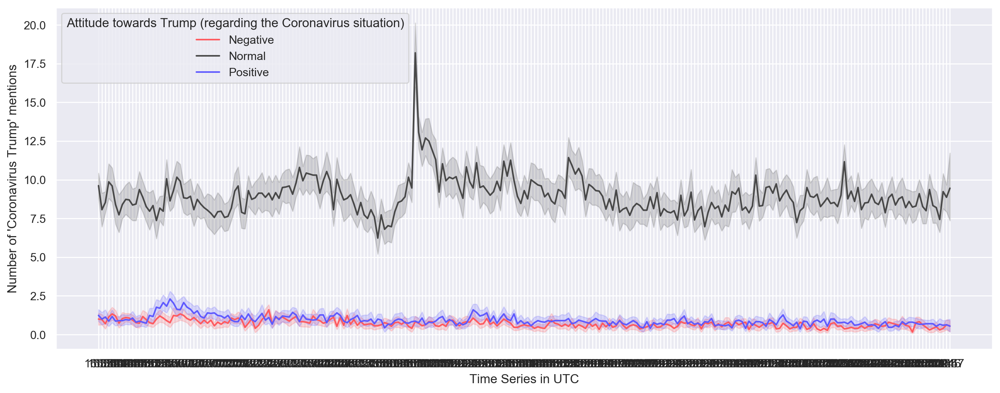

In [13]:
# Clean and transform data to enable time series
result = df.groupby([pd.Grouper(key='created_at', freq='2 s'), 'polarity']).count() \
        .unstack(fill_value=0).stack().reset_index()
result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%H:%M'))


# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id_str", hue='polarity', data=result,
                  palette=sns.color_palette(["#FF5A5F","#484848", "#5F5AFF"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(settings.TRACK_WORDS[0]))
plt.legend(title='Attitude towards Trump (regarding the Coronavirus situation)', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

In [14]:
#These will be used for the analytical dashboard below (basically we clean and transform the data to enable time series)
result1 = df.groupby([pd.Grouper(key='created_at', freq='2s'), 'polarity']) \
           .count() \
           .unstack(fill_value=0) \
           .stack() \
           .reset_index()
result1 = result1.rename(columns={"id_str": f"Num of '{settings.TRACK_WORDS}' mentions", "created_at":"Time in UTC"})
time_series = result1["Time in UTC"][result['polarity']==0].reset_index(drop=True)

### Topic Tracking with Natural Language Processing using RE and NLTK

In order to track the hottest words or the most frequency tokens in the tweets, we join all tweet texts, remove the urls, clean the ‘RT’ and ‘&’ (a.k.a. ‘&amp;’) symbols and convert all characters into lowercases.

In [15]:
content = ' '.join(df["text"])
content = re.sub(r"http\S+", "", content)
content = content.replace('RT ', ' ').replace('&amp;', 'and')
content = re.sub('[^A-Za-z0-9]+', ' ', content)
content = content.lower()

**Punkt** Sentence Tokenizer is used to divide a text into a list of sentences by using an unsupervised algorithm. <br>
Then we tokenize the entire text from all tweets, use **Stop Words** to remove commonly used words, and extract 10 most common words in the **Frequency Distribution** of all words.

In [16]:
import nltk
nltk.download('punkt')
nltk.download('stopwords')

from nltk.probability import FreqDist
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords

tokenized_word = word_tokenize(content)
stop_words = set(stopwords.words("english"))
filtered_sent = []
for w in tokenized_word:
    if w not in stop_words:
        filtered_sent.append(w)

fdist = FreqDist(filtered_sent)
fd = pd.DataFrame(fdist.most_common(20), columns=["Word", "Frequency"]).drop([0]).reindex()

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Fivos\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Fivos\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [17]:
fig = px.bar(fd, x="Word", y="Frequency")
fig.update_traces(marker_color='rgb(240,128,128)',
                  marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5,
                  opacity=0.8)
fig.show()

### Geographic Segmentation Recognization with Text Processing

We find out the geo-distribution of users , or in other words we find where tweets come from according to their users' location. To explore users’ geographic distributions, we need to identify their locations through their user profile rather than the locations attached with tweets, since less than 1% people will attach their tweet locations. However, according to locations in users’ profile, they may include one or more of counties, cities, states or planets. Thus, filtering these data into US state-level locations is the core of geographic segmentation recognization.

We set up all state names and their abbreviations as constants for further abbreviation-name transformation.

In [18]:
STATES = ['Alabama', 'AL', 'Alaska', 'AK', 'American Samoa', 'AS', 'Arizona', 'AZ', 'Arkansas', 'AR', 'California', 'CA', 'Colorado', 'CO', 'Connecticut', 'CT', 'Delaware', 'DE', 'District of Columbia', 'DC', 'Federated States of Micronesia', 'FM', 'Florida', 'FL', 'Georgia', 'GA', 'Guam', 'GU', 'Hawaii', 'HI', 'Idaho', 'ID', 'Illinois', 'IL', 'Indiana', 'IN', 'Iowa', 'IA', 'Kansas', 'KS', 'Kentucky', 'KY', 'Louisiana', 'LA', 'Maine', 'ME', 'Marshall Islands', 'MH', 'Maryland', 'MD', 'Massachusetts', 'MA', 'Michigan', 'MI', 'Minnesota', 'MN', 'Mississippi', 'MS', 'Missouri', 'MO', 'Montana', 'MT', 'Nebraska', 'NE', 'Nevada', 'NV', 'New Hampshire', 'NH', 'New Jersey', 'NJ', 'New Mexico', 'NM', 'New York', 'NY', 'North Carolina', 'NC', 'North Dakota', 'ND', 'Northern Mariana Islands', 'MP', 'Ohio', 'OH', 'Oklahoma', 'OK', 'Oregon', 'OR', 'Palau', 'PW', 'Pennsylvania', 'PA', 'Puerto Rico', 'PR', 'Rhode Island', 'RI', 'South Carolina', 'SC', 'South Dakota', 'SD', 'Tennessee', 'TN', 'Texas', 'TX', 'Utah', 'UT', 'Vermont', 'VT', 'Virgin Islands', 'VI', 'Virginia', 'VA', 'Washington', 'WA', 'West Virginia', 'WV', 'Wisconsin', 'WI', 'Wyoming', 'WY']
STATE_DICT = dict(itertools.zip_longest(*[iter(STATES)] * 2, fillvalue=""))
INV_STATE_DICT = dict((v,k) for k,v in STATE_DICT.items())

Extract the state information from their locations by iterating the list of state names and the list of user locations. Count the number of tweets posted in each state of US, and use logarithmic number to
avoid the extreme values (e.g. 4000+ in California and 3 in North Dakota) for better
visualization.

In [19]:
is_in_US=[]
geo = df[['user_location']]
df = df.fillna(" ")
for x in df['user_location']:
    check = False
    for s in STATES:
        if s in x:
            is_in_US.append(STATE_DICT[s] if s in STATE_DICT else s)
            check = True
            break
    if not check:
        is_in_US.append(None)

#geo_dist = df[['user_location']][is_in_US]
geo_dist = pd.DataFrame(is_in_US, columns=['State']).dropna().reset_index()
geo_dist = geo_dist.groupby('State').count().rename(columns={"index": "Number"}) \
        .sort_values(by=['Number'], ascending=False).reset_index()
geo_dist["Log Num"] = geo_dist["Number"].apply(lambda x: math.log(x, 2))
geo_dist.head()

,State,Number,Log Num
0,CA,4027,11.975490
1,FL,2559,11.321364
2,TX,2343,11.194141
3,NY,2312,11.174926
4,WA,1025,10.001408


We add explanatory text information for the hover text on later dashboard.

In [20]:
geo_dist['Full State Name'] = geo_dist['State'].apply(lambda x: INV_STATE_DICT[x])
geo_dist['text'] = geo_dist['Full State Name'] + '<br>' + 'Num: ' + geo_dist['Number'].astype(str)

We use Plotly  to visualize the USA map.

**plotly.graph_objects** is the core of Plotly Library containing more generic functions for more complex usage. <br />
**locationmode** is the set of locations match entries in “locations”. <br />
**text** is the hover text. <br />
**marker_line_color** is the color of line markers between states. <br />
Set **geo_scope** to limit map scope to USA. <br />

In [21]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Choropleth(
    locations=geo_dist['State'], # Spatial coordinates
    z=geo_dist['Log Num'].astype(float), # Data to be color-coded
    locationmode='USA-states', 
    colorscale="Reds",
    text=geo_dist['text'],
    marker_line_color='white', # line markers between states
    colorbar_title="Numbers in Log2"
))
fig.update_layout(geo_scope='usa')
fig.show()

### Interactive Analytical Dashboard with Plotly

We want to integrate all three data visualisations into one dashboard using Plotly.subplots. First, we create a Plotly Figure containing 2×2 subplots with Line Chart in the left, Map in the top right and Bar Chart in the bottom right.

In [22]:
from plotly.subplots import make_subplots

fig = make_subplots(
        cols=2,
        rows=2,
        column_widths=[1, 0.4],
        row_heights=[0.6, 0.4],
        specs=[[{"type": "scatter", "rowspan": 2}, {"type": "choropleth"}],
               [None, {"type": "bar"}]]
)

We add three Lines of negatives, neutrals and positives in the first subplot using **add_trace** and **go.Scatter**. In addition, **row** and **col** represent the place of this subplot in the big figure.

In [23]:
%%capture

fig.add_trace(go.Scatter(
                x=time_series,
                y=result1[f"Num of '{settings.TRACK_WORDS}' mentions"][result1['polarity']==0].reset_index(drop=True),
                name="Neutral",
                opacity=0.8),
              row=1,
              col=1)   
fig.add_trace(go.Scatter(
                x=time_series,
                y=result1[f"Num of '{settings.TRACK_WORDS}' mentions"][result1['polarity']==-1].reset_index(drop=True),
                name="Negative",
                opacity=0.8),
              row=1,
              col=1)
fig.add_trace(go.Scatter(
                x=time_series,
                y=result1[f"Num of '{settings.TRACK_WORDS}' mentions"][result1['polarity']==1].reset_index(drop=True),
                name="Positive",
                opacity=0.8),
              row=1,
              col=1)

We add the Bar Chart for the topic frequency distribution using **add_trace** and **go.Bar**. 

In [24]:
%%capture

fig.add_trace(go.Bar(x=fd["Word"], y=fd["Frequency"], name="Freq Dist"), row=2, col=2)
fig.update_traces(marker_color='rgb(59, 89, 152)',
                  marker_line_color='rgb(8,48,107)',
                  marker_line_width=0.5,
                  opacity=0.7,
                  row=2,
                  col=2)

Then we insert the Map in the top right and set locations and numbers per location.

In [25]:
%%capture

fig.add_trace(go.Choropleth(
                locations=geo_dist['State'], # Spatial coordinates
                z=geo_dist['Log Num'].astype(float), # Data to be color-coded
                locationmode='USA-states', 
                colorscale="Blues",
                text=geo_dist['text'], # hover text
                showscale=False,
                geo = 'geo'),
              row=1,
              col=2)


We add title in the layout of our figure, reduce the geo-scope of our map, turn the template theme into the dark, and add annotations for the layout using **go.layout.Annotation**.

In [26]:
utc_now_str = dt.now().utcnow().strftime('%m-%d %H:%M')
fig.update_layout(
    title_text=f"Real-time tracking '{settings.TRACK_WORDS}' mentions on Twitter {utc_now_str} UTC",
    geo=dict(scope='usa'),
    template="plotly_dark",
    margin=dict(r=20, t=50, b=50, l=20),
    annotations=[
        go.layout.Annotation(
            text="Source: Twitter",
            showarrow=False,
            xref="paper",
            yref="paper",
            x=0,
            y=0)
    ],
    showlegend=False,
    xaxis_rangeslider_visible=True
)

### Predicting sentiment of tweets 

We try to find the sentiment of tweets concerning the US Government using Random Forest Classifier.

In [27]:
api = tweepy.API(auth ,timeout=15)

all_tweets = []

search_query = "US Government"

for tweet_object in tweepy.Cursor(api.search,q=search_query+" -filter:retweets",lang='en',result_type='recent').items(200):
    all_tweets.append(tweet_object.text)


We load the training dataset.

In [28]:
tweets = pd.read_csv("https://raw.githubusercontent.com/kolaveridi/kaggle-Twitter-US-Airline-Sentiment-/master/Tweets.csv")


We preprocess the data

In [29]:
X = tweets.iloc[:, 10].values  
y = tweets.iloc[:, 1].values


processed_tweets = []
 
for tweet in range(0, len(X)):  
    # Remove all the special characters
    processed_tweet = re.sub(r'\W', ' ', str(X[tweet]))
 
    # remove all single characters
    processed_tweet = re.sub(r'\s+[a-zA-Z]\s+', ' ', processed_tweet)
 
    # Remove single characters from the start
    processed_tweet = re.sub(r'\^[a-zA-Z]\s+', ' ', processed_tweet) 
 
    # Substituting multiple spaces with single space
    processed_tweet= re.sub(r'\s+', ' ', processed_tweet, flags=re.I)
 
    # Removing prefixed 'b'
    processed_tweet = re.sub(r'^b\s+', '', processed_tweet)
 
    # Converting to Lowercase
    processed_tweet = processed_tweet.lower()
 
    processed_tweets.append(processed_tweet)


We use **TF-IDF** (Term Frequency - Inverse Document Frequency) for text to numeric conversion

In [30]:
from sklearn.feature_extraction.text import TfidfVectorizer  
tfidfconverter = TfidfVectorizer(max_features=2000, min_df=5, max_df=0.7, stop_words=stopwords.words('english'))  
X = tfidfconverter.fit_transform(processed_tweets).toarray()

The model classifier used is Random Forest

In [31]:
from sklearn.ensemble import RandomForestClassifier
text_classifier = RandomForestClassifier(n_estimators=100, random_state=0)  
text_classifier.fit(X, y)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=0, verbose=0,
                       warm_start=False)

**Predicting Sentiment for the scraped tweets**

In [32]:
for tweet in all_tweets:
    # Remove all the special characters
    processed_tweet = re.sub(r'\W', ' ', tweet)
 
    # remove all single characters
    processed_tweet = re.sub(r'\s+[a-zA-Z]\s+', ' ', processed_tweet)
 
    # Remove single characters from the start
    processed_tweet = re.sub(r'\^[a-zA-Z]\s+', ' ', processed_tweet) 
 
    # Substituting multiple spaces with single space
    processed_tweet= re.sub(r'\s+', ' ', processed_tweet, flags=re.I)
 
    # Removing prefixed 'b'
    processed_tweet = re.sub(r'^b\s+', '', processed_tweet)
 
    # Converting to Lowercase
    processed_tweet = processed_tweet.lower()
 
    sentiment = text_classifier.predict(tfidfconverter.transform([ processed_tweet]).toarray())
    print(processed_tweet ,":", sentiment)


 kch17h kabaco2d get_involved1 jgmanley mediaguido plague hits our country worse than any other bar the us https co bb9csine1x : ['neutral']
 if the us government moves on you will bring down the entire house of cards stone wrote according to transc https co zbltdksvuq : ['neutral']
 we re all being super chill towards each other cause this is scary time and the government is giving us useful https co spaanvwzdu : ['negative']
 dfbharvard so government doesn deny single revenue source while legislating the rest of us out of business th https co xrkhfeq0a2 : ['neutral']
 redislandred traptofficial don live in an ideal world so we need some sort of government to be able to keep us https co 9ci71hpqes : ['neutral']
 arabtimeskuwait allah will continue his protection on us all and always in kuwait and kuwait government should be careful  : ['negative']
 billkristol so medical success and the greatest federal government failure in us history germany japan viet https co wp6a1q5ibr : ['neutra

 610cktb the previous liberal government gave windmill producers almost double the rate they get for power in the https co fuu6xqfryt : ['negative']
la county dept public health dir dr barbara ferrer the us government conducts investigations re covid 19 case https co ypqh670heu : ['neutral']
oloye the government don free us be that on lowkey you re left with you your sense your immune system and https co jjrdjhcxu5 : ['neutral']
us government failure to tackle covidー19 spread behind bars will be death sentence for many hrw https co qn2cvy9yai : ['neutral']
 artfuldodjem ryan86837779 stevebarclay rishisunak ve not paid my rent for 2 months now can i have no inc https co eav4fofibc : ['neutral']
 sa199095855716 alitahmizian blame the current government ksa is what supported us and now sunnis are in the corn https co jtbebvh5xs : ['neutral']
 govsisolak gma tune in for what fix the unemployment office so people can file have everybody wear darn ma https co s11i18qsnt : ['negative']
 rmwgt

 cbcmontreal would you feel better if more credible source told you and why are you running like hell from this https co 8w9eubsmtc : ['negative']
 peston certainly trust quality journalism far more than the government most members seem unable to move on from https co 1u4p4ppep1 : ['negative']
 torontostar apologize for what the truth apparently our government is run by the untouchables how quai https co hf4aps3ciz : ['neutral']
deaths per million don believe it when you hear in the media britain has the highest death rate in europe https co uqsfa3lbfn : ['negative']
 dpvpinbuffalo writerromana who is they m not falling for anyone fear tactics we already have proof of wh https co hzk20eqqtd : ['neutral']
 dhduncanca guiltyhonkey its already happening after sip we are going to see 20 unemployment in this state peo https co 2ypc8lscmj : ['neutral']
 gregmolidor the white house gift shop is private for profit company based in lancaster country pennsylvania https co deslnyy9s1 : ['negative

 animeandtheatre oh god the government is onto us  : ['negative']
 ronniethefrog bodhimcclory saxover cpearn1 piersmorgan gmb matthancock don watch good moaning britain all https co jhpvyoplus : ['neutral']
 shannygasm wait till you find out that the website white house gift shop is not related to the white house or indeed to the us government  : ['negative']
while we may not have smoking gun proving covid 19 escaped from lab there is circumstantial evidence to suggest https co juxyqgqehy : ['neutral']
 ecomemory1 janettxblessed tweets4poppy lots_of_fun_69 chrisroy489 ericjswensson truthserum4all bethcutrona https co 9gttkxwzxk : ['neutral']
 wonderking82 mom divorced dad when was 3 and my sis was 8 she raised us on teacher salary without governmen https co el36yr99ko : ['neutral']
 oann so this is the next plan to cripple the us government by not having any representatives of the people in washington  : ['negative']
us government ufo are real everyone https co ruuitskfs9 : ['neutral']